In [1488]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from sklearn.linear_model import LinearRegression
from datetime import date, timedelta
from scipy.optimize import leastsq
#from sklearn.linear_model import LinearRegression
from matplotlib.dates import DateFormatter
from scipy.stats import chisquare

#from datetime import date, timedelta
yesterday = date.today() - timedelta(days=1)
d1 = yesterday.strftime("%Y-%m-%d")
#yesterday1 = date.today() - timedelta(days=3)
d12f = lambda x:(date.today() - timedelta(days=x)).strftime("%Y-%m-%d")

countriesEU = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania",\
               "Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands",\
               "Denmark","Poland","Estonia","Portugal","Finland","Romania","France",\
               "Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
#x = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
d0 = date(2020, 3, 29)
d2 = date.today()
deltaT = d2 - d0
print(deltaT.days)
dT = deltaT.days
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
RkoreaCoeffs=[ 0.36242246,  2.56241634,  1.84890887,  0.13324732]
%matplotlib inline
expPopWorld = 2.67152730e+06
def moving_average(a, n=3) :
    ret = np.cumsum(a, dtype=float)
    ret[n:] = ret[n:] - ret[:-n]
    return ret[n - 1:] / n

def linreg(dfLT,population):
    
    dfLT['date'] = pd.to_datetime(dfLT['date'])
    yy = np.log(dfLT['cases'].values*10000./population)
    xx = np.array(range(dfLT['cases'].size)).reshape((-1, 1))
    model1 = LinearRegression().fit(xx, yy)
    r_sq1 = model1.score(xx, yy)
    return model1, r_sq1, dfLT

def plotpred(dfLT1, population, dateStart, dateEnd, filename, model1, country,level):
    
    #fig, ax = plt.subplots(figsize=(12, 12))
    plt.plot(dfLT1['date'].values,dfLT1['cases']*10000./population)
    date_form = DateFormatter("%m-%d")
    ax = plt.axes()
    ax.xaxis.set_major_formatter(date_form)
    ix1 = pd.date_range(dateStart, dateEnd, freq='D')
    ss1 = pd.DataFrame({'date': ix1},index=range(len(ix1)))
    y_pred1 = np.exp(model1.intercept_ + model1.coef_ * range(len(ix1)))
    ax.plot(ss1['date'].values,y_pred1)
    plt.xticks(rotation=90)
    plt.title(country)
    plt.ylabel('Tolat COVID-19 cases per 10000')
    ax.fill_between(ss1['date'].values, 1,level, facecolor='red', alpha=0.3)
    ax.fill_between(ss1['date'].values, yc,1, facecolor='m', alpha=0.3)
    ax.fill_between(ss1['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
    plt.xlabel('Date')
    #plt.yscale('log')
    plt.yscale('log')
    plt.grid()
    plt.savefig(filename)
    plt.show()
    ss1a = pd.DataFrame({'cases': (y_pred1*population/10000).astype(int)},index=range(len(y_pred1)))
    ss1t = pd.concat([ss1,ss1a], axis=1)
    return ss1t

def forecast(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases',pMAPE=True):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))#+coeffs[0]*.25/(1 + np.exp( - coeffs[1] * (t - 3.5*coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    if pMAPE:
        print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logistic')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x

def forecast2(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'bi-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: bi-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("bi-logistic approximation splitting point: %d"%(vL))
    print(output0)
    print(output)
    return x

def forecast3(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))+coeffsUS[3]/(1 + np.exp( - coeffsUS[4] * (t - coeffsUS[5])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendS1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: tri-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('forecast rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("tri-logistic approximation splitting points: %d,%d"%(vL[0],vL[1]))
    print(output0)
    print(output1)
    print(output)
    
    return x

def trend3(dfLV,dfLT1,dfES,lLV,lLT,lES,pLV,pLT,pES):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #dfLT1 = pd.read_csv("~/Desktop/coronaLT1.csv",",")
    y = np.log(np.diff(dfLT1["cases"].values)[:]/dfLT1["cases"].values[1:]**2)
    x = np.array(range(len(dfLT1["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLT)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLT) 
    plt.plot(range(len(x)+pLT),y_pred12,label='%s tr'%(lLT))

    y = np.log(np.diff(dfES["cases"].values)[:]/dfES["cases"].values[1:]**2)
    x = np.array(range(len(dfES["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lES)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pES) 
    plt.plot(range(len(x)+pES),y_pred12,label='%s tr'%(lES))
    plt.xlabel('t, days')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s%s%s.png"%(lLV,lLT,lES))
    plt.show()
    
def trend(dfLV,lLV,pLV):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    plt.xlabel('t [days]')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s.png"%(lLV))
    plt.show()

def trendS(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendS0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend0 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x[:vL])+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL])+pLV,y_pred12, output

def trendS1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output
    
def forecastR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t, output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: Richards')
    print('coeffs: ',x)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1])) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print (output)
    return x

def forecast2R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] *coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])-coeffs2[0]/(1 + np.exp( - coeffs2[3] *coeffs2[1] * (tt - coeffs2[2])))**(1./coeffs2[3])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: bi-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print(output)
    return x

def forecast3R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] * coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7] * coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(waveform_1-model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel-6*diffStd0*np.ones(len(tt)),allmodel+6*diffStd0*np.ones(len(tt)), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model']) 
    ax2.set_xlabel('t, days')
    ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(np.diff(waveform_1)-np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)-3*diffStd*np.ones(len(tt)-1), np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t [days]')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s_R.png"%(Cntr))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    rint('model: tri-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    print('\t total death: ', int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0]))
    print(output)
    return x

def get_cases(df,threshold):    
    dfA = df[df[['Country','TotCasesper1Mpop']].TotCasesper1Mpop>=threshold]
    #y = df[df['Country','TotCasesper1Mpop'].TotCasesper1Mpop>=56.]
    dfA = dfA.sort_values(by=['TotCasesper1Mpop'], ascending=False)
    country = dfA['Country']
    #country = country.tolist()
    cases = dfA['TotCasesper1Mpop']/100
    #case = cases.tolist()
    return country, cases

def stat_picture(country, cases, high=35, picname="pictures/coronage0.png"):
# Import the necessary packages and modules


    # Prepare the data
    #x = dfA['Country']
    fig = plt.figure( figsize=(6, high))
    fig.subplots_adjust(bottom=0.2, left=0.1)
    # Plot the data
    y_pos = cases
    #barh(y_pos, performance, xerr=error, align='center')
    plt.barh(country,y_pos)
    #plt.xticks(rotation=90)
    plt.xlabel('COVID-19 cases per 10000')
    # Add a legend
    plt.legend()
    ax = plt.axes() 
    x = range(len(country))
    ax.fill_betweenx(x, 1,1000, facecolor='red', alpha=0.3)
    yc = 0.56
    ax.fill_betweenx(x, yc,1, facecolor='m', alpha=0.3)
    ax.fill_betweenx(x, 1e-4,yc, facecolor='y', alpha=0.3)
    plt.vlines(yc, 0, len(country)-1, colors='g', linestyles='solid')
    #plt.ylim([1e-2,60])
    ax.xaxis.grid() # horizontal lines
    #ax.xaxis.grid() # vertical lines

    ax.set_yticks(range(len(country)))
    ax.set_yticklabels(country)
    #ax.invert_yaxis()
    plt.xscale("log")
    # Show the plot

    plt.savefig(picname, bbox_inches='tight')
    plt.show()
    
def read_df(dfRM,lRM):
    dfRM = pd.read_csv("data/corona%s.csv"%(lRM),",")
    dfRM['date'] = pd.to_datetime(dfRM['date'])
    print("%s\n"%(lRM),dfRM.tail())
    return dfRM

121


In [1489]:
from sklearn.linear_model import Ridge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

def forecastRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    locStr = 'upper left'
    if Cntr in ['New Zealand']:
        locStr = 'lower right'
    ax2.legend(['COVID-19 %s'%(Cntr), 'Richards','-3days'],loc=locStr) 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecastRRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]) )))#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2RRR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * ((t- coeffsUS[2])*(t- coeffsUS[3]))))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    24.31714688, 0.00530186**2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RRR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))+coeffsUS[4]/(1 + np.exp( - coeffsUS[5] * (t - coeffsUS[6])* (t - coeffsUS[7])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.01 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSQ1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def trendSQ(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL:], y[vL:]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSQ0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[:vL], y[:vL]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL]),y_pred12, output

def trendSQ1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL[1], np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL[1]]),y_pred12, output

def trendSS(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS0(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS1(dfLV,vL=[0,1],pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

In [1490]:
def forecastQR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * coeffs[4] * ((t- coeffs[2])**0.5*(t- coeffs[3])**0.5 )))**(1./coeffs[4])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3],xcoef[4]*x[4]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3],xcoef[4]*x_1[4]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'RichardsQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_QR.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_QR.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: RichardsQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x


def forecast2RR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL,nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-Richards approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases',zoom=1.):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7]*coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop/4,  2.61212092e+01, -9.65961409e-01,  5.96529356e-03], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    if zoom != 1.:
        ax3.set_ylim([0,zoom])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL[1],nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL[0],nu=x[3])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSS1(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2QR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])+coeffsUS[0]/(1 + np.exp( - coeffsUS[4]*coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))**(1./coeffsUS[4])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

In [1510]:
dfp = pd.read_csv("data/population.csv",",")
#dfp[dfp['Country (or dependency)']=='China'].Population.tolist()[0]
dfp.head()

,Country (or dependency),Population,Yearly\nChange,Net\nChange,Density\n(P/Km²),Land Area\n(Km²),Migrants\n(net),Fert.\nRate,Med.\nAge,Urban\nPop %,World\nShare
0,World,7774108745,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,European Union,445250514,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,China,1439323776,0.39 %,5540090.0,153.0,9388211.0,-348399.0,1.7,38,61 %,18.47 %
3,India,1380004385,0.99 %,13586631.0,464.0,2973190.0,-532687.0,2.2,28,35 %,17.70 %
4,United States,331002651,0.59 %,1937734.0,36.0,9147420.0,954806.0,1.8,38,83 %,4.25 %


In [1511]:
popEU = sum(dfp[dfp["Country (or dependency)"].isin(countriesEU) ].Population)

In [1512]:
#df = pd.read_csv("~/Desktop/coronaAllT.csv","\t")
df = pd.read_csv("data/coronaAll_%s.csv"%(d1),",")
dfAll = df#pd.read_csv("~/Desktop/coronaAll_2020-03-28.csv",",")

In [1513]:
df.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,NaN,North America,5201390,5474.0,209681.0,393.0,2619014.0,"+5,404",2372695,26296.0,NaN,NaN,NaN,NaN,NaN,North America,\n,NaN,NaN
1,NaN,South America,3792033,4669.0,135667.0,122.0,2541259.0,309,1115107,14309.0,NaN,NaN,NaN,NaN,NaN,South America,\n,NaN,NaN
2,NaN,Asia,3979309,8046.0,91316.0,144.0,2886791.0,"+13,483",1001202,19570.0,NaN,NaN,NaN,NaN,NaN,Asia,\n,NaN,NaN
3,NaN,Europe,2806724,6774.0,201832.0,168.0,1687010.0,"+10,069",917882,5255.0,NaN,NaN,NaN,NaN,NaN,Europe,\n,NaN,NaN
4,NaN,Africa,864139,45.0,18222.0,4.0,510111.0,22,335806,1094.0,NaN,NaN,NaN,NaN,NaN,Africa,\n,NaN,NaN


In [1514]:
df.tail()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
225,NaN,Total:,2806724,6774.0,201832.0,168.0,1687010.0,"+10,069",917882,5255.0,NaN,NaN,NaN,NaN,NaN,Europe,,NaN,NaN
226,NaN,Total:,864139,45.0,18222.0,4.0,510111.0,22,335806,1094.0,NaN,NaN,NaN,NaN,NaN,Africa,,NaN,NaN
227,NaN,Total:,17032,368.0,189.0,6.0,10936.0,1,5907,50.0,NaN,NaN,NaN,NaN,NaN,Australia/Oceania,,NaN,NaN
228,NaN,Total:,721,NaN,15.0,NaN,651.0,NaN,55,4.0,NaN,NaN,NaN,NaN,NaN,NaN,,NaN,NaN
229,NaN,European Union,1425951,460.0,135765.0,2.0,683658.0,NaN,188395,2025.0,3202.581367,304.918233,38308161.0,86037.320105,NaN,Europe,NaN,NaN,NaN


In [1515]:
dfAll.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,NaN,North America,5201390,5474.0,209681.0,393.0,2619014.0,"+5,404",2372695,26296.0,NaN,NaN,NaN,NaN,NaN,North America,\n,NaN,NaN
1,NaN,South America,3792033,4669.0,135667.0,122.0,2541259.0,309,1115107,14309.0,NaN,NaN,NaN,NaN,NaN,South America,\n,NaN,NaN
2,NaN,Asia,3979309,8046.0,91316.0,144.0,2886791.0,"+13,483",1001202,19570.0,NaN,NaN,NaN,NaN,NaN,Asia,\n,NaN,NaN
3,NaN,Europe,2806724,6774.0,201832.0,168.0,1687010.0,"+10,069",917882,5255.0,NaN,NaN,NaN,NaN,NaN,Europe,\n,NaN,NaN
4,NaN,Africa,864139,45.0,18222.0,4.0,510111.0,22,335806,1094.0,NaN,NaN,NaN,NaN,NaN,Africa,\n,NaN,NaN


In [1516]:
dfAll.fillna(0, inplace=True)
dfAll[dfAll["Country"]=="Lithuania"]

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
129,123.0,Lithuania,2027,8.0,80.0,0.0,1623.0,3,324,6.0,745.0,29.0,507420.0,186610.0,"2,719,151",Europe,"1,341","33,989",5


No handles with labels found to put in legend.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:815: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


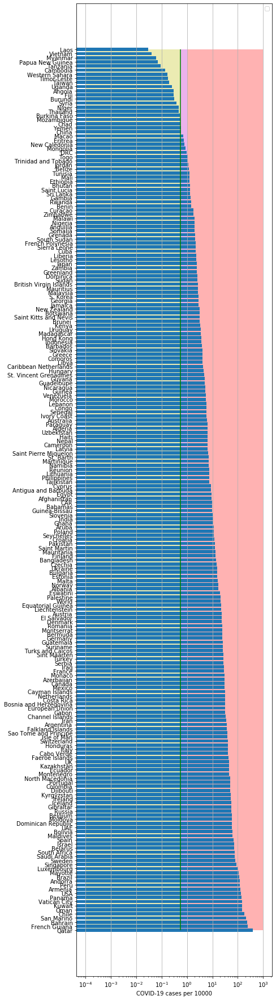

In [1517]:
country, cases = get_cases(df,0.01)
country.values, cases.values
stat_picture(country.values, cases.values, high=35, picname="pictures/coronage0.png")

No handles with labels found to put in legend.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:815: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


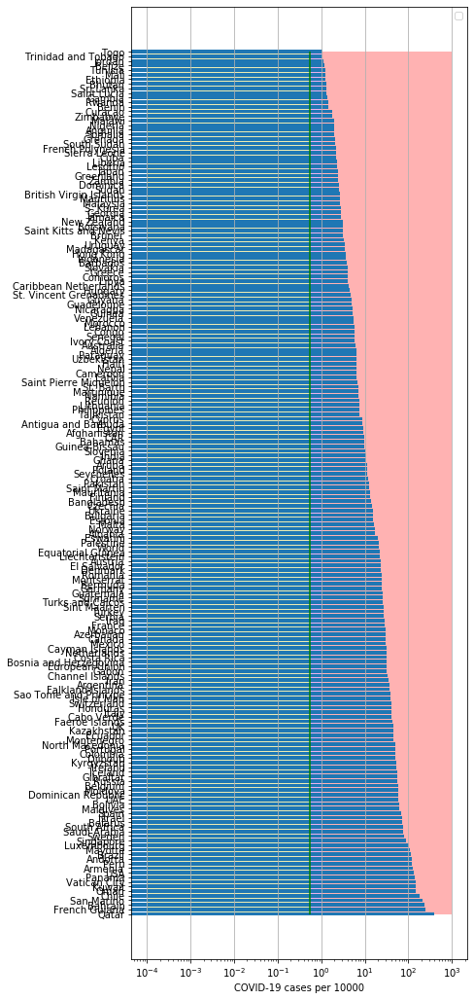

In [1518]:
country, cases = get_cases(df,100.0)
stat_picture(country.values, cases.values, high=20, picname="pictures/coronage1.png")

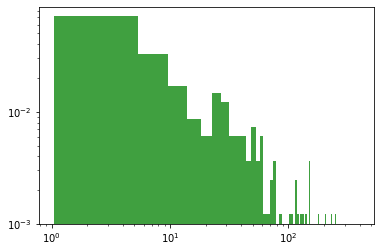

In [1519]:
n, bins, patches = plt.hist(cases, 90, density=True,facecolor='g', alpha=0.75)
plt.yscale("log")
plt.xscale("log")

In [1520]:
dfSP = read_df(pd.DataFrame(),"SP")
dfGB = read_df(pd.DataFrame(),"GB")
dfIT = read_df(pd.DataFrame(),"IT")
dfLT = read_df(pd.DataFrame(),"LT")
dfUkr = read_df(pd.DataFrame(),"Ukr")
dfUS = read_df(pd.DataFrame(),"US")
dfCN = read_df(pd.DataFrame(),"CN")
dfFR = read_df(pd.DataFrame(),"FR")
dfKR = read_df(pd.DataFrame(),"KR")
dfW = read_df(pd.DataFrame(),"World")
dfDK = read_df(pd.DataFrame(),"DK")
dfNG = read_df(pd.DataFrame(),"NG")
dfGR = read_df(pd.DataFrame(),"GR")
dfES = read_df(pd.DataFrame(),"ES")
dfSW = read_df(pd.DataFrame(),"SW")
dfPL = read_df(pd.DataFrame(),"PL")
dfIS = read_df(pd.DataFrame(),"IS")
dfUR = read_df(pd.DataFrame(),"Ukr")
dfSZ = read_df(pd.DataFrame(),"SZ")
dfIN = read_df(pd.DataFrame(),"IN")
#dfKRA = read_df(pd.DataFrame(),"KRA")
dfRS = read_df(pd.DataFrame(),"RS")
dfJP = read_df(pd.DataFrame(),"JP")
dfNL = read_df(pd.DataFrame(),"NL")
dfAT = read_df(pd.DataFrame(),"AT")
dfBG = read_df(pd.DataFrame(),"BG")
dfSG = read_df(pd.DataFrame(),"SG")
dfLV = read_df(pd.DataFrame(),"LV")
dfCA = read_df(pd.DataFrame(),"CA")
dfPT = read_df(pd.DataFrame(),"PT")
dfTR = read_df(pd.DataFrame(),"TR")
dfBZ = read_df(pd.DataFrame(),"BZ")
dfAS = read_df(pd.DataFrame(),"AS")
dfML = read_df(pd.DataFrame(),"ML")
dfZL = read_df(pd.DataFrame(),"ZL")
dfBR = read_df(pd.DataFrame(),"BR")
dfIR = read_df(pd.DataFrame(),"IR")
dfCL = read_df(pd.DataFrame(),"CL")
dfCH = read_df(pd.DataFrame(),"CH")
dfRM = read_df(pd.DataFrame(),"RM")
dfFI = read_df(pd.DataFrame(),"FI")
dfID = read_df(pd.DataFrame(),"ID")
dfED = read_df(pd.DataFrame(),"ED")
dfPH = read_df(pd.DataFrame(),"PH")
#dfPK = read_df(pd.DataFrame(),"PK")
dfLX = read_df(pd.DataFrame(),"LX")
dfTH = read_df(pd.DataFrame(),"TH")
dfIE = read_df(pd.DataFrame(),"IE")
dfMX = read_df(pd.DataFrame(),"MX")
dfPM = read_df(pd.DataFrame(),"PM")
dfPU = read_df(pd.DataFrame(),"PU")
dfSB = read_df(pd.DataFrame(),"SB")
dfAG = read_df(pd.DataFrame(),"AG")
dfCT = read_df(pd.DataFrame(),"CT")
dfEG = read_df(pd.DataFrame(),"EG")
dfSV = read_df(pd.DataFrame(),"SV")
dfMR = read_df(pd.DataFrame(),"MR")
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIC = read_df(pd.DataFrame(),"IC")
dfQR = read_df(pd.DataFrame(),"QR")
dfCB = read_df(pd.DataFrame(),"CB")
dfBL = read_df(pd.DataFrame(),"BL")
dfAG = read_df(pd.DataFrame(),"AR")
dfEU = read_df(pd.DataFrame(),"EU")
dfMT = read_df(pd.DataFrame(),"MT")
dfCP = read_df(pd.DataFrame(),"CP")

SP
           date   cases  active    death
149 2020-07-23  317246       0  28429.0
150 2020-07-24  319501       0  28432.0
151 2020-07-25  319501       0  28432.0
152 2020-07-26  319501       0  28432.0
153 2020-07-27  325862       0  28434.0
GB
           date   cases  active    death
148 2020-07-23  297146       0  45554.0
149 2020-07-24  297914       0  45677.0
150 2020-07-25  298681       0  45738.0
151 2020-07-26  299426       0  45752.0
152 2020-07-27  300111       0  45759.0
IT
           date   cases  active    death
151 2020-07-23  245338   12404  35092.0
152 2020-07-24  245590   12301  35097.0
153 2020-07-25  245864   12442  35102.0
154 2020-07-26  246118   12565  35107.0
155 2020-07-27  246286   12581  35112.0
LT
           date   cases  active  death     tests
136 2020-07-23  1986.0     290   80.0  497245.0
137 2020-07-24  2001.0     291   80.0  499960.0
138 2020-07-25  2008.0     299   80.0  502690.0
139 2020-07-26  2019.0     306   80.0  504056.0
140 2020-07-27  2027.0  

140 2020-07-27  102051  36611.0  4901.0
MX
           date   cases   active    death
137 2020-07-23  370712  92595.0  41908.0
138 2020-07-24  378285  92948.0  42645.0
139 2020-07-25  385036  94484.0  43374.0
140 2020-07-26  390516  95331.0  43680.0
141 2020-07-27  395489  94690.0  44022.0
PM
           date  cases   active   death
135 2020-07-23  56817  23780.0  1209.0
136 2020-07-24  57993  24039.0  1250.0
137 2020-07-25  58864  24161.0  1275.0
138 2020-07-26  60296  24871.0  1294.0
139 2020-07-27  61442  25034.0  1322.0
PU
           date   cases   active    death
138 2020-07-23  371096  97497.0  17654.0
139 2020-07-24  375961  98695.0  17843.0
140 2020-07-25  379884  98724.0  18030.0
141 2020-07-26  384797  98718.0  18229.0
142 2020-07-27  389717  98752.0  18418.0
SB
           date  cases  active  death
135 2020-07-23  22443  7888.0  508.0
136 2020-07-24  22852  8287.0  518.0
137 2020-07-25  23263  8690.0  526.0
138 2020-07-26  23730  9149.0  534.0
139 2020-07-27  24141  9551.0  54

In [1521]:
dfBL = dfBL.fillna(0)
dfRM = dfRM.fillna(0)
dfSV = dfSV.fillna(0)
dfCT = dfCT.fillna(0)
#dfAR = dfAR.fillna(0)
dfSB = dfSB.fillna(0)
dfCP = dfCP.fillna(0)
dfID = dfID.fillna(0)
dfAG = dfAG.fillna(0)
dfMX = dfMX.fillna(0)
dfPU = dfPU.fillna(0)
dfIQ = dfIQ.fillna(0)
dfIE = dfIE.fillna(0)
dfPH = dfPH.fillna(0)
dfTH = dfTH.fillna(0)
dfMR = dfMR.fillna(0)
dfCP = dfCP.fillna(0)

In [1522]:
from sklearn.linear_model import LinearRegression
populationSp = dfp[dfp['Country (or dependency)']=='Spain'].Population.tolist()[0]
y = np.log(dfSP['cases'].values*10000./populationSp)
x = np.array(range(dfSP['cases'].size)).reshape((-1, 1))
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)


coefficient of determination: 0.5071744480143255
intercept: 0.014681747999354844
slope: [0.0380622]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:6: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  


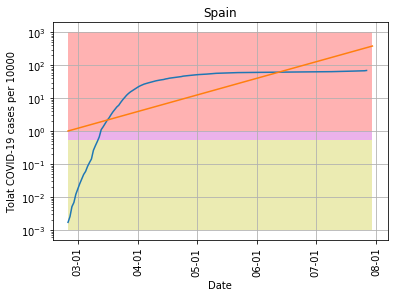

In [1523]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
yc = 0.56
plt.plot(dfSP['date'].values,dfSP['cases']*10000./populationSp)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix = pd.date_range('2020-02-25', '2020-07-30', freq='D')
ss = pd.DataFrame({'date': ix})
y_pred = np.exp(model.intercept_ + model.coef_ * range(len(ix)))
ax.plot(ss['date'].values,y_pred)
plt.xticks(rotation=90)
plt.title('Spain')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaSP.png")
plt.show()

In [1524]:
populationUK = dfp[dfp['Country (or dependency)']=='United Kingdom'].Population.tolist()[0]
model1, r_sql, dfGB1 = linreg(dfGB,populationUK)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.6410807713613775
intercept: -1.585252210906758
slope: [0.04783327]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:51: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


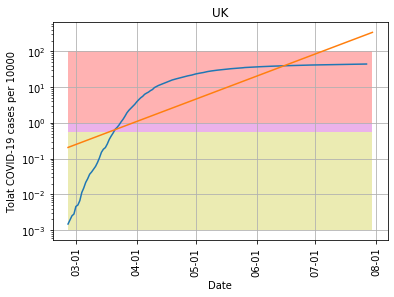

In [1525]:
ss1t = plotpred(dfGB1,populationUK,'2020-02-26', '2020-07-30', "pictures/coronaGB.png", model1, 'UK',100)

In [1526]:
populationIT = dfp[dfp['Country (or dependency)']=='Italy'].Population.tolist()[0]
coefIT = 4.0378751-0.3
yy1 = np.log(coefIT-np.log(dfIT['cases'].values*10000./populationIT))
xx1 = np.array(range(dfIT['cases'].size)).reshape((-1, 1))
model11 = LinearRegression().fit(xx1, yy1)
r_sq1 = model11.score(xx1, yy1)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.9387404123754773
intercept: 1.2381272075963006
slope: [-0.03410332]


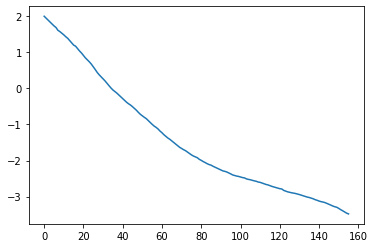

In [1527]:
plt.plot(xx1,yy1)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:5: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  """


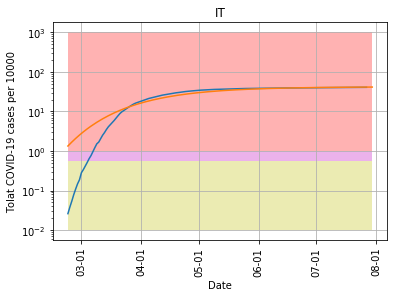

In [1528]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
plt.plot(dfIT['date'].values,dfIT['cases']*10000./populationIT)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix11 = pd.date_range('2020-02-23', '2020-07-30', freq='D')
ss11 = pd.DataFrame({'date': ix11})
y_pred11 = np.exp(coefIT-np.exp(model11.intercept_ + model11.coef_ * range(len(ix11))))
ax.plot(ss11['date'].values,y_pred11)
plt.xticks(rotation=90)
plt.title('IT')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss11['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss11['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss11['date'].values, 1e-2,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
#plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaIT.png")
plt.show()

In [1529]:
cs=y_pred11[-1]/10000.*populationIT

In [1530]:
cs

250019.9922242979

In [1531]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
model1, r_sql, dfLT1 = linreg(dfLT[1:],populationLT)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.45217106618379727
intercept: -0.5100109558124937
slope: [0.02441172]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:51: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


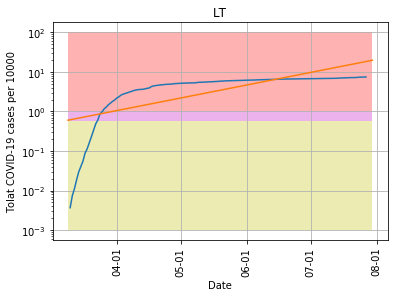

In [1532]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
ss1t = plotpred(dfLT[1:],populationLT,'2020-03-09', '2020-07-30', "pictures/coronaLT.png", model1, 'LT',100)

In [1533]:
populationUKr = dfp[dfp['Country (or dependency)']=='Ukraine'].Population.tolist()[0]
model11, r_sql, dfUkr1 = linreg(dfUkr, populationUKr)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.7237038286188318
intercept: -3.4125821121583777
slope: [0.05501314]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:51: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


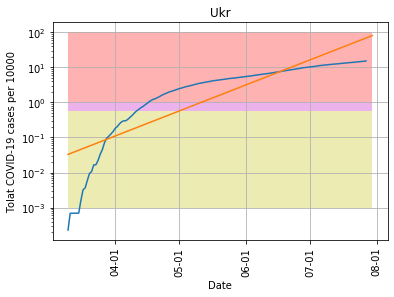

In [1534]:
ss1t1 = plotpred(dfUkr1,populationUKr,'2020-03-10', '2020-07-30', "pictures/coronaUkr.png", model11, 'Ukr',100)

No handles with labels found to put in legend.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:16: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  app.launch_new_instance()


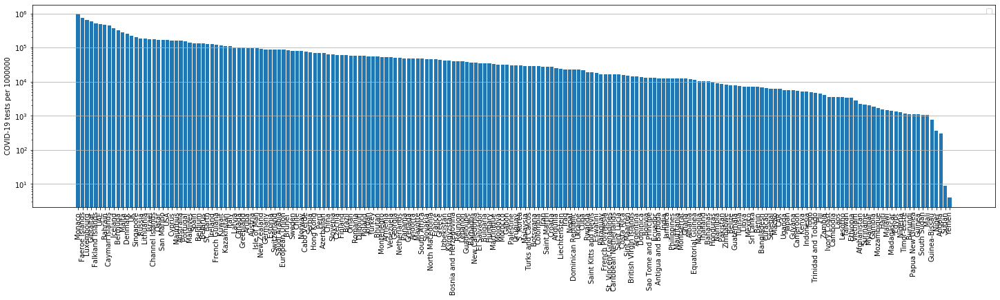

In [1535]:
# Prepare the data
dfTs = dfAll
dfTs = dfTs.sort_values(by=['Testsper1Mpop'], ascending=False)
dfTs = dfTs[dfTs['Testsper1Mpop']>0]
x = dfTs['Country']
y = dfTs['Testsper1Mpop']
fig = plt.figure( figsize=(25, 6))
fig.subplots_adjust(bottom=0.2)
# Plot the data
plt.bar(x, y)

plt.xticks(rotation=90)
plt.ylabel('COVID-19 tests per 1000000')
# Add a legend
plt.legend()
ax = plt.axes() 
#ax.fill_between(x, 1,10, facecolor='red', alpha=0.3)
yc = 0.56
#ax.fill_between(x, yc,1, facecolor='m', alpha=0.3)
#ax.fill_between(x, 1e-4,yc, facecolor='y', alpha=0.3)
#plt.hlines(yc, 0, len(df)-1, colors='g', linestyles='solid')
#plt.ylim([1e-4,10])
ax.yaxis.grid() # horizontal lines
#ax.xaxis.grid() # vertical lines
plt.yscale("log")
# Show the plot
plt.savefig("pictures/coronaTests.png")
plt.show()

In [1536]:
populationUS= dfp[dfp['Country (or dependency)']=='United States'].Population.tolist()[0]
model11, r_sql, dfUS1 = linreg(dfUS, populationUS)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.6591573795248237
intercept: -1.05170931425508
slope: [0.05041282]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:51: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


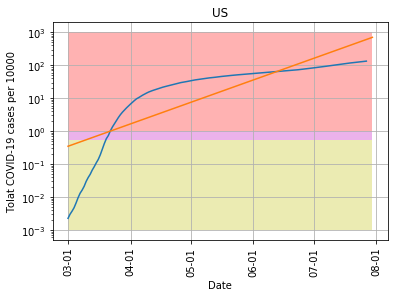

In [1537]:
ss1t = plotpred(dfUS1,populationUS,'2020-03-01', '2020-07-30', "pictures/coronaUS.png", model11, 'US',1000)

In [1538]:
dfAll[dfAll["Country"]=="Latvia"]
dfAll.fillna(0, inplace=True)

North America
            Country        0
229  European Union  0.09521


(0, 0.15)

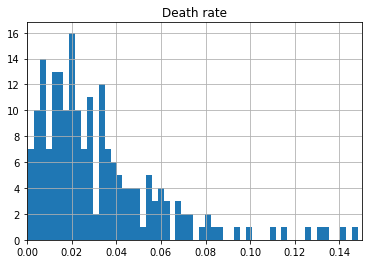

In [1539]:
dfT1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
print(dfTT.Country[0])
print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
hist = dfTTh[dfTTh[0]>0].hist(bins=9*12)
plt.title("Death rate")
plt.xlim([0,0.15])

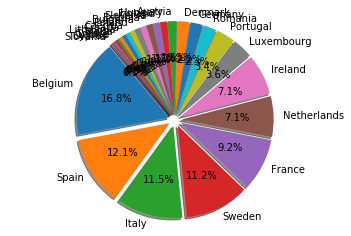

In [1540]:
cLst = countriesEU
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
#dfD1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["Deathsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfTTh = dfTT.sort_values(by=["Deathsper1Mpop"], ascending=False)
dfTTh.rename(columns={0: "DeathRate"})
#hist = dfTTh.hist(bins=9*16)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])
#plt.show()
#import matplotlib.pyplot as plt

labels = dfTTh.Country.tolist()#'apple', 'banana', 'cherry', 'durian', 'elderberries', 'figs', 'grapes'
sizes = dfTTh.Deathsper1Mpop.values#[32, 20, 15, 10, 10, 8, 5]

p = plt.pie(sizes, labels=labels, explode=(.07,)*len(sizes), autopct='%1.1f%%', startangle=130, shadow=True)
plt.axis('equal')

            
plt.show()

In [1541]:
dfTTh.head()

,Country,Deathsper1Mpop
40,Belgium,847.0
15,Spain,608.0
21,Italy,581.0
35,Sweden,564.0
25,France,463.0


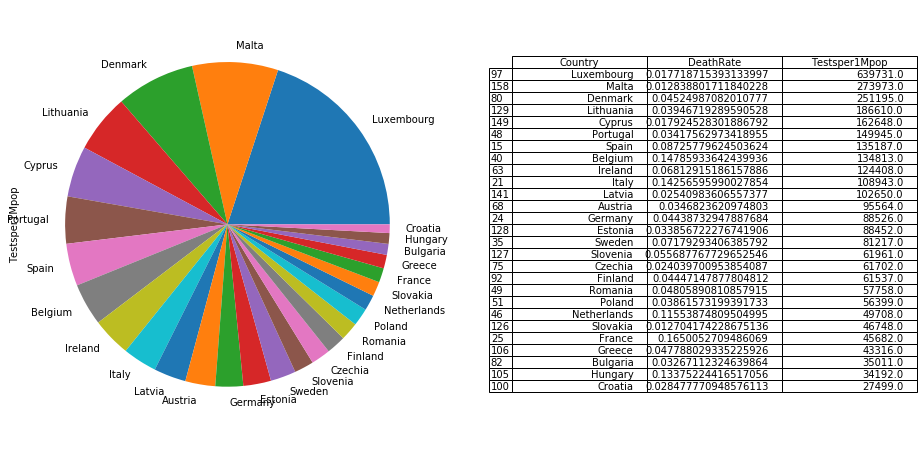

In [1542]:
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=["Testsper1Mpop"], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
#import matplotlib.pyplot as plt
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfTTh.plot.pie(y=["Testsper1Mpop"],ax=ax1,labels=dfTTh['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfTTh, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate2.png")
plt.show()

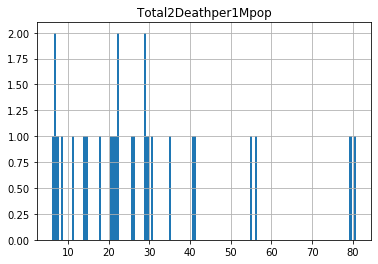

In [1543]:
dfD1 = dfAll[dfAll['Country'].isin(cLst)]#[dfAll["Total Cases"]>0]
dfDD = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"],dfD1["Deathsper1Mpop"]], axis=1)
dfDD2 = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"]/dfD1["Testsper1Mpop"]], axis=1)
dfDD = dfDD[dfDD["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfDD1 = pd.concat([dfDD["Country"],dfDD["TotCasesper1Mpop"]/dfDD["Deathsper1Mpop"]], axis=1)
dfDDh = dfDD1.sort_values(by=[0], ascending=False)
dfDDh=dfDDh.rename(columns={0:"Total2Deathper1Mpop"})
dfDDh2=dfDD2.rename(columns={0:"Cases2Testsper1Mpop"})
hist = dfDDh.hist(bins=9*15)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])

In [1544]:
dfDD.head()

,Country,TotCasesper1Mpop,Deathsper1Mpop
15,Spain,6969.0,608.0
21,Italy,4074.0,581.0
24,Germany,2475.0,110.0
25,France,2804.0,463.0
35,Sweden,7858.0,564.0


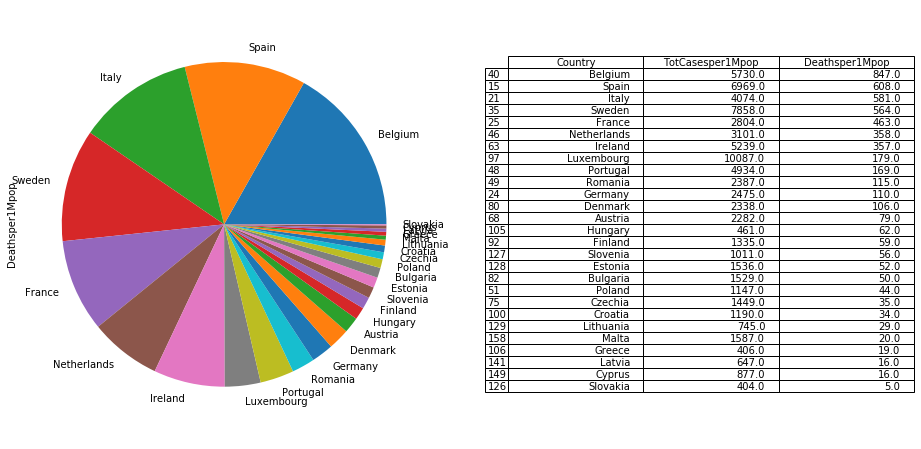

In [1545]:
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDD = dfDD.sort_values(by=['Deathsper1Mpop'], ascending=False)
dfDD.plot.pie(y='Deathsper1Mpop',ax=ax1,labels=dfDD['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDD, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate1.png")
plt.show()

In [1546]:
dfAll.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,0.0,North America,5201390,5474.0,209681.0,393.0,2619014.0,"+5,404",2372695,26296.0,0.0,0.0,0.0,0.0,0,North America,\n,0,0
1,0.0,South America,3792033,4669.0,135667.0,122.0,2541259.0,309,1115107,14309.0,0.0,0.0,0.0,0.0,0,South America,\n,0,0
2,0.0,Asia,3979309,8046.0,91316.0,144.0,2886791.0,"+13,483",1001202,19570.0,0.0,0.0,0.0,0.0,0,Asia,\n,0,0
3,0.0,Europe,2806724,6774.0,201832.0,168.0,1687010.0,"+10,069",917882,5255.0,0.0,0.0,0.0,0.0,0,Europe,\n,0,0
4,0.0,Africa,864139,45.0,18222.0,4.0,510111.0,22,335806,1094.0,0.0,0.0,0.0,0.0,0,Africa,\n,0,0


In [1547]:
dfDDh2.head()

,Country,Cases2Testsper1Mpop
15,Spain,0.051551
21,Italy,0.037396
24,Germany,0.027958
25,France,0.061381
35,Sweden,0.096753


In [1548]:
dfDDh2 = dfDDh2.sort_values(by=["Cases2Testsper1Mpop"], ascending=False)

     Country  Cases2Testsper1Mpop
      Sweden             0.096753
 Netherlands             0.062384
      France             0.061381
       Spain             0.051551
    Bulgaria             0.043672
     Croatia             0.043274
     Belgium             0.042503
     Ireland             0.042111
     Romania             0.041328
       Italy             0.037396
    Portugal             0.032905
     Germany             0.027958
     Austria             0.023879
     Czechia             0.023484
     Finland             0.021694
      Poland             0.020337
     Estonia             0.017365
    Slovenia             0.016317
  Luxembourg             0.015768
     Hungary             0.013483
      Greece             0.009373
     Denmark             0.009308
    Slovakia             0.008642
      Latvia             0.006303
       Malta             0.005793
      Cyprus             0.005392
   Lithuania             0.003992


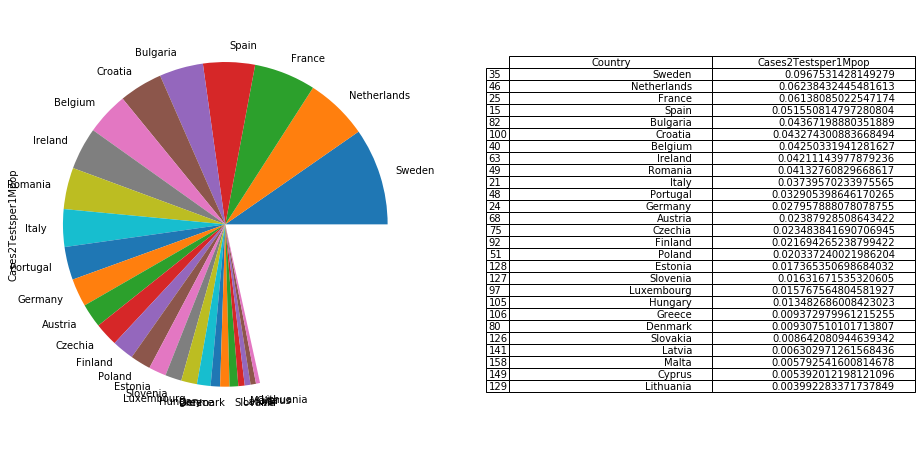

In [1549]:
print (dfDDh2[dfDDh2["Cases2Testsper1Mpop"]<1000].to_string(index=False))
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDDh2.plot.pie(y='Cases2Testsper1Mpop',ax=ax1,labels=dfDDh2['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDDh2, loc='center')
#tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.show()

In [1550]:
dfT1 = dfAll
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
dfTT[dfTT[0]>=0.000001].sort_values(by=[0], ascending=True)
#dfTT[dfTT.Country=="France"]

,Country,0,Testsper1Mpop
47,Singapore,0.000527,199883.0
29,Qatar,0.001506,169953.0
147,Uganda,0.001773,5723.0
69,Nepal,0.002560,22613.0
169,Burundi,0.002646,1139.0
...,...,...,...
40,Belgium,0.147859,134813.0
16,UK,0.152474,220601.0
25,France,0.165005,45682.0
216,MS Zaandam,0.222222,0.0


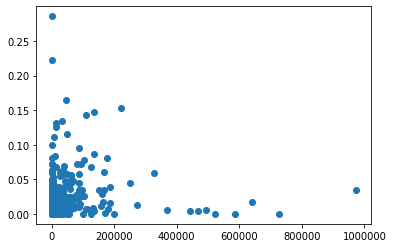

In [1551]:
plt.plot(dfTTh["Testsper1Mpop"],dfTTh['DeathRate'],'o')

/usr/local/lib/python3.7/site-packages/matplotlib/patches.py:715: RuntimeWarning: invalid value encountered in double_scalars
  self._x1 = self._x0 + self._width
/usr/local/lib/python3.7/site-packages/matplotlib/projections/polar.py:55: RuntimeWarning: invalid value encountered in greater_equal
  r = np.where(r >= 0, r, np.nan)


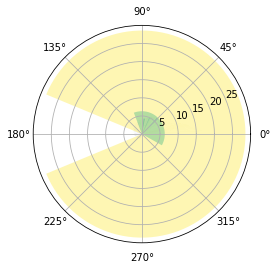

In [1552]:
import numpy as np
import matplotlib.pyplot as plt


# Fixing random state for reproducibility
np.random.seed(19680801)

# Compute pie slices
N = len(dfTTh)
theta = np.linspace(0.0, 2*np.pi, N, endpoint=False)
radii = 100 * dfTTh['DeathRate']
width = 2*np.pi* 3.5/ dfTTh["Testsper1Mpop"]
colors = plt.cm.viridis(radii / 10.)

ax = plt.subplot(111, projection='polar')
ax.bar(theta, radii, width=width, bottom=0.0, color=colors, alpha=0.35)

plt.show()

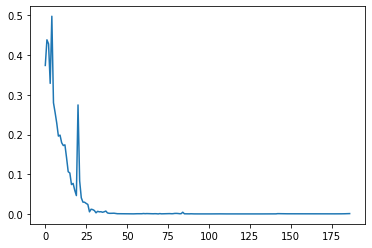

In [1553]:
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)))

In [1200]:
#np.diff(np.log(dfCN["cases"].values))

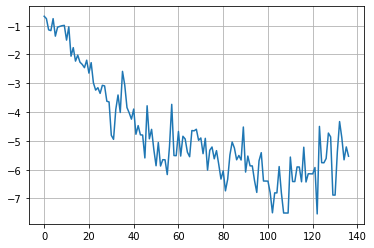

In [1554]:
plt.plot(range(len(dfLT["cases"].values[3:])-1),np.log(np.diff(np.log(dfLT["cases"].values[3:]))))
plt.grid()

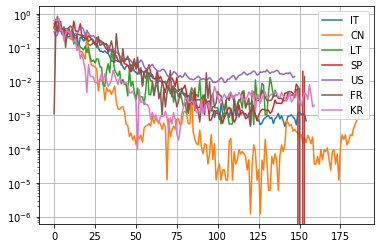

In [1555]:
plt.plot(range(len(dfIT["cases"].values)-1),np.diff(np.log(dfIT["cases"].values))[:],label='IT')
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)),label='CN')
plt.plot(range(len(dfLT["cases"].values)-4),np.diff(np.log(dfLT["cases"].values))[3:],label='LT')
plt.plot(range(len(dfSP["cases"].values)-1),np.diff(np.log(dfSP["cases"].values)),label='SP')
plt.plot(range(len(dfUS["cases"].values)-1),np.diff(np.log(dfUS["cases"].values)),label='US')
plt.plot(range(len(dfFR["cases"].values)-10),np.diff(np.log(dfFR["cases"].values))[9:],label='FR')
plt.plot(range(len(dfKR["cases"].values)-4),np.diff(np.log(dfKR["cases"].values))[3:],label='KR')
plt.yscale('log')
plt.grid()
plt.legend()
plt.show()

148 148
coefficient of determination: 0.7115160738694015
intercept: -11.341939186977863
slope: [-0.07084348]


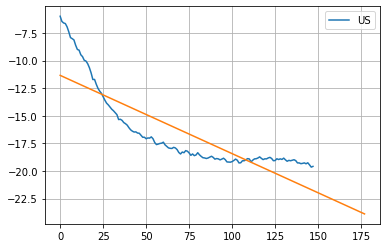

In [1556]:
y = np.log(np.diff(dfUS["cases"].values)[:]/dfUS["cases"].values[1:]**2)
x = np.array(range(len(dfUS["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='US')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+30) 
plt.plot(range(len(x)+30),y_pred11)
plt.grid()
plt.legend()
plt.savefig("pictures/logdiffUS.png")
plt.show()

In [1557]:
#np.diff(dfIT["cases"])

155 155
coefficient of determination: 0.8292955870181316
intercept: -11.243512101175902
slope: [-0.06826971]


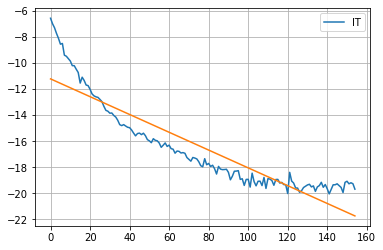

In [1558]:
y = np.log(np.diff(dfIT["cases"].values)[:]/dfIT["cases"].values[1:]**2)
x = np.array(range(len(dfIT["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='IT')
y_pred12 = model.intercept_ + model.coef_ * range(len(x)) 
plt.plot(x,y_pred12)
plt.grid()
plt.legend()
plt.show()

In [1559]:
#model11.coef_

In [1560]:
#np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)

137 137
coefficient of determination: 0.8604677764810476
intercept: -15.885521592181645
slope: [-0.04222264]


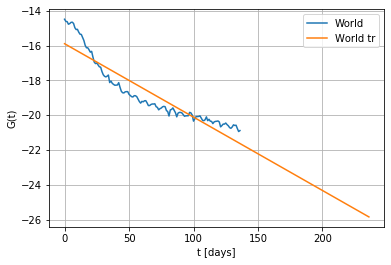

In [1561]:
y = np.log(np.diff(dfW["cases"].values)[50:]/dfW["cases"].values[51:]**2)
x = np.array(range(len(dfW["cases"].values[50:])-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='World')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+100)
plt.plot(range(len(x)+100),y_pred11,label='World tr')
plt.legend()
plt.xlabel('t [days]')
plt.ylabel('G(t)')
plt.grid()
plt.savefig("pictures/logdifflogcoronaW.png")

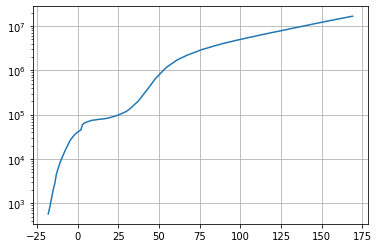

In [1562]:
waveform_1 = dfW['cases'].values
waveform_A = dfW['active'].values
t = np.arange(-18,len(waveform_1)-18)
plt.plot(t, waveform_1) 
plt.yscale("log")
plt.grid()
plt.show()

In [1563]:
dfW['cases'].values

array([     580,      845,     1317,     2015,     2800,     4581,
           6058,     7813,     9823,    11950,    14553,    17391,
          20630,    24545,    28266,    31439,    34876,    37552,
          40553,    43099,    45134,    59287,    64438,    67100,
          69197,    71329,    73332,    75184,    75700,    76677,
          77673,    78651,    79205,    80087,    80828,    81820,
          83112,    84615,    86604,    88585,    90443,    93016,
          95314,    98425,   102050,   106099,   109991,   114381,
         118948,   126214,   134576,   145483,   156653,   169593,
         182490,   198238,   218822,   244933,   275597,   305036,
         337489,   378860,   422629,   471035,   531864,   596366,
         663079,   723279,   784738,   858355,   936237,  1016330,
        1117928,  1203058,  1274578,  1347566,  1432869,  1519195,
        1605277,  1700004,  1780713,  1853505,  1925330,  2000065,
        2084633,  2183942,  2252370,  2332650,  2407467,  2482

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in true_divide
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


[ 6.63096226e+07  5.71860115e-01 -2.38962427e+02  1.61412043e-02]


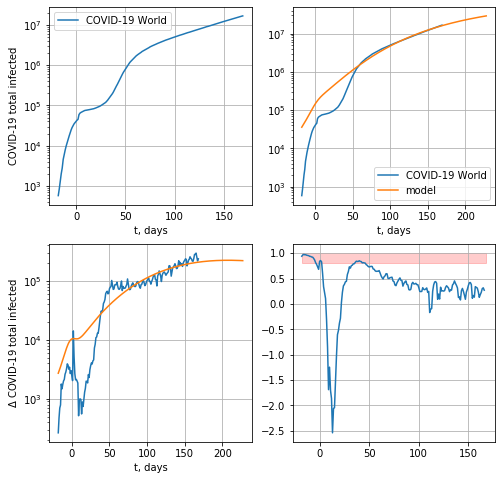

271396.9359661012


In [1564]:
def model(t, coeffs):
    coeffsCN = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
    #coeffsCN = [2.06174475e+06, 1.67277852e-01, 5.36255447e+01]
    return coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]) + coeffsCN[0]/(1 + np.exp( - coeffsCN[1] * (t - coeffsCN[2])))

x0 = np.array([2.06174475e+06, 1.67277852e-01, 5.36255447e+01, 0.9 ], dtype=float)
#x0 = np.array([8.08757112e+04,  2.24114193e-01, -6.94900467e-01 ], dtype=float)
def residuals(coeffs, y, t):
    return y - model(t, coeffs)
from scipy.optimize import leastsq
x, flag = leastsq(residuals, x0, args=(waveform_1, t))
print(x)
tt = np.arange(-18,len(waveform_1)-18+59)
fig, ((ax3,ax1),(ax2,ax4)) = plt.subplots(2,2,figsize=(8,8), sharex=False, sharey=False)
ax3.plot(t, waveform_1) 
ax3.legend(['COVID-19 World']) 
ax3.set_xlabel('t, days')
ax3.set_yscale("log")
ax3.set_ylabel(r'COVID-19 total infected')
ax3.grid()
ax1.plot(t, waveform_1, tt, model(tt, x)) 
ax1.legend(['COVID-19 World', 'model']) 
ax1.set_xlabel('t, days')
ax1.set_yscale("log")
ax1.grid()
ax2.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(model(tt, x)))
ax2.set_ylabel(r'$\Delta$ COVID-19 total infected')
ax2.set_yscale("log")
ax2.grid()
ax2.set_xlabel('t, days')
z = np.diff(moving_average(waveform_A, n=3) )/np.diff(moving_average(waveform_1, n=3))
ax4.plot(t[:-3],z)
#ax4.axhline(y=2.2587741081036339/2, color='r')
ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
#ax4.set_yscale("log")
ax4.grid()
plt.savefig("pictures/covidworld.png")

plt.show()
print(np.std(residuals(x, waveform_1, t)))
#expPopWorld = x[0]
expPopWorld = 2.67152730e+06

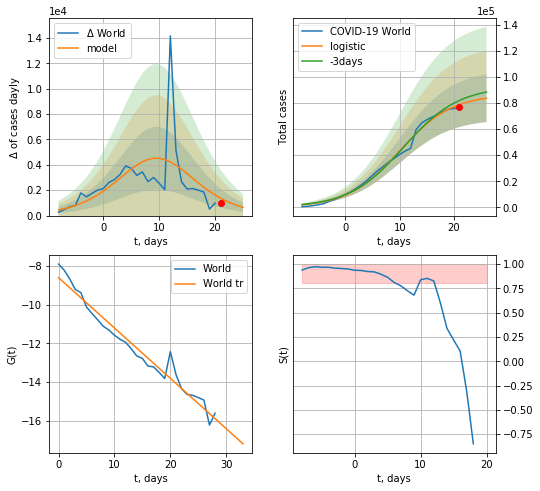

World data at: 2020-07-27
+3 day model MAPE: 0.04256770161128604
model: logistic
coeffs:  [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.2178111789766563
forecast at the end of period: +5 days
	 deltaDaycases:  651
	 total cases:  83561 ± 18200
	 total death:  3294 ± 2152
trend coefficient of determination: 0.960820
 intercept: -8.598458
 slope: -0.260482


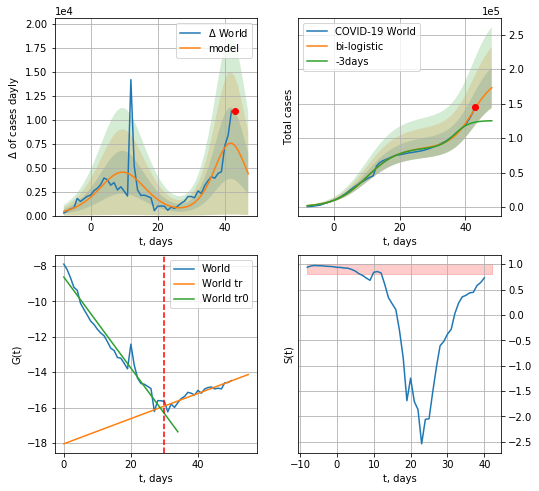

World data at: 2020-07-27
+3 day model MAPE: 0.21572977405755475
model: bi-logistic
coeffs:  [1.02227620e+05 2.95650803e-01 4.22367007e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.16992860967254475
forecast at the end of period: +5 days
	 deltaDaycases:  4357
	 total cases:  172932 ± 29386
	 total death:  6818 ± 3475
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend coefficient of determination: 0.868835
 intercept: -18.049568
 slope: 0.071157


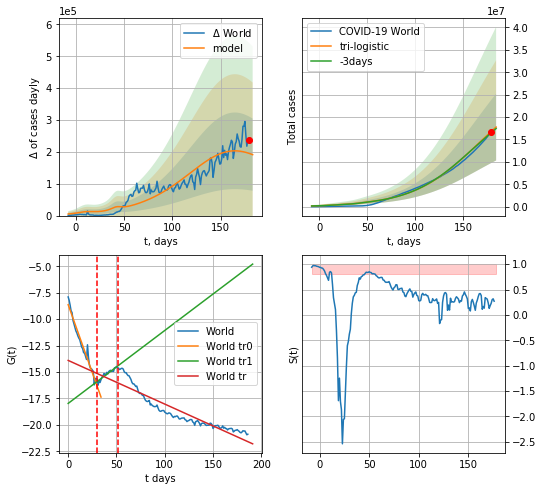

World data at: 2020-07-27
+3 day model MAPE: 0.016042985892827478
model: tri-logistic
coeffs:  [2.47999784e+07 3.04101986e-02 1.60557253e+02] [8.64735804e+04 2.09600360e-01 9.98515269e+00 1.02227620e+05
 2.95650803e-01 4.22367007e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.41967479715672423
forecast at the end of period: +5 days
	 deltaDaycases:  191225
	 total cases:  17765431 ± 7455703
	 total death:  700453 ± 881887
tri-logistic approximation splitting points: 30,52
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend1 coefficient of determination: 0.872494
 intercept: -17.970431
 slope: 0.068998
trend coefficient of determination: 0.857837
 intercept: -13.903283
 slope: -0.041310


In [1565]:
vL = 30
x = forecast("World",dfW[:vL],d1,7*18-dT,1.0,False)
xx = forecast2("World",dfW[:52],d1,7*18-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("World",dfW,d1,7*18-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,52])

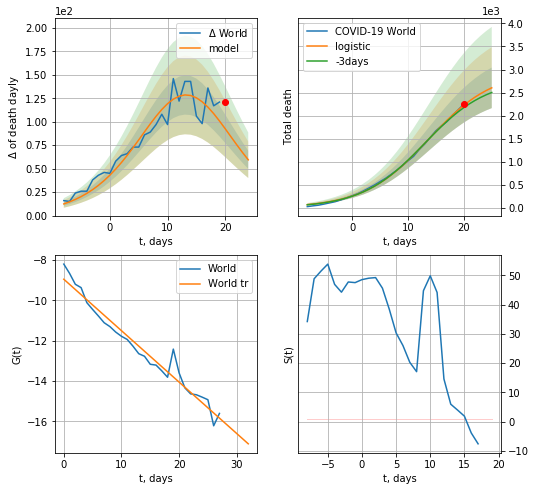

World data at: 2020-07-27
+3 day model MAPE: 0.027312195038559757
model: logistic
coeffs:  [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.16928081921473714
forecast at the end of period: +5 days
	 total death:  2602 ± 440
trend coefficient of determination: 0.959176
 intercept: -8.958870
 slope: -0.254930


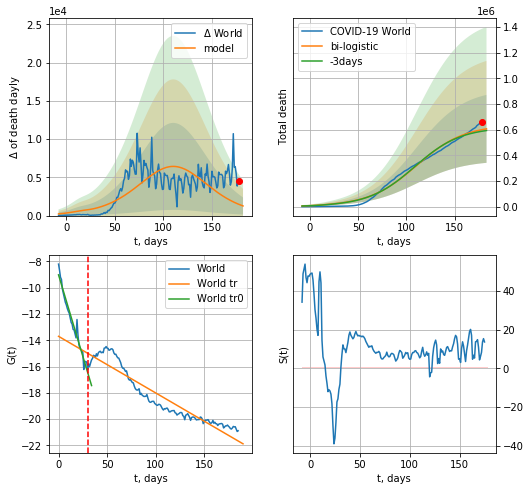

World data at: 2020-07-27
+3 day model MAPE: 0.020857048945434654
model: bi-logistic
coeffs:  [6.35160314e+05 4.04942034e-02 1.10629437e+02] [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.43699500152320414
forecast at the end of period: +5 days
	 deltaDaydeath:  1259
	 total death:  605951 ± 264797
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.960969
 intercept: -9.026339
 slope: -0.247583
trend coefficient of determination: 0.891663
 intercept: -13.700700
 slope: -0.043022


In [1566]:
vL = 30
vL1=52
x = forecast("World",dfW[1:vL],d1,7*18-dT,1.0,False,cases='death')
xx = forecast2("World",dfW[1:],d1,7*18-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("World",dfW,d1,7*20-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

In [1567]:
#vL = 30
#x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
#xx = forecast2("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.7],vL=vL)
#trend(dfW,"W",10)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


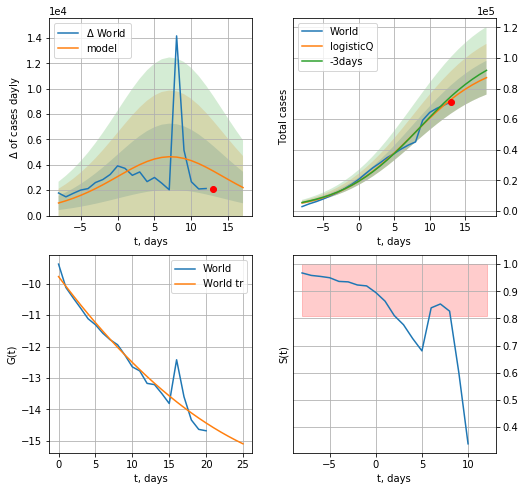

World data at: 2020-07-27
+3 day model MAPE: 0.031856
model: logisticQ
coeffs: [ 9.98643061e+04  1.79654926e-05  7.63889443e+00 -1.03374511e+04]
rational stdev: 0.126959
forecast at the end of period: +5 days
	 deltaDaycases: 2209
	 total cases: 87179 ± 11068
	 total death: 3437 ± 1309
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


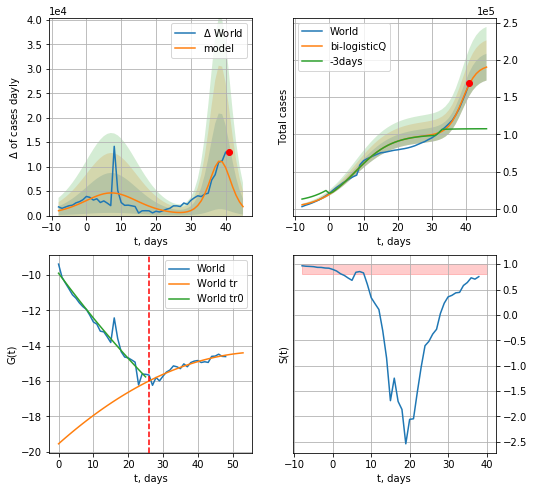

World data at: 2020-07-27
+3 day model MAPE: 0.635592
model: bi-logisticQ
coeffs: [ 9.37621522e+04  2.37764402e-05  3.89555041e+01 -2.00834102e+04]
rational stdev: 0.094698
forecast at the end of period: +5 days
	 deltaDaycases: 1826
	 total cases: 190435 ± 18033
	 total death: 7508 ± 2132
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.893677
 intercept_: -19.558019139425994
 coeffs_: [ 0.          0.17538587 -0.00147405]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


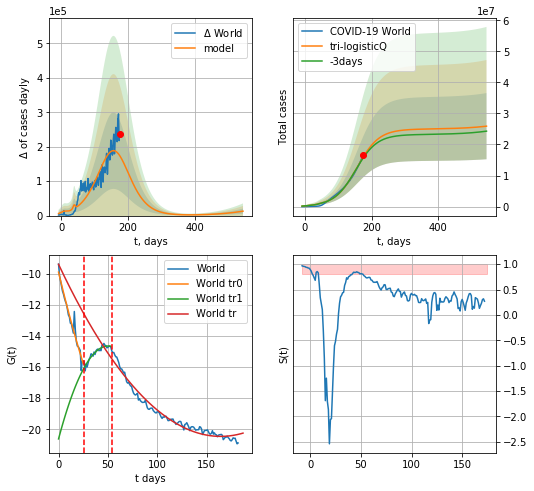

World data at: 2020-07-27
+3 day model MAPE: 0.020473
model: tri-logisticQ
coeffs: [ 2.47633700e+07  2.33051720e-07  1.56484796e+02 -1.30535755e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.411184
forecast at the end of period: +369 days
	 deltaDaycases: 12840
	 total cases: 25902196 ± 10650561
	 total death: 1021269 ± 1259787
tri-logisticQ approximation splitting points: 26,54
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.900515
 intercept_: -20.622215746086294
 coeffs_: [ 0.          0.23801537 -0.00236922]
trend coefficient of determination: 0.969689
 intercept_: -9.386939480337567
 coeffs_: [ 0.         -0.13476422  0.00041004]


In [1568]:
vL=30 - 4
vL1=59 - 5
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
x = forecastRRR("World",dfW[4:vL],d1,7*18-dT,1.0,False)
xx = forecast2RRR("World",dfW[4:vL1],d1,7*18-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*70-dT, xx, shift=1.,addpred=True,xcoef=koreaCoeffs,vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


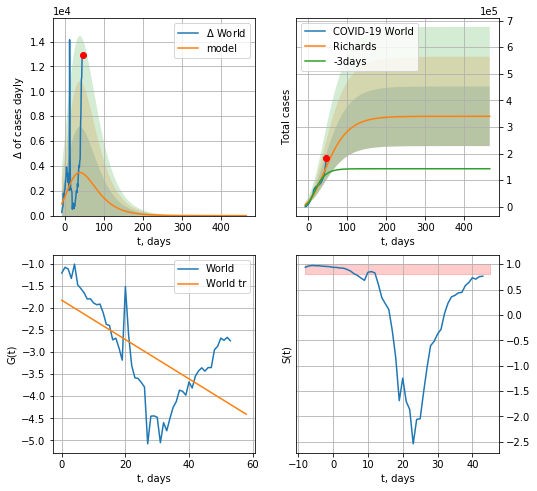

World data at: 2020-07-27
+3 day model MAPE: 0.241623
model: Richards
coeffs: [ 3.40076103e+05  3.50838629e+00 -1.35190892e+02  7.92527881e-03]
rational stdev: 0.329278
forecast at the end of period: +419 days
	 deltaDaycases: 0
	 total cases: 340073 ± 111978
	 total death: 13408 ± 13244
trend coefficient of determination: 0.389869
 intercept: -1.829859
 slope: -0.044449


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


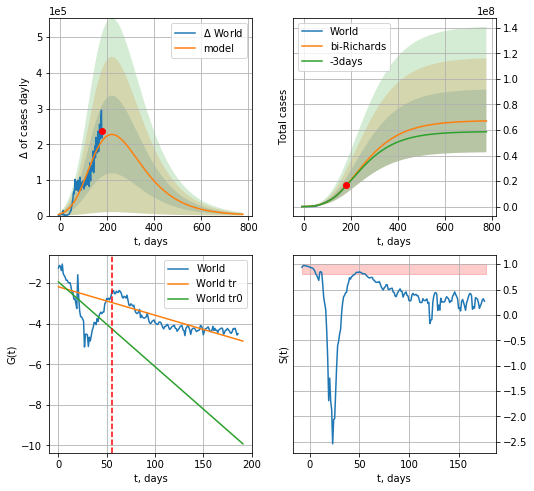

World data at: 2020-07-27
+3 day model MAPE: 0.012585
model: bi-Richards
coeffs: [ 6.71675755e+07  6.52477773e-01 -2.39195931e+02  1.42042813e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.365564
forecast at the end of period: +599 days
	 deltaDaycases: 3537
	 total cases: 67128526 ± 24539748
	 total death: 2646736 ± 2902651
bi-Richards approximation splitting point: 55
trend coefficient of determination: 0.359246
 intercept: -1.940230
 slope: -0.041771
trend coefficient of determination: 0.727597
 intercept: -2.182432
 slope: -0.013998


In [1569]:
vL = 55
x = forecastRR("World",dfW[:vL],d1,60*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("World",dfW[:],d1,80*9-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

188


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


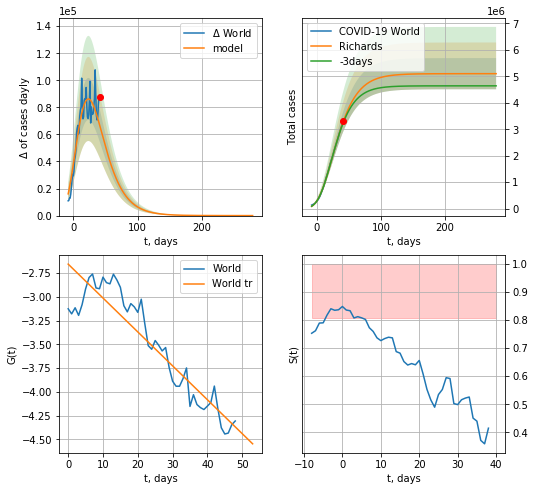

World data at: 2020-07-27
+3 day model MAPE: 0.014871
model: Richards
coeffs: [ 5.10253376e+06  1.04389323e+00 -4.20529569e+01  4.49999517e-02]
rational stdev: 0.115528
forecast at the end of period: +239 days
	 deltaDaycases: 1
	 total cases: 5102503 ± 589480
	 total death: 201180 ± 69725
trend coefficient of determination: 0.854894
 intercept: -2.655671
 slope: -0.035657


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


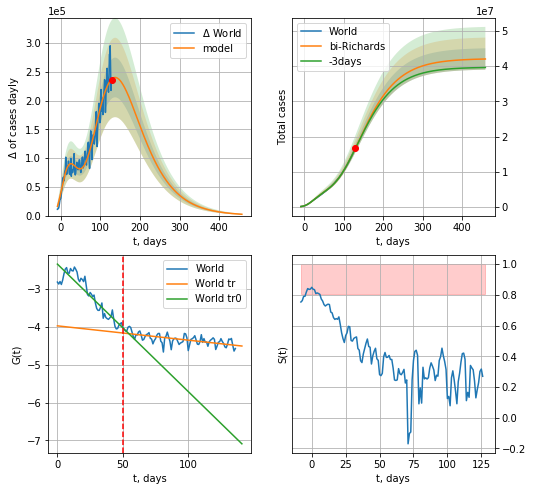

World data at: 2020-07-27
+3 day model MAPE: 0.005871
model: bi-Richards
coeffs: [ 3.70716333e+07  9.31929820e-01 -8.53235999e+01  1.89926846e-02]
rational stdev: 0.072329
forecast at the end of period: +329 days
	 deltaDaycases: 2313
	 total cases: 42044395 ± 3041033
	 total death: 1657722 ± 359704
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.843476
 intercept: -2.341765
 slope: -0.033665
trend coefficient of determination: 0.413700
 intercept: -3.972602
 slope: -0.003778


In [1570]:
print (len(dfW))
vL = 100
x = forecastRR("World",dfW[50:vL],d1,40*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("World",dfW[50:],d1,50*9-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-50)
#x = forecastQR("World",dfW[50:],d1,30*9-dT,1.0,addpred=False)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


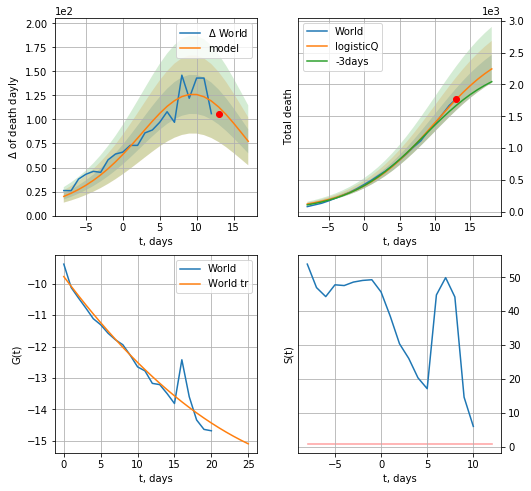

World data at: 2020-07-27
+3 day model MAPE: 0.067194
model: logisticQ
coeffs: [ 2.67018329e+03  8.28113131e-04  9.49649422e+00 -2.18461064e+02]
rational stdev: 0.098000
forecast at the end of period: +5 days
	 total death: 2245 ± 220
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


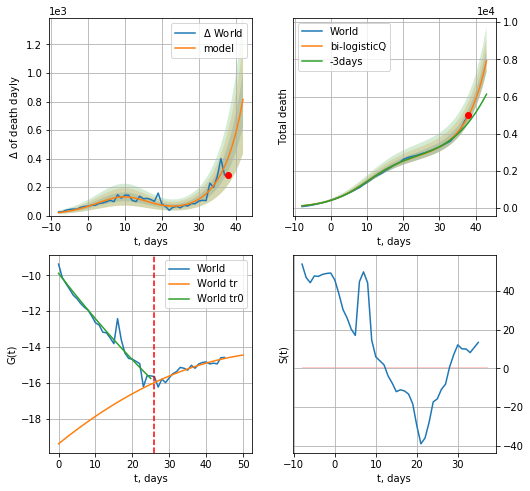

World data at: 2020-07-27
+3 day model MAPE: 0.105641
model: bi-logisticQ
coeffs: [ 6.44010385e+06  6.89934025e-04  7.95796325e+01 -2.38740330e+02]
rational stdev: 0.076590
forecast at the end of period: +5 days
	 total death: 7922 ± 606
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.866834
 intercept_: -19.41123113056416
 coeffs_: [ 0.          0.16686573 -0.0013545 ]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp


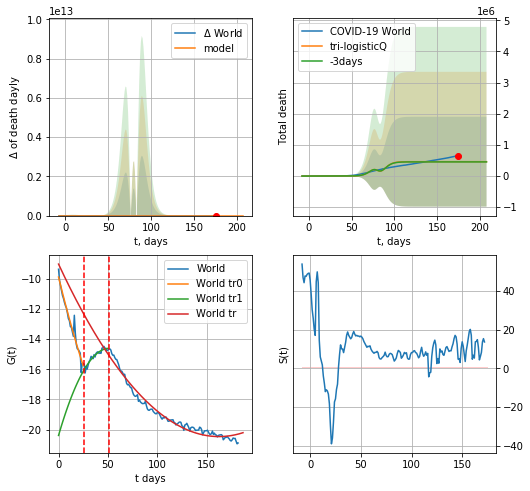

World data at: 2020-07-27
+3 day model MAPE: 0.016235
model: tri-logisticQ
coeffs: [-5.98125574e+06  1.60330520e-03 -7.23889742e+01  7.94647879e+01]
rational stdev: 3.124769
forecast at the end of period: +33 days
	 total death: 461518 ± 1442138
tri-logisticQ approximation splitting points: 26,51
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.890965
 intercept_: -20.382525077358043
 coeffs_: [ 0.          0.22422642 -0.00217733]
trend coefficient of determination: 0.971816
 intercept_: -9.03288824624048
 coeffs_: [ 0.         -0.14054284  0.0004322 ]


In [1571]:
vL=30 - 4
vL1=51
x = forecastRRR("World",dfW[4:vL],d1,7*18-dT,1.0,False,cases='death')
xx = forecast2RRR("World",dfW[4:vL1],d1,7*18-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*22-dT, xx, shift=1.,addpred=False,xcoef=[.35,.5,4.,1.],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


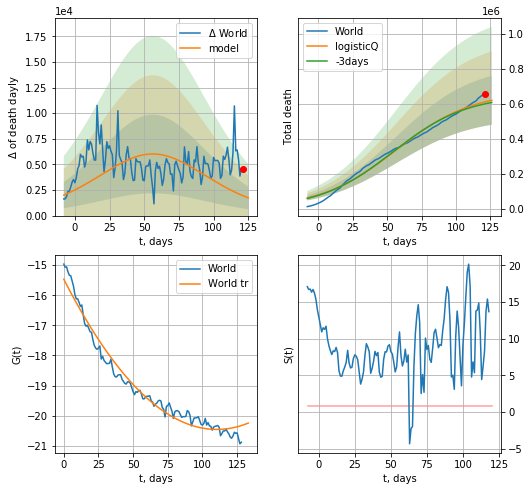

World data at: 2020-07-27
+3 day model MAPE: 0.019298
model: logisticQ
coeffs: [ 6.71326020e+05  3.58852392e-07  5.65850075e+01 -9.98297773e+04]
rational stdev: 0.225820
forecast at the end of period: +5 days
	 total death: 619921 ± 139990
trend coefficient of determination: 0.969689
 intercept_: -15.468249856152223
 coeffs_: [ 0.         -0.0904936   0.00041014]


In [1572]:
x = forecastRRR("World",dfW[58:],d1,7*18-dT,1.0,False,cases='death')

In [1573]:
#trend(dfSP,'SP',10)

In [1574]:
#vL = len(dfSP[:])-16-dT
#x = forecast('Spain',dfSP[:vL],d1,30-dT,1.0)
#xx = forecast2('Spain',dfSP,d1,7*6-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.8],vL=vL)

SP
           date   cases  active    death
149 2020-07-23  317246       0  28429.0
150 2020-07-24  319501       0  28432.0
151 2020-07-25  321607       0  28432.0
152 2020-07-26  323728       0  28432.0
153 2020-07-27  325862       0  28434.0


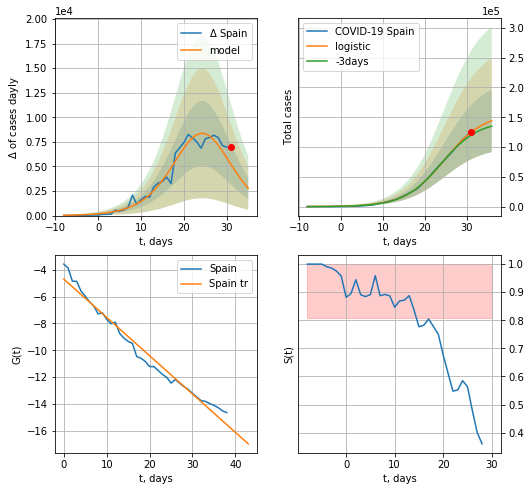

Spain data at: 2020-07-27
+3 day model MAPE: 0.04562670003340739
model: logistic
coeffs:  [1.56957534e+05 2.13812412e-01 2.47399190e+01]
rational stdev:  0.3648922799439526
forecast at the end of period: +5 days
	 deltaDaycases:  2780
	 total cases:  143992 ± 52541
	 total death:  12564 ± 13753
trend coefficient of determination: 0.974785
 intercept: -4.699916
 slope: -0.285083


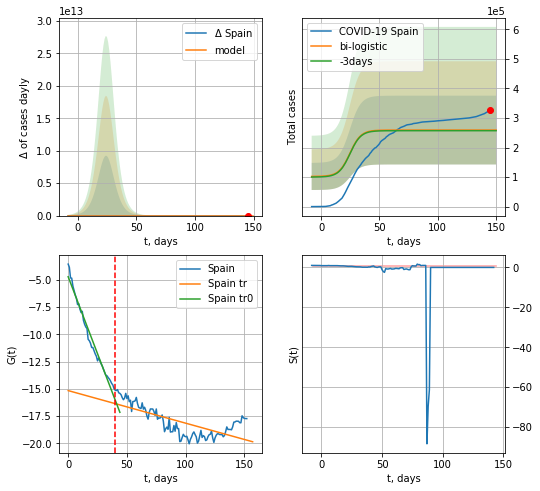

Spain data at: 2020-07-27
+3 day model MAPE: 0.008231013396674923
model: bi-logistic
coeffs:  [ 8.16338601e+04 -6.90181126e+00  1.77301494e+02] [1.56957534e+05 2.13812412e-01 2.47399190e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.449255337448411
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  258999 ± 116357
	 total death:  22599 ± 30458
bi-logistic approximation splitting point: 40
trend0 coefficient of determination: 0.974598
 intercept: -4.739484
 slope: -0.281959
trend coefficient of determination: 0.508788
 intercept: -15.158239
 slope: -0.029822


In [1576]:
try:
    dfSP = read_df(pd.DataFrame(),"SP")
    vL = 40#len(dfSP[:])-7-dT
    x = forecast('Spain',dfSP[:vL],d1,7*18-dT,1.0,cases='cases')
    xx = forecast2('Spain',dfSP[:],d1,7*18-dT,x,1.0,addpred=True,xcoef=[.25,1.,1.6],vL=vL,cases='cases')
except:
    print("Exception occurs")

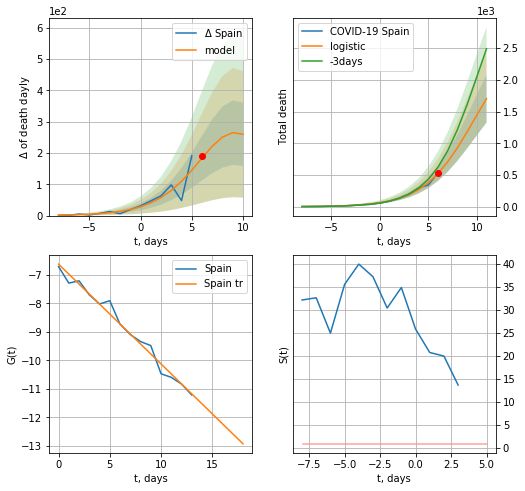

Spain data at: 2020-07-27
+3 day model MAPE: 0.19925761196778652
model: logistic
coeffs:  [2.74529161e+03 3.87912521e-01 9.73356211e+00]
rational stdev:  0.22139702081914042
forecast at the end of period: +5 days
	 total death:  1703 ± 377
trend coefficient of determination: 0.980020
 intercept: -6.621221
 slope: -0.350134


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:251: RuntimeWarning: invalid value encountered in true_divide


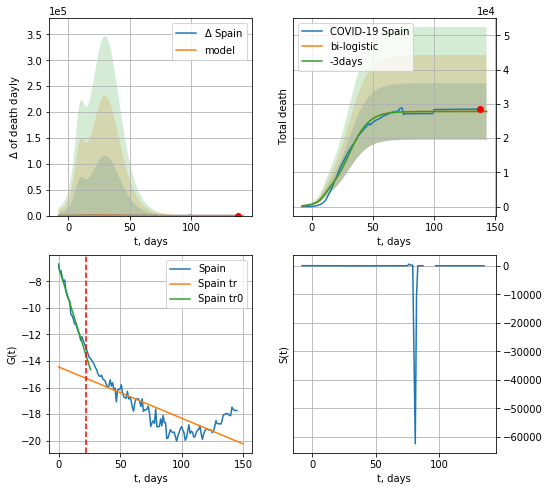

Spain data at: 2020-07-27
+3 day model MAPE: 0.0009820861723190918
model: bi-logistic
coeffs:  [2.50310641e+04 1.21634886e-01 3.03659155e+01] [2.74529161e+03 3.87912521e-01 9.73356211e+00]
rational stdev:  0.29585655941828914
forecast at the end of period: +5 days
	 deltaDaydeath:  0
	 total death:  27776 ± 8217
bi-logistic approximation splitting point: 22
trend0 coefficient of determination: 0.976968
 intercept: -6.910878
 slope: -0.297821
trend coefficient of determination: 0.623468
 intercept: -14.438754
 slope: -0.038587


In [1577]:
vL = 22#len(dfSP[:])-7-dT
#dfSP = read_df(pd.DataFrame(),"SP")
x = forecast('Spain',dfSP[7:vL],d1,7*18-dT,1.0,cases='death')
xx = forecast2('Spain',dfSP[7:],d1,7*18-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.8],vL=vL,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


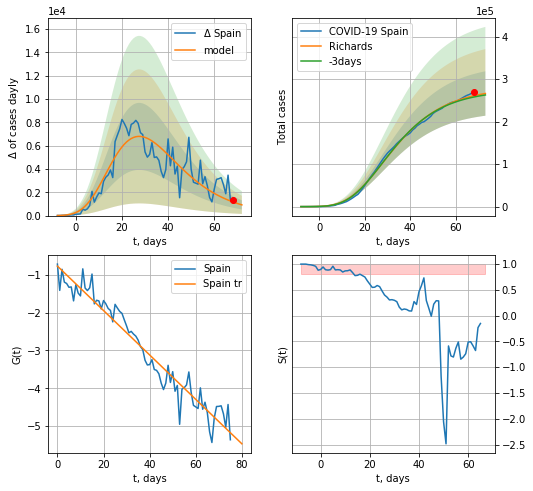

Spain data at: 2020-07-27
+3 day model MAPE: 0.011823
model: Richards
coeffs: [ 2.79968052e+05  9.79095948e+00 -4.74759581e+01  6.76503112e-03]
rational stdev: 0.196279
forecast at the end of period: +5 days
	 deltaDaycases: 920
	 total cases: 266157 ± 52241
	 total death: 23224 ± 13675
trend coefficient of determination: 0.941305
 intercept: -0.767274
 slope: -0.058773


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


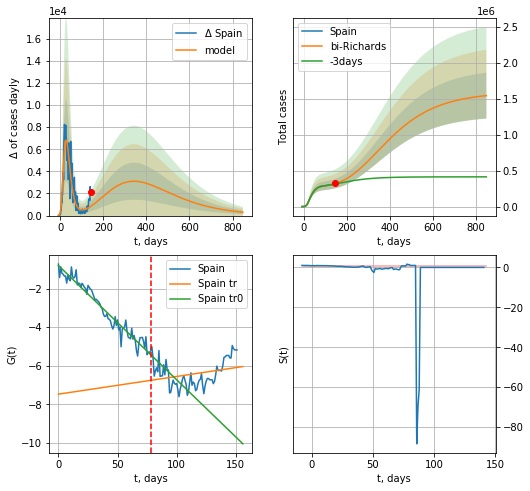

Spain data at: 2020-07-27
+3 day model MAPE: 0.015631
model: bi-Richards
coeffs: [ 1.30889236e+06  5.45514947e-01 -3.39975289e+02  1.19057867e-02]
rational stdev: 0.206364
forecast at the end of period: +705 days
	 deltaDaycases: 305
	 total cases: 1541072 ± 318022
	 total death: 134470 ± 83249
bi-Richards approximation splitting point: 78
trend coefficient of determination: 0.946568
 intercept: -0.802202
 slope: -0.059249
trend coefficient of determination: 0.079888
 intercept: -7.471380
 slope: 0.009171


In [1581]:
vL = 78+1
x = forecastRR('Spain',dfSP[1:vL-1],d1,7*18-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Spain',dfSP[1:],d1,7*118-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-1)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:62: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:62: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:183: RuntimeWarning: invalid value encountered in reduce
  arrmean = umr_sum(arr, axis, dtype, keepdims=True)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


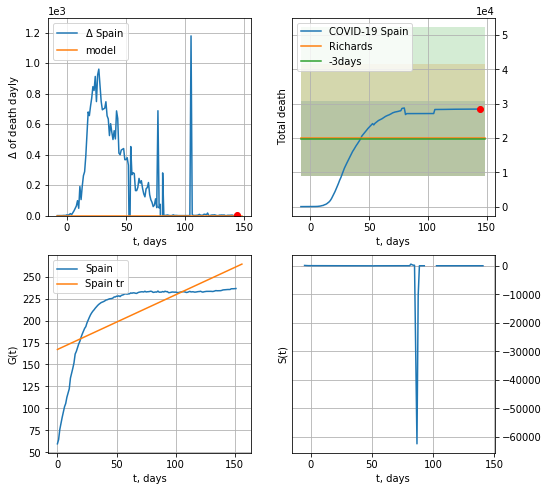

Spain data at: 2020-07-27
+3 day model MAPE: 0.008694
model: Richards
coeffs: [ 1.98700261e+04 -2.67667250e-01 -2.33741667e+01 -1.90182897e+01]
rational stdev: 0.545616
forecast at the end of period: +5 days
	 total death: 19870 ± 10841
trend coefficient of determination: 0.481072
 intercept: 167.074584
 slope: 0.622440


In [1582]:
x = forecastRR('Spain',dfSP[1:],d1,7*18-dT,1.0,addpred=False,xcoef=[.25,1.,3.,1],cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


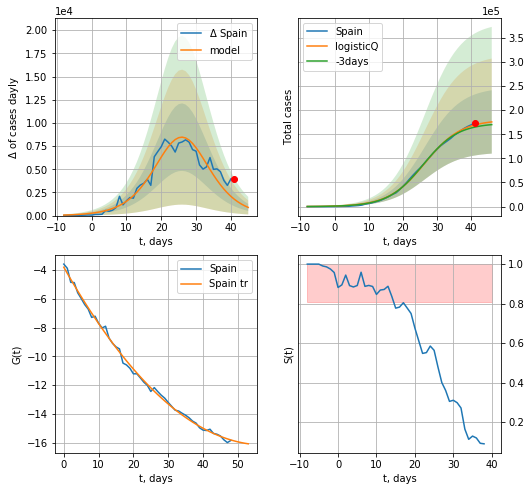

Spain data at: 2020-07-27
+3 day model MAPE: 0.028162
model: logisticQ
coeffs: [ 1.79944312e+05  4.82958618e-06  2.63952862e+01 -3.89568174e+04]
rational stdev: 0.373922
forecast at the end of period: +5 days
	 deltaDaycases: 880
	 total cases: 175572 ± 65650
	 total death: 15320 ± 17185
trend coefficient of determination: 0.997334
 intercept_: -3.7990007659330134
 coeffs_: [ 0.         -0.42831531  0.00370949]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


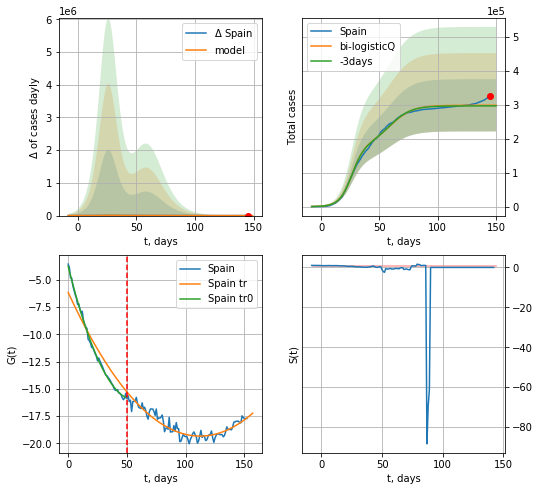

Spain data at: 2020-07-27
+3 day model MAPE: 0.005725
model: bi-logisticQ
coeffs: [ 1.18887345e+05  1.64359298e-07  5.93329264e+01 -6.44538101e+05]
rational stdev: 0.257954
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 298823 ± 77082
	 total death: 26074 ± 20177
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.997131
 intercept_: -3.7751216617675887
 coeffs_: [ 0.         -0.43240435  0.00381547]
trend coefficient of determination: 0.873528
 intercept_: -6.173169442849705
 coeffs_: [ 0.         -0.23431363  0.00104376]


In [1583]:
x = forecastRRR('Spain',dfSP[:50],d1,7*18-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[:],d1,7*18-dT,x,1.0,addpred=False,xcoef=koreaCoeffs,vL=50)#[.35,.5,3.,1])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


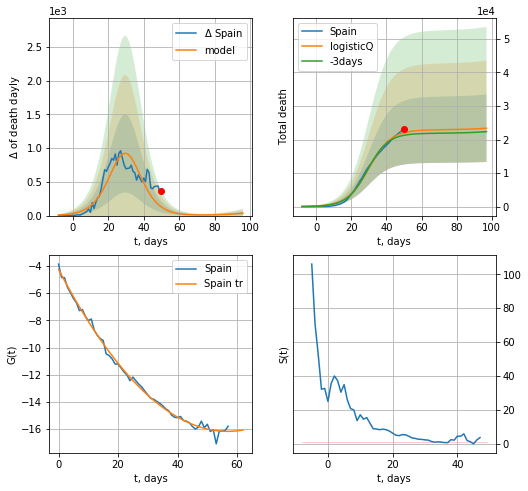

Spain data at: 2020-07-27
+3 day model MAPE: 0.037625
model: logisticQ
coeffs: [ 2.28798060e+04  1.92558820e-06  3.00460867e+01 -8.38208205e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.430820
forecast at the end of period: +47 days
	 total death: 23362 ± 10065
trend coefficient of determination: 0.995937
 intercept_: -4.2575122176431694
 coeffs_: [ 0.         -0.41856419  0.00368029]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:294: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:347: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:347: RuntimeWarning: invalid value encountered in true_divide


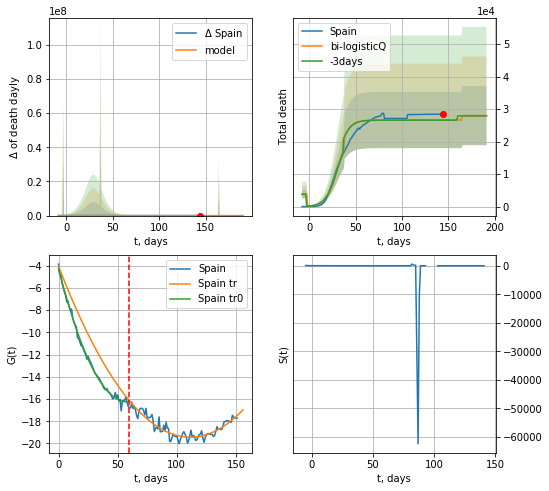

Spain data at: 2020-07-27
+3 day model MAPE: 0.001996
model: bi-logisticQ
coeffs: [ 3.78723062e+03  6.83836978e+00  3.76507434e+01 -2.42784224e+00]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.324857
forecast at the end of period: +47 days
	 total death: 28008 ± 9098
bi-logisticQ approximation splitting point: 60
trend coefficient of determination: 0.995783
 intercept_: -4.28878212009627
 coeffs_: [ 0.         -0.41413346  0.00358475]
trend coefficient of determination: 0.849431
 intercept_: -4.059653268549626
 coeffs_: [ 0.         -0.27598001  0.00123844]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [1584]:
x = forecastRRR('Spain',dfSP[1:60],d1,7*24-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[1:],d1,7*24-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,cases='death',vL=60)

In [1585]:
#x = forecastQR('Spain',dfSP[5:],d1,7*16-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])

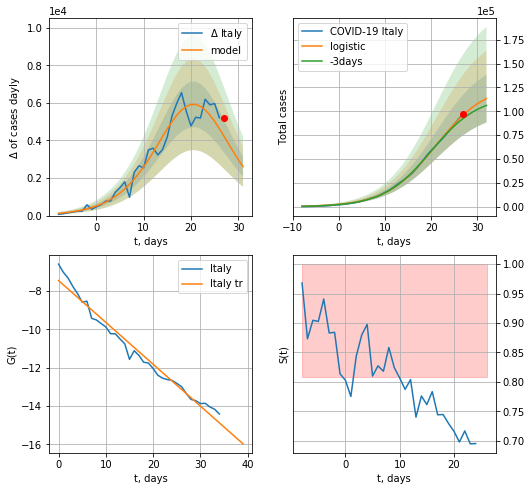

Italy data at: 2020-07-27
+3 day model MAPE: 0.0455783779571316
model: logistic
coeffs:  [1.28139025e+05 1.85112184e-01 2.10100291e+01]
rational stdev:  0.22065596629973358
forecast at the end of period: +5 days
	 deltaDaycases:  2603
	 total cases:  113320 ± 25004
	 total death:  16155 ± 10694
trend coefficient of determination: 0.974872
 intercept: -7.448746
 slope: -0.218671


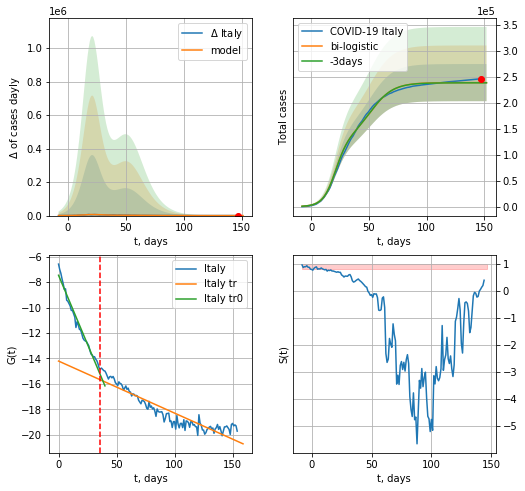

Italy data at: 2020-07-27
+3 day model MAPE: 0.0017333249864373034
model: bi-logistic
coeffs:  [1.10748502e+05 1.01402335e-01 5.15565903e+01] [1.28139025e+05 1.85112184e-01 2.10100291e+01]
rational stdev:  0.1496725661755268
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  238883 ± 35754
	 total death:  34056 ± 15291
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975965
 intercept: -7.466589
 slope: -0.217097
trend coefficient of determination: 0.863139
 intercept: -14.202429
 slope: -0.040857


In [1586]:
vL = 36#len(dfIT)-6-dT
x = forecast('Italy',dfIT[:vL],d1,18*7-dT,1.0)
xx = forecast2('Italy',dfIT,d1,18*7-dT,x,1.0,vL=vL)

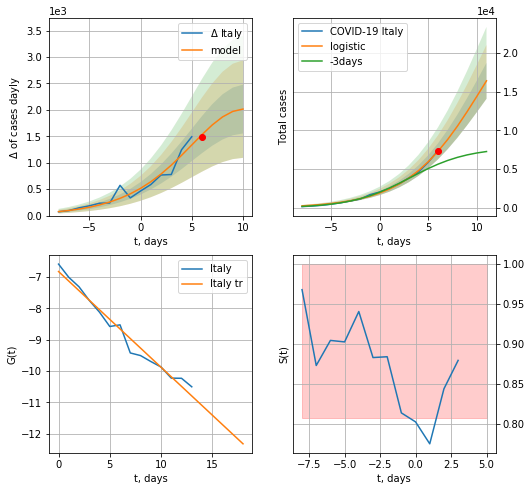

Italy data at: 2020-07-27
+3 day model MAPE: 0.4426444096966454
model: logistic
coeffs:  [3.14978219e+04 2.56455865e-01 1.06869170e+01]
rational stdev:  0.1414781796365507
forecast at the end of period: +5 days
	 deltaDaycases:  2015
	 total cases:  16380 ± 2317
	 total death:  2335 ± 991
trend coefficient of determination: 0.972594
 intercept: -6.827533
 slope: -0.305163


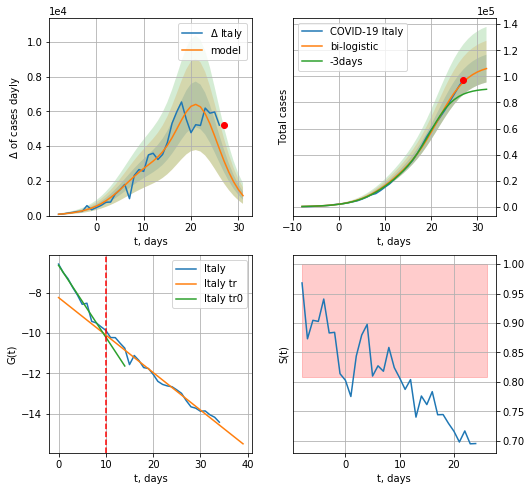

Italy data at: 2020-07-27
+3 day model MAPE: 0.1273932630183904
model: bi-logistic
coeffs:  [7.78644566e+04 3.07215545e-01 2.18188310e+01] [3.14978219e+04 2.56455865e-01 1.06869170e+01]
rational stdev:  0.10049358712471239
forecast at the end of period: +5 days
	 deltaDaycases:  1147
	 total cases:  105961 ± 10648
	 total death:  15106 ± 4554
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980937
 intercept: -6.650494
 slope: -0.355987
trend coefficient of determination: 0.983083
 intercept: -8.246651
 slope: -0.185682


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:311: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:353: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


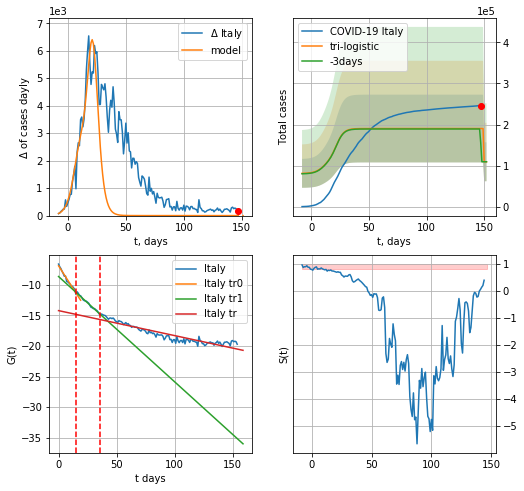

Italy data at: 2020-07-27
+3 day model MAPE: 0.7392318461926008
model: tri-logistic
coeffs:  [ 8.09002561e+04 -1.22271284e+01  1.49486055e+02] [3.14978219e+04 2.56455865e-01 1.06869170e+01 7.78644566e+04
 3.07215545e-01 2.18188310e+01]
forecast rational stdev:  0.4335333067001953
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  109362 ± 47412
	 total death:  15591 ± 20277
tri-logistic approximation splitting points: 15,36
trend0 coefficient of determination: 0.972806
 intercept: -6.865084
 slope: -0.296498
trend1 coefficient of determination: 0.980669
 intercept: -8.621660
 slope: -0.172200
trend coefficient of determination: 0.863139
 intercept: -14.202429
 slope: -0.040857


In [1587]:
vL = 15#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*18-dT,1.0)
xx = forecast2('Italy',dfIT[:vL1],d1,7*18-dT,x,1.0)#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*18-dT, xx, shift=1.,addpred=False,xcoef=[.35,1.,1.5],vL=[vL,vL1])

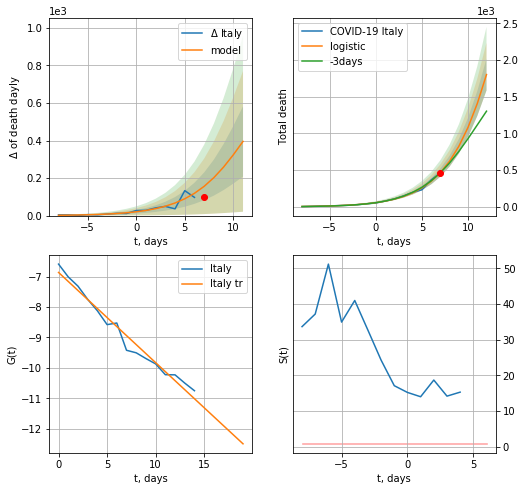

Italy data at: 2020-07-27
+3 day model MAPE: 0.04050488963495004
model: logistic
coeffs:  [8.02165383e+03 3.09187965e-01 1.60041387e+01]
rational stdev:  0.12009378173020563
forecast at the end of period: +5 days
	 total death:  1803 ± 216
trend coefficient of determination: 0.972806
 intercept: -6.865084
 slope: -0.296498


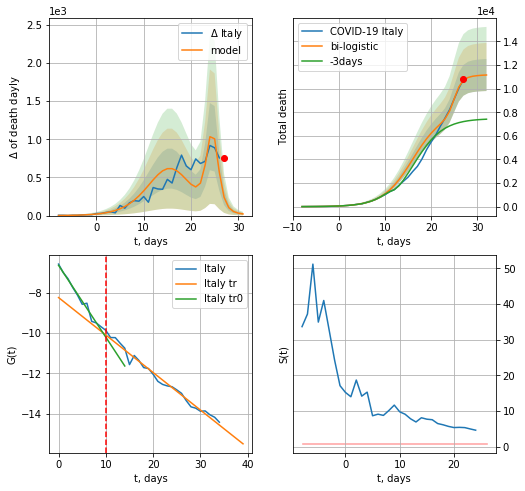

Italy data at: 2020-07-27
+3 day model MAPE: 0.5045402783114736
model: bi-logistic
coeffs:  [3.18986478e+03 1.24682064e+00 2.50159742e+01] [8.02165383e+03 3.09187965e-01 1.60041387e+01]
rational stdev:  0.12176299197618909
forecast at the end of period: +5 days
	 deltaDaydeath:  21
	 total death:  11154 ± 1358
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980937
 intercept: -6.650494
 slope: -0.355987
trend coefficient of determination: 0.983083
 intercept: -8.246651
 slope: -0.185682


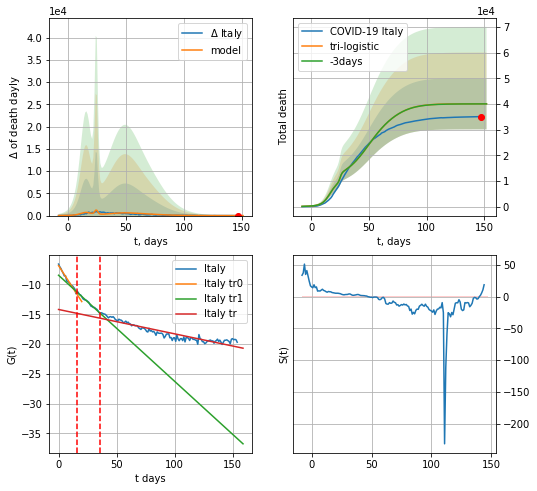

Italy data at: 2020-07-27
+3 day model MAPE: 0.0012972752703153368
model: tri-logistic
coeffs:  [2.31355463e+04 9.84971368e-02 4.84318087e+01] [8.02165383e+03 3.09187965e-01 1.60041387e+01 3.18986478e+03
 1.24682064e+00 2.50159742e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.24910796271257912
forecast at the end of period: +5 days
	 deltaDaydeath:  0
	 total death:  40127 ± 9996
tri-logistic approximation splitting points: 16,36
trend0 coefficient of determination: 0.976775
 intercept: -6.838969
 slope: -0.302094
trend1 coefficient of determination: 0.986358
 intercept: -8.457993
 slope: -0.177909
trend coefficient of determination: 0.863139
 intercept: -14.202429
 slope: -0.040857


In [1588]:
vL = 16#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*18-dT,1.0,cases='death')
xx = forecast2('Italy',dfIT[:vL1],d1,7*18-dT,x,1.0,cases='death')#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*18-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


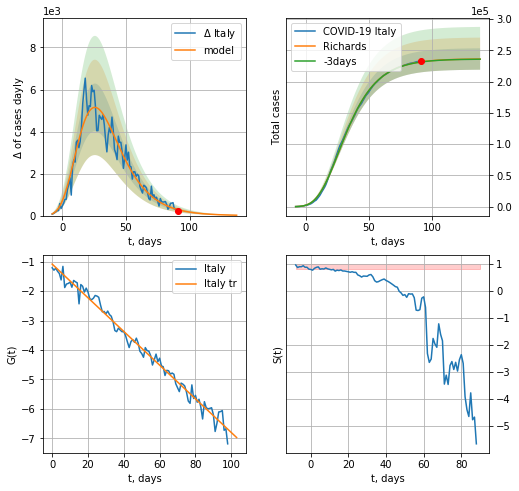

Italy data at: 2020-07-27
+3 day model MAPE: 0.001012
model: Richards
coeffs: [ 2.36456205e+05  5.89140521e+00 -5.11699403e+01  1.01015563e-02]
rational stdev: 0.072463
forecast at the end of period: +47 days
	 deltaDaycases: 18
	 total cases: 236154 ± 17112
	 total death: 33667 ± 7318
trend coefficient of determination: 0.985008
 intercept: -1.086112
 slope: -0.057138


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


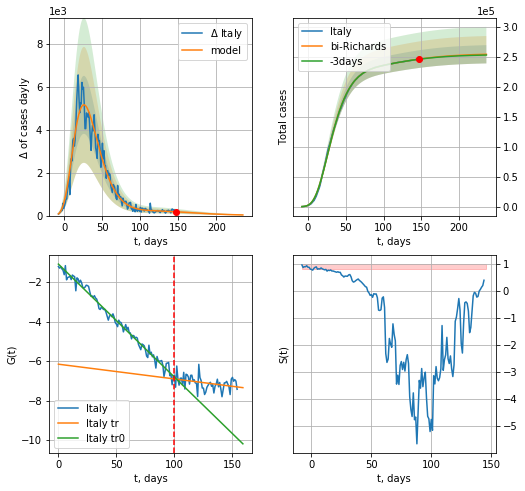

Italy data at: 2020-07-27
+3 day model MAPE: 0.000780
model: bi-Richards
coeffs: [ 1.87661391e+04  2.40733324e+00 -4.16682731e+01  1.08684323e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.059856
forecast at the end of period: +89 days
	 deltaDaycases: 30
	 total cases: 254051 ± 15206
	 total death: 36219 ± 6503
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.985474
 intercept: -1.093147
 slope: -0.057165
trend coefficient of determination: 0.123578
 intercept: -6.154905
 slope: -0.007462


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:62: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:183: RuntimeWarning: invalid value encountered in reduce
  arrmean = umr_sum(arr, axis, dtype, keepdims=True)


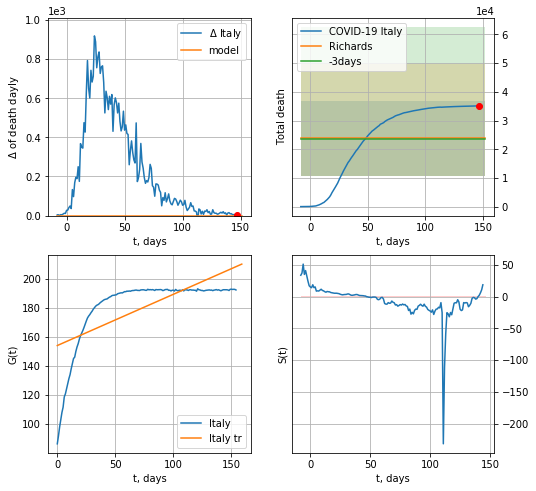

Italy data at: 2020-07-27
+3 day model MAPE: 0.009443
model: Richards
coeffs: [ 2.37674487e+04 -2.46494939e-01 -2.14670835e+01 -1.60862084e+01]
rational stdev: 0.545089
forecast at the end of period: +5 days
	 total death: 23767 ± 12955
trend coefficient of determination: 0.470559
 intercept: 154.065318
 slope: 0.353338


In [1589]:
vL=100
x = forecastRR('Italy',dfIT[:vL],d1,24*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Italy',dfIT[:],d1,30*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRR('Italy',dfIT[:],d1,18*7-dT,1.0,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


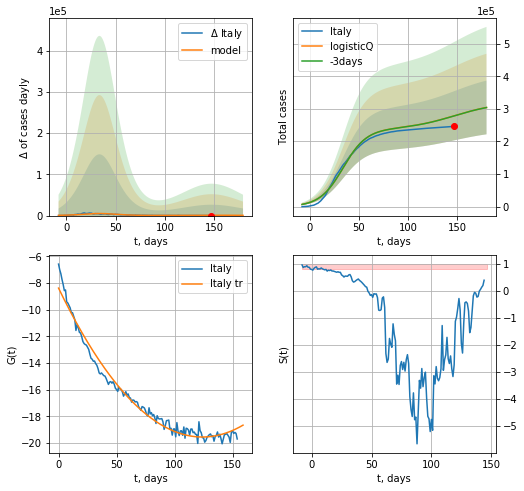

Italy data at: 2020-07-27
+3 day model MAPE: 0.000780
model: logisticQ
coeffs: [ 2.37327955e+05  2.24307146e-07  3.38783862e+01 -3.75100478e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.270723
forecast at the end of period: +33 days
	 deltaDaycases: 582
	 total cases: 304336 ± 82390
	 total death: 43387 ± 35237
trend coefficient of determination: 0.979661
 intercept_: -8.39106586329684
 coeffs_: [ 0.         -0.18013152  0.00072638]


In [1590]:
x = forecastRRR('Italy',dfIT[:],d1,7*22-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


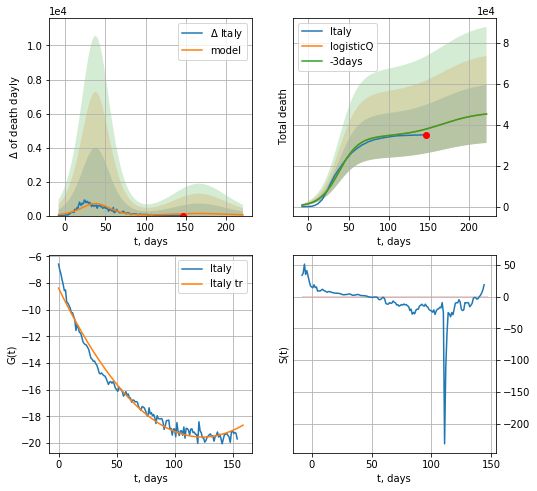

Italy data at: 2020-07-27
+3 day model MAPE: 0.000779
model: logisticQ
coeffs: [ 3.42856641e+04  1.97843370e-07  3.82682343e+01 -4.16593566e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.313096
forecast at the end of period: +75 days
	 total death: 45311 ± 14186
trend coefficient of determination: 0.979661
 intercept_: -8.39106586329684
 coeffs_: [ 0.         -0.18013152  0.00072638]


In [1591]:
x = forecastRRR('Italy',dfIT[:],d1,7*28-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

In [1592]:
dT

121

FR
           date     cases  active    death
159 2020-07-23  179398.0   68744  30182.0
160 2020-07-24  180528.0   69521  30192.0
161 2020-07-25  181374.0   69521  30192.0
162 2020-07-26  182224.0   69521  30192.0
163 2020-07-27  183079.0   71788  30209.0


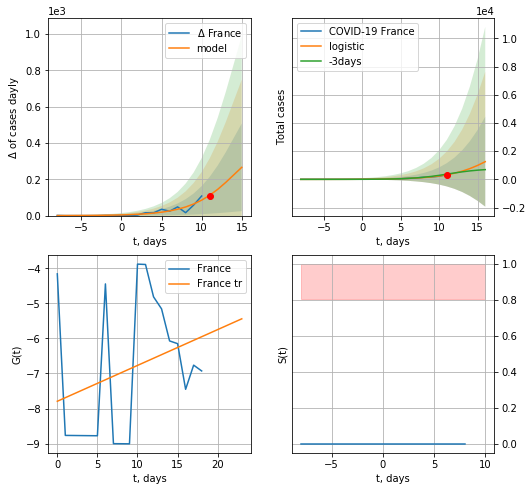

France data at: 2020-07-27
+3 day model MAPE: 0.04053351776025477
model: logistic
coeffs:  [4.17382756e+03 3.25568782e-01 1.85948993e+01]
rational stdev:  2.5390566064289986
forecast at the end of period: +5 days
	 deltaDaycases:  266
	 total cases:  1254 ± 3184
	 total death:  206 ± 1569
trend coefficient of determination: 0.083417
 intercept: -7.793073
 slope: 0.102246


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


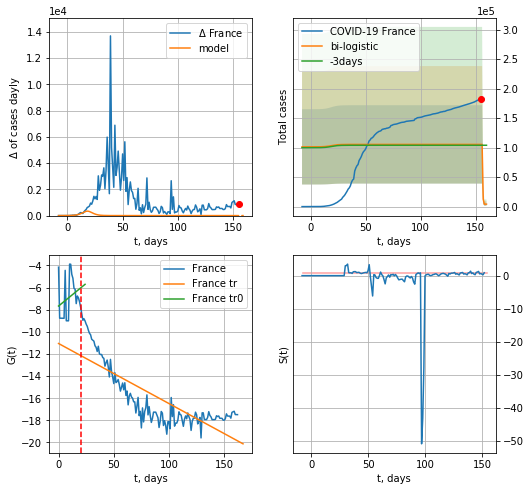

France data at: 2020-07-27
+3 day model MAPE: 0.013772687887029
model: bi-logistic
coeffs:  [ 1.01214200e+05 -3.02587834e+01  1.56921040e+02] [4.17382756e+03 3.25568782e-01 1.85948993e+01]
rational stdev:  0.6295945774847969
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  4173 ± 2627
	 total death:  688 ± 1299
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.062178
 intercept: -7.670498
 slope: 0.081817
trend coefficient of determination: 0.655057
 intercept: -11.054795
 slope: -0.054283


In [1594]:
# prideta 1990 2020-04-17
# prideta 3824 2020-04-18
dfFR = read_df(pd.DataFrame(),"FR")
vL=20
try:
    x = forecast('France',dfFR[:vL],d1,18*7-dT,1.0)
    xx = forecast2('France',dfFR,d1,18*7-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.5],vL=vL)
except:
    print ("Exception occurs")

In [486]:
#vL=len(dfFR)-9-5-dT
#x = forecast('France',dfFR[10:-9-dT],d1,7*5-dT-4,1.0)
#xx = forecast2('France',dfFR[10:],d1,7*7-dT-4,x,1.0,addpred=True,xcoef=[.25,1.,1.4],vL=vL)

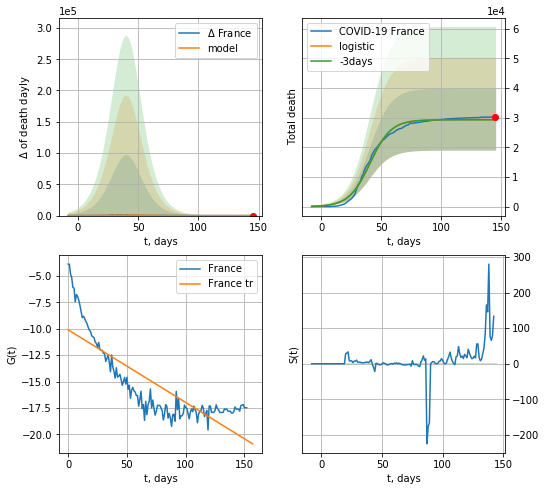

France data at: 2020-07-27
+3 day model MAPE: 0.0013858182558195403
model: logistic
coeffs:  [2.93102936e+04 1.14229430e-01 4.07583847e+01]
rational stdev:  0.35572567444775477
forecast at the end of period: +1 days
	 total death:  29310 ± 10426
trend coefficient of determination: 0.679762
 intercept: -10.104736
 slope: -0.068764


In [1595]:
#dfFR = read_df(pd.DataFrame(),"FR")
x = forecast('France',dfFR[10:],d1,7*18-dT-4,1.0,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


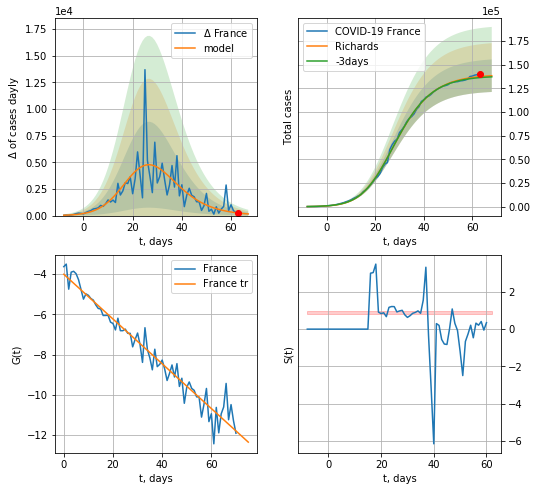

France data at: 2020-07-27
+3 day model MAPE: 0.007986
model: Richards
coeffs: [1.39530078e+05 2.42709601e-01 2.04374292e+01 4.70589913e-01]
rational stdev: 0.124192
forecast at the end of period: +5 days
	 deltaDaycases: 154
	 total cases: 138242 ± 17168
	 total death: 22810 ± 8498
trend coefficient of determination: 0.951177
 intercept: -4.003023
 slope: -0.111381


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


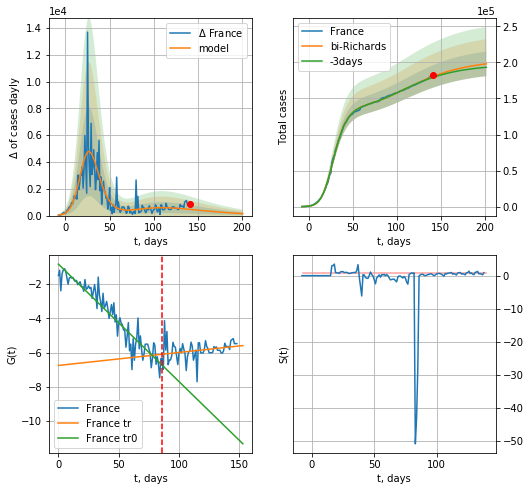

France data at: 2020-07-27
+3 day model MAPE: 0.007037
model: bi-Richards
coeffs: [ 6.45529386e+04  2.82723358e+00 -7.91304180e+01  8.84563225e-03]
rational stdev: 0.086250
forecast at the end of period: +61 days
	 deltaDaycases: 147
	 total cases: 197944 ± 17072
	 total death: 32661 ± 8451
bi-Richards approximation splitting point: 86
trend coefficient of determination: 0.903582
 intercept: -0.824404
 slope: -0.068695
trend coefficient of determination: 0.069827
 intercept: -6.750274
 slope: 0.007590


In [1596]:
vL = 86+14
x = forecastRR('France',dfFR[14:vL-14],d1,18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('France',dfFR[14:],d1,26*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-14)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


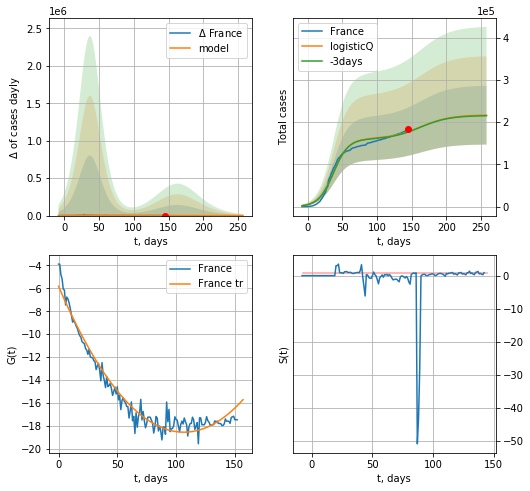

France data at: 2020-07-27
+3 day model MAPE: 0.004499
model: logisticQ
coeffs: [ 1.60560048e+05  1.22416165e-07  3.74595192e+01 -7.56578456e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.321442
forecast at the end of period: +113 days
	 deltaDaycases: 32
	 total cases: 216745 ± 69671
	 total death: 35764 ± 34488
trend coefficient of determination: 0.961367
 intercept_: -5.818961321165299
 coeffs_: [ 0.         -0.23906171  0.00112038]


In [1597]:
x = forecastRRR('France',dfFR[10:],d1,34*7-dT-4,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,3.,1.])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


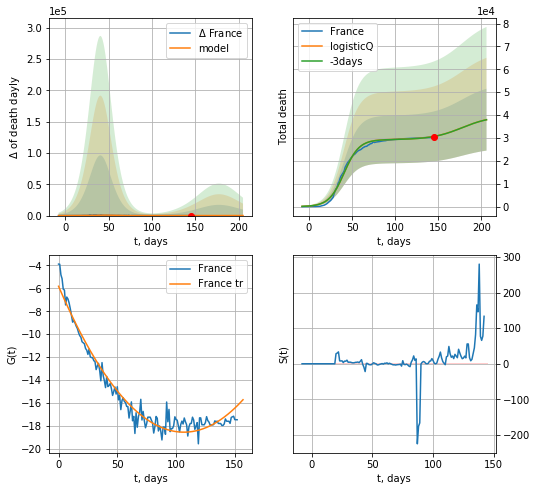

France data at: 2020-07-27
+3 day model MAPE: 0.001249
model: logisticQ
coeffs: [ 2.93102331e+04  2.77396805e-07  4.07586912e+01 -4.11611287e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.355779
forecast at the end of period: +61 days
	 total death: 37988 ± 13515
trend coefficient of determination: 0.961367
 intercept_: -5.818961321165299
 coeffs_: [ 0.         -0.23906171  0.00112038]


In [1598]:
x = forecastRRR('France',dfFR[10:],d1,26*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1.])

In [1599]:
#x = forecastR('France',dfFR[:],d1,8*7-dT-4,1.0,addpred=True,xcoef=[0.25,1.,20.,1])

In [1600]:
#trend3(dfGR,dfUS,dfGB[:],'GR','US','GB',40,40,40)

GR
           date   cases  active   death
150 2020-07-23  205142    6955  9187.0
151 2020-07-24  205968    6367  9201.0
152 2020-07-25  206332    6530  9202.0
153 2020-07-26  206741    6938  9203.0
154 2020-07-27  207379    6774  9205.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


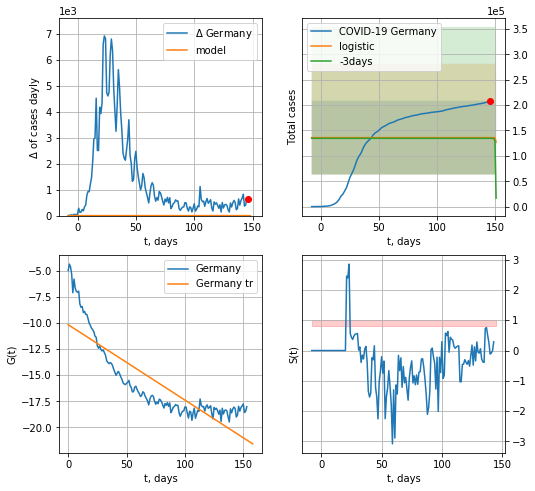

Germany data at: 2020-07-27
+3 day model MAPE: 0.010396170390482113
model: logistic
coeffs:  [ 1.35946052e+05 -5.14456442e+00  1.51516890e+02]
rational stdev:  0.534601428482574
forecast at the end of period: +5 days
	 deltaDaycases:  -8838
	 total cases:  127051 ± 67922
	 total death:  5639 ± 9043
trend coefficient of determination: 0.726064
 intercept: -10.163198
 slope: -0.072258


In [1601]:
dfGR = read_df(pd.DataFrame(),"GR")
x = forecast('Germany',dfGR[:],d1,7*18-dT,1.0)
#xx = forecast2('Germany',dfGR,d1,7*7-dT,x,1.0)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


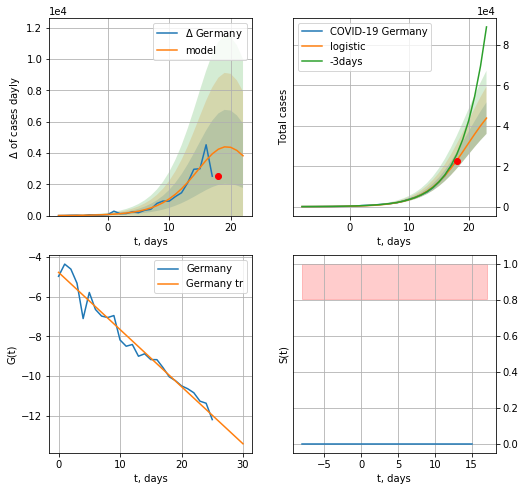

Germany data at: 2020-07-27
+3 day model MAPE: 0.1832688253569737
model: logistic
coeffs:  [6.15503848e+04 2.86340373e-01 1.98405530e+01]
rational stdev:  0.17812668621711658
forecast at the end of period: +5 days
	 deltaDaycases:  3820
	 total cases:  43818 ± 7805
	 total death:  1944 ± 1038
trend coefficient of determination: 0.966755
 intercept: -4.774386
 slope: -0.288157


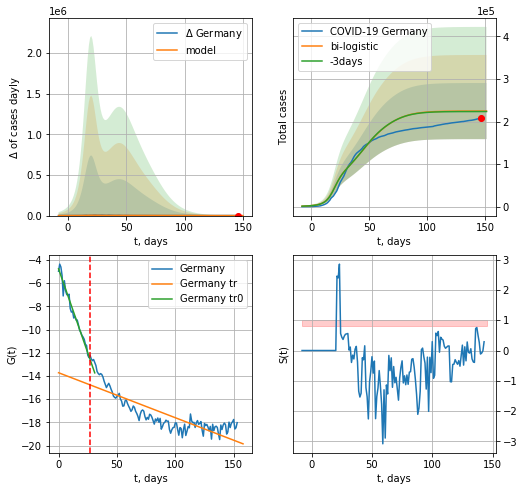

Germany data at: 2020-07-27
+3 day model MAPE: 0.0047180394488596615
model: bi-logistic
coeffs:  [1.30373317e+05 9.50520324e-02 4.33376463e+01] [6.15503848e+04 2.86340373e-01 1.98405530e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.2936714121008166
forecast at the end of period: +5 days
	 deltaDaycases:  1
	 total cases:  224498 ± 65928
	 total death:  9964 ± 8778
bi-logistic approximation splitting point: 27
trend0 coefficient of determination: 0.970316
 intercept: -4.764587
 slope: -0.289333
trend coefficient of determination: 0.700885
 intercept: -13.723014
 slope: -0.038792


In [1602]:
vL = 27
x = forecast('Germany',dfGR[:vL],d1,18*7-dT,1.0)#,addpred=True,xcoef=[0.25,1.,2.0,1])
xx = forecast2('Germany',dfGR,d1,7*18-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.6],vL=vL)

GR
           date   cases  active   death
150 2020-07-23  205142    6955  9187.0
151 2020-07-24  205968    6367  9201.0
152 2020-07-25  206332    6530  9202.0
153 2020-07-26  206741    6938  9203.0
154 2020-07-27  207379    6774  9205.0


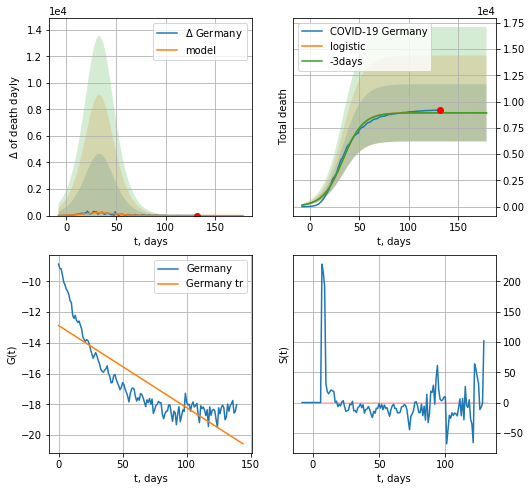

Germany data at: 2020-07-27
+3 day model MAPE: 0.0015800444506243968
model: logistic
coeffs:  [8.94105095e+03 9.86974226e-02 3.34773232e+01]
rational stdev:  0.3045932468638372
forecast at the end of period: +47 days
	 total death:  8941 ± 2723
trend coefficient of determination: 0.714145
 intercept: -12.872930
 slope: -0.053476


In [1603]:
dfGR = read_df(pd.DataFrame(),"GR")
x = forecast('Germany',dfGR[14:],d1,24*7-dT,1.0,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


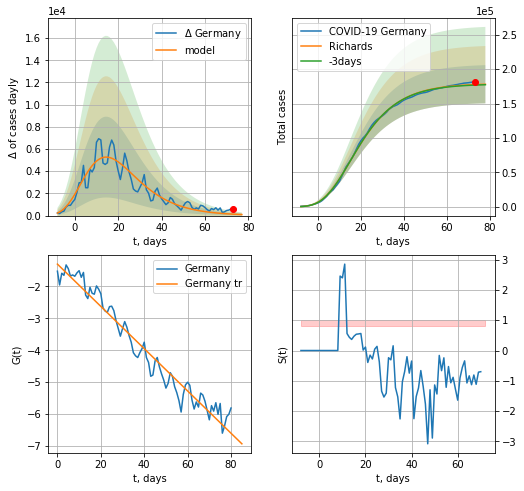

Germany data at: 2020-07-27
+3 day model MAPE: 0.003910
model: Richards
coeffs: [ 1.79110642e+05  9.15687169e+00 -4.39392677e+01  8.78226811e-03]
rational stdev: 0.155919
forecast at the end of period: +5 days
	 deltaDaycases: 93
	 total cases: 177990 ± 27752
	 total death: 7900 ± 3695
trend coefficient of determination: 0.956451
 intercept: -1.304276
 slope: -0.066178


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


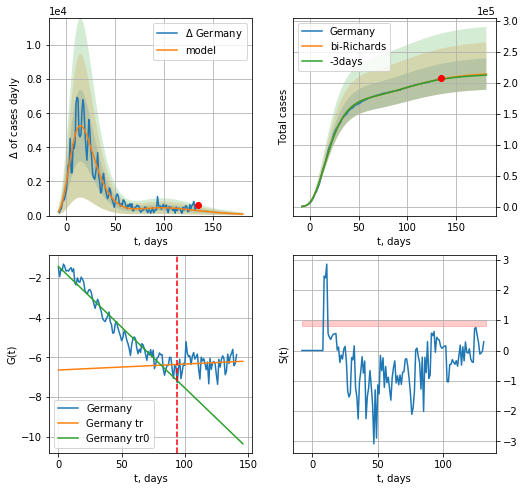

Germany data at: 2020-07-27
+3 day model MAPE: 0.003056
model: bi-Richards
coeffs: [ 3.77088709e+04  4.70202162e+00 -5.42456817e+01  6.84467797e-03]
rational stdev: 0.118349
forecast at the end of period: +47 days
	 deltaDaycases: 85
	 total cases: 214086 ± 25336
	 total death: 9502 ± 3373
bi-Richards approximation splitting point: 94
trend coefficient of determination: 0.950730
 intercept: -1.427965
 slope: -0.061143
trend coefficient of determination: 0.008263
 intercept: -6.641953
 slope: 0.003002


In [1604]:
vL = 94+12
x = forecastRR('Germany',dfGR[12:vL-12],d1,18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Germany',dfGR[12:],d1,24*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


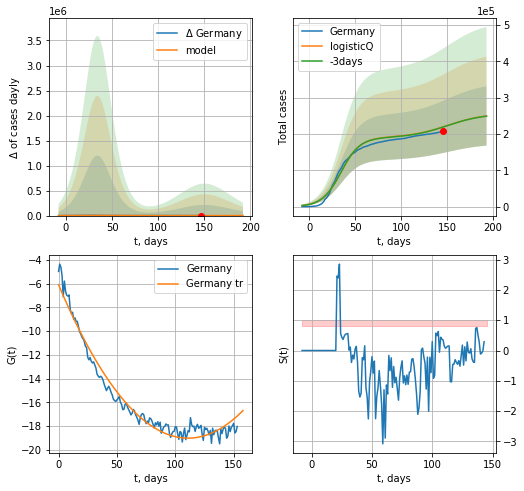

Germany data at: 2020-07-27
+3 day model MAPE: 0.001806
model: logisticQ
coeffs: [ 1.90052418e+05  1.57759730e-07  3.45593496e+01 -6.15876354e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.327262
forecast at the end of period: +47 days
	 deltaDaycases: 333
	 total cases: 249829 ± 81759
	 total death: 11089 ± 10887
trend coefficient of determination: 0.968038
 intercept_: -6.096948819944149
 coeffs_: [ 0.         -0.23276985  0.0010491 ]


In [1605]:
x = forecastRRR('Germany',dfGR[:],d1,24*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.0,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


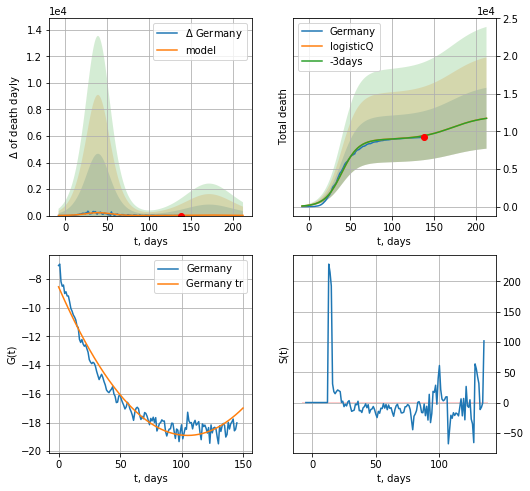

Germany data at: 2020-07-27
+3 day model MAPE: 0.001361
model: logisticQ
coeffs: [ 8.93984146e+03  2.89154568e-07  3.94765096e+01 -3.41869893e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.344679
forecast at the end of period: +75 days
	 total death: 11740 ± 4046
trend coefficient of determination: 0.963722
 intercept_: -8.53581477154985
 coeffs_: [ 0.         -0.19749714  0.00094094]


In [1606]:
x = forecastRRR('Germany',dfGR[8:],d1,28*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.0,1])

US
           date    cases   active     death
144 2020-07-23  4169991  2043041  147333.0
145 2020-07-24  4248492  2071639  148492.0
146 2020-07-25  4315709  2104619  149398.0
147 2020-07-26  4371839  2131861  149849.0
148 2020-07-27  4433410  2146363  150444.0


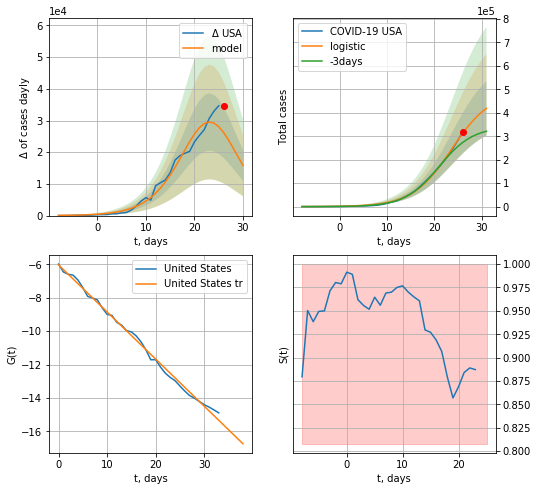

USA data at: 2020-07-27
+3 day model MAPE: 0.17962965905806133
model: logistic
coeffs:  [4.89025787e+05 2.41973856e-01 2.36121759e+01]
rational stdev:  0.27607026078318453
forecast at the end of period: +5 days
	 deltaDaycases:  15820
	 total cases:  418919 ± 115651
	 total death:  14215 ± 11773
trend coefficient of determination: 0.995387
 intercept: -6.036925
 slope: -0.281840


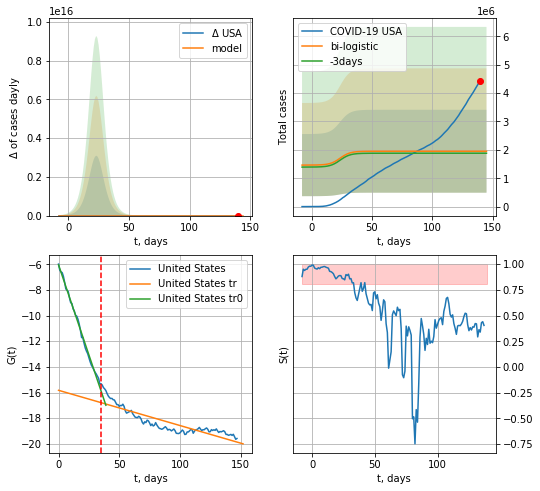

USA data at: 2020-07-27
+3 day model MAPE: 0.037068108877946475
model: bi-logistic
coeffs:  [ 1.16959174e+06 -1.43867180e+01  3.52601946e+02] [4.89025787e+05 2.41973856e-01 2.36121759e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
rational stdev:  0.748391452979668
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  1951015 ± 1460123
	 total death:  66206 ± 148644
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.995488
 intercept: -6.051468
 slope: -0.280518
trend coefficient of determination: 0.761329
 intercept: -15.826552
 slope: -0.027437


In [1607]:
vL=35
dfUS = read_df(pd.DataFrame(),"US")
x = forecast('USA',dfUS[:vL],d1,18*7-dT,1.0,addpred=False,xcoef=[0.25,1.,2.])
xx = forecast2('USA',dfUS[:],d1,18*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.5],vL=vL)

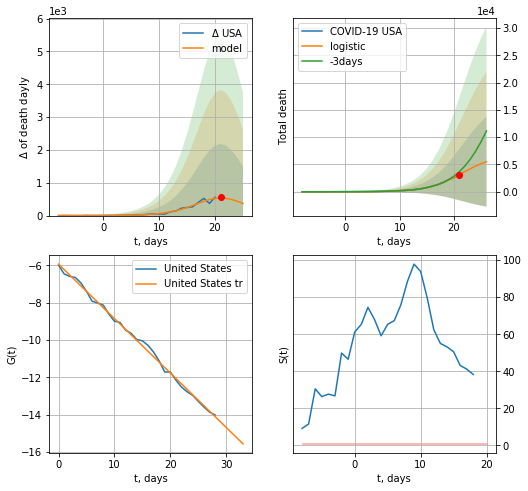

USA data at: 2020-07-27
+3 day model MAPE: 0.21421329662103625
model: logistic
coeffs:  [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  1.4929056707100332
forecast at the end of period: +5 days
	 total death:  5510 ± 8226
trend coefficient of determination: 0.996549
 intercept: -5.938291
 slope: -0.291586


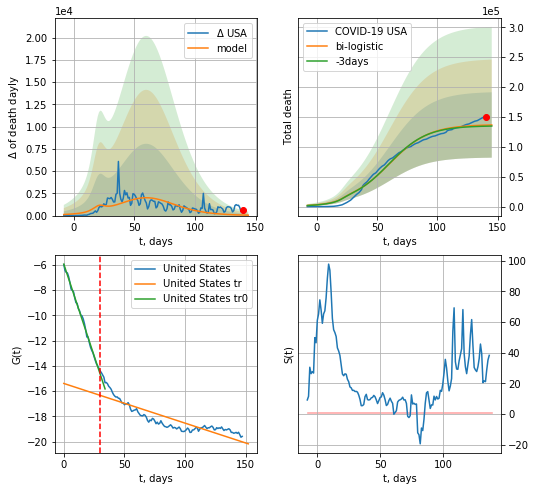

USA data at: 2020-07-27
+3 day model MAPE: 0.012991911535935418
model: bi-logistic
coeffs:  [1.30399419e+05 6.16421078e-02 6.03501848e+01] [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  0.4005454518300423
forecast at the end of period: +5 days
	 deltaDaydeath:  44
	 total death:  136530 ± 54686
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.996707
 intercept: -5.949158
 slope: -0.290421
trend coefficient of determination: 0.752989
 intercept: -15.392385
 slope: -0.031421


In [1608]:
vL=30
x = forecast('USA',dfUS[:vL],d1,7*18-dT,1.0,cases='death')
xx = forecast2('USA',dfUS,d1,7*18-dT,x,1.0,cases='death',vL=vL)
#x = forecast('USA',dfUS[:],d1,28*3-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


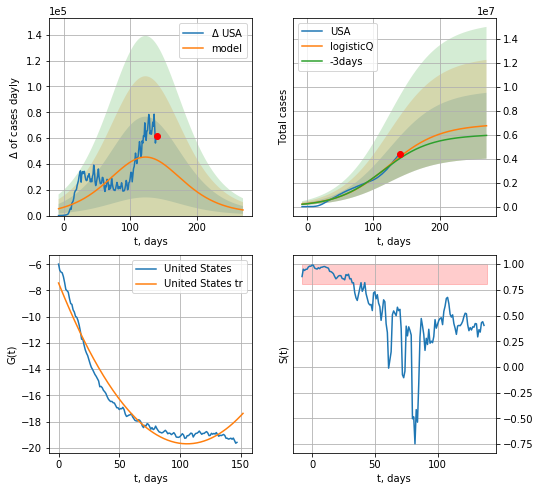

USA data at: 2020-07-27
+3 day model MAPE: 0.034489
model: logisticQ
coeffs: [ 6.81570814e+06  1.64149410e-07  1.23334873e+02 -1.61417971e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.407560
forecast at the end of period: +131 days
	 deltaDaycases: 4365
	 total cases: 6750147 ± 2751090
	 total death: 229060 ± 280067
trend coefficient of determination: 0.958918
 intercept_: -7.431635957329997
 coeffs_: [ 0.         -0.23154261  0.0010932 ]


In [1609]:
x = forecastRRR('USA',dfUS[:],d1,7*36-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.,1.])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


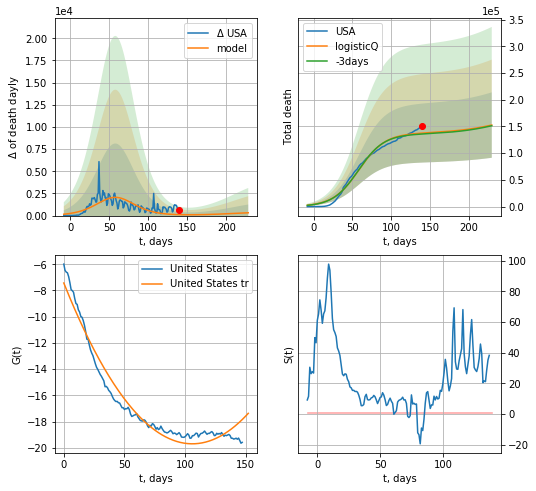

USA data at: 2020-07-27
+3 day model MAPE: 0.012753
model: logisticQ
coeffs: [ 1.37124489e+05  1.22547891e-07  5.83142985e+01 -4.89550899e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.401111
forecast at the end of period: +89 days
	 total death: 152597 ± 61208
trend coefficient of determination: 0.958918
 intercept_: -7.431635957329997
 coeffs_: [ 0.         -0.23154261  0.0010932 ]


In [1610]:
x = forecastRRR('USA',dfUS[:],d1,7*30-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.,1.])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


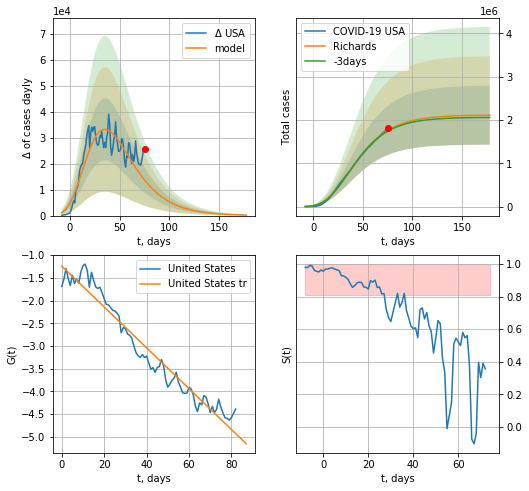

USA data at: 2020-07-27
+3 day model MAPE: 0.011172
model: Richards
coeffs: [ 2.11547275e+06  4.55740072e+00 -7.32299429e+01  9.40207859e-03]
rational stdev: 0.321873
forecast at the end of period: +103 days
	 deltaDaycases: 207
	 total cases: 2110724 ± 679385
	 total death: 71625 ± 69162
trend coefficient of determination: 0.952323
 intercept: -1.242017
 slope: -0.044961


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


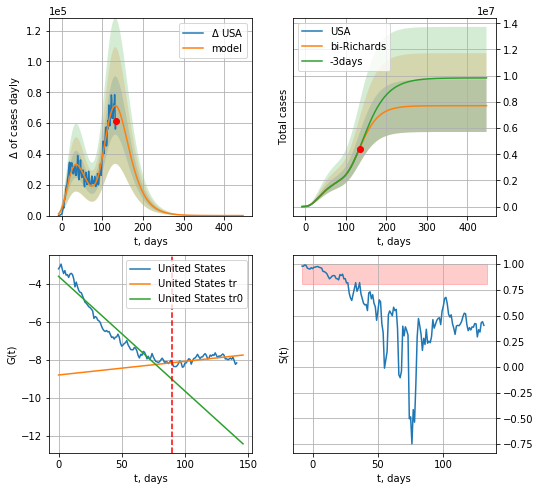

USA data at: 2020-07-27
+3 day model MAPE: 0.008924
model: bi-Richards
coeffs: [5.59180646e+06 1.50899114e-01 9.70679133e+01 2.53727469e-01]
rational stdev: 0.260268
forecast at the end of period: +313 days
	 deltaDaycases: 1
	 total cases: 7707245 ± 2005949
	 total death: 261538 ± 204209
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.924878
 intercept: -3.622005
 slope: -0.060114
trend coefficient of determination: 0.278263
 intercept: -8.792042
 slope: 0.007150


In [1611]:
iL = 6
vL = 90+iL
x = forecastRR('USA',dfUS[iL:vL-iL],d1,7*32-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('USA',dfUS[iL:],d1,7*62-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [1612]:
#x = forecastQR('USA',dfUS[20:],d1,7*18-dT,1.0,addpred=False,xcoef=[0.35,.5,3.,1.,1.])

GB
           date   cases  active    death
148 2020-07-23  297146       0  45554.0
149 2020-07-24  297914       0  45677.0
150 2020-07-25  298681       0  45738.0
151 2020-07-26  299426       0  45752.0
152 2020-07-27  300111       0  45759.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


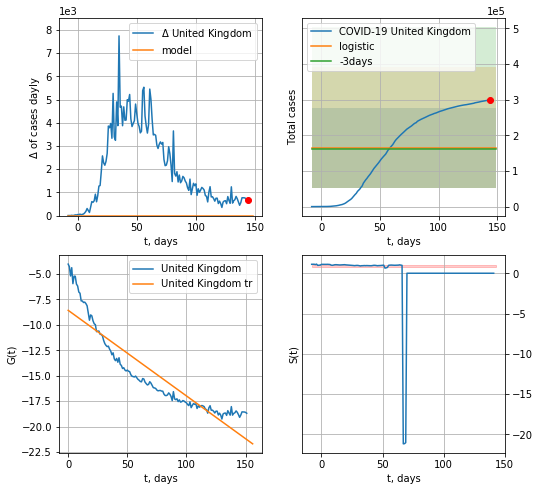

United Kingdom data at: 2020-07-27
+3 day model MAPE: 0.01656058650664221
model: logistic
coeffs:  [ 1.65003797e+05 -9.22129111e+00  2.37516317e+02]
rational stdev:  0.6855492658329027
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  165003 ± 113118
	 total death:  25158 ± 51741
trend coefficient of determination: 0.843578
 intercept: -8.575074
 slope: -0.084129


In [1613]:
dfGB = read_df(pd.DataFrame(),"GB")
x = forecast('United Kingdom',dfGB[:],d1,7*18-dT,1.)
#x = forecast('United Kingdom',dfGB[:-8-dT],d1,4*7-dT,1.)
#xx = forecast2('United Kingdom',dfGB[:],d1,4*7-dT,x,1.)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


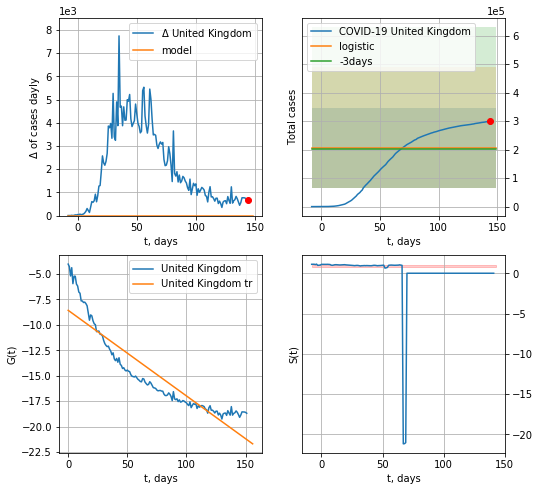

United Kingdom data at: 2020-07-27
+3 day model MAPE: 0.016560586506642064
model: logistic
coeffs:  [ 1.65003797e+05 -9.22129111e+00  2.37516317e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.6855492658329027
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  206254 ± 141397
	 total death:  31448 ± 64677
trend coefficient of determination: 0.843578
 intercept: -8.575074
 slope: -0.084129


In [1614]:
x = forecast('United Kingdom',dfGB[:],d1,18*7-dT,1.,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: divide by zero encountered in true_divide


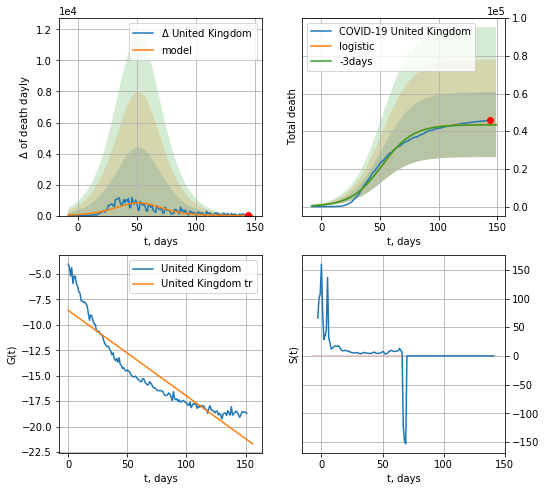

United Kingdom data at: 2020-07-27
+3 day model MAPE: 0.003922232546286871
model: logistic
coeffs:  [4.35790323e+04 7.56310125e-02 5.18578690e+01]
rational stdev:  0.39638716013988234
forecast at the end of period: +5 days
	 total death:  43550 ± 17263
trend coefficient of determination: 0.843578
 intercept: -8.575074
 slope: -0.084129


In [1615]:
x = forecast('United Kingdom',dfGB[:],d1,18*7-dT,1.,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


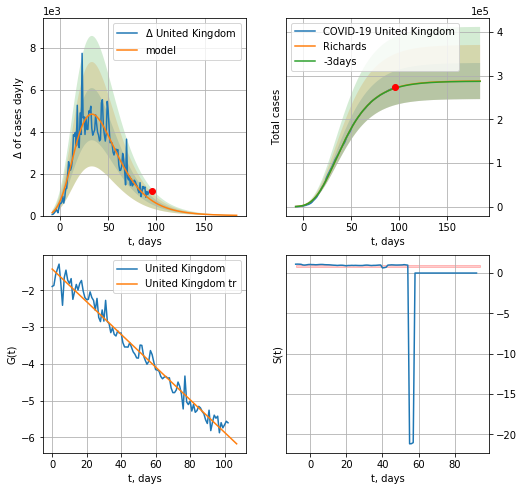

United Kingdom data at: 2020-07-27
+3 day model MAPE: 0.001530
model: Richards
coeffs: [ 2.88040344e+05  3.82469918e+00 -6.26359665e+01  1.20178265e-02]
rational stdev: 0.143621
forecast at the end of period: +89 days
	 deltaDaycases: 13
	 total cases: 287754 ± 41327
	 total death: 43874 ± 18903
trend coefficient of determination: 0.974342
 intercept: -1.421044
 slope: -0.044452


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


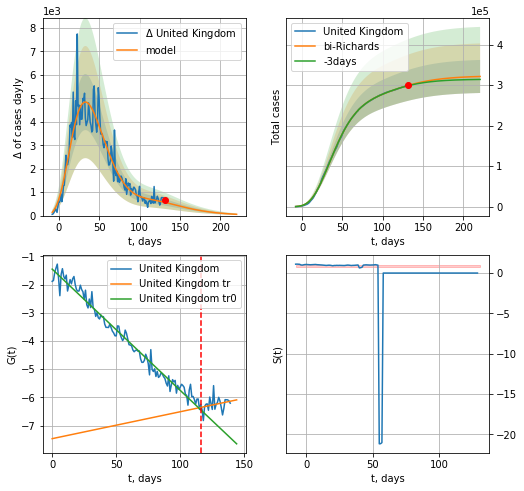

United Kingdom data at: 2020-07-27
+3 day model MAPE: 0.002535
model: bi-Richards
coeffs: [ 3.49541569e+04  3.37553103e+00 -1.15320874e+01  9.80872464e-03]
rational stdev: 0.126838
forecast at the end of period: +89 days
	 deltaDaycases: 54
	 total cases: 321364 ± 40761
	 total death: 48999 ± 18644
bi-Richards approximation splitting point: 116
trend coefficient of determination: 0.976779
 intercept: -1.448488
 slope: -0.043048
trend coefficient of determination: 0.078213
 intercept: -7.464564
 slope: 0.009555


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: divide by zero encountered in true_divide


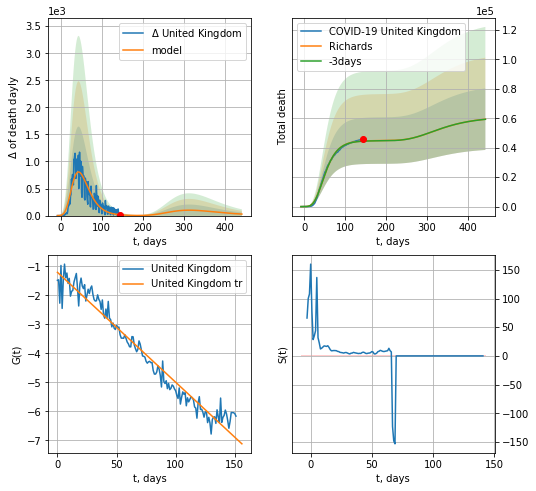

United Kingdom data at: 2020-07-27
+3 day model MAPE: 0.002559
model: Richards
coeffs: [ 4.49057677e+04  7.88132752e+00 -5.97680192e+01  6.21604996e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.351944
forecast at the end of period: +299 days
	 total death: 59412 ± 20909
trend coefficient of determination: 0.958884
 intercept: -1.205715
 slope: -0.037875


In [1616]:
vL = 116+12
x = forecastRR('United Kingdom',dfGB[12:vL-12],d1,30*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('United Kingdom',dfGB[12:],d1,30*7-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)
x = forecastRR('United Kingdom',dfGB[:],d1,60*7-dT,1.,addpred=True,xcoef=RkoreaCoeffs,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


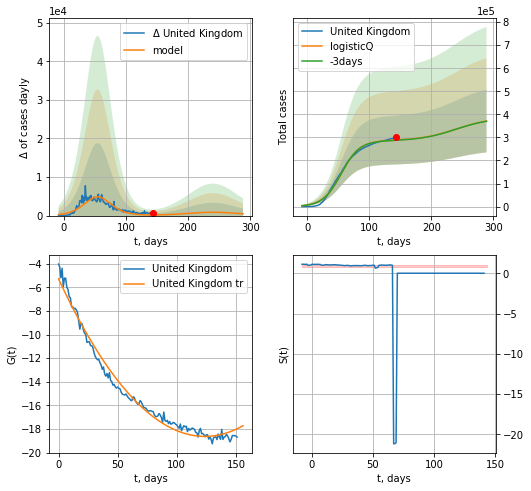

United Kingdom data at: 2020-07-27
+3 day model MAPE: 0.004347
model: logisticQ
coeffs: [ 2.85927880e+05  1.68788721e-07  5.50947940e+01 -4.02946573e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.366574
forecast at the end of period: +145 days
	 deltaDaycases: 466
	 total cases: 371180 ± 136065
	 total death: 56595 ± 62238
trend coefficient of determination: 0.983245
 intercept_: -5.282430680978749
 coeffs_: [ 0.         -0.21583634  0.00087224]


In [1617]:
x = forecastRRR('United Kingdom',dfGB[:],d1,38*7-dT,1.,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


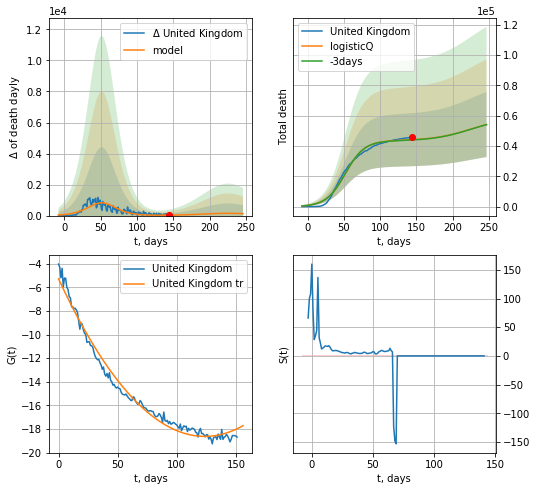

United Kingdom data at: 2020-07-27
+3 day model MAPE: 0.003935
model: logisticQ
coeffs: [ 4.35788504e+04  1.59116434e-07  5.18589585e+01 -4.75134583e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.396410
forecast at the end of period: +103 days
	 total death: 54220 ± 21493
trend coefficient of determination: 0.983245
 intercept_: -5.282430680978749
 coeffs_: [ 0.         -0.21583634  0.00087224]


In [1618]:
x = forecastRRR('United Kingdom',dfGB[:],d1,32*7-dT,1.,addpred=True,xcoef=koreaCoeffs,cases='death')

In [ ]:
#x = forecastQR('United Kingdom',dfGB[:],d1,18*7-dT,1.,addpred=True,xcoef=[0.35,.5,3,1,1])

In [ ]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,2.4,1])

In [ ]:
#trend3(dfDK,dfNG,dfSW[:],'DK','NG','SW',40,40,40)

In [ ]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,4.,1])

In [ ]:
#x = forecast('Denmark',dfDK[:15],d1,2*7-dT,1.0)
#xx = forecast2('Denmark',dfDK[:],d1,4*7-dT, x,1.0)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3('Denmark',dfDK[:],d1,14-dT, xx)

In [1619]:
dT

121

DK
           date    cases  active  death
147 2020-07-23  13390.0     479  612.0
148 2020-07-24  13438.0     485  613.0
149 2020-07-25  13474.0     485  613.0
150 2020-07-26  13510.0     485  613.0
151 2020-07-27  13547.0     517  613.0


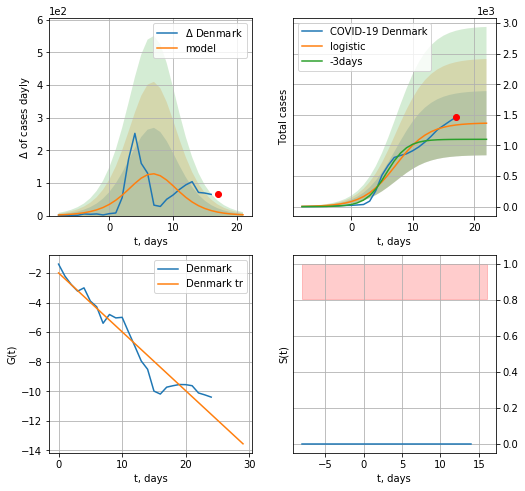

Denmark data at: 2020-07-27
+3 day model MAPE: 0.22309164797181072
model: logistic
coeffs:  [1.36966074e+03 3.75718857e-01 7.30059730e+00]
rational stdev:  0.3847660616131427
forecast at the end of period: +5 days
	 deltaDaycases:  2
	 total cases:  1364 ± 524
	 total death:  61 ± 70
trend coefficient of determination: 0.928037
 intercept: -1.984791
 slope: -0.399221


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


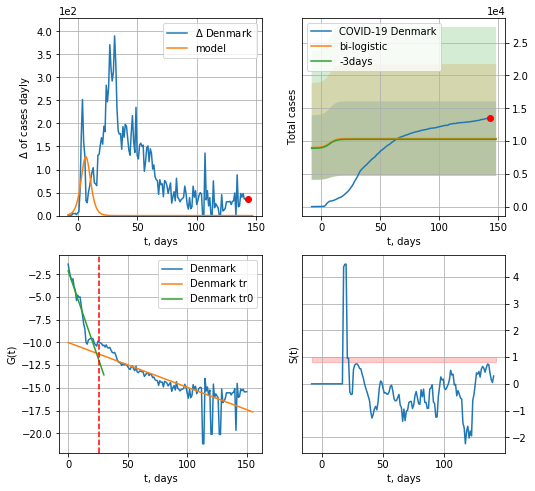

Denmark data at: 2020-07-27
+3 day model MAPE: 0.012094456615709426
model: bi-logistic
coeffs:  [ 7.21069858e+03 -3.96073770e+00  1.70304595e+02] [1.36966074e+03 3.75718857e-01 7.30059730e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.5463780462611729
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  10383 ± 5673
	 total death:  469 ± 768
bi-logistic approximation splitting point: 26
trend0 coefficient of determination: 0.914728
 intercept: -2.128126
 slope: -0.381304
trend coefficient of determination: 0.644802
 intercept: -10.009792
 slope: -0.049223


In [1621]:
dfDK = read_df(pd.DataFrame(),"DK")
vL = 26
try:
    x = forecast('Denmark',dfDK[:vL],d1,7*18-dT,1.0)
    xx = forecast2('Denmark',dfDK[:],d1,18*7-dT, x,1.0,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
except:
    print("Exception occurs")

In [1259]:
d12f(3)

'2020-07-24'

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


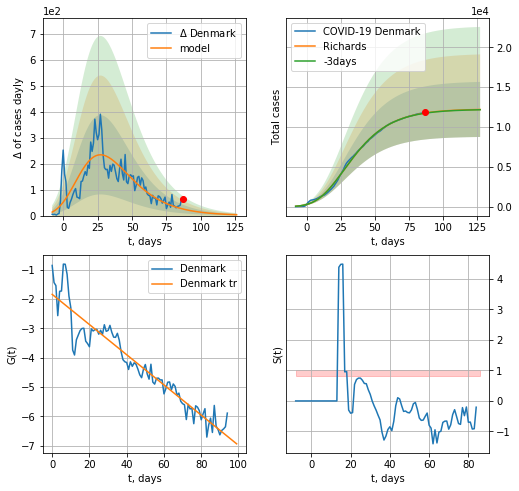

Denmark data at: 2020-07-27
+3 day model MAPE: 0.002072
model: Richards
coeffs: [ 1.22659587e+04  7.57412552e-01 -2.17374784e+01  7.08529699e-02]
rational stdev: 0.283101
forecast at the end of period: +40 days
	 deltaDaycases: 3
	 total cases: 12206 ± 3455
	 total death: 552 ± 468
trend coefficient of determination: 0.907675
 intercept: -1.842227
 slope: -0.051439


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


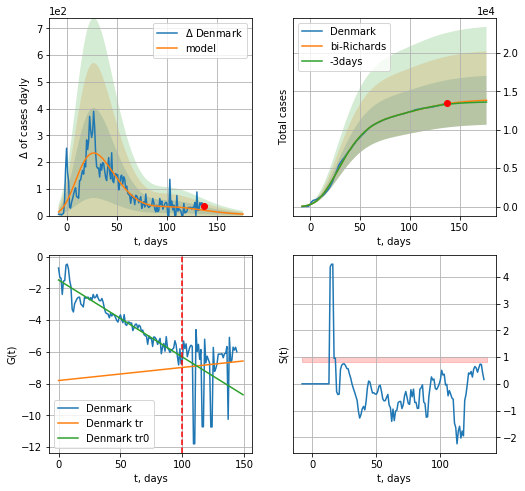

Denmark data at: 2020-07-25
+3 day model MAPE: 0.005472
model: bi-Richards
coeffs: [ 1.71449800e+03  4.98446773e+00 -1.04958507e+01  7.82020988e-03]
rational stdev: 0.230031
forecast at the end of period: +40 days
	 deltaDaycases: 5
	 total cases: 13835 ± 3182
	 total death: 626 ± 431
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.911504
 intercept: -1.465569
 slope: -0.048580
trend coefficient of determination: 0.003286
 intercept: -7.807845
 slope: 0.008252


In [1622]:
vL = 100+4
x = forecastRR('Denmark',dfDK[4:vL-4],d1,23*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Denmark',dfDK[4:-2],d12f(2+1),23*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-4)
#x2 = forecast2R('Denmark',dfDK[:],d1,16*7-dT,x,1.0)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


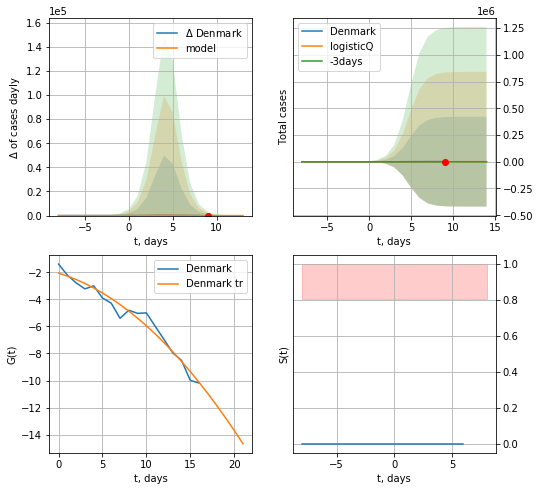

Denmark data at: 2020-07-27
+3 day model MAPE: 2.879608
model: logisticQ
coeffs: [ 8.62480486e+02  2.49394711e-04  4.73670535e+00 -4.50101209e+03]
rational stdev: 487.273007
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 862 ± 420251
	 total death: 39 ± 57010
trend coefficient of determination: 0.965266
 intercept_: -2.0557034713075613
 coeffs_: [ 0.         -0.1970759  -0.01925246]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


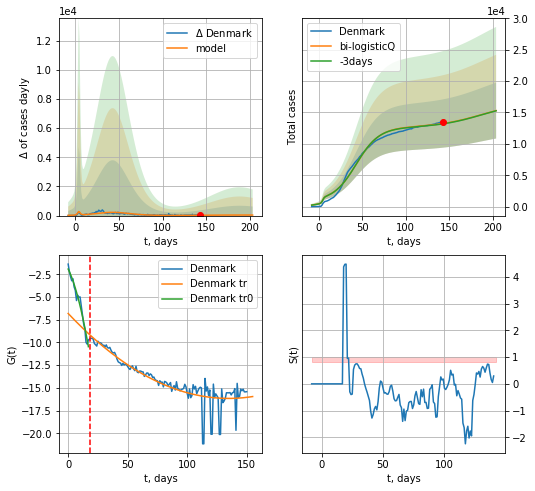

Denmark data at: 2020-07-27
+3 day model MAPE: 0.004119
model: bi-logisticQ
coeffs: [ 1.17563864e+04  1.38326857e-07  4.32491243e+01 -5.45194486e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.290624
forecast at the end of period: +61 days
	 deltaDaycases: 36
	 total cases: 15295 ± 4445
	 total death: 692 ± 603
bi-logisticQ approximation splitting point: 18
trend coefficient of determination: 0.963211
 intercept_: -1.9308894789691964
 coeffs_: [ 0.         -0.26605777 -0.01390014]
trend coefficient of determination: 0.782750
 intercept_: -6.814648752728654
 coeffs_: [ 0.         -0.13854626  0.00051348]


In [1623]:
x = forecastRRR('Denmark',dfDK[:18],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[0.35,0.5,4.5,1.])
x = forecast2RRR('Denmark',dfDK[:],d1,26*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=18)

NG
           date   cases  active  death
148 2020-07-23  9085.0     156  255.0
149 2020-07-24  9092.0     163  255.0
150 2020-07-25  9111.0     182  255.0
151 2020-07-26  9117.0     110  255.0
152 2020-07-27  9132.0     125  255.0


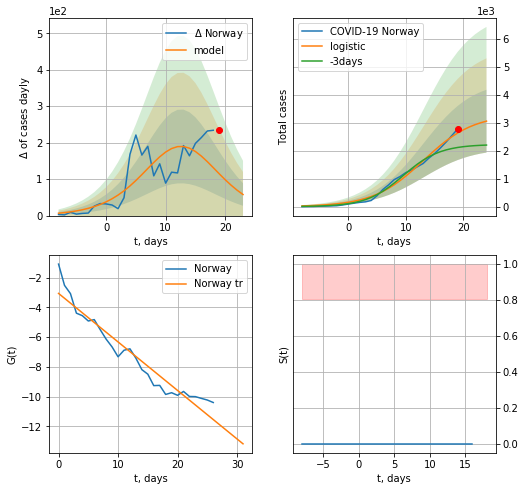

Norway data at: 2020-07-27
+3 day model MAPE: 0.28148190042351234
model: logistic
coeffs:  [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.36743919108062534
forecast at the end of period: +5 days
	 deltaDaycases:  57
	 total cases:  3052 ± 1121
	 total death:  85 ± 93
trend coefficient of determination: 0.927855
 intercept: -3.067798
 slope: -0.326083


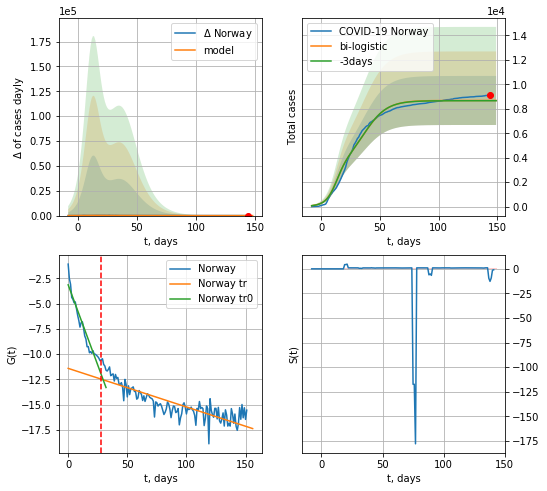

Norway data at: 2020-07-27
+3 day model MAPE: 0.002463487225011271
model: bi-logistic
coeffs:  [5.38503301e+03 1.02784908e-01 3.67673042e+01] [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.23101457659267144
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  8682 ± 2005
	 total death:  242 ± 167
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.710219
 intercept: -11.400300
 slope: -0.038128


In [1624]:
dfNG = read_df(pd.DataFrame(),"NG")
vL=28
x = forecast('Norway',dfNG[:vL],d1,7*18-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,18*7-dT,x,1.0,vL=vL)
#xx = np.concatenate((x, xx), axis=0)

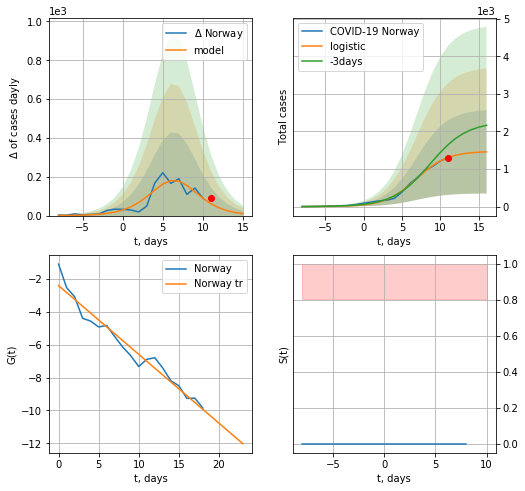

Norway data at: 2020-07-27
+3 day model MAPE: 0.24765534865647335
model: logistic
coeffs:  [1.47478892e+03 4.95866797e-01 6.87524750e+00]
rational stdev:  0.7596156046192828
forecast at the end of period: +5 days
	 deltaDaycases:  9
	 total cases:  1458 ± 1108
	 total death:  40 ± 91
trend coefficient of determination: 0.956890
 intercept: -2.403448
 slope: -0.418410


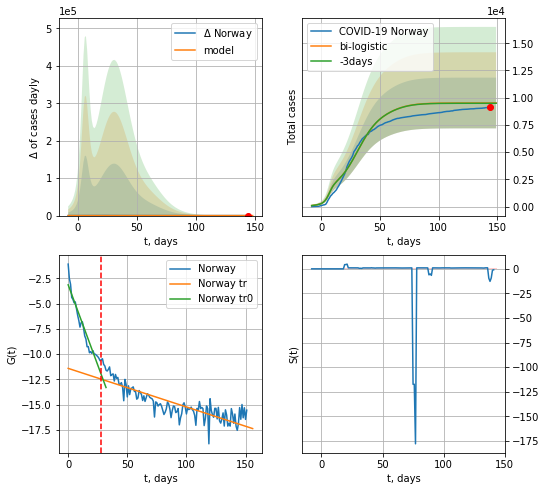

Norway data at: 2020-07-27
+3 day model MAPE: 0.0025355182723098384
model: bi-logistic
coeffs:  [7.14775595e+03 1.09564487e-01 3.09924600e+01] [1.47478892e+03 4.95866797e-01 6.87524750e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.24474387702638561
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  9515 ± 2328
	 total death:  265 ± 194
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.710219
 intercept: -11.400300
 slope: -0.038128


In [1625]:
vL = 28#len(dfNG)-13-dT
x = forecast('Norway',dfNG[:-12-dT],d1,7*18-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,18*7-dT,x,1.0,addpred=True,xcoef=[0.25/2,1.,2.],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


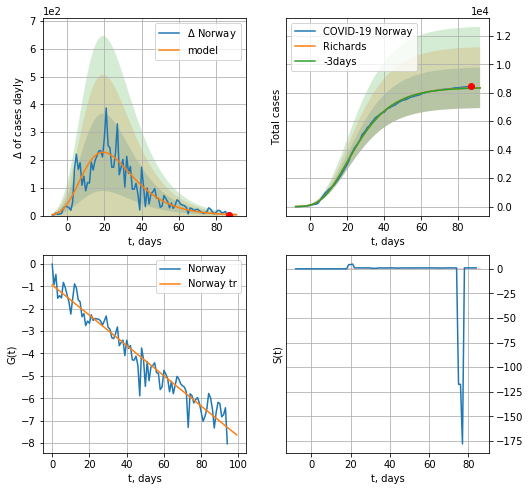

Norway data at: 2020-07-27
+3 day model MAPE: 0.001825
model: Richards
coeffs: [ 8.38632135e+03  7.25544815e+00 -4.18707853e+01  1.02370930e-02]
rational stdev: 0.170786
forecast at the end of period: +5 days
	 deltaDaycases: 3
	 total cases: 8347 ± 1425
	 total death: 233 ± 119
trend coefficient of determination: 0.940553
 intercept: -0.942933
 slope: -0.067603


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


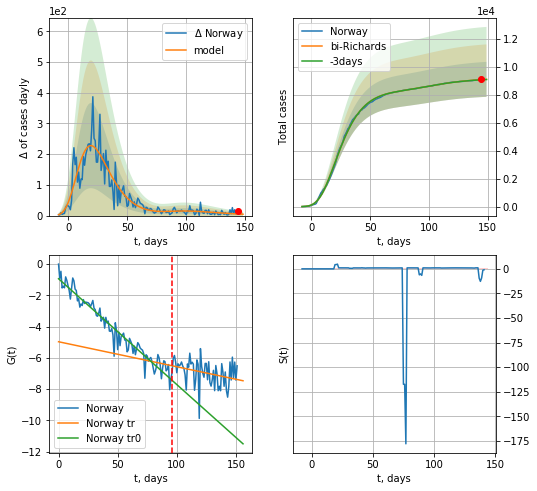

Norway data at: 2020-07-27
+3 day model MAPE: 0.001311
model: bi-Richards
coeffs: [ 8.42156205e+02  4.08220004e+00 -4.98831720e-03  1.07547471e-02]
rational stdev: 0.137398
forecast at the end of period: +5 days
	 deltaDaycases: 4
	 total cases: 9122 ± 1253
	 total death: 254 ± 104
bi-Richards approximation splitting point: 96
trend coefficient of determination: 0.942270
 intercept: -0.946267
 slope: -0.067614
trend coefficient of determination: 0.098625
 intercept: -4.971904
 slope: -0.015978


In [1626]:
vL = 96
x = forecastRR('Norway',dfNG[:vL],d1,18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Norway',dfNG[:],d1,18*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Norway',dfNG[:],d1,8*7-dT,1.0)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


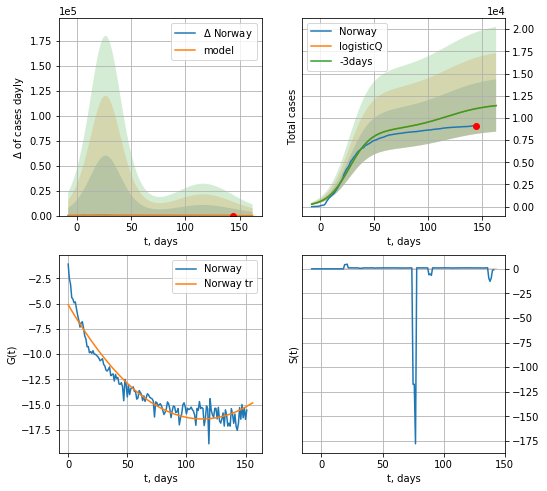

Norway data at: 2020-07-27
+3 day model MAPE: 0.001149
model: logisticQ
coeffs: [ 8.62882843e+03  1.87689889e-07  2.68636396e+01 -5.23378730e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.259148
forecast at the end of period: +19 days
	 deltaDaycases: 13
	 total cases: 11398 ± 2953
	 total death: 318 ± 247
trend coefficient of determination: 0.927190
 intercept_: -5.119064049418316
 coeffs_: [ 0.         -0.19899709  0.00087749]


In [1627]:
x = forecastRRR('Norway',dfNG[:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


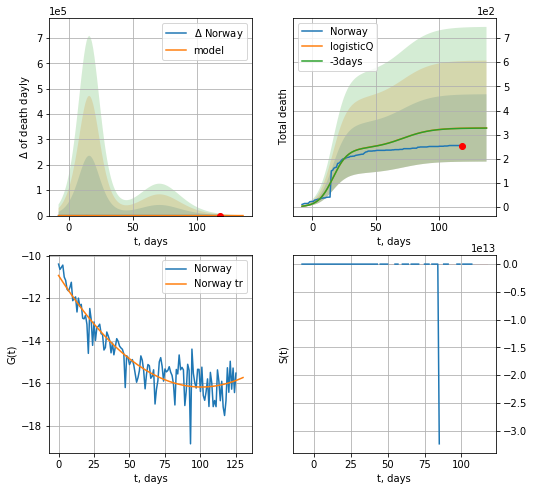

Norway data at: 2020-07-27
+3 day model MAPE: 0.001979
model: logisticQ
coeffs: [ 2.42307977e+02  6.03254796e-07  1.63581097e+01 -2.87901678e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.425381
forecast at the end of period: +19 days
	 total death: 327 ± 139
trend coefficient of determination: 0.851863
 intercept_: -10.935248091641517
 coeffs_: [ 0.         -0.10431112  0.00051825]


In [1628]:
x = forecastRRR('Norway',dfNG[26:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

SW
           date  cases  active   death
149 2020-07-23  78763       0  5676.0
150 2020-07-24  78997       0  5697.0
151 2020-07-25  79129       0  5697.0
152 2020-07-26  79262       0  5697.0
153 2020-07-27  79395       0  5700.0


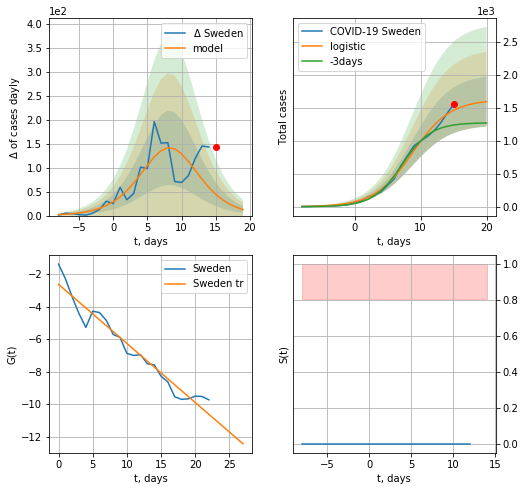

Sweden data at: 2020-07-27
+3 day model MAPE: 0.2037446768605221
model: logistic
coeffs:  [1.62331286e+03 3.49719159e-01 8.72648648e+00]
rational stdev:  0.2371580380027054
forecast at the end of period: +5 days
	 deltaDaycases:  12
	 total cases:  1592 ± 377
	 total death:  114 ± 81
trend coefficient of determination: 0.947996
 intercept: -2.632493
 slope: -0.363132


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


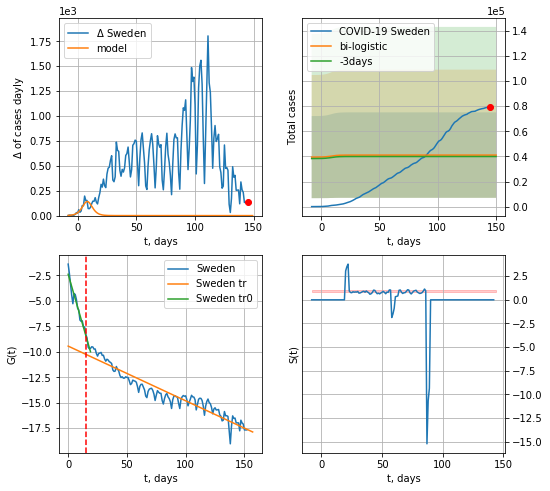

Sweden data at: 2020-07-27
+3 day model MAPE: 0.028690751700856082
model: bi-logistic
coeffs:  [ 3.15395776e+04 -1.22728957e+01  3.07104807e+02] [1.62331286e+03 3.49719159e-01 8.72648648e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.829268893725505
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  41047 ± 34039
	 total death:  2946 ± 7329
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.908377
 intercept: -2.385275
 slope: -0.400494
trend coefficient of determination: 0.907736
 intercept: -9.441350
 slope: -0.053710


In [1630]:
vL = 15#len(dfSW)-12-dT
dfSW = read_df(pd.DataFrame(),"SW")
try:
    x = forecast('Sweden',dfSW[:-9-dT],d1,7*18-dT,1.0)
    xx = forecast2('Sweden',dfSW[:],d1,7*18-dT,x,1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)
except:
    print ("Exception occurs")

SW
           date  cases  active   death
149 2020-07-23  78763       0  5676.0
150 2020-07-24  78997       0  5697.0
151 2020-07-25  79129       0  5697.0
152 2020-07-26  79262       0  5697.0
153 2020-07-27  79395       0  5700.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


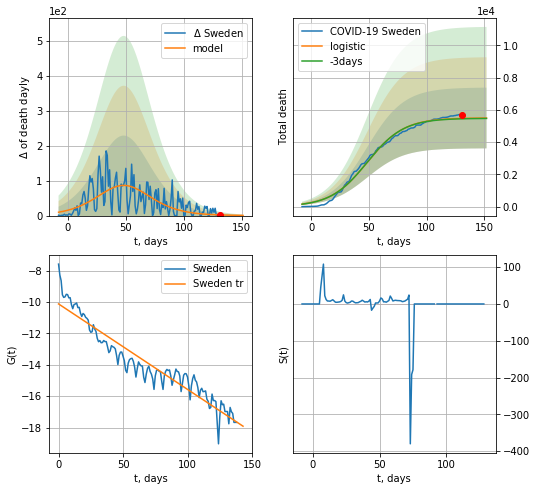

Sweden data at: 2020-07-27
+3 day model MAPE: 0.004728730116764159
model: logistic
coeffs:  [5.49991043e+03 6.27775666e-02 4.86094334e+01]
rational stdev:  0.34272615920529254
forecast at the end of period: +21 days
	 total death:  5491 ± 1882
trend coefficient of determination: 0.903740
 intercept: -10.118931
 slope: -0.054515


In [1631]:
dfSW = read_df(pd.DataFrame(),"SW")
x = forecast('Sweden',dfSW[14:],d1,3*7,shift=1.0,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


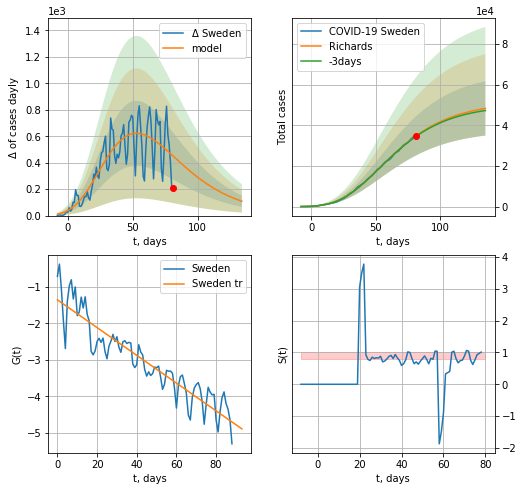

Sweden data at: 2020-07-27
+3 day model MAPE: 0.006966
model: Richards
coeffs: [ 5.16330878e+04  1.82860246e+00 -6.81695942e+01  1.80708945e-02]
rational stdev: 0.276601
forecast at the end of period: +54 days
	 deltaDaycases: 108
	 total cases: 48279 ± 13354
	 total death: 3466 ± 2876
trend coefficient of determination: 0.851661
 intercept: -1.351552
 slope: -0.038050


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


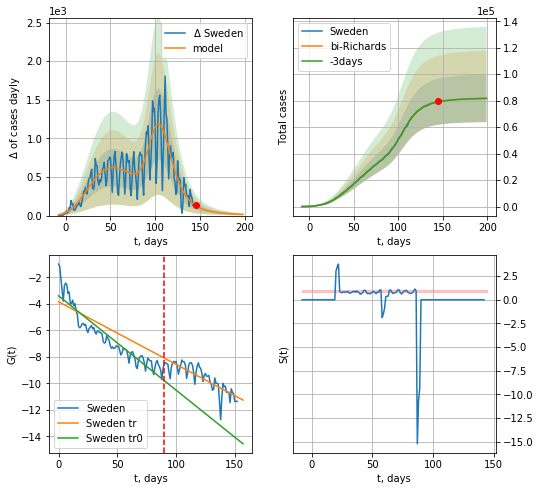

Sweden data at: 2020-07-27
+3 day model MAPE: 0.000889
model: bi-Richards
coeffs: [3.06042192e+04 2.26501760e-01 9.68645218e+01 4.40522653e-01]
rational stdev: 0.219567
forecast at the end of period: +54 days
	 deltaDaycases: 14
	 total cases: 81817 ± 17964
	 total death: 5873 ± 3868
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.877156
 intercept: -3.390188
 slope: -0.071181
trend coefficient of determination: 0.693712
 intercept: -3.841227
 slope: -0.047265


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


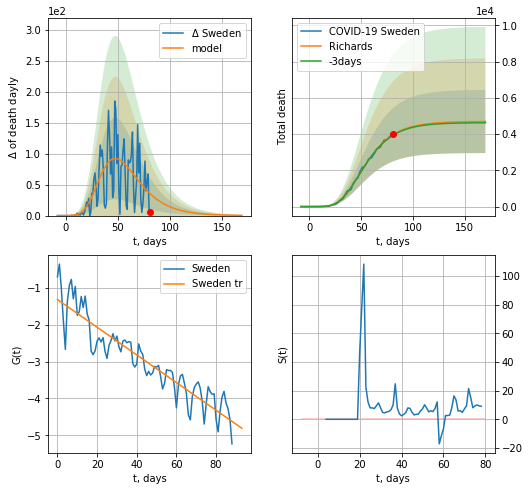

Sweden data at: 2020-07-27
+3 day model MAPE: 0.006764
model: Richards
coeffs: [ 4.70118584e+03  4.74513928e+00 -3.55284189e+01  1.13087458e-02]
rational stdev: 0.370499
forecast at the end of period: +89 days
	 total death: 4694 ± 1739
trend coefficient of determination: 0.849328
 intercept: -1.319237
 slope: -0.037509


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:209: RuntimeWarning: invalid value encountered in true_divide


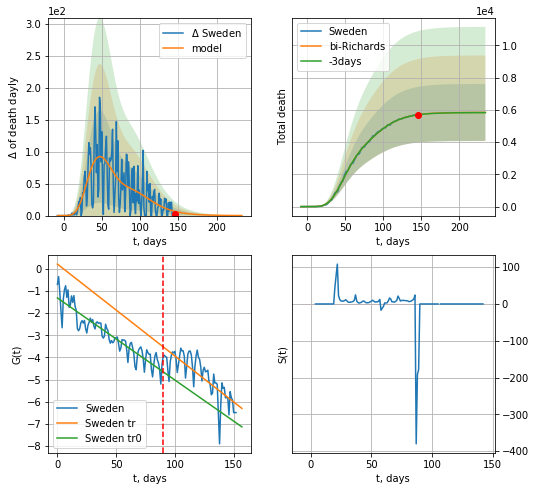

Sweden data at: 2020-07-27
+3 day model MAPE: 0.000896
model: bi-Richards
coeffs: [1.13457105e+03 5.61798031e+00 3.94176227e+00 8.75935168e-03]
rational stdev: 0.302888
forecast at the end of period: +89 days
	 total death: 5833 ± 1767
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.850399
 intercept: -1.313576
 slope: -0.037082
trend coefficient of determination: 0.625338
 intercept: 0.213985
 slope: -0.041500


In [1633]:
vL = 90
x = forecastRR('Sweden',dfSW[:vL],d1,25*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Sweden',dfSW[:],d1,25*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRR('Sweden',dfSW[:vL],d1,30*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs,cases='death')
xx = forecast2RR('Sweden',dfSW[:],d1,30*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,cases='death',vL=vL)
#x = forecastQR('Sweden',dfSW[:],d1,16*7-dT,1.0)
#xx = forecast2R('Sweden',dfSW[:],d1,12*7-dT,x,1.0)#,addpred=True,xcoef=[0.25,1.,2.3,1]

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


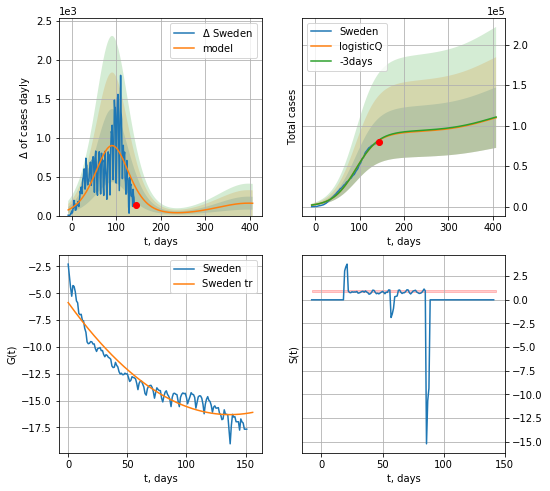

Sweden data at: 2020-07-27
+3 day model MAPE: 0.006458
model: logisticQ
coeffs: [ 9.19544205e+04  4.28870845e-07  9.12527253e+01 -9.10281996e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.339983
forecast at the end of period: +264 days
	 deltaDaycases: 158
	 total cases: 109874 ± 37355
	 total death: 7888 ± 8045
trend coefficient of determination: 0.920862
 intercept_: -5.869836937063353
 coeffs_: [ 0.         -0.15284454  0.00055907]


In [1634]:
x = forecastRRR('Sweden',dfSW[1:],d1,55*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


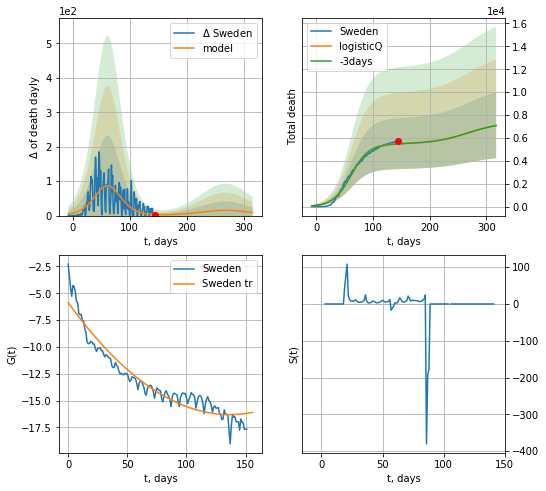

Sweden data at: 2020-07-27
+3 day model MAPE: 0.004802
model: logisticQ
coeffs: [ 5.49326301e+03  1.61936280e-07  6.15674485e+01 -3.90314324e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.404103
forecast at the end of period: +173 days
	 total death: 7097 ± 2868
trend coefficient of determination: 0.920862
 intercept_: -5.869836937063353
 coeffs_: [ 0.         -0.15284454  0.00055907]


In [1635]:
x = forecastRRR('Sweden',dfSW[1:],d1,42*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')

CN
           date    cases  active   death
183 2020-07-23  83750.0     243  4634.0
184 2020-07-24  83784.0     261  4634.0
185 2020-07-25  83830.0     288  4634.0
186 2020-07-26  83891.0     339  4634.0
187 2020-07-27  83959.0     391  4634.0


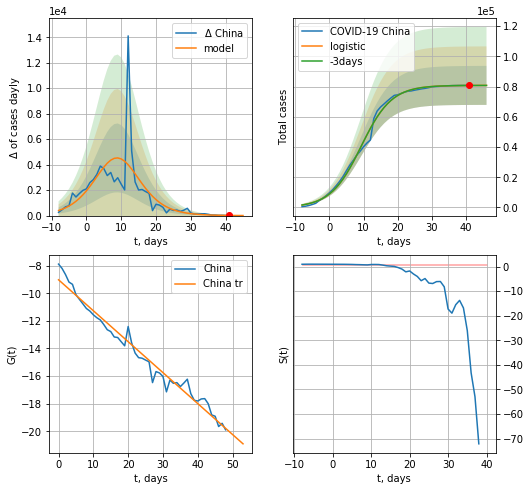

China data at: 2020-07-27
+3 day model MAPE: 0.00012785692963974442
model: logistic
coeffs:  [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.159713160092933
forecast at the end of period: +5 days
	 deltaDaycases:  5
	 total cases:  80788 ± 12903
	 total death:  4459 ± 2136
trend coefficient of determination: 0.972183
 intercept: -9.021396
 slope: -0.224243


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


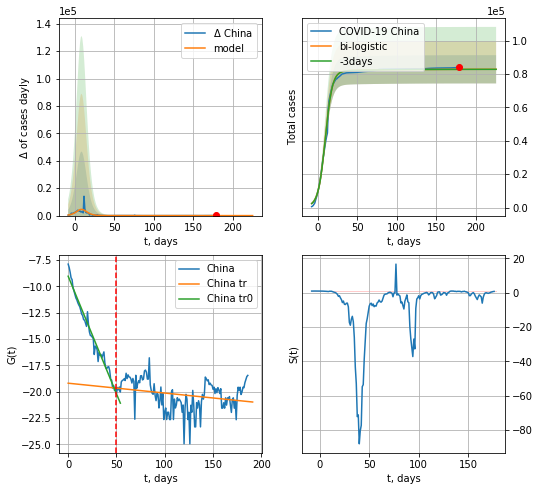

China data at: 2020-07-27
+3 day model MAPE: 0.00032276007425521315
model: bi-logistic
coeffs:  [2.01622492e+03 2.27605911e-02 1.12569498e+01] [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.10214798399722382
forecast at the end of period: +47 days
	 deltaDaycases:  0
	 total cases:  82811 ± 8459
	 total death:  4570 ± 1400
bi-logistic approximation splitting point: 50
trend0 coefficient of determination: 0.973282
 intercept: -9.036652
 slope: -0.223289
trend coefficient of determination: 0.067561
 intercept: -19.198221
 slope: -0.009355


In [1636]:
dfCN = read_df(pd.DataFrame(),"CN")
try:
    x = forecast('China',dfCN[:50],d1,7*18-dT,1.0)
    #xx = forecast('China',dfCN[21:-32],d1,17)
    #xx = np.concatenate((x, xx), axis=0)
    xx = forecast2('China',dfCN[:],d1,24*7-dT,x,1.0,vL=50)
except:
    print ("Exception occurs")

In [1637]:
#dfTT[dfTT.Country=='%s'%('China')][0].values[0]

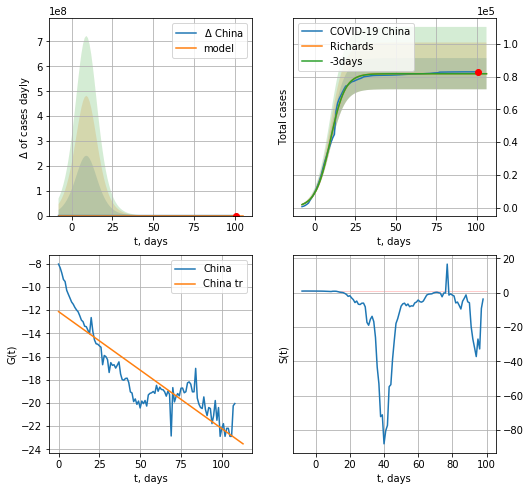

China data at: 2020-07-27
+3 day model MAPE: 0.000627
model: Richards
coeffs: [8.17736184e+04 2.15574455e-01 9.59539709e+00 1.02116174e+00]
rational stdev: 0.116457
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 81773 ± 9523
	 total death: 4513 ± 1576
trend coefficient of determination: 0.785239
 intercept: -12.125055
 slope: -0.100960


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


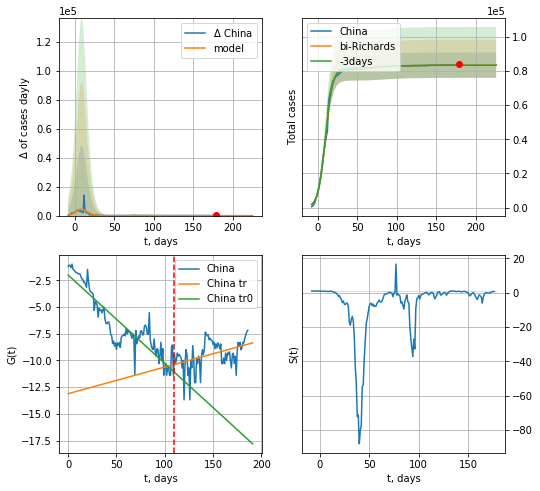

China data at: 2020-07-27
+3 day model MAPE: 0.000637
model: bi-Richards
coeffs: [ 1.73633118e+03  9.26907114e+00 -2.55944126e+01  5.24216135e-03]
rational stdev: 0.089336
forecast at the end of period: +47 days
	 deltaDaycases: 0
	 total cases: 83508 ± 7460
	 total death: 4609 ± 1235
bi-Richards approximation splitting point: 110
trend coefficient of determination: 0.820990
 intercept: -2.005784
 slope: -0.082725
trend coefficient of determination: 0.179267
 intercept: -13.111296
 slope: 0.024920


In [1638]:
vL = 110
x = forecastRR('China',dfCN[:vL],d1,18*7-dT,1.0)
xx = forecast2RR('China',dfCN[:],d1,24*7-dT,x,1.0,vL=vL)
#x = forecastQR('China',dfCN[:],d1,6*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
#xx = forecast2R('China',dfCN[:],d1,6*7-dT,x,1.0)

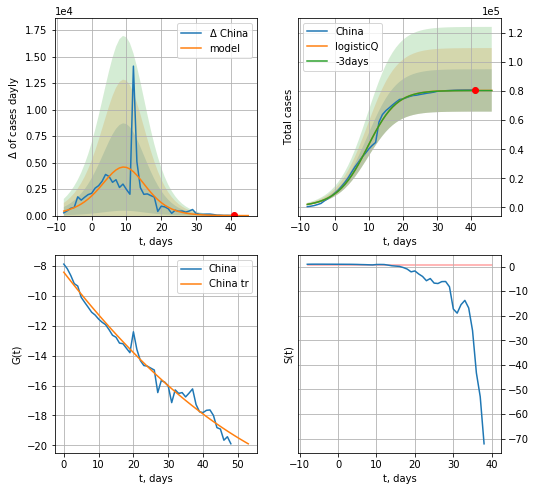

China data at: 2020-07-27
+3 day model MAPE: 0.001323
model: logisticQ
coeffs: [ 8.04175259e+04  1.07650464e-03  9.35257489e+00 -2.02425637e+02]
rational stdev: 0.181019
forecast at the end of period: +5 days
	 deltaDaycases: 1
	 total cases: 80413 ± 14556
	 total death: 4438 ± 2410
trend coefficient of determination: 0.979964
 intercept_: -8.428864441790822
 coeffs_: [ 0.         -0.29994819  0.00157784]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


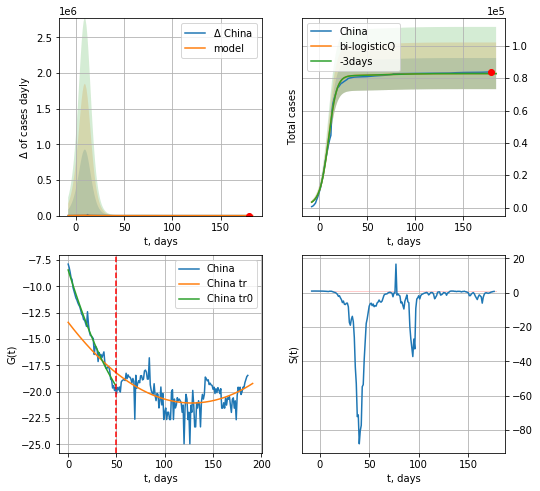

China data at: 2020-07-27
+3 day model MAPE: 0.000410
model: bi-logisticQ
coeffs: [ 2.42953955e+03  3.23974988e-04  2.49342239e+01 -6.26893825e-02]
rational stdev: 0.116142
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 82846 ± 9621
	 total death: 4572 ± 1593
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.980847
 intercept_: -8.442415731989867
 coeffs_: [ 0.         -0.29762768  0.00151769]
trend coefficient of determination: 0.279117
 intercept_: -13.414371508068843
 coeffs_: [ 0.         -0.11979208  0.00046795]


In [1639]:
x = forecastRRR('China',dfCN[:50],d1,7*18-dT,1.0)
xx=forecast2RRR('China',dfCN[:],d1,18*7-dT,x,1.0,vL=50)

In [1640]:
#x = forecastQR('China',dfCN[50:],d1,6*7-dT,1.0)

KR
           date  cases  active  death
159 2020-07-23  13979   864.0  298.0
160 2020-07-24  14092   928.0  298.0
161 2020-07-25  14150   962.0  298.0
162 2020-07-26  14175   971.0  299.0
163 2020-07-27  14203   896.0  300.0


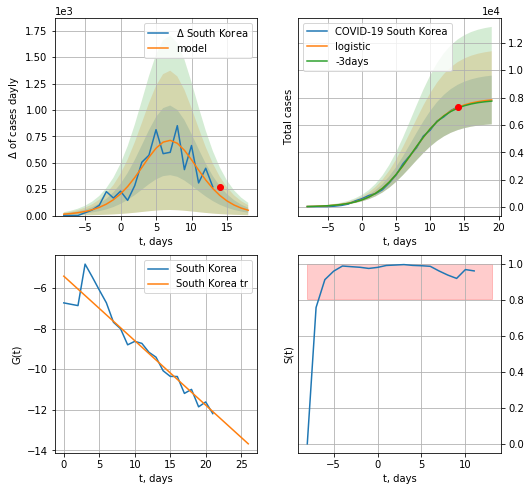

South Korea data at: 2020-07-27
model: logistic
coeffs:  [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.2275932520547523
forecast at the end of period: +5 days
	 deltaDaycases:  50
	 total cases:  7821 ± 1780
	 total death:  165 ± 112
trend coefficient of determination: 0.904554
 intercept: -5.419235
 slope: -0.317547


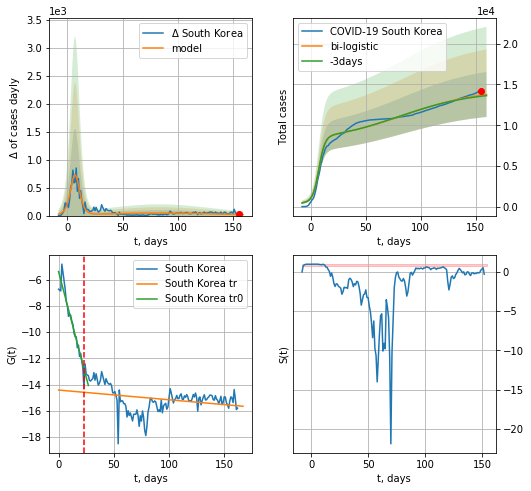

South Korea data at: 2020-07-27
+3 day model MAPE: 0.009743337927610625
model: bi-logistic
coeffs:  [6.53432713e+03 2.79313131e-02 8.38981567e+01] [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.20035986774977999
forecast at the end of period: +5 days
	 deltaDaycases:  17
	 total cases:  13778 ± 2760
	 total death:  291 ± 174
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.916463
 intercept: -5.394262
 slope: -0.321115
trend coefficient of determination: 0.091681
 intercept: -14.415473
 slope: -0.007384


In [1641]:
dfKR = read_df(pd.DataFrame(),"KR")
x = forecast('South Korea',dfKR[:23],d1,7*18-dT,1.0,pMAPE=False)
xx=forecast2('South Korea',dfKR[:],d1,18*7-dT,x,1.0,vL=23)

In [1642]:
#vL = 30
#x = forecastRRR('South Korea',dfKR[:vL],d1,8*7-dT,1.0)
#x1 = forecastRRR('South Korea',dfKR[39:],d1,12*7-dT,1.0)
#xx = np.concatenate((x, x1), axis=0)
#xx=forecast2RRR('South Korea',dfKR[:],d1,8*7-dT,x,1.0,vL=vL)

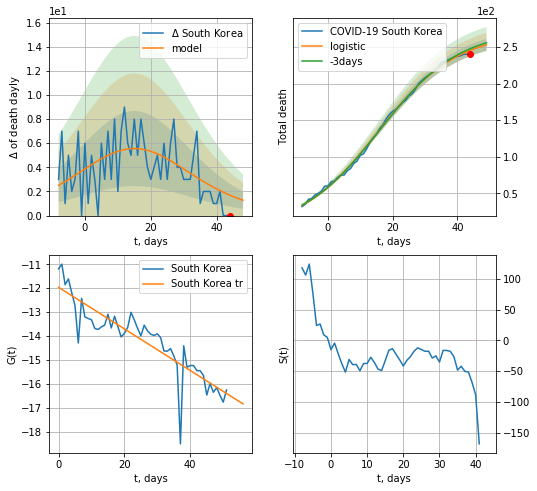

South Korea data at: 2020-07-27
model: logistic
coeffs:  [2.68513907e+02 8.28168907e-02 1.55065021e+01]
rational stdev:  0.032418936831668854
forecast at the end of period: +5 days
	 total death:  252 ± 8
trend coefficient of determination: 0.782213
 intercept: -11.965009
 slope: -0.087016


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:251: RuntimeWarning: divide by zero encountered in true_divide


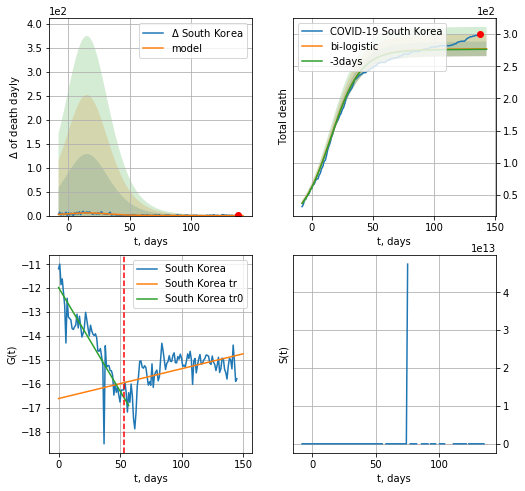

South Korea data at: 2020-07-27
+3 day model MAPE: 0.002674468365348876
model: bi-logistic
coeffs:  [ 9.24569887  0.0202981  10.17717854] [2.68513907e+02 8.28168907e-02 1.55065021e+01]
rational stdev:  0.04096195124309636
forecast at the end of period: +5 days
	 deltaDaydeath:  0
	 total death:  277 ± 11
bi-logistic approximation splitting point: 53
trend0 coefficient of determination: 0.789613
 intercept: -11.973248
 slope: -0.086531
trend coefficient of determination: 0.266165
 intercept: -16.615945
 slope: 0.012461


In [1643]:
x = forecast('South Korea',dfKR[17:70],d1,18*7-dT,1.0,cases='death',pMAPE=False)
xx=forecast2('South Korea',dfKR[17:],d1,18*7-dT,x,1.0,vL=70-17,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


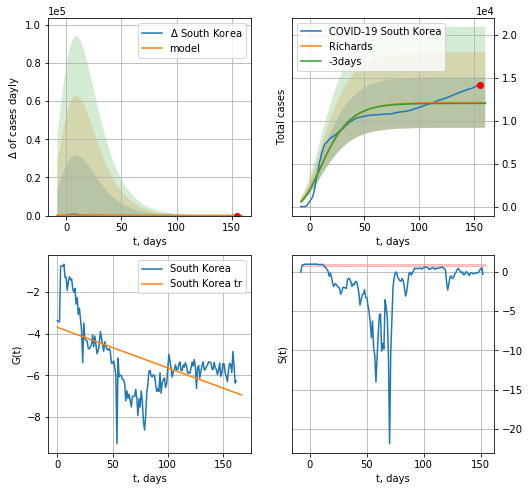

South Korea data at: 2020-07-27
+3 day model MAPE: 0.008090
model: Richards
coeffs: [ 1.21405004e+04  2.11668443e+01 -8.52567188e+01  2.90800379e-03]
rational stdev: 0.241859
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 12139 ± 2936
	 total death: 256 ± 185
trend coefficient of determination: 0.320981
 intercept: -3.698702
 slope: -0.019419


In [1644]:
x = forecastRR('South Korea',dfKR[:],d1,18*7-dT,1.0)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


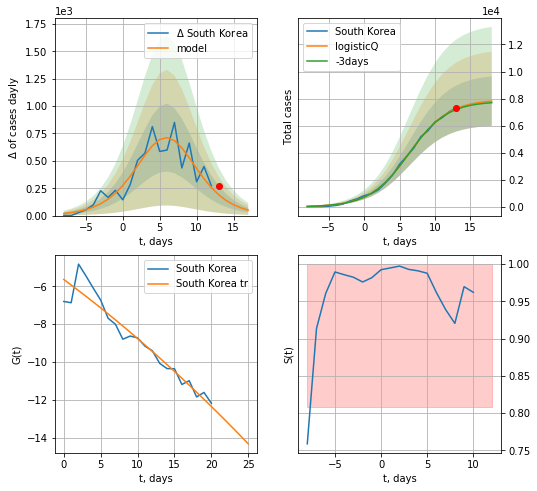

South Korea data at: 2020-07-27
+3 day model MAPE: 0.011158
model: logisticQ
coeffs: [ 7.93644740e+03  5.70893336e-05  6.37140939e+00 -6.30084107e+03]
rational stdev: 0.233522
forecast at the end of period: +5 days
	 deltaDaycases: 50
	 total cases: 7818 ± 1825
	 total death: 165 ± 115
trend coefficient of determination: 0.923340
 intercept_: -5.639271391154587
 coeffs_: [ 0.         -0.28882126 -0.00235709]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:333: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


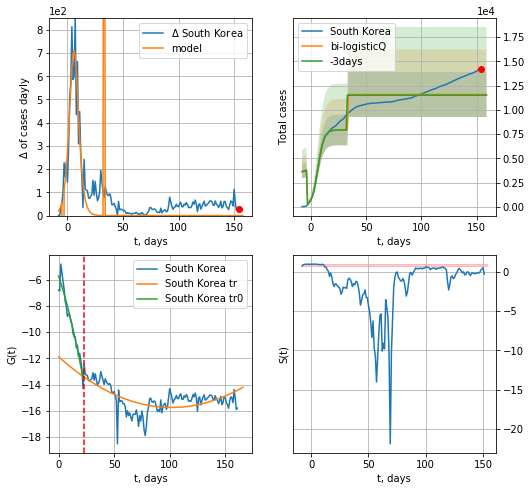

South Korea data at: 2020-07-27
+3 day model MAPE: 0.006846
model: bi-logisticQ
coeffs: [ 3.65084218e+03  1.15083077e+01  3.31419196e+01 -3.37415623e+00]
rational stdev: 0.200230
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 11587 ± 2320
	 total death: 244 ± 146
bi-logisticQ approximation splitting point: 23
trend coefficient of determination: 0.939645
 intercept_: -5.742054822567119
 coeffs_: [ 0.         -0.24685696 -0.00483449]
trend coefficient of determination: 0.384902
 intercept_: -11.874161686170613
 coeffs_: [ 0.         -0.07599682  0.00037339]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [1645]:
vL=23
x = forecastRRR('South Korea',dfKR[1:vL],d1,18*7-dT,1.0)
xx=forecast2RRR('South Korea',dfKR[1:],d1,18*7-dT,x,1.0,vL=vL)

In [1646]:
#x = forecastRR('South Korea',dfKR[68:],d1,10*7-dT,1.0)

In [1647]:
#vL=25
#x = forecastQR('South Korea',dfKR[1:vL],d1,16*7-dT,1.0)
#xx=forecast2QR('South Korea',dfKR[1:],d1,16*7-dT,x,1.0,vL=vL)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


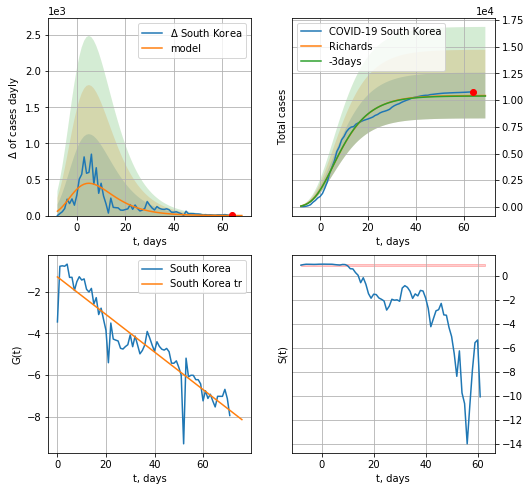

South Korea data at: 2020-07-27
+3 day model MAPE: 0.004436
model: Richards
coeffs: [ 1.04317316e+04  3.08211996e+01 -4.22121900e+01  3.79550844e-03]
rational stdev: 0.205414
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 10425 ± 2141
	 total death: 220 ± 135
trend coefficient of determination: 0.863607
 intercept: -1.289212
 slope: -0.090002


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


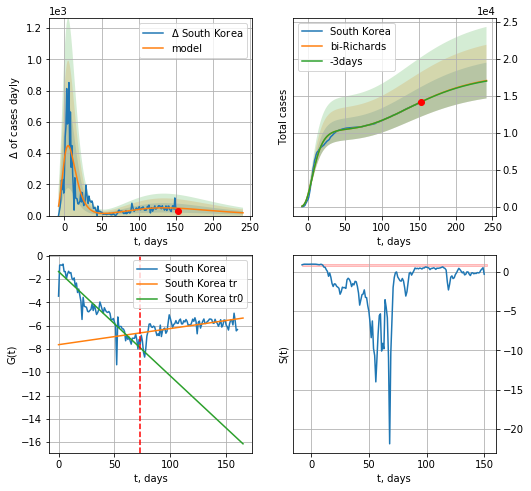

South Korea data at: 2020-07-27
+3 day model MAPE: 0.000806
model: bi-Richards
coeffs: [ 7.75158085e+03  1.52809981e+00 -1.19620303e+02  1.14922211e-02]
rational stdev: 0.141574
forecast at the end of period: +89 days
	 deltaDaycases: 17
	 total cases: 17091 ± 2419
	 total death: 361 ± 153
bi-Richards approximation splitting point: 73
trend coefficient of determination: 0.865949
 intercept: -1.361156
 slope: -0.089601
trend coefficient of determination: 0.295867
 intercept: -7.636461
 slope: 0.013836


In [1648]:
vL = 2
vL1 = 75
x = forecastRR('South Korea',dfKR[vL:vL1],d1,18*7-dT,1.0)
xx=forecast2RR('South Korea',dfKR[vL:],d1,30*7-dT,x,1.0,vL=vL1-vL)
#xx = np.concatenate((x, xx), axis=0)
#print (xx)
#xxx=forecast3RR('South Korea',dfKR[1:],d1,12*7-dT,xx,1.0,vL=[vL,vL1],zoom=1e3)

In [1649]:
a = np.array([ 7.90607495e+03,  3.14377481e-03, -1.32150046e+02,  5.22462480e+00, 7.59593205e-01])
b = np.array([ 2.91876181e+03,  1.43325056e-01, -3.99886263e+01, -3.39427361e+02, 1.77367535e-03])
QRkoreaCoeffs=b/a
QRkoreaCoeffs,RkoreaCoeffs,koreaCoeffs

(array([ 3.69179628e-01,  4.55901153e+01,  3.02600169e-01, -6.49668395e+01,
         2.33503320e-03]),
 [0.36242246, 2.56241634, 1.84890887, 0.13324732],
 [0.35416971, 0.02606324, 4.35859408, 19.30413219])

In [1650]:
#x = forecastQR('South Korea',dfKR[:],d1,16*7-dT,1.0)

SG
           date    cases  active  death
182 2020-07-23  49375.0    4333   27.0
183 2020-07-24  49630.0    4176   27.0
184 2020-07-25  49888.0    4509   27.0
185 2020-07-26  50369.0    4821   27.0
186 2020-07-27  51197.0    5478   27.0


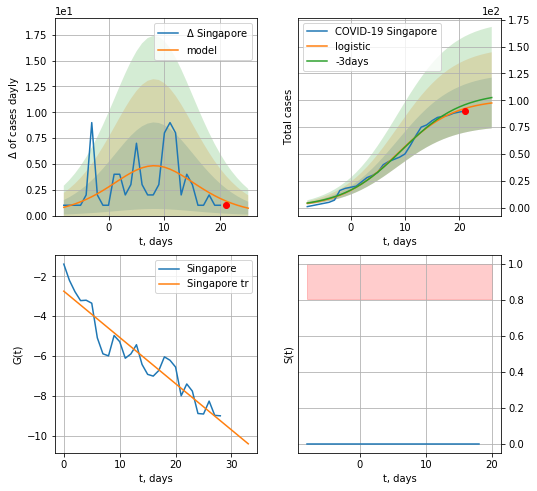

Singapore data at: 2020-07-27
+3 day model MAPE: 0.03963437966370839
model: logistic
coeffs:  [101.02990869   0.19128696   8.67555654]
rational stdev:  0.24212715882466435
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  97 ± 23
	 total death:  0 ± 0
trend coefficient of determination: 0.887345
 intercept: -2.744831
 slope: -0.232145


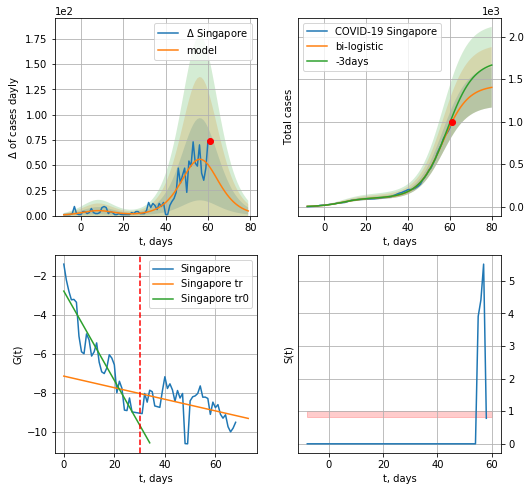

Singapore data at: 2020-07-27
+3 day model MAPE: 0.06119827726371909
model: bi-logistic
coeffs:  [1.32695355e+03 1.68329223e-01 5.66911530e+01] [101.02990869   0.19128696   8.67555654]
rational stdev:  0.16894112356490856
forecast at the end of period: +19 days
	 deltaDaycases:  4
	 total cases:  1402 ± 236
	 total death:  0 ± 0
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend coefficient of determination: 0.177815
 intercept: -7.138791
 slope: -0.029776


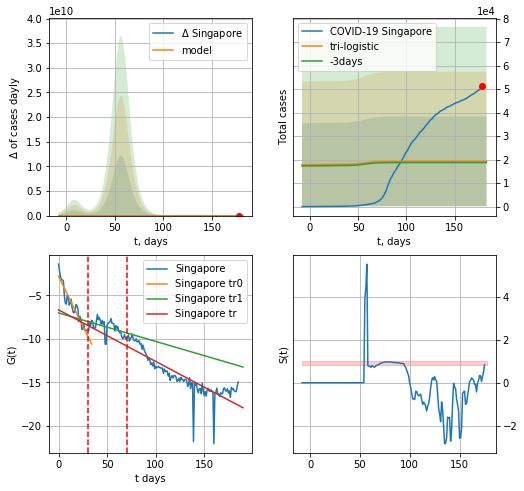

Singapore data at: 2020-07-27
+3 day model MAPE: 0.02716654218094322
model: tri-logistic
coeffs:  [ 1.78252004e+04 -1.18222485e+01  2.89526566e+02] [1.01029909e+02 1.91286963e-01 8.67555654e+00 1.32695355e+03
 1.68329223e-01 5.66911530e+01]
forecast rational stdev:  0.9910773400400505
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  19253 ± 19081
	 total death:  10 ± 29
tri-logistic approximation splitting points: 30,70
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend1 coefficient of determination: 0.215531
 intercept: -7.009854
 slope: -0.032798
trend coefficient of determination: 0.735677
 intercept: -6.656713
 slope: -0.059378


In [1651]:
vL = 30
vL1 = 70
try:
    dfSG = read_df(pd.DataFrame(),"SG")
    x = forecast('Singapore',dfSG[:vL],d1,7*18-dT,1.0)
    xx = forecast2('Singapore',dfSG[:vL1],d1,20*7-dT,x,1.0,vL=vL)
    xx = np.concatenate((x, xx), axis=0)
    xxx = forecast3("Singapore",dfSG,d1,18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])
except:
    print ("Exception occurs")

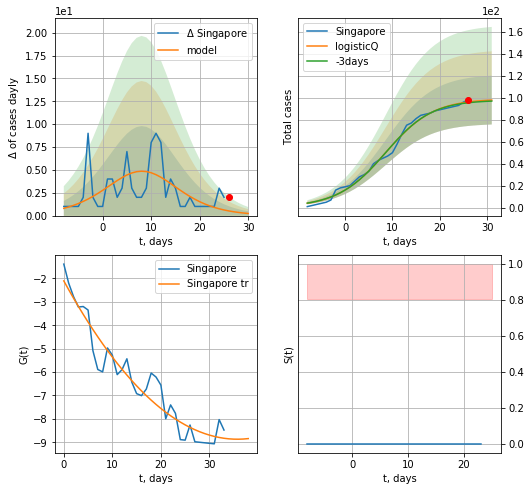

Singapore data at: 2020-07-27
+3 day model MAPE: 0.007575
model: logisticQ
coeffs: [ 9.88556613e+01  2.70689941e-04  8.43151450e+00 -7.17657610e+02]
rational stdev: 0.226599
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 97 ± 22
	 total death: 0 ± 0
trend coefficient of determination: 0.918167
 intercept_: -2.103369555726971
 coeffs_: [ 0.         -0.37832792  0.00528917]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


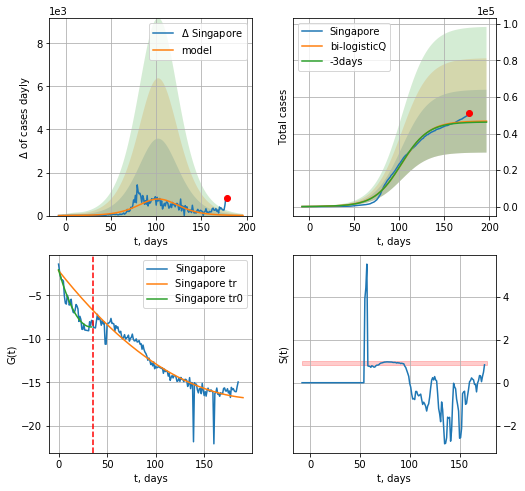

Singapore data at: 2020-07-27
+3 day model MAPE: 0.010875
model: bi-logisticQ
coeffs: [ 4.67592142e+04  1.57559075e-07  1.02714717e+02 -4.18505866e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.367627
forecast at the end of period: +19 days
	 deltaDaycases: 6
	 total cases: 46769 ± 17193
	 total death: 24 ± 26
bi-logisticQ approximation splitting point: 35
trend coefficient of determination: 0.914568
 intercept_: -2.036640634366525
 coeffs_: [ 0.         -0.39517788  0.00592335]
trend coefficient of determination: 0.899537
 intercept_: -2.130586514379349
 coeffs_: [ 0.         -0.14117564  0.00033747]


In [1652]:
vL = 35
x = forecastRRR('Singapore',dfSG[:vL],d1,7*18-dT,1.0)
xx = forecast2RRR('Singapore',dfSG[:],d1,20*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

In [1653]:
#vL = 31
#x = forecast('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
#xx = forecast2('Singapore',dfSG[:],d1,12*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

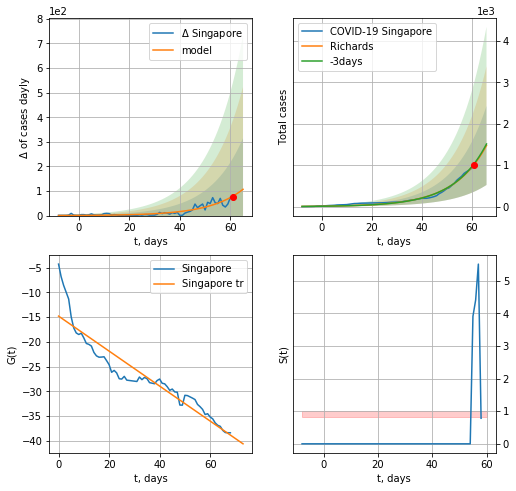

Singapore data at: 2020-07-27
+3 day model MAPE: 0.018053
model: Richards
coeffs: [1.19651032e+04 7.51038701e-02 9.38537054e+01 5.18379818e+00]
rational stdev: 0.645526
forecast at the end of period: +5 days
	 deltaDaycases: 106
	 total cases: 1477 ± 953
	 total death: 0 ± 0
trend coefficient of determination: 0.871412
 intercept: -14.802032
 slope: -0.353914


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


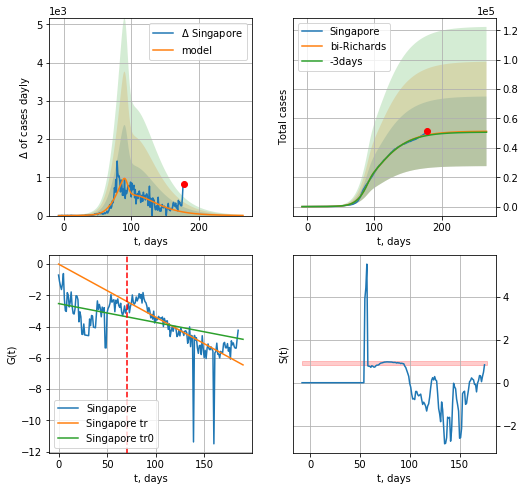

Singapore data at: 2020-07-27
+3 day model MAPE: 0.007678
model: bi-Richards
coeffs: [ 3.93776774e+04  3.62077400e+00 -2.06519174e+01  1.01116483e-02]
rational stdev: 0.462382
forecast at the end of period: +89 days
	 deltaDaycases: 3
	 total cases: 51239 ± 23691
	 total death: 27 ± 37
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.060320
 intercept: -2.525312
 slope: -0.012033
trend coefficient of determination: 0.574204
 intercept: 0.000893
 slope: -0.033952


In [1654]:
vL = 70
x = forecastRR('Singapore',dfSG[:vL],d1,18*7-dT,1.0)
x = forecast2RR('Singapore',dfSG[:],d1,30*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#xx = forecast2R('Singapore',dfSG[:],d1,28*7-dT,x,1.0)
#x = forecastQR('Singapore',dfSG[60:],d1,16*7-dT,1.0)

ES
           date   cases  active  death
133 2020-07-23  2027.5      46   69.0
134 2020-07-24  2033.0      49   69.0
135 2020-07-25  2034.0      43   69.0
136 2020-07-26  2034.5      43   69.0
137 2020-07-27  2038.0      45   69.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


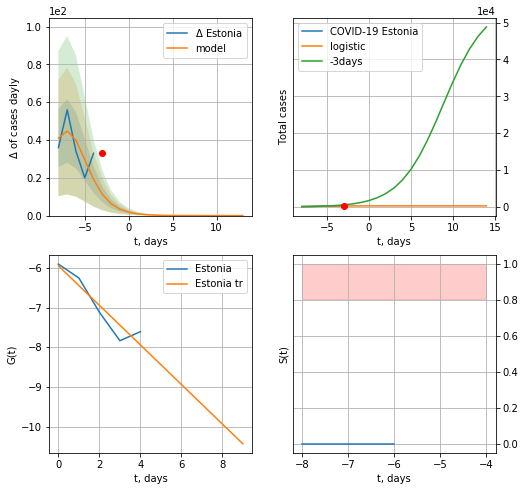

Estonia data at: 2020-07-27
+3 day model MAPE: 0.6707560325989319
model: logistic
coeffs:  [277.64023437   0.65084323  -6.57074778]
rational stdev:  0.028784635369283593
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  277 ± 7
	 total death:  9 ± 0
trend coefficient of determination: 0.881874
 intercept: -5.949047
 slope: -0.498463


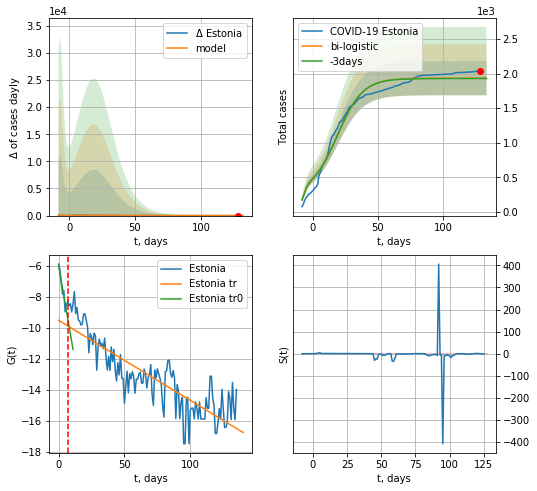

Estonia data at: 2020-07-27
+3 day model MAPE: 0.00261734373382185
model: bi-logistic
coeffs:  [1.65570201e+03 1.02320884e-01 1.90245226e+01] [277.64023437   0.65084323  -6.57074778]
rational stdev:  0.12758537511427273
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  1933 ± 246
	 total death:  65 ± 24
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.894917
 intercept: -5.986038
 slope: -0.491580
trend coefficient of determination: 0.732959
 intercept: -9.527492
 slope: -0.051602


In [1656]:
shift = 1.0
try:
    dfES = read_df(pd.DataFrame(),"ES")
    x = forecast('Estonia',dfES[1:7],d1,17,1.)
    xx = forecast2('Estonia',dfES[1:],d1,18*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.5],vL=7)
except:
    print ("Exception occurs")

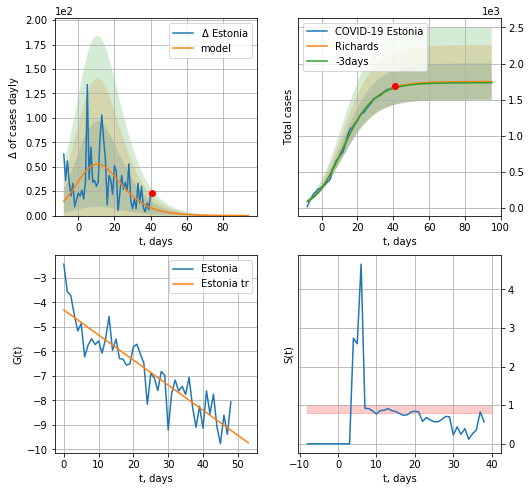

Estonia data at: 2020-07-27
+3 day model MAPE: 0.005500
model: Richards
coeffs: [1.74994625e+03 2.01778040e-01 4.40549265e+00 5.06366617e-01]
rational stdev: 0.144467
forecast at the end of period: +54 days
	 deltaDaycases: 0
	 total cases: 1749 ± 252
	 total death: 59 ± 25
trend coefficient of determination: 0.813896
 intercept: -4.307385
 slope: -0.102288


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


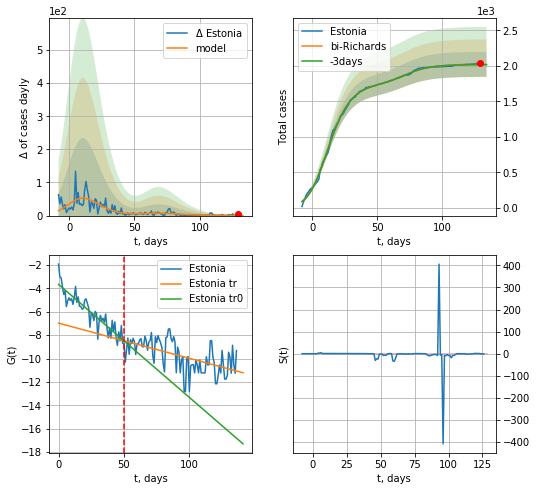

Estonia data at: 2020-07-27
+3 day model MAPE: 0.002018
model: bi-Richards
coeffs: [2.70644443e+02 2.22203482e-01 5.91109765e+01 3.87220663e-01]
rational stdev: 0.087091
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 2019 ± 175
	 total death: 68 ± 17
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.810013
 intercept: -3.652535
 slope: -0.096810
trend coefficient of determination: 0.320149
 intercept: -6.970564
 slope: -0.030128


In [1657]:
vL=50
x = forecastRR('Estonia',dfES[:vL],d1,7*25-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
#x = forecastQR('Estonia',dfES[10:],d1,7*10-dT,1.)
xx = forecast2RR('Estonia',dfES[:],d1,7*18-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


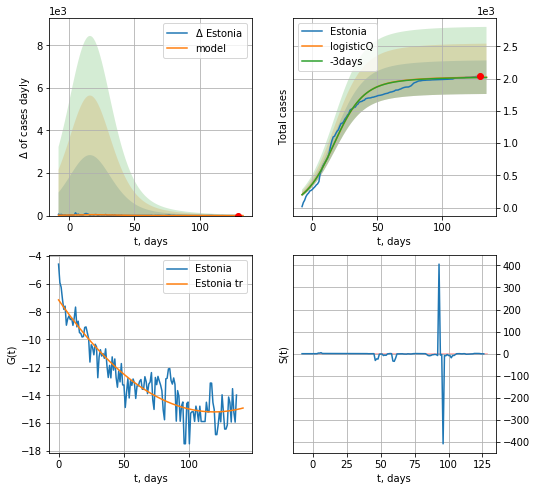

Estonia data at: 2020-07-27
+3 day model MAPE: 0.002348
model: logisticQ
coeffs: [ 1.94091209e+03  1.40739588e-07  1.64225588e+01 -6.30447632e+05]
S.Korea scenario coeffs: [0.04375, 0.5, 4.0, 1]
rational stdev: 0.128587
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 2021 ± 259
	 total death: 68 ± 26
trend coefficient of determination: 0.851561
 intercept_: -7.162726742471839
 coeffs_: [ 0.         -0.13514175  0.0005683 ]


In [1658]:
x = forecastRRR('Estonia',dfES[:],d1,7*18-dT,1.,addpred=True,xcoef=[0.35/8,.5,4.,1])

LV
           date   cases  active  death
138 2020-07-23  1205.0     129   31.0
139 2020-07-24  1206.0     130   31.0
140 2020-07-25  1219.0     143   31.0
141 2020-07-26  1219.5     143   31.0
142 2020-07-27  1220.0     137   31.0


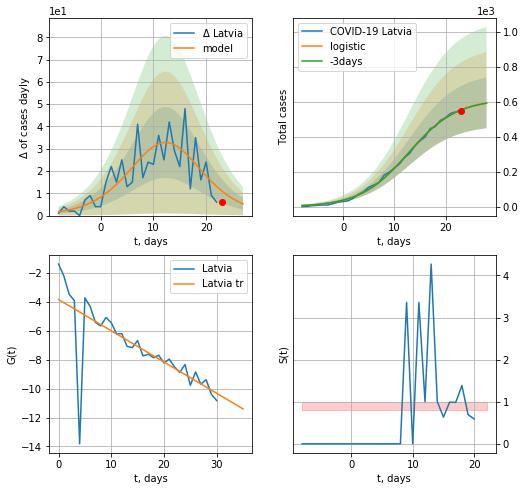

Latvia data at: 2020-07-27
+3 day model MAPE: 0.003263338184172393
model: logistic
coeffs:  [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.24373797630646024
forecast at the end of period: +5 days
	 deltaDaycases:  5
	 total cases:  593 ± 144
	 total death:  15 ± 10
trend coefficient of determination: 0.538666
 intercept: -3.837099
 slope: -0.216023


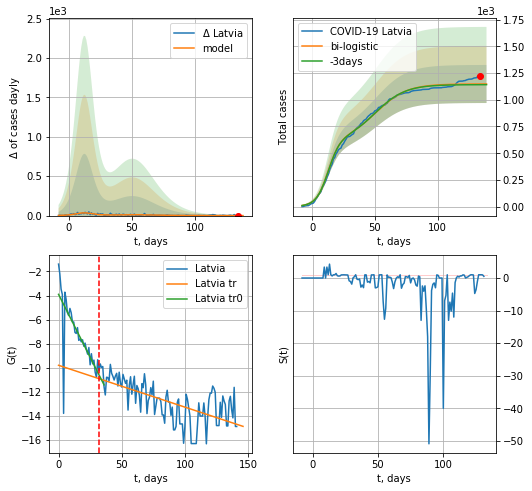

Latvia data at: 2020-07-27
+3 day model MAPE: 0.005607401566994301
model: bi-logistic
coeffs:  [5.31566740e+02 8.20060870e-02 5.09861668e+01] [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.15504147457047415
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  1147 ± 177
	 total death:  29 ± 13
bi-logistic approximation splitting point: 32
trend0 coefficient of determination: 0.543521
 intercept: -3.904452
 slope: -0.209287
trend coefficient of determination: 0.424999
 intercept: -9.810336
 slope: -0.034829


In [1660]:
vL=32
dfLV = read_df(pd.DataFrame(),"LV")
try:
    x = forecast('Latvia',dfLV[:vL],d1,18*7-dT,1.)
    xx=forecast2('Latvia',dfLV[:],d1,18*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.],vL=vL)
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


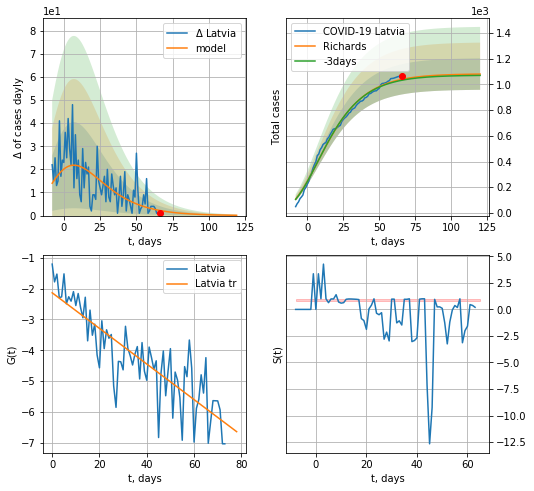

Latvia data at: 2020-07-27
+3 day model MAPE: 0.006926
model: Richards
coeffs: [ 1.08327891e+03  6.55865808e+00 -7.95752157e+01  8.38168173e-03]
rational stdev: 0.113290
forecast at the end of period: +54 days
	 deltaDaycases: 0
	 total cases: 1081 ± 122
	 total death: 27 ± 9
trend coefficient of determination: 0.723415
 intercept: -2.136856
 slope: -0.057686


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


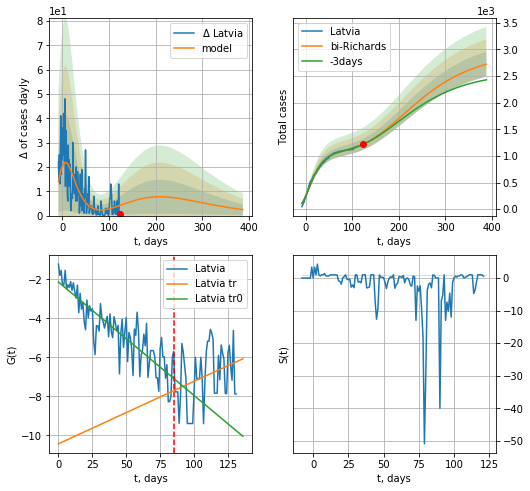

Latvia data at: 2020-07-27
+3 day model MAPE: 0.001678
model: bi-Richards
coeffs: [ 1.87032961e+03  1.00801476e+00 -1.87284747e+02  1.12249373e-02]
rational stdev: 0.085748
forecast at the end of period: +264 days
	 deltaDaycases: 2
	 total cases: 2721 ± 233
	 total death: 69 ± 17
bi-Richards approximation splitting point: 85
trend coefficient of determination: 0.757817
 intercept: -2.139038
 slope: -0.058163
trend coefficient of determination: 0.091764
 intercept: -10.435638
 slope: 0.032057


In [1662]:
iL=10
vL = 85+iL
x = forecastRR('Latvia',dfLV[iL:vL-iL],d1,7*25-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Latvia',dfLV[iL:],d1,7*55-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#x = forecastQR('Latvia',dfLV[:],d1,7*16-dT,1.)
#xx=forecast2R('Latvia',dfLV[:],d1,10*7-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


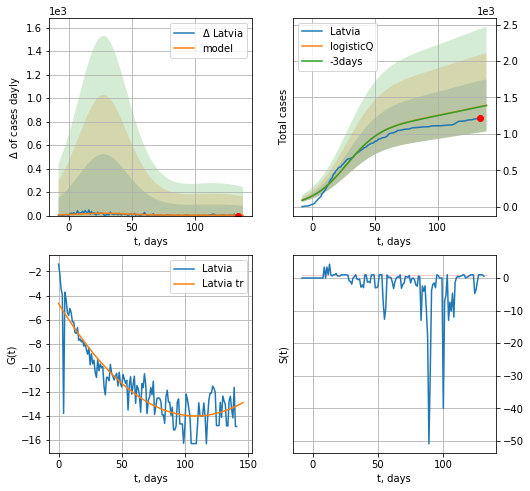

Latvia data at: 2020-07-27
+3 day model MAPE: 0.002058
model: logisticQ
coeffs: [ 1.12963232e+03  1.26438595e-07  2.76316898e+01 -5.55708955e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.257783
forecast at the end of period: +5 days
	 deltaDaycases: 3
	 total cases: 1392 ± 358
	 total death: 35 ± 27
trend coefficient of determination: 0.804900
 intercept_: -4.668232123717639
 coeffs_: [ 0.         -0.17250977  0.00079481]


In [1663]:
#trend3(dfCA[12:],dfPT,dfTR[4:],'CA','PT','TR',40,40,40)
x = forecastRRR('Latvia',dfLV[:],d1,7*18-dT,1.,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


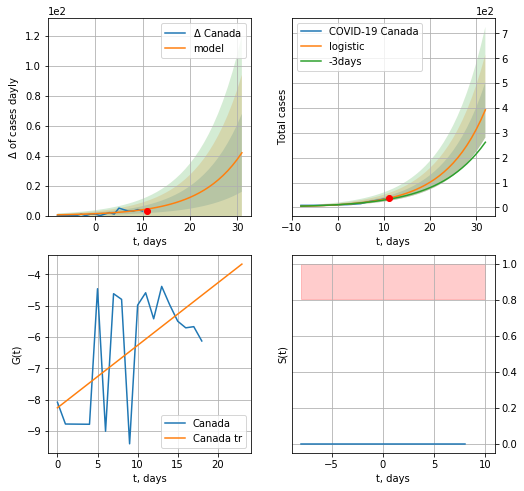

Canada data at: 2020-07-27
+3 day model MAPE: 0.14133490187696762
model: logistic
coeffs:  [1.25342997e+05 1.13222116e-01 8.29018541e+01]
rational stdev:  0.2833740936364515
forecast at the end of period: +21 days
	 deltaDaycases:  41
	 total cases:  392 ± 111
	 total death:  30 ± 25
trend coefficient of determination: 0.348503
 intercept: -8.254919
 slope: 0.199271


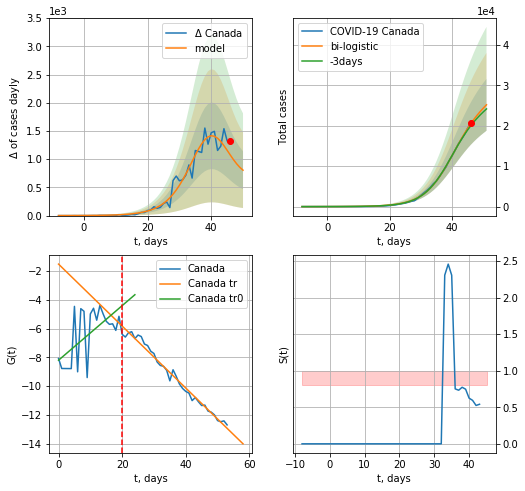

Canada data at: 2020-07-27
+3 day model MAPE: 0.029367009846107475
model: bi-logistic
coeffs:  [2.40153999e+04 2.16961374e-01 4.02658690e+01] [1.25342997e+05 1.13222116e-01 8.29018541e+01]
rational stdev:  0.2549294005106464
forecast at the end of period: +5 days
	 deltaDaycases:  805
	 total cases:  25178 ± 6418
	 total death:  1955 ± 1495
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend coefficient of determination: 0.982767
 intercept: -1.518979
 slope: -0.215271


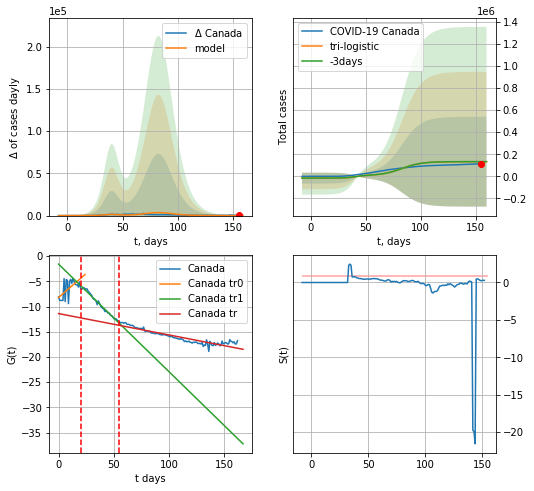

Canada data at: 2020-07-27
+3 day model MAPE: 0.0026611501275292946
model: tri-logistic
coeffs:  [-1.62393375e+04  1.97106377e+00 -3.46774700e+01] [1.25342997e+05 1.13222116e-01 8.29018541e+01 2.40153999e+04
 2.16961374e-01 4.02658690e+01]
forecast rational stdev:  3.0569587315768105
forecast at the end of period: +5 days
	 deltaDaycases:  2
	 total cases:  133098 ± 406877
	 total death:  10338 ± 94808
tri-logistic approximation splitting points: 20,55
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend1 coefficient of determination: 0.983223
 intercept: -1.572806
 slope: -0.213535
trend coefficient of determination: 0.858241
 intercept: -11.389435
 slope: -0.042432


In [1664]:
vL=20
vL1=55
x = forecast('Canada',dfCA[:vL],d1,3*7,1.)
xx=forecast2('Canada',dfCA[:vL1],d1,18*7-dT,x,1.,vL=vL)#,addpred=True,xcoef=[0.25,1.,2.]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Canada",dfCA[:],d1,18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

CA
           date     cases  active   death
159 2020-07-23  112672.0    5279  8874.0
160 2020-07-24  113206.0    5452  8881.0
161 2020-07-25  113556.0    5556  8885.0
162 2020-07-26  113911.0    5666  8890.0
163 2020-07-27  114597.0    5836  8901.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


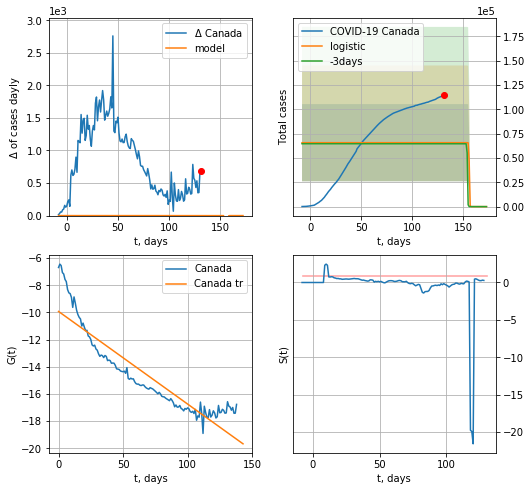

Canada data at: 2020-07-27
+3 day model MAPE: 0.01634566107958619
model: logistic
coeffs:  [ 6.57393071e+04 -5.38060079e+00  1.56159245e+02]
rational stdev:  0.6038303286174572
forecast at the end of period: +42 days
	 deltaDaycases:  0
	 total cases:  0 ± 0
	 total death:  0 ± 0
trend coefficient of determination: 0.834501
 intercept: -9.928432
 slope: -0.068116


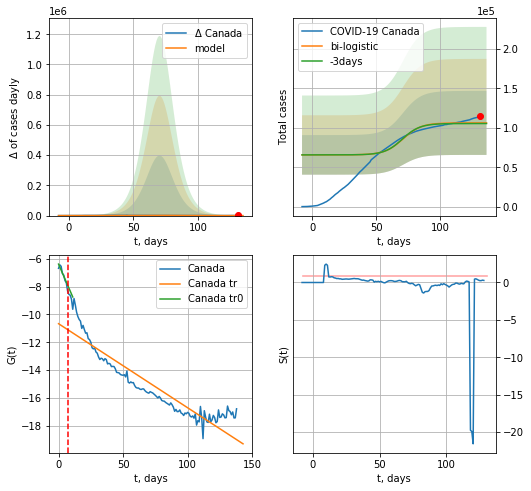

Canada data at: 2020-07-27
+3 day model MAPE: 0.007448479545180506
model: bi-logistic
coeffs:  [4.05798679e+04 1.41410347e-01 7.07976486e+01] [ 6.57393071e+04 -5.38060079e+00  1.56159245e+02]
rational stdev:  0.3819964928908992
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  106315 ± 40612
	 total death:  8257 ± 9462
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.859073
 intercept: -6.392122
 slope: -0.214001
trend coefficient of determination: 0.850277
 intercept: -10.664568
 slope: -0.060229


In [1665]:
dfCA = read_df(pd.DataFrame(),"CA")
x = forecast('Canada',dfCA[24:],d1,6*7,1.,cases='cases')
xx=forecast2('Canada',dfCA[24:],d1,18*7-dT,x,1.,vL=31-24,cases='cases')

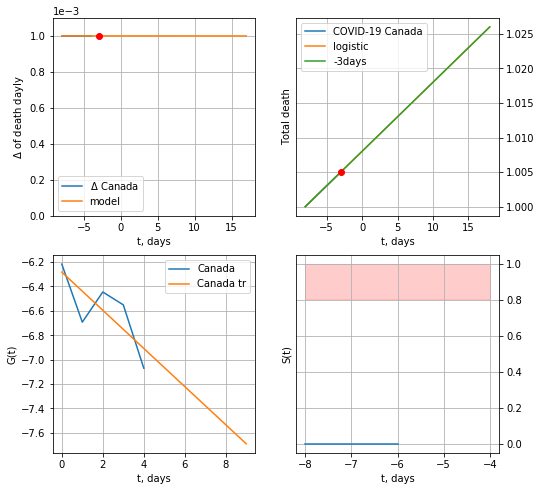

Canada data at: 2020-07-27
+3 day model MAPE: 6.189159426418585e-07
model: logistic
coeffs:  [2.01800807e+00 1.98223827e-03 1.00386171e+00]
rational stdev:  1.593569349221903e-08
forecast at the end of period: +21 days
	 total death:  1 ± 0
trend coefficient of determination: 0.608158
 intercept: -6.282802
 slope: -0.156326


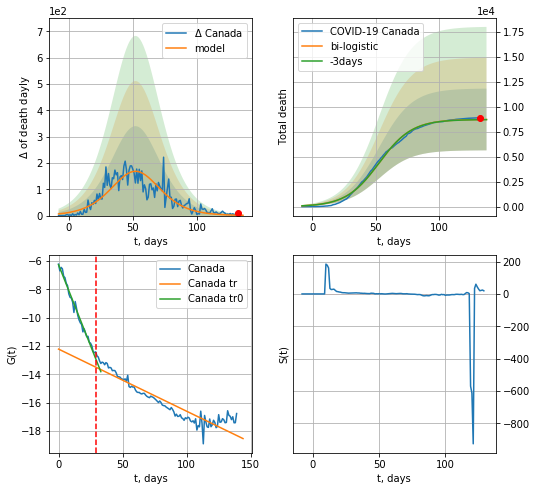

Canada data at: 2020-07-27
+3 day model MAPE: 0.001879804030609572
model: bi-logistic
coeffs:  [8.73803888e+03 7.71185566e-02 5.25359639e+01] [2.01800807e+00 1.98223827e-03 1.00386171e+00]
rational stdev:  0.35414943900176094
forecast at the end of period: +5 days
	 deltaDaydeath:  1
	 total death:  8726 ± 3090
bi-logistic approximation splitting point: 29
trend0 coefficient of determination: 0.986075
 intercept: -6.260314
 slope: -0.228750
trend coefficient of determination: 0.865752
 intercept: -12.217018
 slope: -0.043872


In [1666]:
vL=29
vL1=50
x = forecast('Canada',dfCA[23:vL],d1,3*7,1.,cases='death')
xx=forecast2('Canada',dfCA[23:],d1,18*7-dT,x,1.,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,2.]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Canada",dfCA[24:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


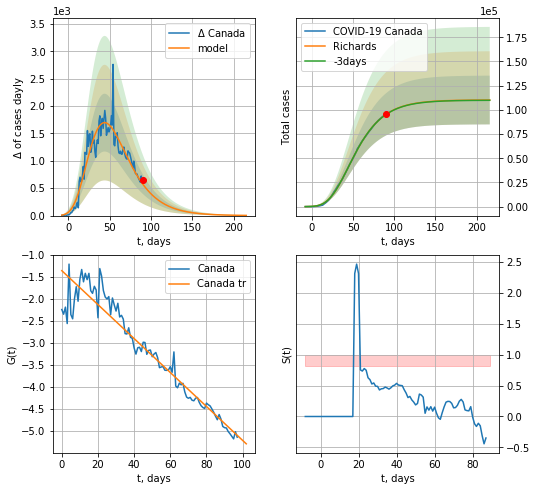

Canada data at: 2020-07-27
+3 day model MAPE: 0.001369
model: Richards
coeffs: [ 1.10207939e+05  3.57046378e+00 -6.12039169e+01  1.17938660e-02]
rational stdev: 0.228612
forecast at the end of period: +126 days
	 deltaDaycases: 3
	 total cases: 110128 ± 25176
	 total death: 8553 ± 5865
trend coefficient of determination: 0.921084
 intercept: -1.352092
 slope: -0.038614


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


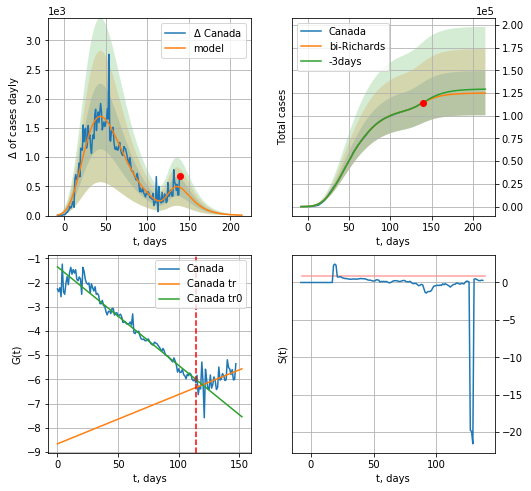

Canada data at: 2020-07-27
+3 day model MAPE: 0.002966
model: bi-Richards
coeffs: [1.48096362e+04 3.70812505e+00 8.65317646e+01 2.03761463e-02]
rational stdev: 0.194609
forecast at the end of period: +75 days
	 deltaDaycases: 7
	 total cases: 124890 ± 24304
	 total death: 9700 ± 5663
bi-Richards approximation splitting point: 114
trend coefficient of determination: 0.951520
 intercept: -1.350145
 slope: -0.040757
trend coefficient of determination: 0.200227
 intercept: -8.662255
 slope: 0.020393


In [1667]:
iL = 15
vL = 114 + iL
x = forecastRR('Canada',dfCA[iL:vL-iL],d1,18*7,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Canada',dfCA[iL:],d1,28*7-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#x = forecastQR('Canada',dfCA[28:],d1,16*7,1.)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


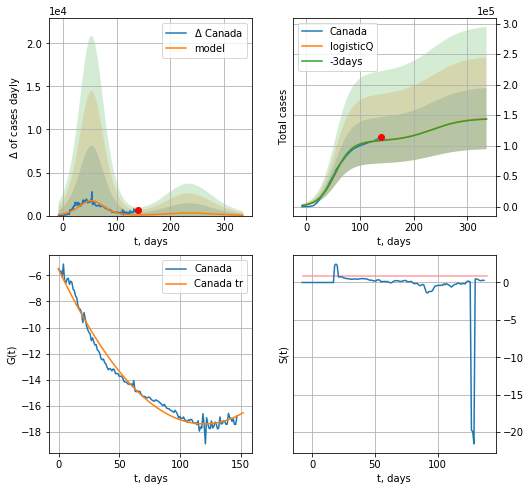

Canada data at: 2020-07-27
+3 day model MAPE: 0.006256
model: logisticQ
coeffs: [ 1.07483880e+05  1.83707014e-07  5.37776049e+01 -3.51410480e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.347521
forecast at the end of period: +196 days
	 deltaDaycases: 43
	 total cases: 144197 ± 50111
	 total death: 11200 ± 11676
trend coefficient of determination: 0.983574
 intercept_: -5.525482927650355
 coeffs_: [ 0.         -0.19779416  0.00082492]


In [1668]:
x = forecastRRR('Canada',dfCA[15:],d1,7*28,1.,addpred=True,xcoef=koreaCoeffs)

PT
           date  cases  active   death
143 2020-07-23  49379   13305  1705.0
144 2020-07-24  49692   13293  1712.0
145 2020-07-25  49955   13229  1716.0
146 2020-07-26  50164   13230  1717.0
147 2020-07-27  50299   13205  1719.0


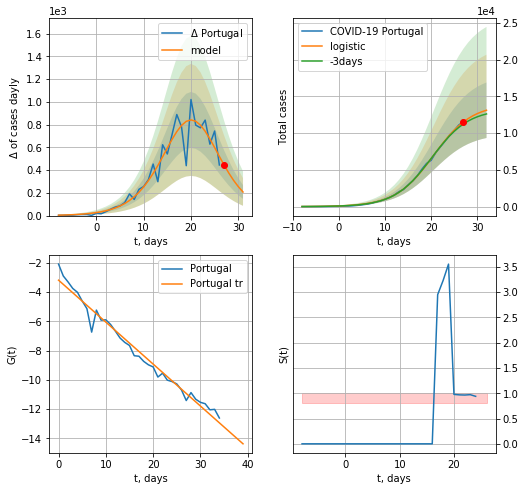

Portugal data at: 2020-07-27
+3 day model MAPE: 0.02876881186141646
model: logistic
coeffs:  [1.39435560e+04 2.41732854e-01 2.05234131e+01]
rational stdev:  0.28806592053196767
forecast at the end of period: +5 days
	 deltaDaycases:  207
	 total cases:  13124 ± 3780
	 total death:  448 ± 387
trend coefficient of determination: 0.976552
 intercept: -3.178197
 slope: -0.287215


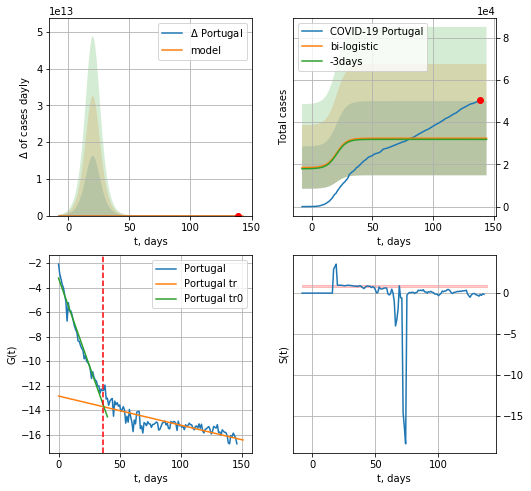

Portugal data at: 2020-07-27
+3 day model MAPE: 0.017375554225591925
model: bi-logistic
coeffs:  [ 1.47839454e+04 -5.72156321e+00  1.48678925e+02] [1.39435560e+04 2.41732854e-01 2.05234131e+01]
scenario coeffs:  [0.25, 1.0, 1.2]
rational stdev:  0.5420814001502278
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  32423 ± 17576
	 total death:  1108 ± 1801
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975262
 intercept: -3.226992
 slope: -0.282910
trend coefficient of determination: 0.681847
 intercept: -12.851142
 slope: -0.023772


In [1669]:
vL = 36
dfPT = read_df(pd.DataFrame(),"PT")
x = forecast('Portugal',dfPT[:vL],d1,18*7-dT,1.)
xx=forecast2('Portugal',dfPT[:],d1,18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.2],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


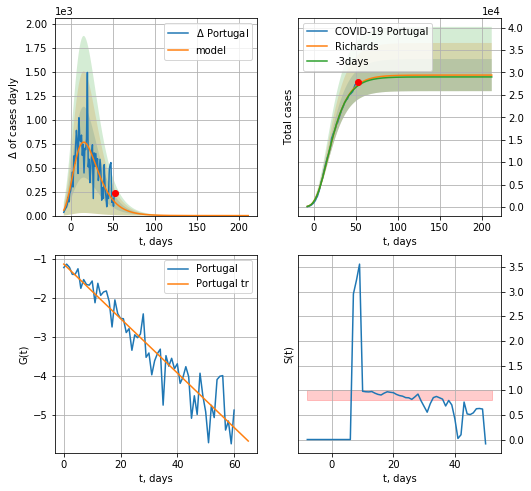

Portugal data at: 2020-07-27
+3 day model MAPE: 0.008857
model: Richards
coeffs: [ 2.94208673e+04  7.56194935e+00 -4.94130809e+01  9.41350515e-03]
rational stdev: 0.121788
forecast at the end of period: +159 days
	 deltaDaycases: 0
	 total cases: 29420 ± 3583
	 total death: 1005 ± 367
trend coefficient of determination: 0.903152
 intercept: -1.140009
 slope: -0.069674


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


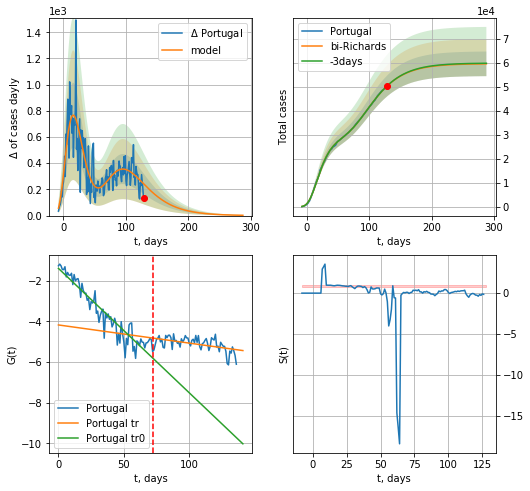

Portugal data at: 2020-07-27
+3 day model MAPE: 0.001036
model: bi-Richards
coeffs: [ 3.03057232e+04  1.82608073e+00 -3.17879313e+01  1.72585218e-02]
rational stdev: 0.086115
forecast at the end of period: +159 days
	 deltaDaycases: 2
	 total cases: 59652 ± 5137
	 total death: 2038 ± 526
bi-Richards approximation splitting point: 72
trend coefficient of determination: 0.889990
 intercept: -1.390569
 slope: -0.061222
trend coefficient of determination: 0.241430
 intercept: -4.174294
 slope: -0.008938


In [1670]:
iL = 10
vL=72+iL
x = forecastRR('Portugal',dfPT[iL:vL-iL],d1,40*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Portugal',dfPT[iL:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


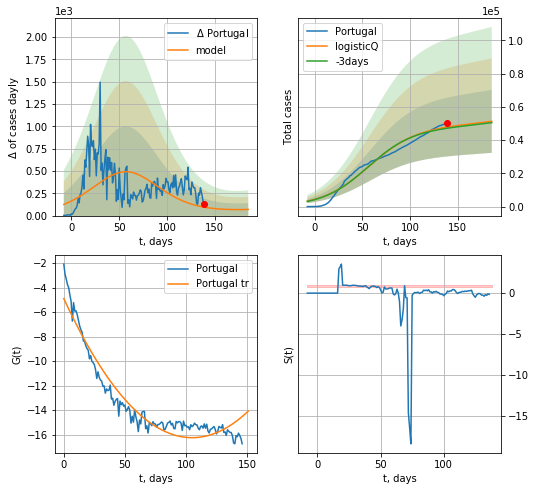

Portugal data at: 2020-07-27
+3 day model MAPE: 0.014769
model: logisticQ
coeffs: [ 4.78232987e+04  7.22945283e-08  5.70382766e+01 -5.61131528e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.369209
forecast at the end of period: +47 days
	 deltaDaycases: 69
	 total cases: 51260 ± 18925
	 total death: 1751 ± 1939
trend coefficient of determination: 0.924130
 intercept_: -4.894074115146903
 coeffs_: [ 0.         -0.21614916  0.00102849]


In [1671]:
x = forecastRRR('Portugal',dfPT[:],d1,24*7-dT,1.,addpred=True,xcoef=koreaCoeffs)

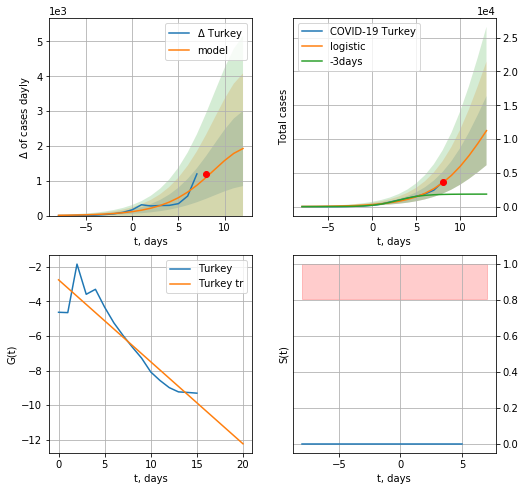

Turkey data at: 2020-07-27
+3 day model MAPE: 1.5246812178063545
model: logistic
coeffs:  [2.42671393e+04 3.25610709e-01 1.34529674e+01]
rational stdev:  0.45520285261707166
forecast at the end of period: +5 days
	 deltaDaycases:  1924
	 total cases:  11240 ± 5116
	 total death:  278 ± 379
trend coefficient of determination: 0.850665
 intercept: -2.746555
 slope: -0.474541


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


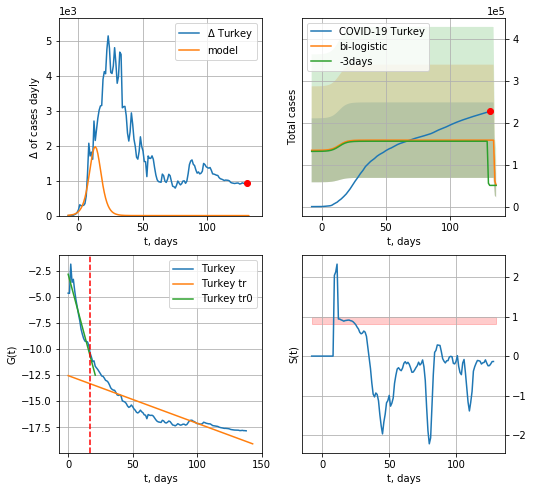

Turkey data at: 2020-07-27
+3 day model MAPE: 2.1329719519687322
model: bi-logistic
coeffs:  [ 1.07426297e+05 -9.37434736e+00  1.34756280e+02] [2.42671393e+04 3.25610709e-01 1.34529674e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.5679713063988179
forecast at the end of period: +5 days
	 deltaDaycases:  -9924
	 total cases:  51124 ± 29037
	 total death:  1267 ± 2158
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.862807
 intercept: -2.813054
 slope: -0.461241
trend coefficient of determination: 0.760480
 intercept: -12.542797
 slope: -0.045786


In [1672]:
vL=17
x = forecast('Turkey',dfTR[:vL],d1,7*18-dT,1.)
xx=forecast2('Turkey',dfTR[:],d1,18*7-dT,x,1.,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


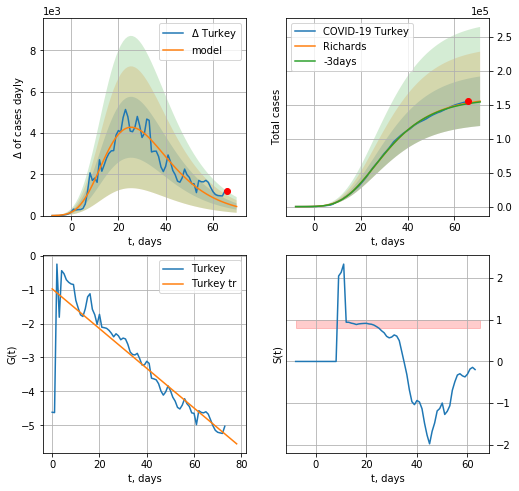

Turkey data at: 2020-07-27
+3 day model MAPE: 0.006544
model: Richards
coeffs: [ 1.61234279e+05  5.77618311e+00 -3.44308441e+01  1.25694326e-02]
rational stdev: 0.235075
forecast at the end of period: +5 days
	 deltaDaycases: 439
	 total cases: 155270 ± 36500
	 total death: 3850 ± 2715
trend coefficient of determination: 0.775259
 intercept: -0.978843
 slope: -0.058549


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


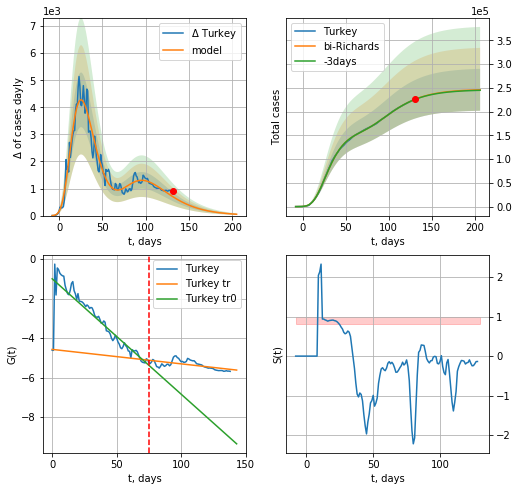

Turkey data at: 2020-07-27
+3 day model MAPE: 0.001285
model: bi-Richards
coeffs: [ 8.60030033e+04  2.73304483e+00 -9.14500832e+00  1.44175007e-02]
rational stdev: 0.179456
forecast at the end of period: +75 days
	 deltaDaycases: 49
	 total cases: 246004 ± 44147
	 total death: 6100 ± 3284
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.782453
 intercept: -0.995360
 slope: -0.058508
trend coefficient of determination: 0.388007
 intercept: -4.574788
 slope: -0.007330


In [1673]:
vL = 75
x = forecastRR('Turkey',dfTR[:vL],d1,18*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Turkey',dfTR[:],d1,28*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [1674]:
#x = forecastQR('Turkey',dfTR[:],d1,16*7,1.,addpred=False,xcoef=[0.35,.5,3,1,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


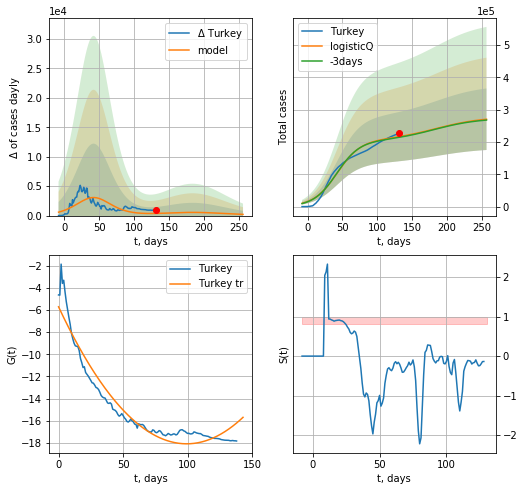

Turkey data at: 2020-07-27
+3 day model MAPE: 0.010578
model: logisticQ
coeffs: [ 2.05467234e+05  8.67365871e-08  4.24145219e+01 -6.81954253e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.352177
forecast at the end of period: +126 days
	 deltaDaycases: 205
	 total cases: 270622 ± 95306
	 total death: 6711 ± 7090
trend coefficient of determination: 0.929141
 intercept_: -5.699270100252514
 coeffs_: [ 0.         -0.24964086  0.00125662]


In [1675]:
x = forecastRRR('Turkey',dfTR[:],d1,18*7,1.,addpred=True,xcoef=koreaCoeffs)

#xx=forecast2R('Turkey',dfTR[:],d1,14*7-dT,x,1.)

In [1676]:
dfTT[dfTT.Country=='%s'%("Latvia")][0].values[0]

0.02540983606557377

In [1677]:
#trend3(dfPL[1:],dfIS[7:],dfSW,'PL','IS','SW',40,40,40)

PL
           date    cases  active   death
141 2020-07-23  41808.0    8388  1651.0
142 2020-07-24  42038.0    8386  1655.0
143 2020-07-25  42622.0    8539  1664.0
144 2020-07-26  43065.0    8641  1671.0
145 2020-07-27  43402.0    8683  1676.0


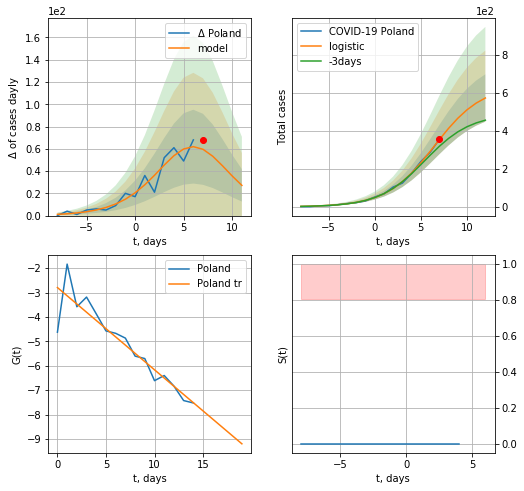

Poland data at: 2020-07-27
+3 day model MAPE: 0.14646235252259687
model: logistic
coeffs:  [6.41107575e+02 3.87606717e-01 6.46563504e+00]
rational stdev:  0.2177068805945458
forecast at the end of period: +5 days
	 deltaDaycases:  27
	 total cases:  573 ± 124
	 total death:  22 ± 14
trend coefficient of determination: 0.843228
 intercept: -2.795749
 slope: -0.337043


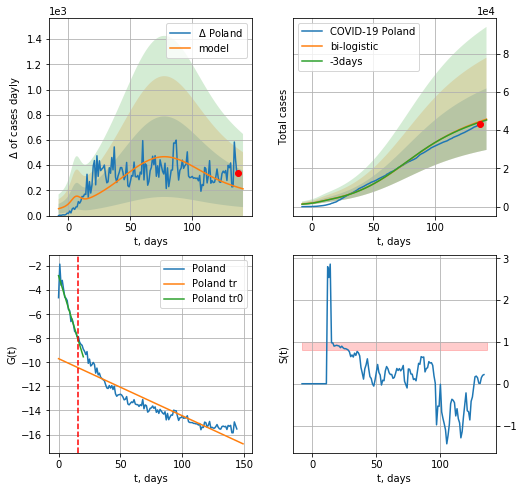

Poland data at: 2020-07-27
+3 day model MAPE: 0.008996563189544813
model: bi-logistic
coeffs:  [4.34051452e+04 4.13825826e-02 7.60481472e+01] [6.41107575e+02 3.87606717e-01 6.46563504e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3516542416037571
forecast at the end of period: +5 days
	 deltaDaycases:  212
	 total cases:  45695 ± 16068
	 total death:  1764 ± 1860
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.867285
 intercept: -2.795308
 slope: -0.337138
trend coefficient of determination: 0.846639
 intercept: -9.693926
 slope: -0.047497


In [1678]:
vL=16
vL1=38
try:
    dfPL = read_df(pd.DataFrame(),"PL")
    x =  forecast('Poland',dfPL[:vL],d1,7*18-dT,1.)
    xx = forecast2('Poland',dfPL[:],d1,18*7-dT,x,1.,vL=vL,addpred=True,xcoef=[0.25,1.,2.])
    #xx = np.concatenate((x, xx), axis=0)
    #xxx = forecast3("Poland",dfPL,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.5,1.,1.3],vL=[vL,vL1])
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


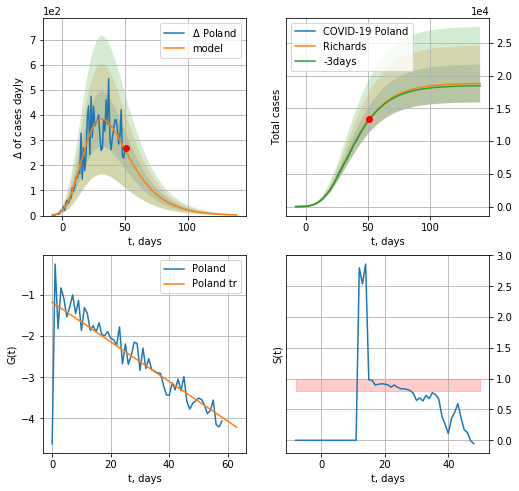

Poland data at: 2020-07-27
+3 day model MAPE: 0.005819
model: Richards
coeffs: [ 1.88418257e+04  3.45615854e+00 -4.15731949e+01  1.61905502e-02]
rational stdev: 0.153199
forecast at the end of period: +89 days
	 deltaDaycases: 2
	 total cases: 18796 ± 2879
	 total death: 725 ± 333
trend coefficient of determination: 0.708779
 intercept: -1.177307
 slope: -0.048172


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


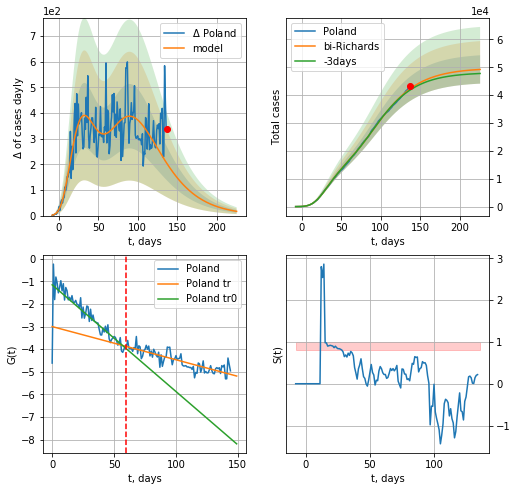

Poland data at: 2020-07-27
+3 day model MAPE: 0.010675
model: bi-Richards
coeffs: [ 3.09145001e+04  3.31036842e+00 -5.32345140e+01  9.44655183e-03]
rational stdev: 0.103382
forecast at the end of period: +89 days
	 deltaDaycases: 16
	 total cases: 49232 ± 5089
	 total death: 1901 ± 589
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.708199
 intercept: -1.156781
 slope: -0.047158
trend coefficient of determination: 0.694889
 intercept: -3.001741
 slope: -0.014666


In [1679]:
vL = 60
x =  forecastRR('Poland',dfPL[:vL],d1,30*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx =  forecast2RR('Poland',dfPL[:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#xx = forecast2R('Poland',dfPL[:],d1,8*7-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


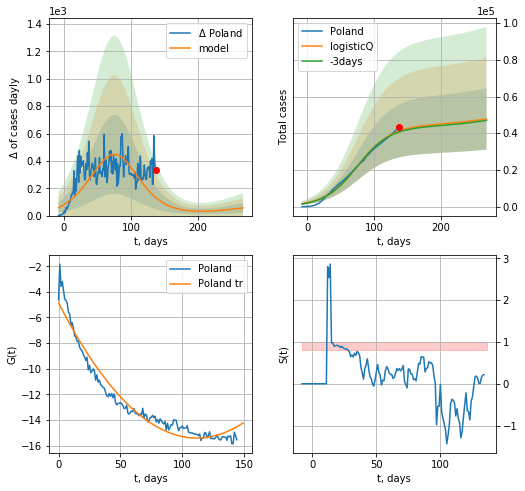

Poland data at: 2020-07-27
+3 day model MAPE: 0.013538
model: logisticQ
coeffs: [ 4.42844842e+04  1.69645684e-07  7.54728595e+01 -2.37377227e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.349645
forecast at the end of period: +131 days
	 deltaDaycases: 55
	 total cases: 47799 ± 16712
	 total death: 1845 ± 1935
trend coefficient of determination: 0.949375
 intercept_: -4.866067266510632
 coeffs_: [ 0.         -0.18859807  0.00084385]


In [1680]:
x =  forecastRRR('Poland',dfPL[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

IS
           date    cases  active  death
152 2020-07-23  57982.0   33496  442.0
153 2020-07-24  59475.0   32230  448.0
154 2020-07-25  60678.0   33304  457.0
155 2020-07-26  61956.0   34461  470.0
156 2020-07-27  64649.0   32052  480.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


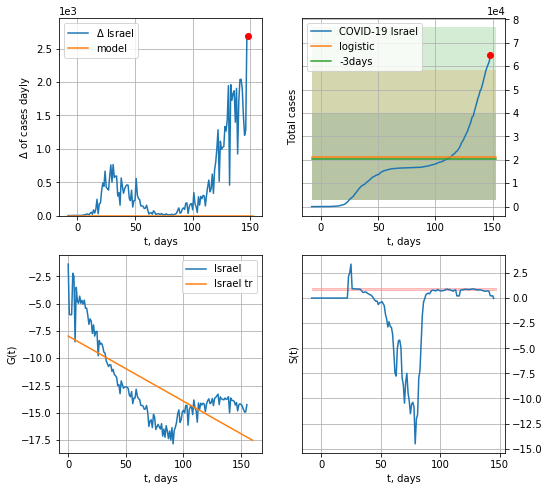

Israel data at: 2020-07-27
+3 day model MAPE: 0.05443034865409326
model: logistic
coeffs:  [ 1.71041342e+04 -7.31936362e+00  1.92953384e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.8631510689064338
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  21380 ± 18454
	 total death:  158 ± 409
trend coefficient of determination: 0.534446
 intercept: -7.971458
 slope: -0.059680


In [1681]:
dfIS = read_df(pd.DataFrame(),"IS")
try:
    x = forecast('Israel',dfIS[:],d1,18*7-dT,addpred=True,xcoef=[0.25,1.,1.8])
except:
    print ("Exception occurs")
#xx = forecast2('Israel',dfIS[:],d1,20-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


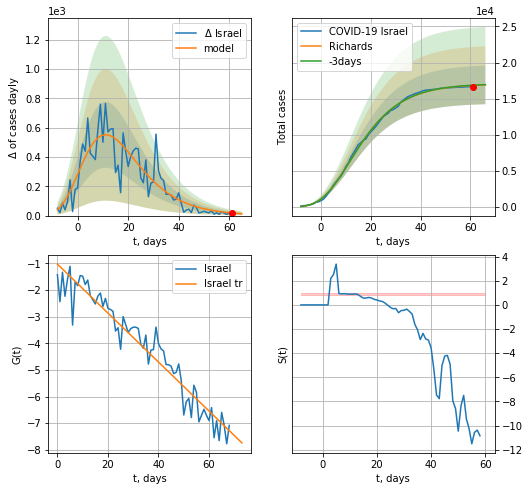

Israel data at: 2020-07-27
+3 day model MAPE: 0.001940
model: Richards
coeffs: [ 1.70515692e+04  6.43104023e+00 -3.67761649e+01  1.37703182e-02]
rational stdev: 0.158197
forecast at the end of period: +5 days
	 deltaDaycases: 12
	 total cases: 16914 ± 2675
	 total death: 125 ± 59
trend coefficient of determination: 0.925544
 intercept: -1.027515
 slope: -0.091953


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


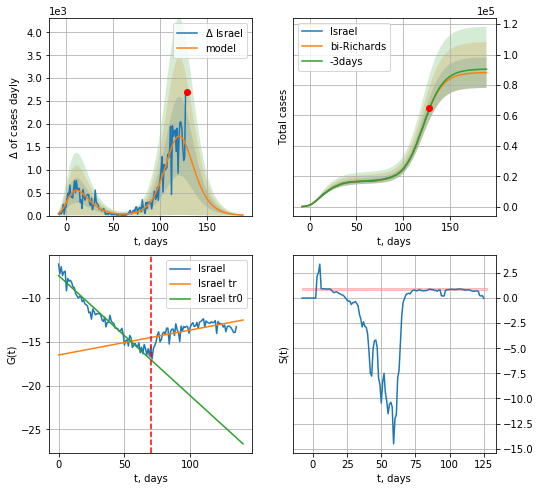

Israel data at: 2020-07-27
+3 day model MAPE: 0.004729
model: bi-Richards
coeffs: [7.11632560e+04 1.04160922e-01 1.19735118e+02 9.10288385e-01]
rational stdev: 0.113681
forecast at the end of period: +61 days
	 deltaDaycases: 10
	 total cases: 88105 ± 10015
	 total death: 654 ± 223
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.956895
 intercept: -7.443679
 slope: -0.137120
trend coefficient of determination: 0.378489
 intercept: -16.509557
 slope: 0.028484


In [1682]:
x = forecastRR('Israel',dfIS[20:90],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Israel',dfIS[20:],d1,26*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=90-20)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


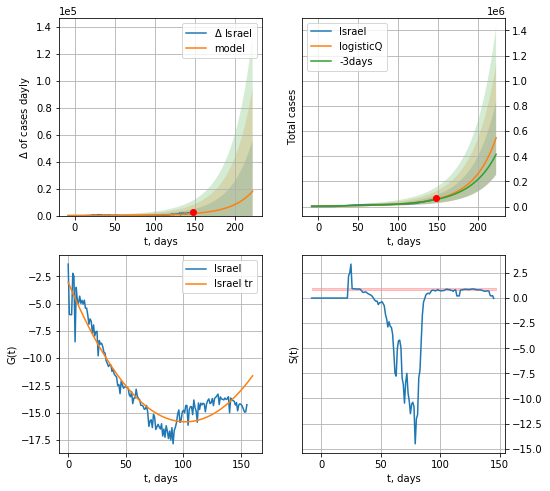

Israel data at: 2020-07-27
+3 day model MAPE: 0.051767
model: logisticQ
coeffs: [ 1.32678379e+08  5.47311438e-05  3.56410865e+02 -5.28454292e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.536424
forecast at the end of period: +75 days
	 deltaDaycases: 18095
	 total cases: 547102 ± 293478
	 total death: 4062 ± 6536
trend coefficient of determination: 0.907230
 intercept_: -3.048467554142311
 coeffs_: [ 0.         -0.25148618  0.00123747]


In [1683]:
x = forecastRRR('Israel',dfIS[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


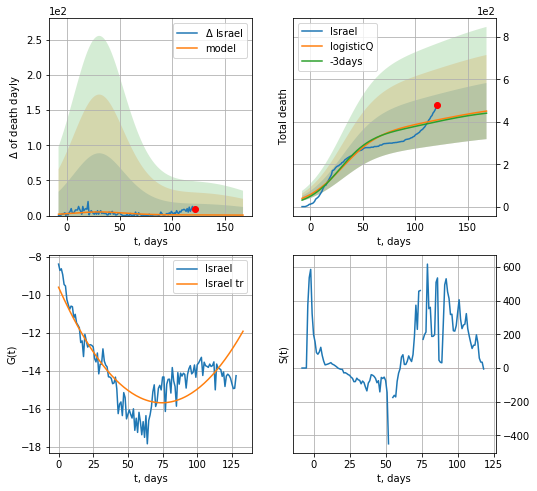

Israel data at: 2020-07-27
+3 day model MAPE: 0.019830
model: logisticQ
coeffs: [ 3.58608899e+02  5.88990662e-08  3.04508257e+01 -9.48326055e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.293029
forecast at the end of period: +47 days
	 total death: 451 ± 132
trend coefficient of determination: 0.723079
 intercept_: -9.602177127460543
 coeffs_: [ 0.         -0.16331022  0.00109708]


In [1684]:
x = forecastRRR('Israel',dfIS[27:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


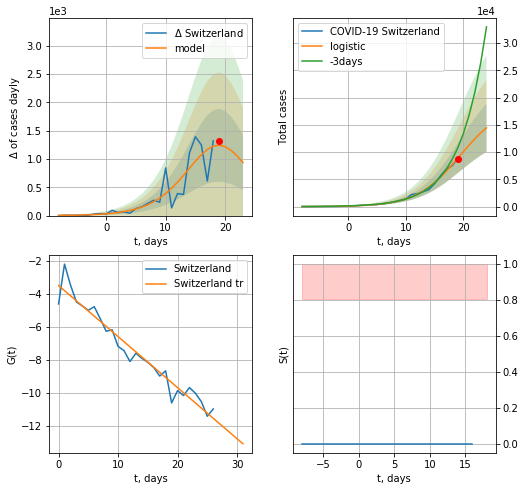

Switzerland data at: 2020-07-27
+3 day model MAPE: 0.24949882905970236
model: logistic
coeffs:  [1.87061213e+04 2.66466230e-01 1.93986309e+01]
rational stdev:  0.3060478989718857
forecast at the end of period: +5 days
	 deltaDaycases:  936
	 total cases:  14462 ± 4426
	 total death:  829 ± 761
trend coefficient of determination: 0.944448
 intercept: -3.508672
 slope: -0.309041


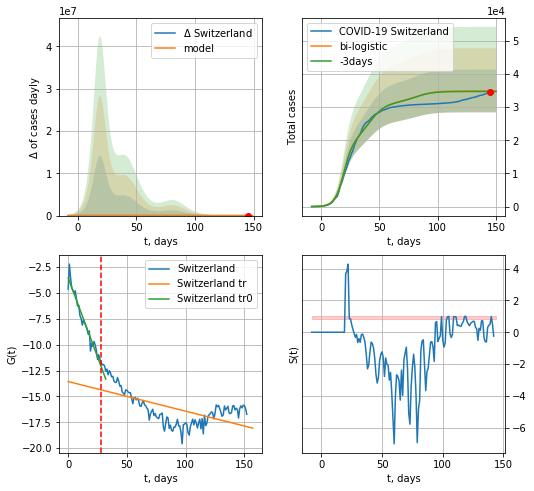

Switzerland data at: 2020-07-27
+3 day model MAPE: 0.004464168203456752
model: bi-logistic
coeffs:  [1.29353017e+04 1.33506166e-01 4.09296394e+01] [1.87061213e+04 2.66466230e-01 1.93986309e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.18459533631882225
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  34874 ± 6437
	 total death:  2000 ± 1107
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.947988
 intercept: -3.537068
 slope: -0.305765
trend coefficient of determination: 0.377232
 intercept: -13.560684
 slope: -0.028640


In [1685]:
vL= 28
x = forecast('Switzerland',dfSZ[:vL],d1,7*18-dT)
xx = forecast2('Switzerland',dfSZ[:],d1,7*18-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,2.])#,addpred=False,xcoef=[0.25,1.,2.5]

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


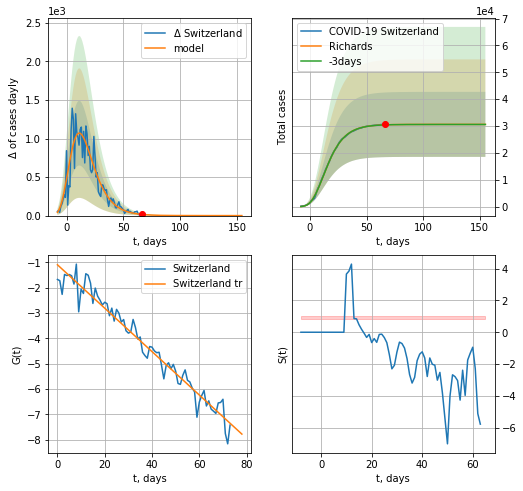

Switzerland data at: 2020-07-27
+3 day model MAPE: 0.000864
model: Richards
coeffs: [ 3.06308865e+04  7.16537801e+00 -3.34375097e+01  1.33541414e-02]
rational stdev: 0.394656
forecast at the end of period: +89 days
	 deltaDaycases: 0
	 total cases: 30630 ± 12088
	 total death: 1757 ± 2080
trend coefficient of determination: 0.958074
 intercept: -1.096880
 slope: -0.085687


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


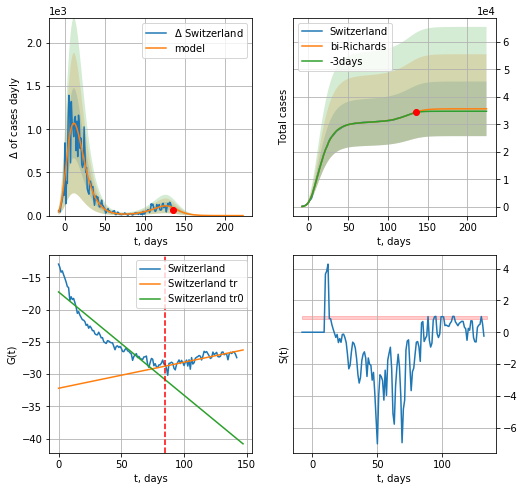

Switzerland data at: 2020-07-27
+3 day model MAPE: 0.005717
model: bi-Richards
coeffs: [5.03427021e+03 5.78223847e-02 1.32512122e+02 2.02590640e+00]
rational stdev: 0.278905
forecast at the end of period: +89 days
	 deltaDaycases: 0
	 total cases: 35665 ± 9947
	 total death: 2046 ± 1711
bi-Richards approximation splitting point: 85
trend coefficient of determination: 0.866168
 intercept: -17.243113
 slope: -0.160336
trend coefficient of determination: 0.631394
 intercept: -32.190402
 slope: 0.040400


In [1686]:
iL = 10
vL = 85 + iL
x = forecastRR('Switzerland',dfSZ[iL:vL-iL],d1,7*30-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Switzerland',dfSZ[iL:],d1,7*30-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#xx = forecastR('Switzerland',dfSZ[:],d1,7*5-dT,x,vL=15)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


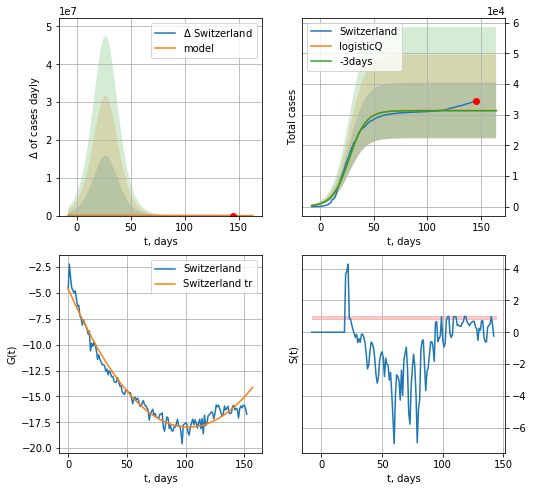

Switzerland data at: 2020-07-27
+3 day model MAPE: 0.003452
model: logisticQ
coeffs: [ 3.14011055e+04  3.93165439e-07  2.70580177e+01 -3.25806892e+05]
rational stdev: 0.289381
forecast at the end of period: +19 days
	 deltaDaycases: 0
	 total cases: 31401 ± 9086
	 total death: 1801 ± 1563
trend coefficient of determination: 0.970090
 intercept_: -4.580815238791022
 coeffs_: [ 0.         -0.26193992  0.00128136]


In [1687]:
x = forecastRRR('Switzerland',dfSZ[:],d1,7*20-dT,addpred=False,xcoef=koreaCoeffs)

In [1688]:
#trend3(dfUR[5:],dfIN[7:],dfRS[5:],'UR','IN','RS',40,40,40)

Ukr
           date    cases  active   death
135 2020-07-23  62823.0   26366  1571.0
136 2020-07-24  63929.0   26842  1590.0
137 2020-07-25  64849.0   27437  1605.0
138 2020-07-26  65656.0   27928  1616.0
139 2020-07-27  66575.0   28202  1629.0


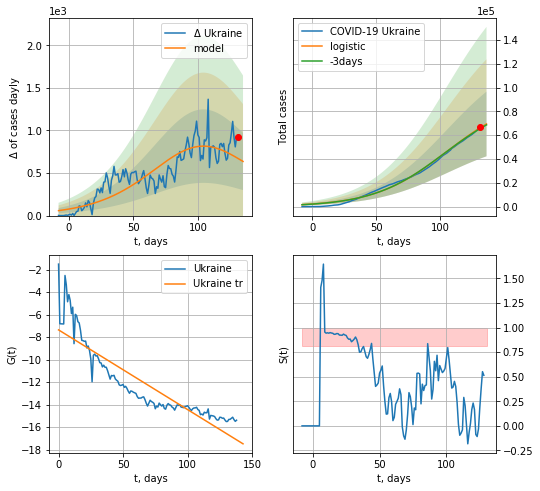

Ukraine data at: 2020-07-27
+3 day model MAPE: 0.010068555575222356
model: logistic
coeffs:  [8.90047899e+04 3.57984456e-02 1.03449777e+02]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.39128172325603494
forecast at the end of period: +5 days
	 deltaDaycases:  636
	 total cases:  69476 ± 27184
	 total death:  1699 ± 1994
trend coefficient of determination: 0.795549
 intercept: -7.354614
 slope: -0.070868


In [1689]:
dfUR = read_df(pd.DataFrame(),"Ukr")
try:
    x=forecast('Ukraine',dfUR[:],d1,18*7-dT,addpred=True,xcoef=[0.25,1.,2.])
except:
      print("Exaption occurs") 

#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


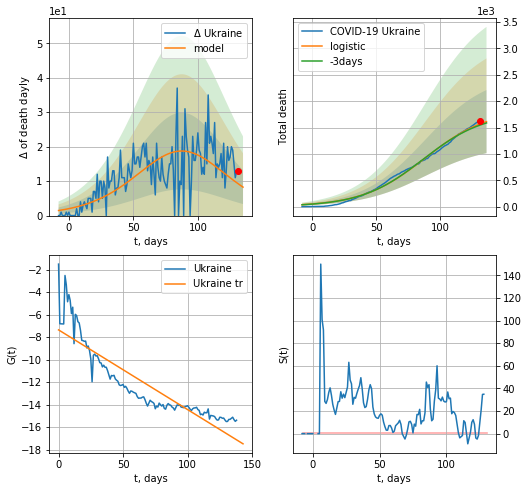

Ukraine data at: 2020-07-27
+3 day model MAPE: 0.014201779061443945
model: logistic
coeffs:  [1.83988452e+03 4.07384094e-02 8.79717285e+01]
rational stdev:  0.37146823344160856
forecast at the end of period: +5 days
	 total death:  1612 ± 598
trend coefficient of determination: 0.795549
 intercept: -7.354614
 slope: -0.070868


In [1690]:
x=forecast('Ukraine',dfUR[:],d1,18*7-dT,addpred=False,xcoef=[0.25,1.,2.],cases='death')
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


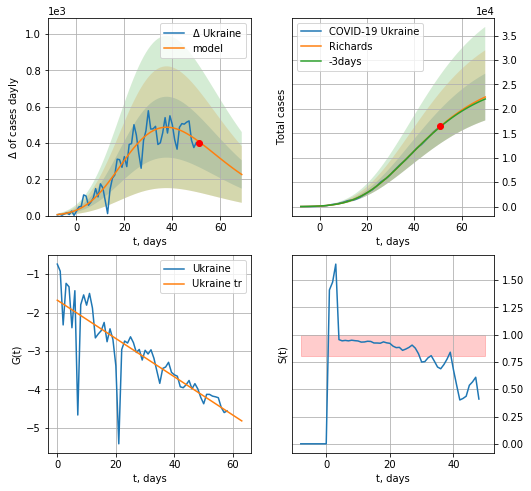

Ukraine data at: 2020-07-27
+3 day model MAPE: 0.005756
model: Richards
coeffs: [ 2.73152267e+04  5.78390591e-01 -1.00505553e+01  8.74755349e-02]
rational stdev: 0.213278
forecast at the end of period: +19 days
	 deltaDaycases: 226
	 total cases: 22421 ± 4782
	 total death: 548 ± 350
trend coefficient of determination: 0.678475
 intercept: -1.678868
 slope: -0.049847


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


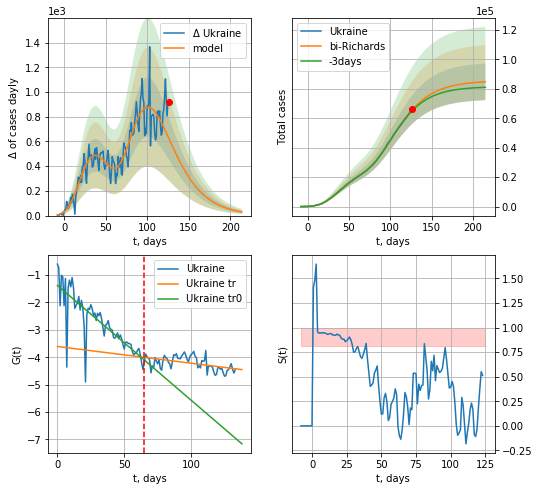

Ukraine data at: 2020-07-27
+3 day model MAPE: 0.011184
model: bi-Richards
coeffs: [ 5.82460178e+04  2.40401071e+00 -2.52112322e+00  1.61966294e-02]
rational stdev: 0.146778
forecast at the end of period: +89 days
	 deltaDaycases: 29
	 total cases: 84808 ± 12448
	 total death: 2075 ± 913
bi-Richards approximation splitting point: 65
trend coefficient of determination: 0.667247
 intercept: -1.378373
 slope: -0.041898
trend coefficient of determination: 0.239659
 intercept: -3.607830
 slope: -0.006108


In [1691]:
vL = 65+5
x=forecastRR('Ukraine',dfUR[5:vL-5],d1,7*20-dT,addpred=False,xcoef=RkoreaCoeffs)
xx=forecast2RR('Ukraine',dfUR[5:],d1,7*30-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


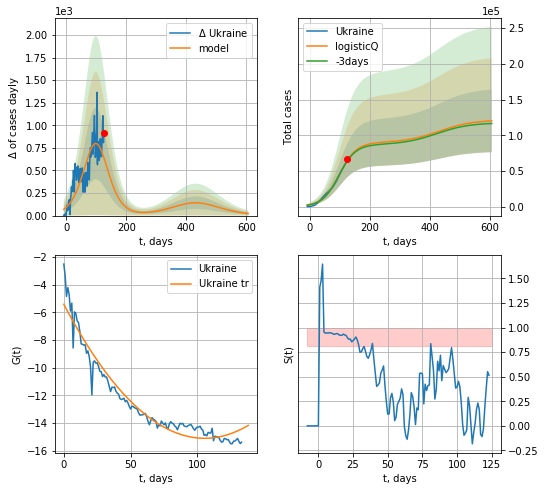

Ukraine data at: 2020-07-27
+3 day model MAPE: 0.011043
model: logisticQ
coeffs: [ 8.96724422e+04  2.89498320e-07  9.89193219e+01 -1.22686422e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.365296
forecast at the end of period: +481 days
	 deltaDaycases: 22
	 total cases: 120118 ± 43878
	 total death: 2939 ± 3220
trend coefficient of determination: 0.942898
 intercept_: -5.42150583327811
 coeffs_: [ 0.         -0.18399783  0.00087366]


In [1692]:
x=forecastRRR('Ukraine',dfUR[5:],d1,7*86-dT,addpred=True,xcoef=koreaCoeffs)

In [1693]:
#np.log(np.diff(dfIS["cases"].values)[:]/dfIS["cases"].values[1:]**2)

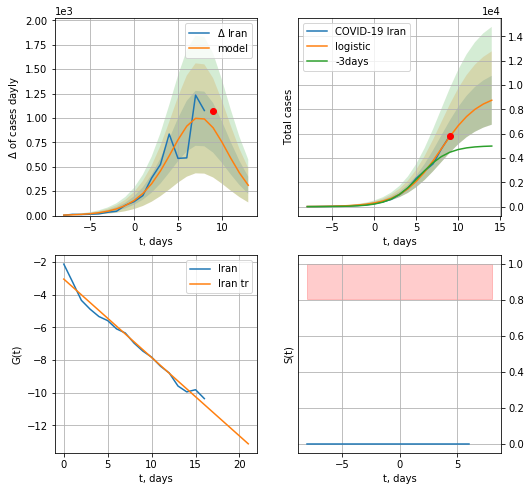

Iran data at: 2020-07-27
+3 day model MAPE: 0.4176898990261385
model: logistic
coeffs:  [9.38566043e+03 4.29600562e-01 7.92981700e+00]
rational stdev:  0.2297342183396625
forecast at the end of period: +5 days
	 deltaDaycases:  310
	 total cases:  8741 ± 2008
	 total death:  473 ± 325
trend coefficient of determination: 0.980602
 intercept: -3.037586
 slope: -0.480406


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


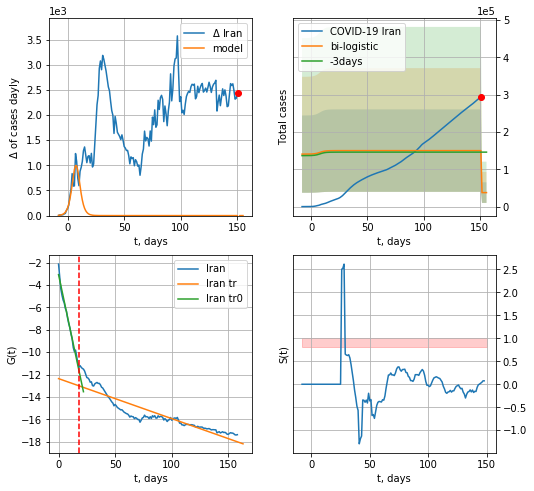

Iran data at: 2020-07-27
+3 day model MAPE: 0.7429912907207988
model: bi-logistic
coeffs:  [ 1.12448661e+05 -6.86530024e+01  1.51621230e+02] [9.38566043e+03 4.29600562e-01 7.92981700e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.7366859253007094
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  37497 ± 27624
	 total death:  2032 ± 4490
bi-logistic approximation splitting point: 18
trend0 coefficient of determination: 0.982944
 intercept: -3.059655
 slope: -0.476268
trend coefficient of determination: 0.826933
 intercept: -12.364494
 slope: -0.035796


In [1694]:
x = forecast('Iran',dfIN[:18],d1,7*18-dT)
xx = forecast2('Iran',dfIN[:],d1,18*7-dT,x,vL=18,addpred=True,xcoef=[0.25,1.,2.0])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


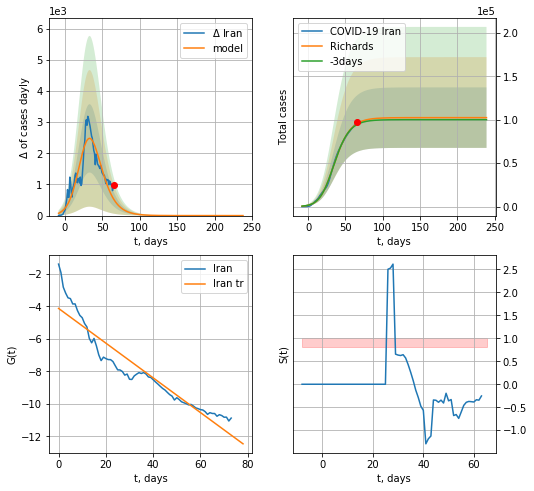

Iran data at: 2020-07-27
+3 day model MAPE: 0.012009
model: Richards
coeffs: [1.02478152e+05 1.52216307e-01 2.65523943e+01 5.45962781e-01]
rational stdev: 0.339941
forecast at the end of period: +173 days
	 deltaDaycases: 0
	 total cases: 102478 ± 34836
	 total death: 5553 ± 5663
trend coefficient of determination: 0.893485
 intercept: -4.118018
 slope: -0.106957


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


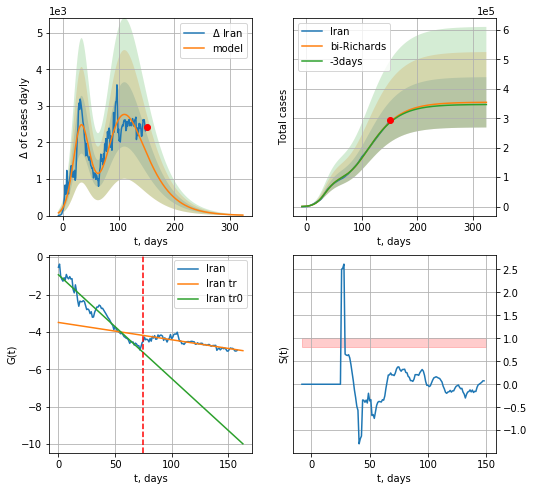

Iran data at: 2020-07-27
+3 day model MAPE: 0.006915
model: bi-Richards
coeffs: [ 2.52392495e+05  1.89523535e+00 -2.74951980e+01  1.57689938e-02]
rational stdev: 0.241085
forecast at the end of period: +173 days
	 deltaDaycases: 13
	 total cases: 354432 ± 85448
	 total death: 19208 ± 13892
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.949238
 intercept: -0.940844
 slope: -0.055545
trend coefficient of determination: 0.742578
 intercept: -3.495400
 slope: -0.009266


In [1695]:
vL = 75
x = forecastRR('Iran',dfIN[:vL],d1,42*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Iran',dfIN[:],d1,42*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


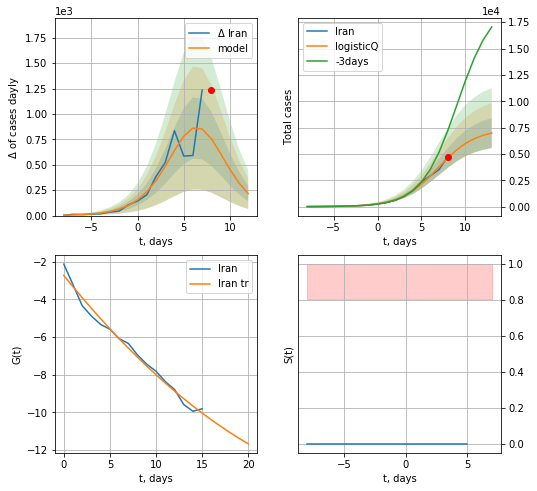

Iran data at: 2020-07-27
+3 day model MAPE: 0.437962
model: logisticQ
coeffs: [ 7.36885077e+03  7.42724103e-05 -6.37161781e+03  6.90116795e+00]
rational stdev: 0.203007
forecast at the end of period: +5 days
	 deltaDaycases: 215
	 total cases: 6981 ± 1417
	 total death: 378 ± 230
trend coefficient of determination: 0.985826
 intercept_: -2.7244557798652984
 coeffs_: [ 0.         -0.60810956  0.00802289]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


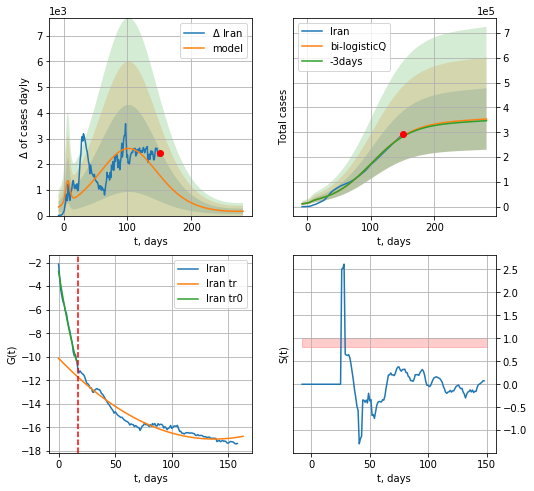

Iran data at: 2020-07-27
+3 day model MAPE: 0.009223
model: bi-logisticQ
coeffs: [ 3.38323535e+05  1.65011649e-07  1.02117124e+02 -1.86499502e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.350592
forecast at the end of period: +131 days
	 deltaDaycases: 167
	 total cases: 353253 ± 123847
	 total death: 19144 ± 20135
bi-logisticQ approximation splitting point: 17
trend coefficient of determination: 0.987745
 intercept_: -2.720144864989817
 coeffs_: [ 0.         -0.61067547  0.00823538]
trend coefficient of determination: 0.936806
 intercept_: -10.126464421045648
 coeffs_: [ 0.         -0.09999626  0.00036348]


In [1697]:
x = forecastRRR('Iran',dfIN[:17],d1,18*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Iran',dfIN[:],d1,36*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=17)

RS
           date     cases  active    death
145 2020-07-23  795038.0  201816  12892.0
146 2020-07-24  800849.0  196388  13192.0
147 2020-07-25  806720.0  196388  13192.0
148 2020-07-26  812485.0  198966  13269.0
149 2020-07-27  818120.0  197794  13504.0


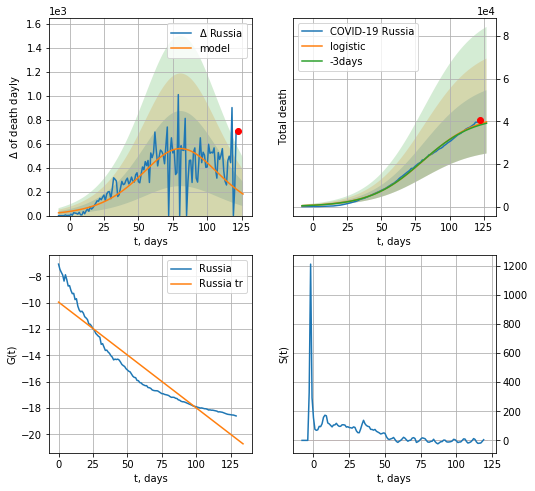

Russia data at: 2020-07-27
+3 day model MAPE: 0.014802030658603653
model: logistic
coeffs:  [4.34948853e+04 5.13535432e-02 8.10673711e+01]
rational stdev:  0.3734685560757387
forecast at the end of period: +5 days
	 total death:  39738 ± 14841
trend coefficient of determination: 0.885819
 intercept: -9.959598
 slope: -0.080203


In [1701]:
try:
    dfRS = read_df(pd.DataFrame(),"RS")
    x = forecast('Russia',dfRS[19:],d1,18*7-dT,shift=3.,cases='death')
    #xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14)#,addpred=True,xcoef=[0.5,1.,3.5]
except:
    print ("Exeption occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


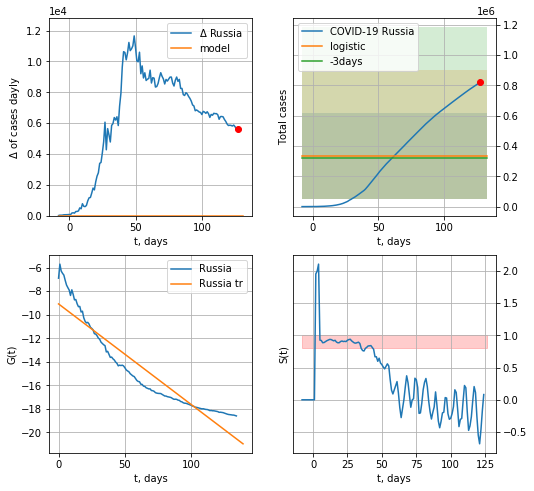

Russia data at: 2020-07-27
+3 day model MAPE: 0.033342300605328626
model: logistic
coeffs:  [ 3.34272132e+05 -9.12025577e+00  2.31960516e+02]
rational stdev:  0.8476539770944814
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  334272 ± 283347
	 total death:  5481 ± 13937
trend coefficient of determination: 0.882214
 intercept: -9.083842
 slope: -0.085456


In [1702]:
x = forecast('Russia',dfRS[14:],d1,18*7-dT,shift=1.)
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14,shift=1.)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


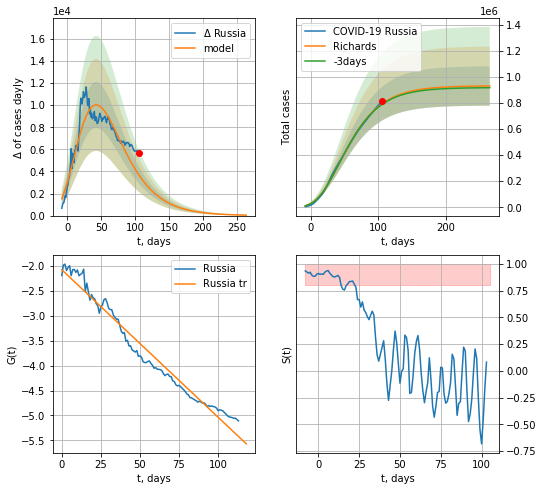

Russia data at: 2020-07-27
+3 day model MAPE: 0.006769
model: Richards
coeffs: [ 9.33174164e+05  3.00755656e+00 -1.14563141e+02  9.75851739e-03]
rational stdev: 0.162380
forecast at the end of period: +159 days
	 deltaDaycases: 41
	 total cases: 931786 ± 151303
	 total death: 15279 ± 7443
trend coefficient of determination: 0.968336
 intercept: -2.072168
 slope: -0.029655


In [1703]:
x = forecastRR('Russia',dfRS[35:],d1,40*7-dT,addpred=False,xcoef=RkoreaCoeffs)#,addpred=True,xcoef=[0.25,1.,1.5,1]
#x = forecastQR('Russia',dfRS[20:],d1,30*7-dT)#,addpred=True,xcoef=[0.25,1.,1.5,1]

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


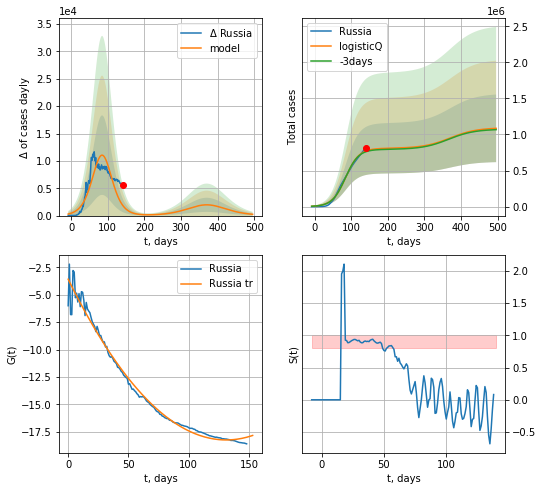

Russia data at: 2020-07-27
+3 day model MAPE: 0.013727
model: logisticQ
coeffs: [ 8.07839627e+05  2.20111722e-07  8.49111379e+01 -2.48423700e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.431911
forecast at the end of period: +355 days
	 deltaDaycases: 234
	 total cases: 1085269 ± 468739
	 total death: 17796 ± 23058
trend coefficient of determination: 0.984719
 intercept_: -3.5844778586598025
 coeffs_: [ 0.         -0.22362246  0.00085302]


In [1704]:
x = forecastRRR('Russia',dfRS[:],d1,68*7-dT,addpred=True,xcoef=koreaCoeffs)

JP
           date    cases  active  death
183 2020-07-23  27029.0    5004  990.0
184 2020-07-24  27956.0    5636  992.0
185 2020-07-25  28786.0    6226  993.0
186 2020-07-26  29382.0    6624  996.0
187 2020-07-27  29989.0    6877  996.0


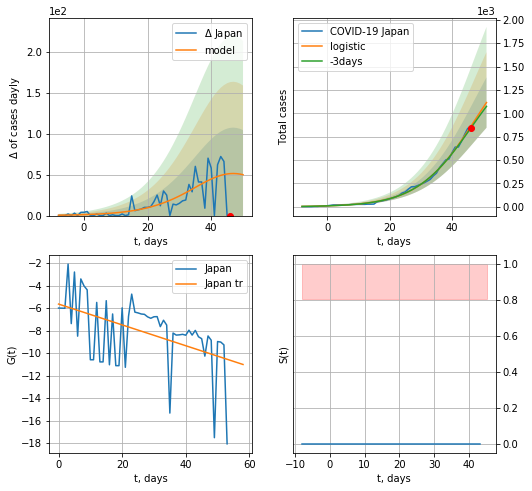

Japan data at: 2020-07-27
+3 day model MAPE: 0.024413899387998084
model: logistic
coeffs:  [1.86668600e+03 1.09971339e-01 4.74124631e+01]
rational stdev:  0.24188431732788906
forecast at the end of period: +5 days
	 deltaDaycases:  49
	 total cases:  1115 ± 269
	 total death:  37 ± 26
trend coefficient of determination: 0.226001
 intercept: -5.646499
 slope: -0.092589


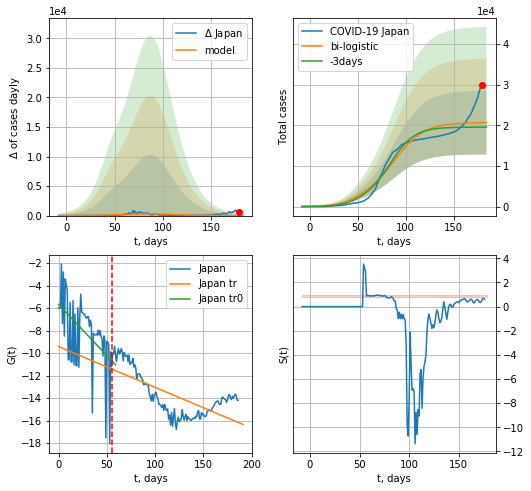

Japan data at: 2020-07-27
+3 day model MAPE: 0.05709295025256381
model: bi-logistic
coeffs:  [1.88638795e+04 6.37331269e-02 8.78007055e+01] [1.86668600e+03 1.09971339e-01 4.74124631e+01]
rational stdev:  0.3793618965659135
forecast at the end of period: +5 days
	 deltaDaycases:  2
	 total cases:  20689 ± 7848
	 total death:  687 ± 781
bi-logistic approximation splitting point: 55
trend0 coefficient of determination: 0.229818
 intercept: -5.672459
 slope: -0.091119
trend coefficient of determination: 0.482871
 intercept: -9.421761
 slope: -0.036271


In [1705]:
dfJP = read_df(pd.DataFrame(),"JP")
try:
    x = forecast('Japan',dfJP[:55],d1,7*18-dT)
    xx = forecast2('Japan',dfJP[:],d1,18*7-dT,x,addpred=False,xcoef=[0.25,1.,1.25],vL=55)
except:
    print ("Exception occurs")

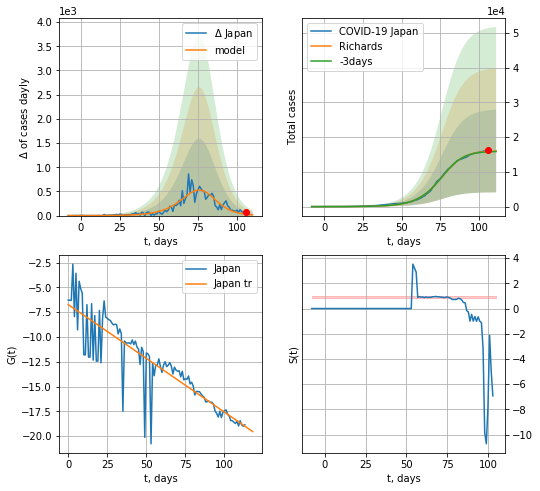

Japan data at: 2020-07-27
+3 day model MAPE: 0.009396
model: Richards
coeffs: [1.61043525e+04 1.05070375e-01 7.85362635e+01 1.40112814e+00]
rational stdev: 0.743333
forecast at the end of period: +5 days
	 deltaDaycases: 15
	 total cases: 16008 ± 11899
	 total death: 531 ± 1184
trend coefficient of determination: 0.778576
 intercept: -6.726919
 slope: -0.108522


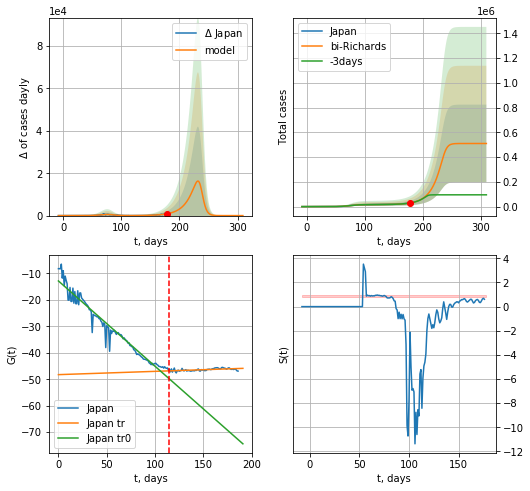

Japan data at: 2020-07-27
+3 day model MAPE: 0.010391
model: bi-Richards
coeffs: [4.93661501e+05 6.07261560e-02 2.37859980e+02 4.17486262e+00]
rational stdev: 0.615763
forecast at the end of period: +131 days
	 deltaDaycases: 0
	 total cases: 509765 ± 313895
	 total death: 16930 ± 31274
bi-Richards approximation splitting point: 115
trend coefficient of determination: 0.951173
 intercept: -12.857001
 slope: -0.322262
trend coefficient of determination: 0.307460
 intercept: -48.267526
 slope: 0.012441


In [1706]:
vL = 115
x = forecastRR('Japan',dfJP[:vL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Japan',dfJP[:],d1,36*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


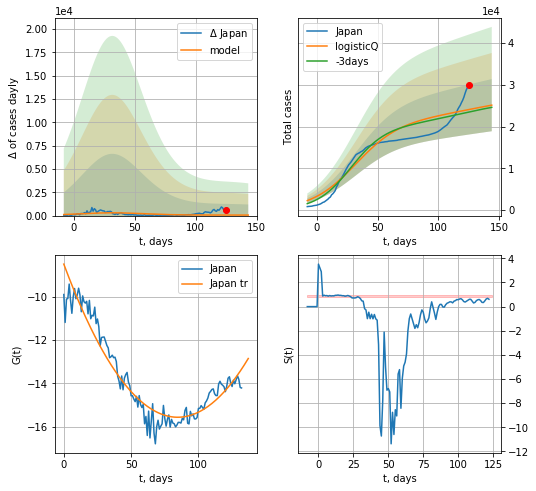

Japan data at: 2020-07-27
+3 day model MAPE: 0.024858
model: logisticQ
coeffs: [ 2.11262404e+04  5.10425181e-08  3.16050423e+01 -1.07661489e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.248532
forecast at the end of period: +19 days
	 deltaDaycases: 53
	 total cases: 25145 ± 6249
	 total death: 835 ± 622
trend coefficient of determination: 0.913784
 intercept_: -8.487565598996754
 coeffs_: [ 0.         -0.16724356  0.00098842]


In [1707]:
x = forecastRRR('Japan',dfJP[54:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

NL
           date    cases  active   death
147 2020-07-23  52404.0       0  6139.0
148 2020-07-24  52595.0       0  6139.0
149 2020-07-25  52732.0       0  6139.0
150 2020-07-26  52946.0       0  6139.0
151 2020-07-27  53151.0       0  6141.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


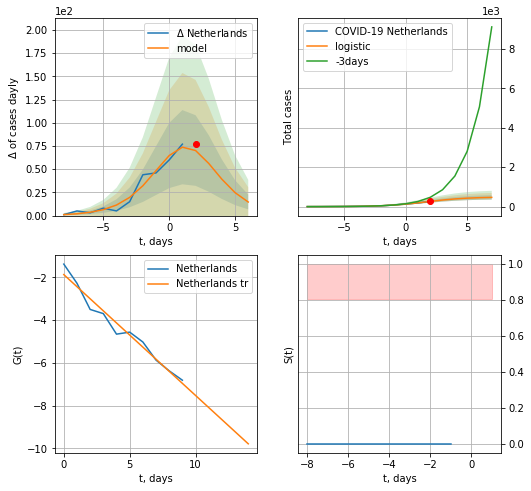

Netherlands data at: 2020-07-27
model: logistic
coeffs:  [487.7470779    0.61204075   1.72557626]
rational stdev:  0.23761281134430468
forecast at the end of period: +5 days
	 deltaDaycases:  14
	 total cases:  469 ± 111
	 total death:  54 ± 38
trend coefficient of determination: 0.966773
 intercept: -1.876651
 slope: -0.565279


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


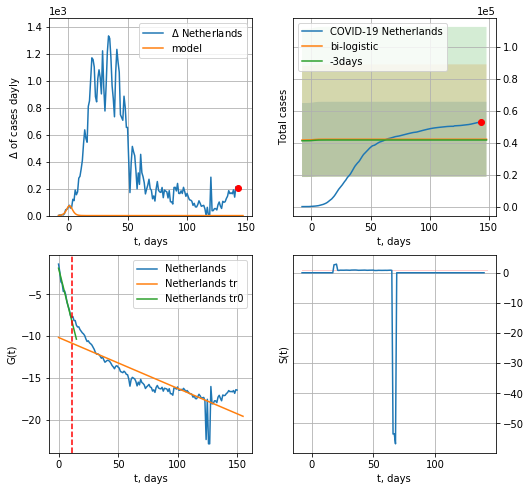

Netherlands data at: 2020-07-27
+3 day model MAPE: 0.011494797747538688
model: bi-logistic
coeffs:  [ 3.33893739e+04 -6.35756145e+00  1.82613340e+02] [487.7470779    0.61204075   1.72557626]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.555812106318567
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  42224 ± 23468
	 total death:  4878 ± 8133
bi-logistic approximation splitting point: 11
trend0 coefficient of determination: 0.974821
 intercept: -1.878275
 slope: -0.564738
trend coefficient of determination: 0.748605
 intercept: -10.152573
 slope: -0.060740


In [1708]:
vL=11
vL1=32
dfNL = read_df(pd.DataFrame(),"NL")
x = forecast('Netherlands',dfNL[:vL],d1,18*7-dT,pMAPE=False)
xx = forecast2('Netherlands',dfNL[:],d1,18*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


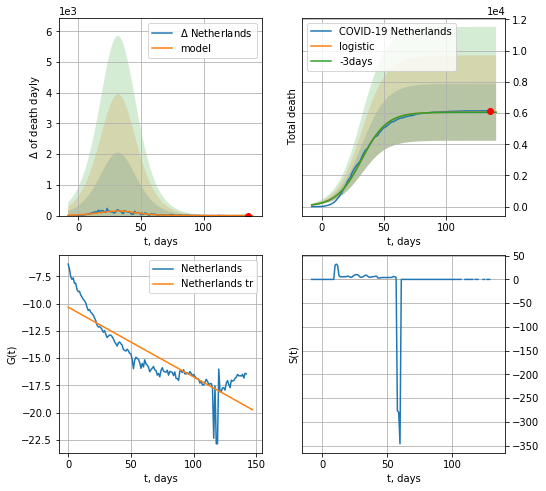

Netherlands data at: 2020-07-27
+3 day model MAPE: 0.0007220984392153157
model: logistic
coeffs:  [6.05056735e+03 9.97041804e-02 3.21715282e+01]
rational stdev:  0.3014407675818943
forecast at the end of period: +5 days
	 total death:  6050 ± 1823
trend coefficient of determination: 0.755296
 intercept: -10.326346
 slope: -0.064015


In [1709]:
x = forecast('Netherlands',dfNL[8:],d1,18*7-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


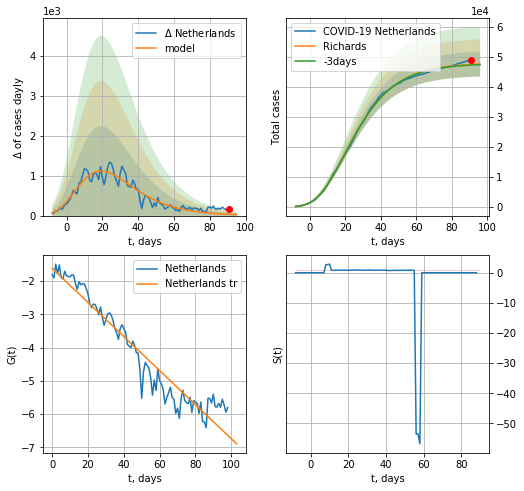

Netherlands data at: 2020-07-27
+3 day model MAPE: 0.004352
model: Richards
coeffs: [ 4.79224214e+04  6.10110637e+00 -5.19495795e+01  1.04218103e-02]
rational stdev: 0.086572
forecast at the end of period: +5 days
	 deltaDaycases: 24
	 total cases: 47546 ± 4116
	 total death: 5493 ± 1426
trend coefficient of determination: 0.925899
 intercept: -1.617272
 slope: -0.051239


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


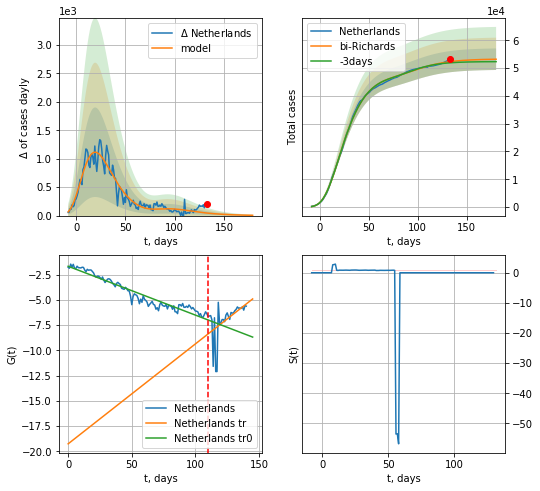

Netherlands data at: 2020-07-27
+3 day model MAPE: 0.008226
model: bi-Richards
coeffs: [ 5.37233262e+03  8.78835909e+00 -4.26138417e+00  5.64823682e-03]
rational stdev: 0.072857
forecast at the end of period: +47 days
	 deltaDaycases: 5
	 total cases: 53192 ± 3875
	 total death: 6145 ± 1343
bi-Richards approximation splitting point: 110
trend coefficient of determination: 0.929784
 intercept: -1.671908
 slope: -0.048336
trend coefficient of determination: 0.260010
 intercept: -19.243285
 slope: 0.098865


In [1710]:
iL = 10
vL = 110+iL
x = forecastRR('Netherlands',dfNL[iL:vL-iL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Netherlands',dfNL[iL:],d1,24*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [1711]:
#x = forecastQR('Netherlands',dfNL[7:],d1,16*7-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


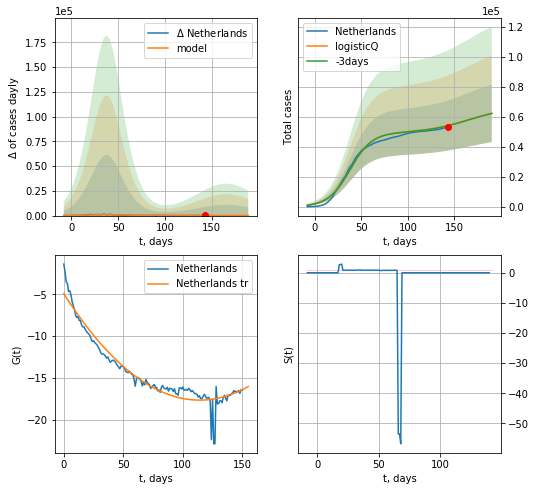

Netherlands data at: 2020-07-27
+3 day model MAPE: 0.002805
model: logisticQ
coeffs: [ 4.92579035e+04  1.65255159e-07  3.80108368e+01 -5.15491983e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.308769
forecast at the end of period: +47 days
	 deltaDaycases: 145
	 total cases: 62156 ± 19191
	 total death: 7181 ± 6651
trend coefficient of determination: 0.926631
 intercept_: -4.929663659174089
 coeffs_: [ 0.         -0.22259153  0.00097477]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


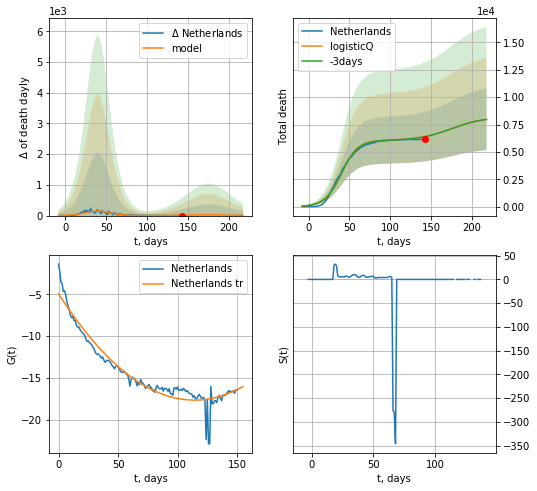

Netherlands data at: 2020-07-27
+3 day model MAPE: 0.000602
model: logisticQ
coeffs: [ 6.04961459e+03  3.44580898e-07  4.01716292e+01 -2.89968816e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.353345
forecast at the end of period: +75 days
	 total death: 7970 ± 2816
trend coefficient of determination: 0.926631
 intercept_: -4.929663659174089
 coeffs_: [ 0.         -0.22259153  0.00097477]


In [1712]:
x = forecastRRR('Netherlands',dfNL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Netherlands',dfNL[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

In [1713]:
#trend3(dfAT[1:],dfSG[:],dfBG[:],'AT','SG','BG',40,35,35)

AT
           date    cases  active  death
148 2020-07-23  20099.0    1445  711.0
149 2020-07-24  20214.0    1461  711.0
150 2020-07-25  20338.0    1502  712.0
151 2020-07-26  20472.0    1551  712.0
152 2020-07-27  20558.0    1599  713.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:86: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


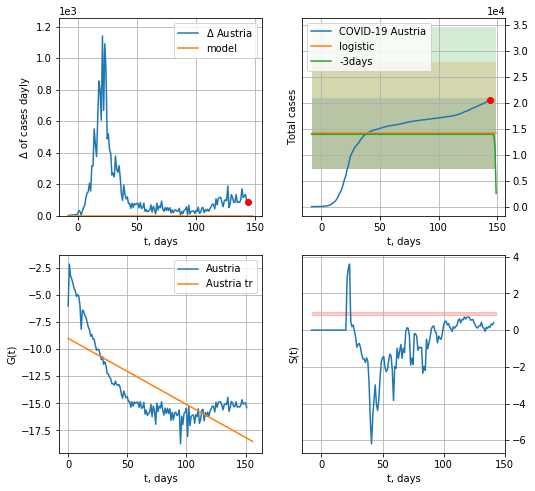

Austria data at: 2020-07-27
+3 day model MAPE: 0.010979830256884699
model: logistic
coeffs:  [ 1.32599608e+04 -3.08953544e+00  1.57213685e+02]
scenario coeffs:  [0.0625, 1.0, 2.0]
rational stdev:  0.4858760140022613
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  14088 ± 6845
	 total death:  488 ± 711
trend coefficient of determination: 0.571364
 intercept: -8.998255
 slope: -0.061132


In [1714]:
dfAT = read_df(pd.DataFrame(),"AT")
try:
    x = forecast('Austria',dfAT[:],d1,7*18-dT,addpred=True,xcoef=[0.25/4,1.,2.0])
except:
    print ("Exception occurs")
#xx = forecast2('Austria',dfAT[:],d1,7*7-dT,x,addpred=True,xcoef=[0.35*2,1.,1.5],vL=36)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


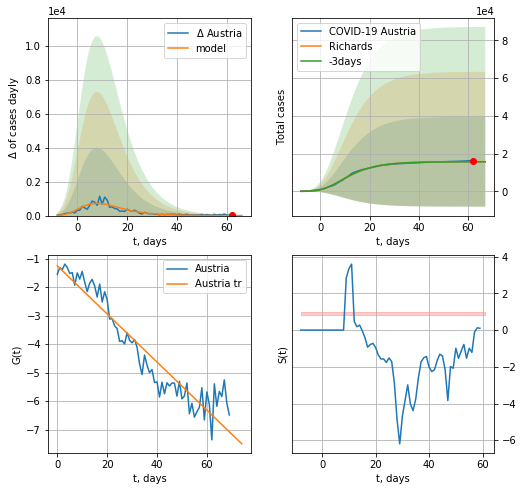

Austria data at: 2020-07-27
+3 day model MAPE: 0.004675
model: Richards
coeffs: [ 1.57373348e+04  1.44322302e+01 -2.95282735e+01  8.67503130e-03]
rational stdev: 1.514093
forecast at the end of period: +5 days
	 deltaDaycases: 1
	 total cases: 15727 ± 23812
	 total death: 545 ± 2475
trend coefficient of determination: 0.902786
 intercept: -1.255535
 slope: -0.084343


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


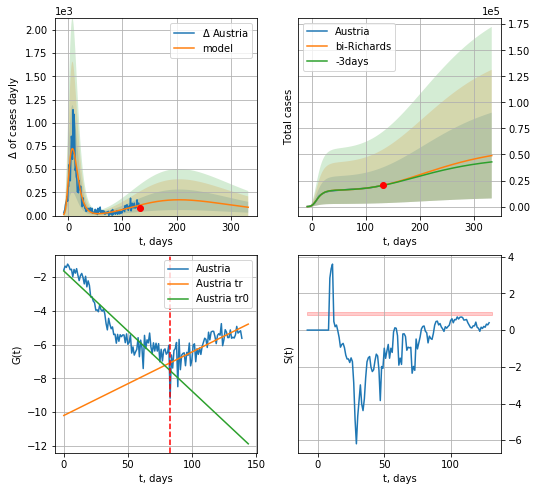

Austria data at: 2020-07-27
+3 day model MAPE: 0.004235
model: bi-Richards
coeffs: [ 4.24924168e+04  7.12730806e-01 -1.74927740e+02  1.54025608e-02]
rational stdev: 0.840009
forecast at the end of period: +201 days
	 deltaDaycases: 89
	 total cases: 48981 ± 41144
	 total death: 1698 ± 4279
bi-Richards approximation splitting point: 83
trend coefficient of determination: 0.867965
 intercept: -1.641233
 slope: -0.071136
trend coefficient of determination: 0.541809
 intercept: -10.204812
 slope: 0.037598


In [1715]:
vL=83+12
x = forecastRR('Austria',dfAT[12:vL-12],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Austria',dfAT[12:],d1,46*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)
#xx = forecast2R('Austria',dfAT[:],d1,8*7-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


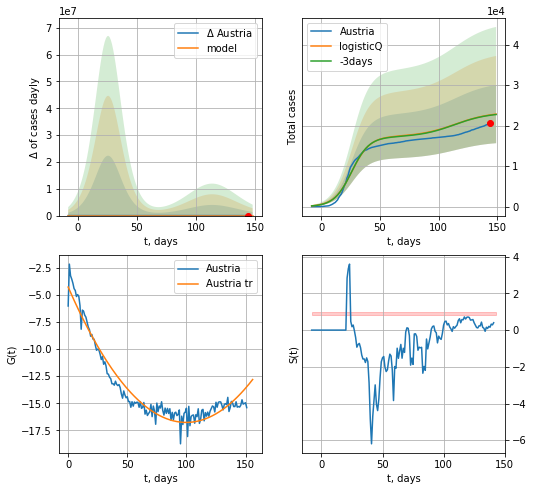

Austria data at: 2020-07-27
+3 day model MAPE: 0.003925
model: logisticQ
coeffs: [ 1.72767130e+04  1.52168411e-07  2.62078684e+01 -8.61739400e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.314255
forecast at the end of period: +5 days
	 deltaDaycases: 34
	 total cases: 22834 ± 7176
	 total death: 791 ± 745
trend coefficient of determination: 0.943879
 intercept_: -4.250300437896234
 coeffs_: [ 0.         -0.25105199  0.00125775]


In [1716]:
vL = 68
x = forecastRRR('Austria',dfAT[:],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
#xx = forecast2RRR('Austria',dfAT[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=vL)

BG
           date    cases  active   death
144 2020-07-23  64847.0   37666  9812.0
145 2020-07-24  65199.0   37988  9817.0
146 2020-07-25  65727.0   38481  9821.0
147 2020-07-26  66026.0   38767  9821.0
148 2020-07-27  66428.0   39154  9822.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


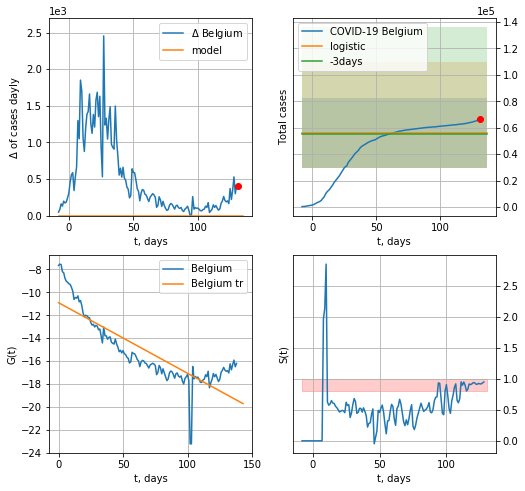

Belgium data at: 2020-07-27
+3 day model MAPE: 0.010451477644900464
model: logistic
coeffs:  [ 4.48673565e+04 -8.90539562e+00  2.80723546e+02]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.4764296785584417
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  56084 ± 26720
	 total death:  8292 ± 11851
trend coefficient of determination: 0.718366
 intercept: -10.904808
 slope: -0.061618


In [1717]:
vL=9
try:
    dfBG = read_df(pd.DataFrame(),"BG")
    x = forecast('Belgium',dfBG[vL:],d1,18*7-dT,addpred=True,xcoef=[0.25,1.,3.])
    #xx = forecast2('Belgium',dfBG[vL:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
except:
    print("Exception occurs")

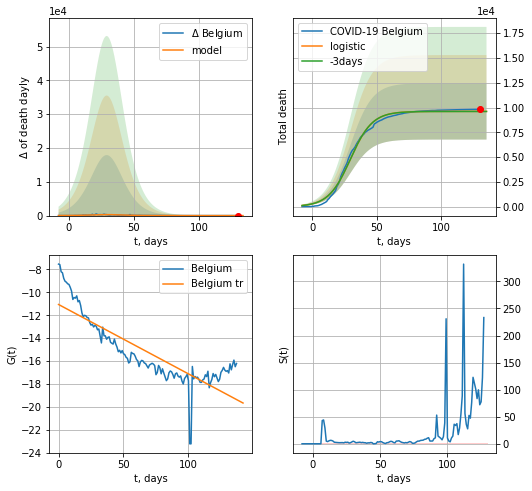

Belgium data at: 2020-07-27
+3 day model MAPE: 0.0010346183536135587
model: logistic
coeffs:  [9.61066196e+03 1.17979456e-01 2.95366336e+01]
rational stdev:  0.29562124553308683
forecast at the end of period: +5 days
	 total death:  9610 ± 2841
trend coefficient of determination: 0.713858
 intercept: -11.060808
 slope: -0.060585


In [1718]:
#dfBG = read_df(pd.DataFrame(),"BG")
x = forecast('Belgium',dfBG[10:],d1,18*7-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


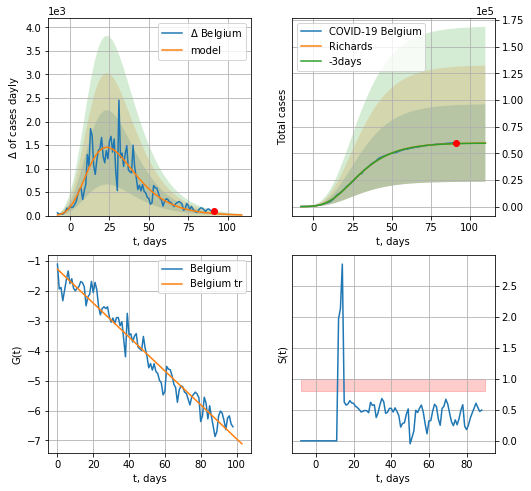

Belgium data at: 2020-07-27
+3 day model MAPE: 0.001911
model: Richards
coeffs: [ 5.97988779e+04  5.30524450e+00 -4.21428396e+01  1.25119808e-02]
rational stdev: 0.608955
forecast at the end of period: +19 days
	 deltaDaycases: 13
	 total cases: 59602 ± 36295
	 total death: 8812 ± 16098
trend coefficient of determination: 0.957612
 intercept: -1.270618
 slope: -0.056728


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


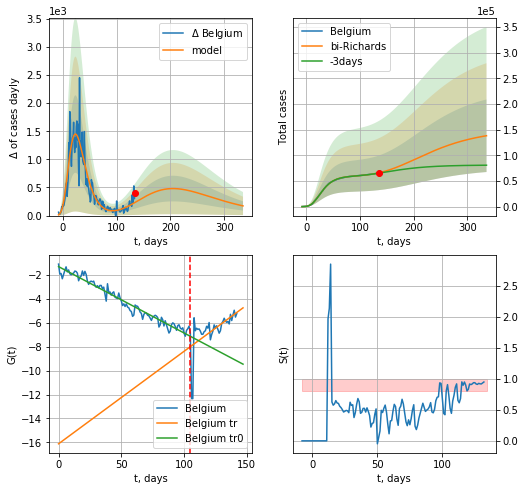

Belgium data at: 2020-07-27
+3 day model MAPE: 0.010763
model: bi-Richards
coeffs: [ 9.12918389e+04  1.26511470e+00 -1.05427520e+02  1.13844825e-02]
rational stdev: 0.511791
forecast at the end of period: +201 days
	 deltaDaycases: 172
	 total cases: 138208 ± 70733
	 total death: 20435 ± 31375
bi-Richards approximation splitting point: 105
trend coefficient of determination: 0.958482
 intercept: -1.302109
 slope: -0.055491
trend coefficient of determination: 0.332598
 intercept: -16.119868
 slope: 0.077333


In [1720]:
iL = 5
vL = 105+ iL
x = forecastRR('Belgium',dfBG[iL:vL-iL],d1,20*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Belgium',dfBG[iL:],d1,46*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


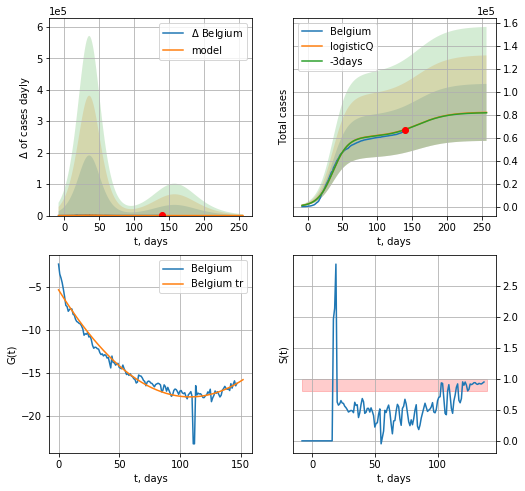

Belgium data at: 2020-07-27
+3 day model MAPE: 0.002894
model: logisticQ
coeffs: [ 6.08611217e+04  2.18373794e-07  3.63352348e+01 -4.16821646e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.302471
forecast at the end of period: +117 days
	 deltaDaycases: 10
	 total cases: 82183 ± 24858
	 total death: 12151 ± 11025
trend coefficient of determination: 0.946174
 intercept_: -5.350435136671855
 coeffs_: [ 0.         -0.22915118  0.00105609]


In [1721]:
x = forecastRRR('Belgium',dfBG[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

In [1722]:
dfBZ.tail()

,date,cases,active,death
149,2020-07-23,2289951.0,635507,84207.0
150,2020-07-24,2348200.0,670534,85385.0
151,2020-07-25,2396434.0,692458,86496.0
152,2020-07-26,2419901.0,698575,87052.0
153,2020-07-27,2446397.0,690993,87737.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


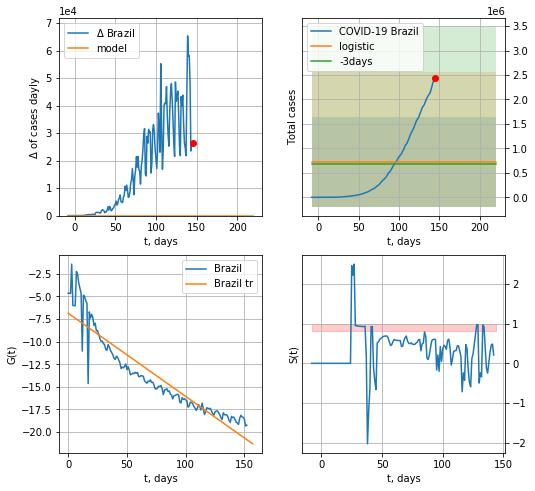

Brazil data at: 2020-07-27
+3 day model MAPE: 0.0668738528475275
model: logistic
coeffs:  [ 5.82650288e+05 -1.10445184e+01  2.72019640e+02]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.2603850088336659
forecast at the end of period: +75 days
	 deltaDaycases:  0
	 total cases:  728312 ± 917954
	 total death:  26120 ± 98763
trend coefficient of determination: 0.865413
 intercept: -6.852906
 slope: -0.092036


In [1723]:
x = forecast('Brazil',dfBZ[:],d1,28*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx = forecast2('Brazil',dfBZ[:],d1,4*7-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


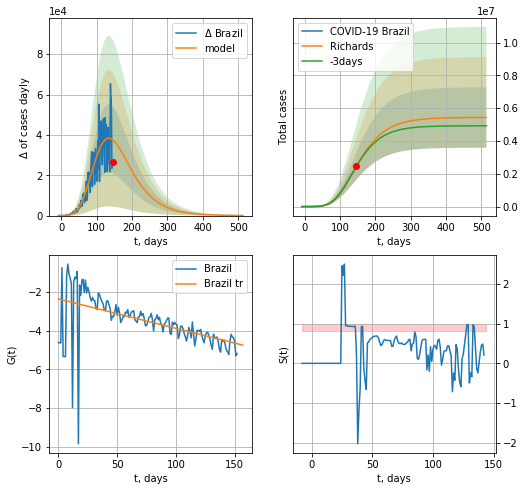

Brazil data at: 2020-07-27
+3 day model MAPE: 0.008298
model: Richards
coeffs: [ 5.43767576e+06  4.37135120e-01 -2.36316677e+01  4.48406882e-02]
rational stdev: 0.338842
forecast at the end of period: +369 days
	 deltaDaycases: 63
	 total cases: 5434463 ± 1841424
	 total death: 194900 ± 198120
trend coefficient of determination: 0.296531
 intercept: -2.361300
 slope: -0.015213


In [1724]:
x = forecastRR('Brazil',dfBZ[:],d1,70*7-dT,addpred=False,xcoef=RkoreaCoeffs)
#x = forecastQR('Brazil',dfBZ[10:],d1,50*7-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


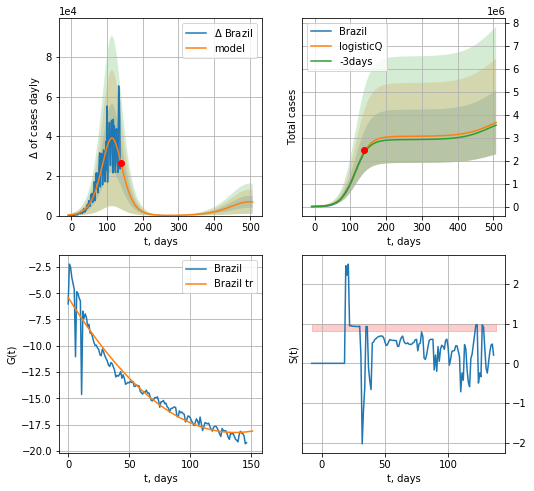

Brazil data at: 2020-07-27
+3 day model MAPE: 0.019950
model: logisticQ
coeffs: [ 3.05811182e+06  6.41629688e-07  1.14580707e+02 -7.95780736e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.378823
forecast at the end of period: +369 days
	 deltaDaycases: 6883
	 total cases: 3659182 ± 1386183
	 total death: 131232 ± 149141
trend coefficient of determination: 0.934822
 intercept_: -5.400929636363621
 coeffs_: [ 0.         -0.18808474  0.00068789]


In [1725]:
x = forecastRRR('Brazil',dfBZ[6:],d1,70*7-dT,addpred=True,xcoef=koreaCoeffs)

In [1726]:
#x = forecastRRR('Brazil',dfBZ[5:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

AS
           date    cases  active  death
159 2020-07-23  13595.0    4681  139.0
160 2020-07-24  13948.0    4874  145.0
161 2020-07-25  14403.0    5229  155.0
162 2020-07-26  14935.0    5603  161.0
163 2020-07-27  15302.0    5824  167.0


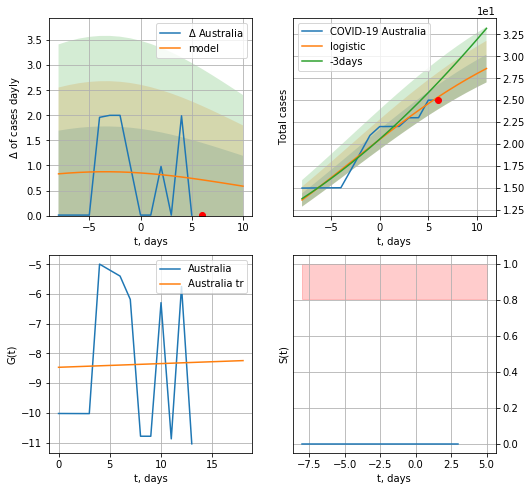

Australia data at: 2020-07-27
model: logistic
coeffs:  [35.98148465  0.0972901  -2.93370788]
rational stdev:  0.05518162900834631
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  28 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.000431
 intercept: -8.467221
 slope: 0.012491


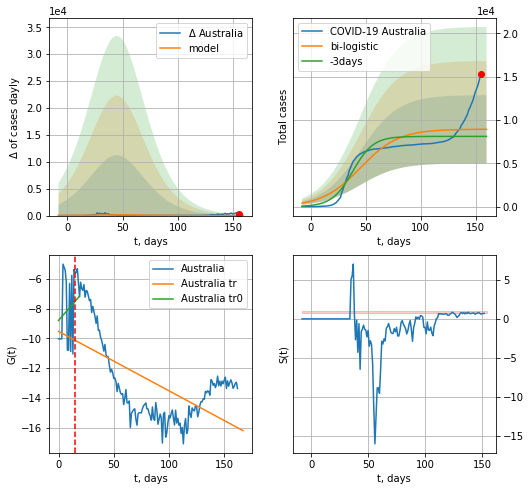

Australia data at: 2020-07-27
+3 day model MAPE: 0.1007706589919562
model: bi-logistic
coeffs:  [8.91362373e+03 5.76635972e-02 4.51584978e+01] [35.98148465  0.0972901  -2.93370788]
rational stdev:  0.4403649611084849
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  8937 ± 3935
	 total death:  97 ± 128
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.022779
 intercept: -8.785888
 slope: 0.086030
trend coefficient of determination: 0.358936
 intercept: -9.523239
 slope: -0.039991


In [1727]:
dfAS = read_df(pd.DataFrame(),"AS")
try:
    x = forecast('Australia',dfAS[:15],d1,18*7-dT,pMAPE=False)
    xx = forecast2('Australia',dfAS[:],d1,18*7-dT,x,vL=15,addpred=False,xcoef=[0.25/4,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


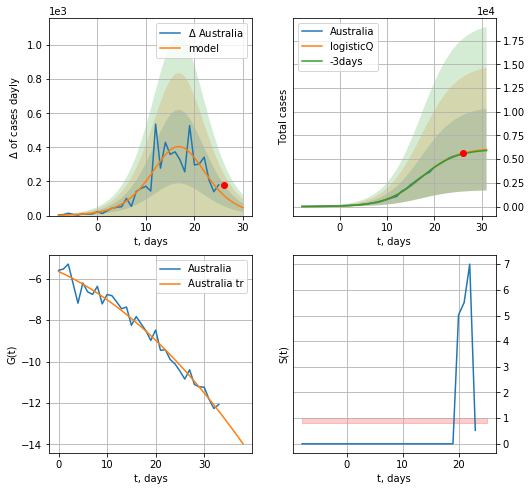

Australia data at: 2020-07-27
+3 day model MAPE: 0.012936
model: logisticQ
coeffs: [ 6.16826027e+03  4.63150668e-05  1.72354354e+01 -5.67232010e+03]
rational stdev: 0.716727
forecast at the end of period: +5 days
	 deltaDaycases: 46
	 total cases: 6009 ± 4307
	 total death: 65 ± 139
trend coefficient of determination: 0.975101
 intercept_: -5.657250296853678
 coeffs_: [ 0.         -0.10702975 -0.00294069]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


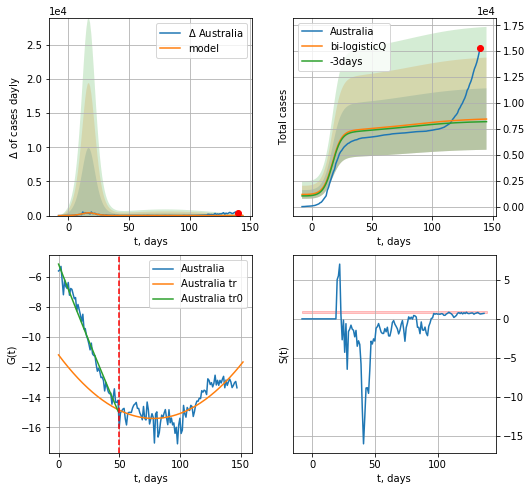

Australia data at: 2020-07-27
+3 day model MAPE: 0.030097
model: bi-logisticQ
coeffs: [ 2.35525980e+03  1.87706022e-04  1.38632069e+01 -1.79864841e+00]
rational stdev: 0.349676
forecast at the end of period: +5 days
	 deltaDaycases: 3
	 total cases: 8461 ± 2958
	 total death: 92 ± 96
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.978786
 intercept_: -5.1508340728883
 coeffs_: [ 0.00000000e+00 -2.09278795e-01  2.06303704e-04]
trend coefficient of determination: 0.686516
 intercept_: -11.182964445677056
 coeffs_: [ 0.         -0.10786114  0.00068928]


In [1728]:
#axcoef = [koreaCoeffs[0],koreaCoeffs[1],koreaCoeffs[2],koreaCoeffs[3]]
vL = 50
x = forecastRRR('Australia',dfAS[15:vL],d1,18*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Australia',dfAS[15:],d1,18*7-dT,x,addpred=False,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


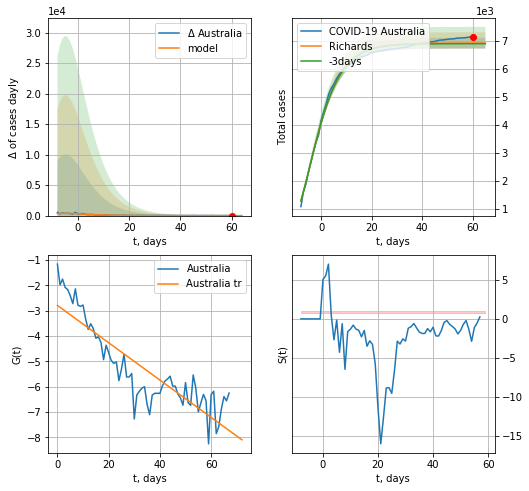

Australia data at: 2020-07-27
+3 day model MAPE: 0.002924
model: Richards
coeffs: [ 6.93026630e+03  1.60954802e+01 -3.69556675e+01  8.97777500e-03]
rational stdev: 0.027985
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 6929 ± 193
	 total death: 75 ± 6
trend coefficient of determination: 0.766459
 intercept: -2.792046
 slope: -0.073631


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


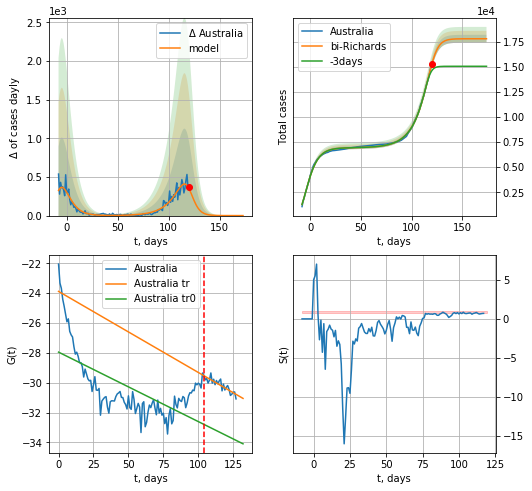

Australia data at: 2020-07-27
+3 day model MAPE: 0.058331
model: bi-Richards
coeffs: [1.08573310e+04 8.16877087e-02 1.20548727e+02 2.83883317e+00]
rational stdev: 0.022122
forecast at the end of period: +54 days
	 deltaDaycases: 0
	 total cases: 17787 ± 393
	 total death: 194 ± 12
bi-Richards approximation splitting point: 104
trend coefficient of determination: 0.413138
 intercept: -27.953068
 slope: -0.046527
trend coefficient of determination: 0.740543
 intercept: -23.885418
 slope: -0.054296


In [1729]:
iL = 20+15
vL = 104+iL
x = forecastRR('Australia',dfAS[iL:vL-iL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Australia',dfAS[iL:],d1,25*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

ML
           date   cases  active  death
147 2020-07-23  8840.0     143  123.0
148 2020-07-24  8861.0     161  123.0
149 2020-07-25  8884.0     167  123.0
150 2020-07-26  8897.0     173  124.0
151 2020-07-27  8904.0     179  124.0


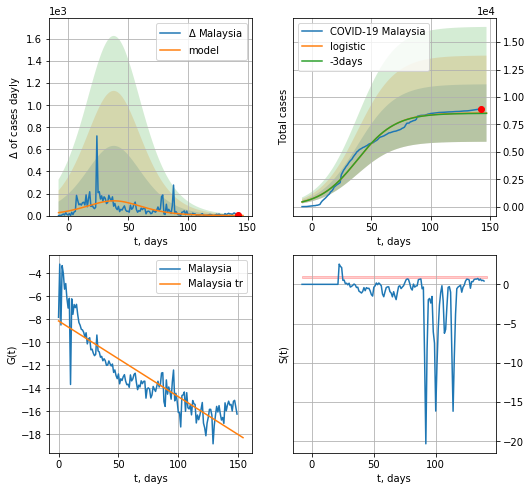

Malaysia data at: 2020-07-27
+3 day model MAPE: 0.0032790615116059627
model: logistic
coeffs:  [8.54478508e+03 6.26622702e-02 3.85673672e+01]
rational stdev:  0.30684258500012584
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  8535 ± 2618
	 total death:  118 ± 108
trend coefficient of determination: 0.785053
 intercept: -8.142677
 slope: -0.065910


In [1730]:
dfML = read_df(pd.DataFrame(),"ML")
x = forecast('Malaysia',dfML[1:],d1,18*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

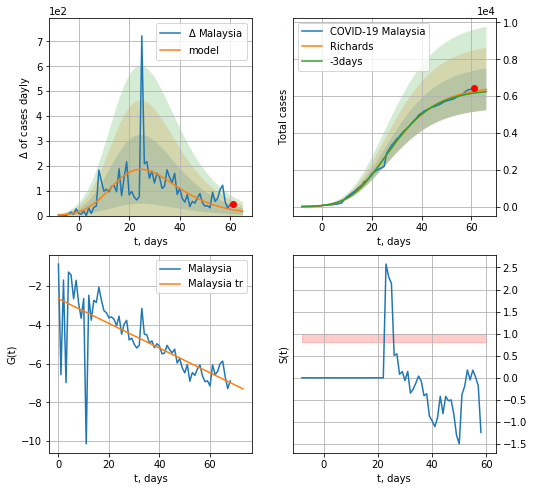

Malaysia data at: 2020-07-27
+3 day model MAPE: 0.016662
model: Richards
coeffs: [6.55737988e+03 3.88576721e-01 7.38244597e+00 2.20016068e-01]
rational stdev: 0.177893
forecast at the end of period: +5 days
	 deltaDaycases: 17
	 total cases: 6362 ± 1131
	 total death: 88 ± 46
trend coefficient of determination: 0.508700
 intercept: -2.652908
 slope: -0.063638


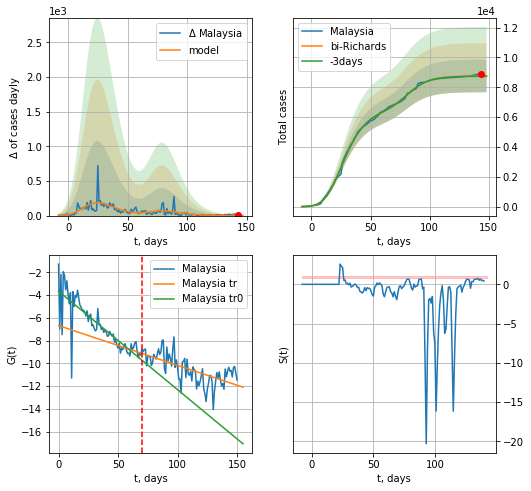

Malaysia data at: 2020-07-27
+3 day model MAPE: 0.002699
model: bi-Richards
coeffs: [2.20781114e+03 2.03048198e-01 7.26683348e+01 4.74430054e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.125003
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 8762 ± 1095
	 total death: 122 ± 45
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.673210
 intercept: -3.657157
 slope: -0.086550
trend coefficient of determination: 0.417387
 intercept: -6.680336
 slope: -0.034932


In [1731]:
vL = 70
x = forecastRR('Malaysia',dfML[:vL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Malaysia',dfML[:],d1,18*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


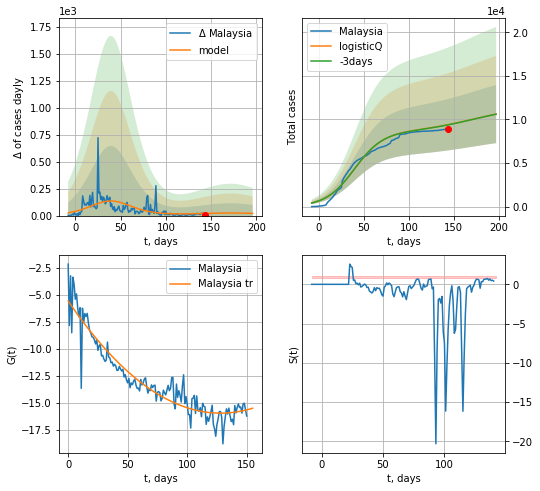

Malaysia data at: 2020-07-27
+3 day model MAPE: 0.002134
model: logisticQ
coeffs: [ 8.54201180e+03  1.07155434e-07  3.95589835e+01 -5.86124594e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.314002
forecast at the end of period: +54 days
	 deltaDaycases: 20
	 total cases: 10613 ± 3332
	 total death: 147 ± 138
trend coefficient of determination: 0.884543
 intercept_: -5.556413253975833
 coeffs_: [ 0.         -0.16266777  0.00063468]


In [1732]:
x = forecastRRR('Malaysia',dfML[:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs)

ZL
           date   cases  active  death
146 2020-07-23  1556.0      21   22.0
147 2020-07-24  1556.2      21   22.0
148 2020-07-25  1556.4      21   22.0
149 2020-07-26  1556.6      21   22.0
150 2020-07-27  1557.0      21   22.0


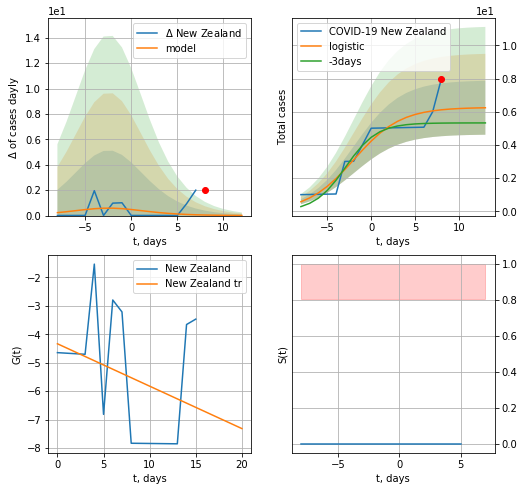

New Zealand data at: 2020-07-27
model: logistic
coeffs:  [ 6.26235964  0.37662733 -1.95315912]
rational stdev:  0.26005250706023997
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  6 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.103357
 intercept: -4.332661
 slope: -0.149156


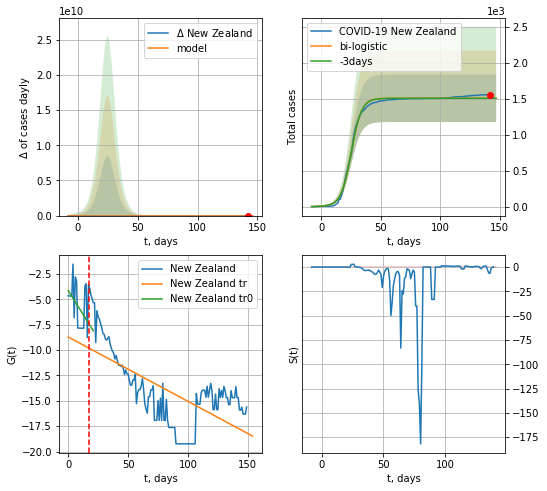

New Zealand data at: 2020-07-27
+3 day model MAPE: 0.00098280831341088
model: bi-logistic
coeffs:  [1.50236815e+03 2.33815683e-01 2.52942918e+01] [ 6.26235964  0.37662733 -1.95315912]
rational stdev:  0.21914932286750463
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  1508 ± 330
	 total death:  21 ± 13
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.175036
 intercept: -4.131936
 slope: -0.189301
trend coefficient of determination: 0.437729
 intercept: -8.707431
 slope: -0.063477


In [1734]:
vL=17
dfZL = read_df(pd.DataFrame(),"ZL")
try:
    x = forecast('New Zealand',dfZL[:vL],d1,18*7-dT,pMAPE=False)
    xx = forecast2('New Zealand',dfZL[:],d1,18*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)#
except:
    print ("Exception occurs")

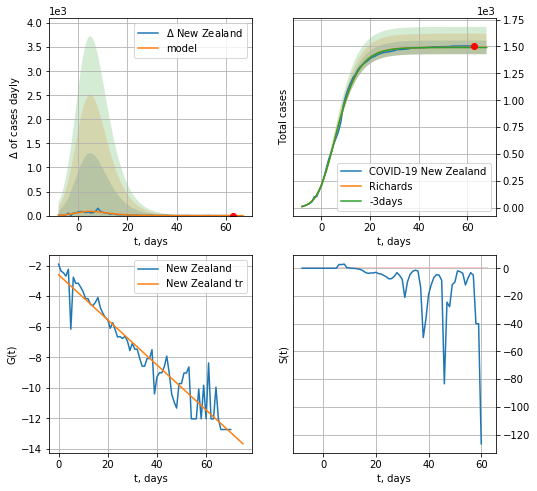

New Zealand data at: 2020-07-27
+3 day model MAPE: 0.000854
model: Richards
coeffs: [ 1.49158629e+03  5.64401145e-01 -5.41478074e-01  3.30453921e-01]
rational stdev: 0.042486
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 1491 ± 63
	 total death: 21 ± 2
trend coefficient of determination: 0.916494
 intercept: -2.603094
 slope: -0.147473


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


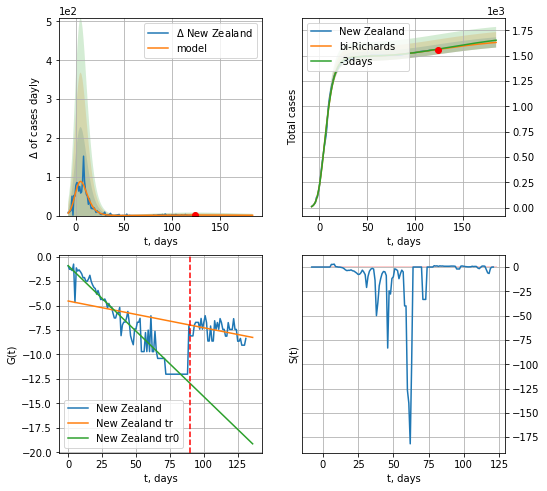

New Zealand data at: 2020-07-27
+3 day model MAPE: 0.001872
model: bi-Richards
coeffs: [ 1.86742428e+02  1.56706557e+00 -9.58530237e+01  1.27347866e-02]
rational stdev: 0.031276
forecast at the end of period: +61 days
	 deltaDaycases: 0
	 total cases: 1631 ± 51
	 total death: 23 ± 2
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.914658
 intercept: -0.931576
 slope: -0.133779
trend coefficient of determination: 0.151066
 intercept: -4.541543
 slope: -0.027327


In [1735]:
vL = 90 + 18
x = forecastRR('New Zealand',dfZL[18:vL-18],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('New Zealand',dfZL[18:],d1,26*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-18)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


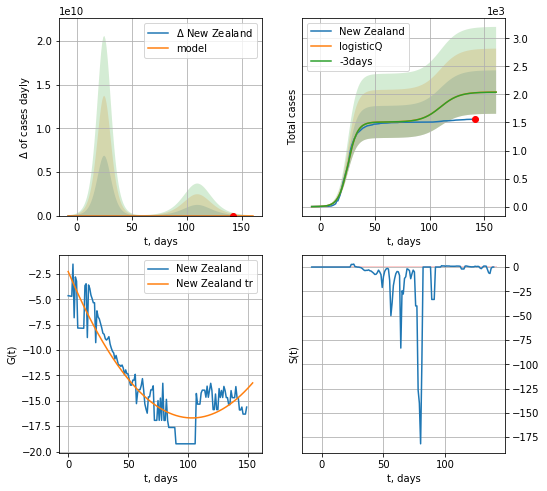

New Zealand data at: 2020-07-27
+3 day model MAPE: 0.000883
model: logisticQ
coeffs: [ 1.50880918e+03  1.61686313e-06  2.52466489e+01 -1.43222814e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.189582
forecast at the end of period: +19 days
	 deltaDaycases: 0
	 total cases: 2041 ± 387
	 total death: 28 ± 15
trend coefficient of determination: 0.844874
 intercept_: -2.2630998291145996
 coeffs_: [ 0.         -0.27898617  0.00134887]


In [1736]:
x = forecastRRR('New Zealand',dfZL[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

BR
           date    cases  active  death
146 2020-07-23  66688.0    6730  519.0
147 2020-07-24  66846.0    6567  524.0
148 2020-07-25  67002.0    6380  530.0
149 2020-07-26  67132.0    6173  534.0
150 2020-07-27  67251.0    6221  538.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


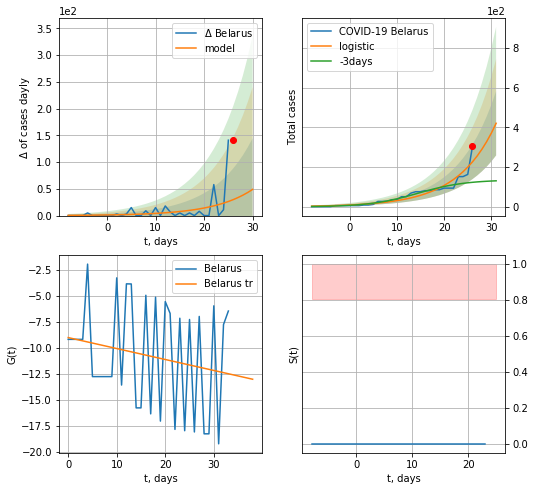

Belarus data at: 2020-07-27
+3 day model MAPE: 1.0426305188408567
model: logistic
coeffs:  [1.42197385e+06 1.24002039e-01 9.65328876e+01]
rational stdev:  0.3845289039536378
forecast at the end of period: +5 days
	 deltaDaycases:  49
	 total cases:  420 ± 161
	 total death:  3 ± 3
trend coefficient of determination: 0.039182
 intercept: -9.040329
 slope: -0.105417


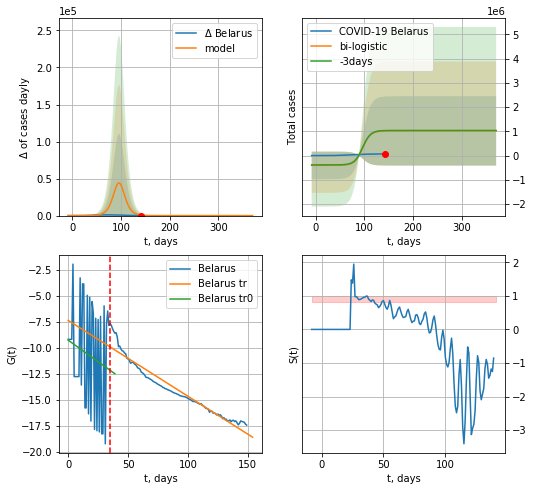

Belarus data at: 2020-07-27
+3 day model MAPE: 0.018551714401817805
model: bi-logistic
coeffs:  [-4.03812439e+05  2.05948773e+01 -4.71316837e+02] [1.42197385e+06 1.24002039e-01 9.65328876e+01]
rational stdev:  1.4051030546311087
forecast at the end of period: +229 days
	 deltaDaycases:  0
	 total cases:  1018161 ± 1430621
	 total death:  8145 ± 34333
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.026128
 intercept: -9.289300
 slope: -0.082783
trend coefficient of determination: 0.937593
 intercept: -7.387427
 slope: -0.072965


In [1737]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:35],d1,7*18-dT)
xx = forecast2('Belarus',dfBR[:],d1,50*7-dT,x,addpred=False,xcoef=[0.25,1.,1.8],vL=35)

BR
           date    cases  active  death
146 2020-07-23  66688.0    6730  519.0
147 2020-07-24  66846.0    6567  524.0
148 2020-07-25  67002.0    6380  530.0
149 2020-07-26  67132.0    6173  534.0
150 2020-07-27  67251.0    6221  538.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


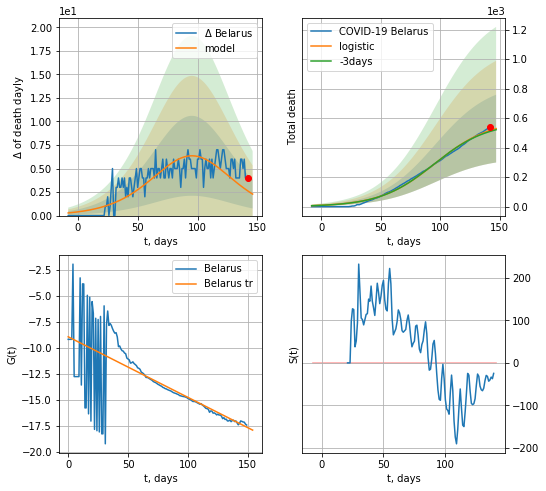

Belarus data at: 2020-07-27
+3 day model MAPE: 0.01347298944985325
model: logistic
coeffs:  [5.86169437e+02 4.33768953e-02 9.57907512e+01]
rational stdev:  0.4344566775104426
forecast at the end of period: +5 days
	 total death:  528 ± 229
trend coefficient of determination: 0.485778
 intercept: -8.963749
 slope: -0.058286


In [1738]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:],d1,18*7-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


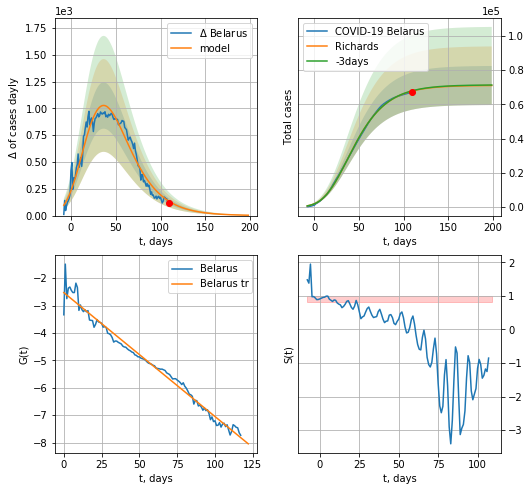

Belarus data at: 2020-07-27
+3 day model MAPE: 0.002153
model: Richards
coeffs: [ 7.11116929e+04  3.31896351e-01 -1.27349617e+01  1.25718193e-01]
rational stdev: 0.160921
forecast at the end of period: +89 days
	 deltaDaycases: 3
	 total cases: 71029 ± 11430
	 total death: 568 ± 274
trend coefficient of determination: 0.980517
 intercept: -2.527151
 slope: -0.045238


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


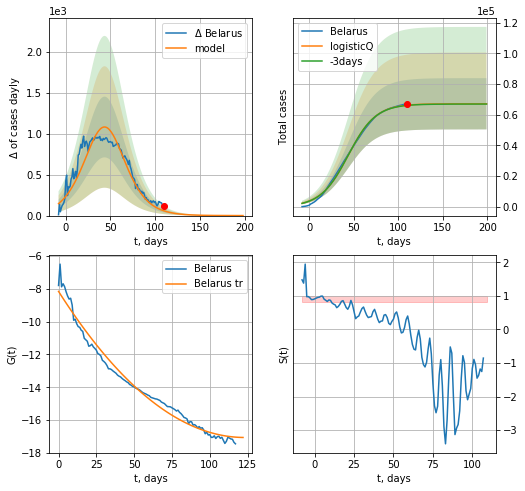

Belarus data at: 2020-07-27
+3 day model MAPE: 0.002313
model: logisticQ
coeffs: [ 6.71340959e+04  3.21734996e-07  4.38280086e+01 -2.00851848e+05]
rational stdev: 0.248609
forecast at the end of period: +89 days
	 deltaDaycases: 0
	 total cases: 67131 ± 16689
	 total death: 537 ± 400
trend coefficient of determination: 0.979060
 intercept_: -8.152023534486737
 coeffs_: [ 0.         -0.14485766  0.00058849]


In [1739]:
x = forecastRR('Belarus',dfBR[32:],d1,30*7-dT,addpred=False,xcoef=RkoreaCoeffs)
x = forecastRRR('Belarus',dfBR[32:],d1,30*7-dT,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


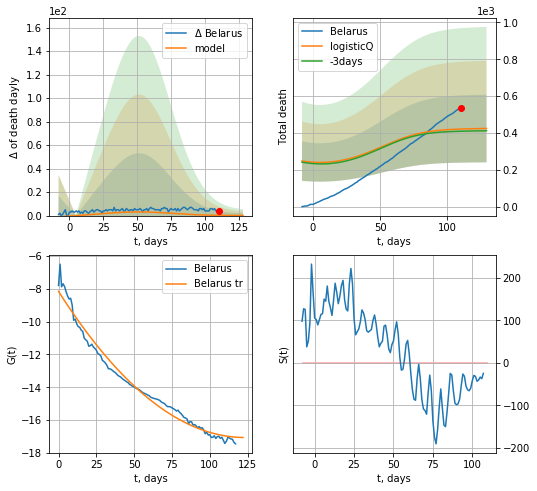

Belarus data at: 2020-07-27
+3 day model MAPE: 0.029163
model: logisticQ
coeffs: [ 3.57229588e+02  4.86447909e-04  1.06143543e+01 -2.24893165e-01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.432214
forecast at the end of period: +19 days
	 total death: 424 ± 183
trend coefficient of determination: 0.979060
 intercept_: -8.152023534486737
 coeffs_: [ 0.         -0.14485766  0.00058849]


In [1740]:
x = forecastRRR('Belarus',dfBR[32:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

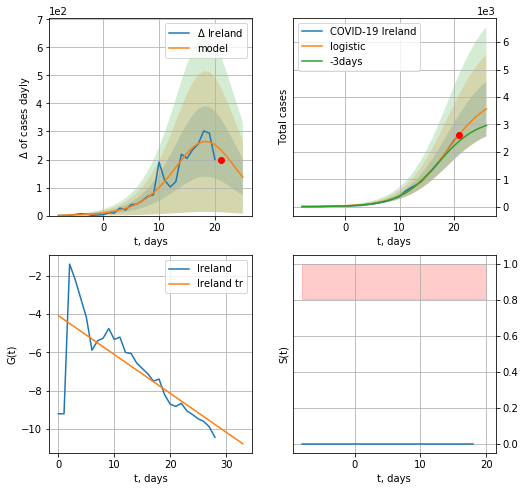

Ireland data at: 2020-07-27
+3 day model MAPE: 0.12282208937722881
model: logistic
coeffs:  [4.12730398e+03 2.56984382e-01 1.88154165e+01]
rational stdev:  0.27980533262906077
forecast at the end of period: +5 days
	 deltaDaycases:  136
	 total cases:  3564 ± 997
	 total death:  242 ± 203
trend coefficient of determination: 0.521820
 intercept: -4.083344
 slope: -0.202899


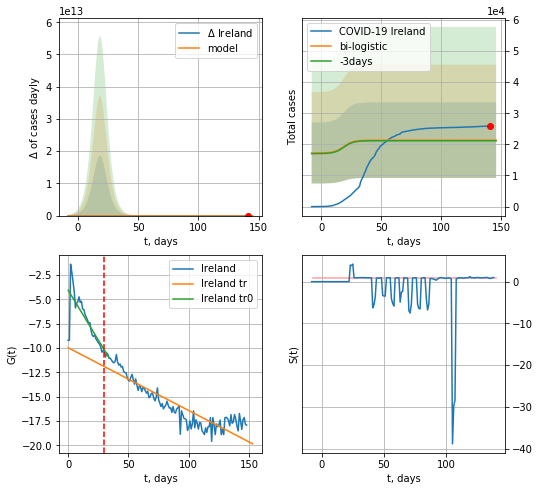

Ireland data at: 2020-07-27
+3 day model MAPE: 0.009631276104472277
model: bi-logistic
coeffs:  [ 1.37723583e+04 -1.10663825e+01  2.77740772e+02] [4.12730398e+03 2.56984382e-01 1.88154165e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.5682852844666305
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  21342 ± 12128
	 total death:  1454 ± 2478
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.551550
 intercept: -4.065434
 slope: -0.204818
trend coefficient of determination: 0.817009
 intercept: -9.980617
 slope: -0.064498


In [1741]:
vL=30
x = forecast('Ireland',dfIR[:vL],d1,18*7-dT)
xx = forecast2('Ireland',dfIR[:],d1,18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


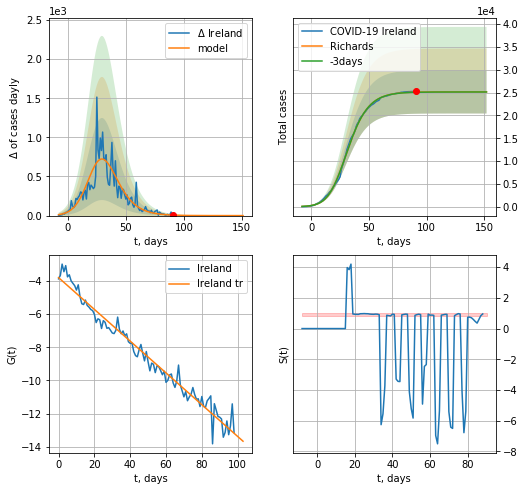

Ireland data at: 2020-07-27
+3 day model MAPE: 0.001256
model: Richards
coeffs: [2.51692626e+04 1.93826337e-01 2.27522014e+01 5.01021340e-01]
rational stdev: 0.188437
forecast at the end of period: +61 days
	 deltaDaycases: 0
	 total cases: 25169 ± 4742
	 total death: 1714 ± 968
trend coefficient of determination: 0.969247
 intercept: -3.803769
 slope: -0.095697


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


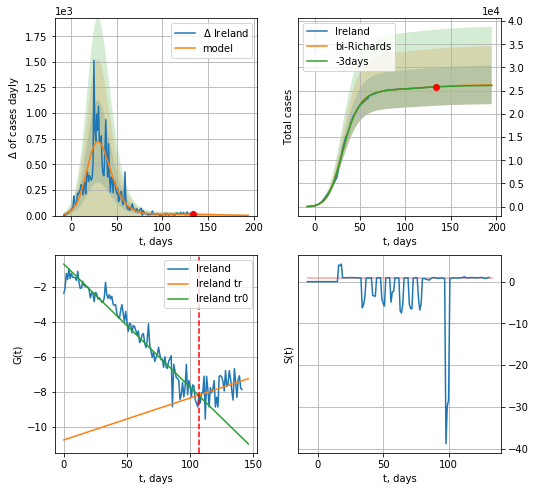

Ireland data at: 2020-07-27
+3 day model MAPE: 0.001236
model: bi-Richards
coeffs: [ 1.17923024e+03  3.30076809e+00 -3.53276231e+01  9.42105591e-03]
rational stdev: 0.158429
forecast at the end of period: +61 days
	 deltaDaycases: 2
	 total cases: 26255 ± 4159
	 total death: 1788 ± 849
bi-Richards approximation splitting point: 107
trend coefficient of determination: 0.944941
 intercept: -0.724408
 slope: -0.070032
trend coefficient of determination: 0.129390
 intercept: -10.728198
 slope: 0.023866


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


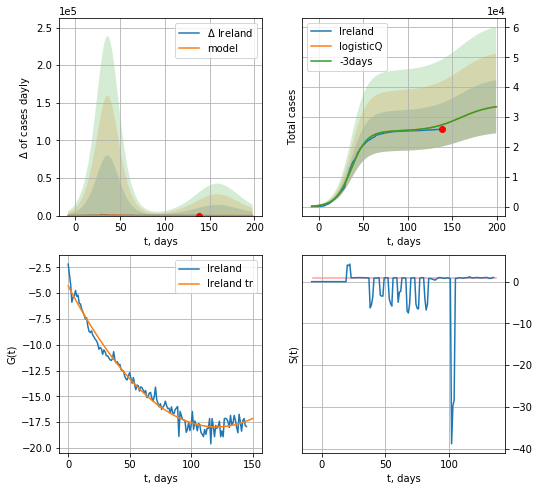

Ireland data at: 2020-07-27
+3 day model MAPE: 0.000801
model: logisticQ
coeffs: [ 2.53047090e+04  6.20383026e-07  3.64637542e+01 -1.84103126e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.266142
forecast at the end of period: +61 days
	 deltaDaycases: 43
	 total cases: 33452 ± 8903
	 total death: 2279 ± 1819
trend coefficient of determination: 0.978358
 intercept_: -4.32179970213946
 coeffs_: [ 0.         -0.2262077   0.00093826]


In [1742]:
ivL = 7
vL = 100 + ivL+ivL
x = forecastRR('Ireland',dfIR[ivL:vL-ivL],d1,26*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Ireland',dfIR[ivL:],d1,26*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-ivL)
x = forecastRRR('Ireland',dfIR[3:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

CL
           date   cases  active   death
142 2020-07-23  338759   18490  8838.0
143 2020-07-24  341304   18694  8914.0
144 2020-07-25  343592   18403  9020.0
145 2020-07-26  345790   18583  9112.0
146 2020-07-27  347923   18782  9187.0


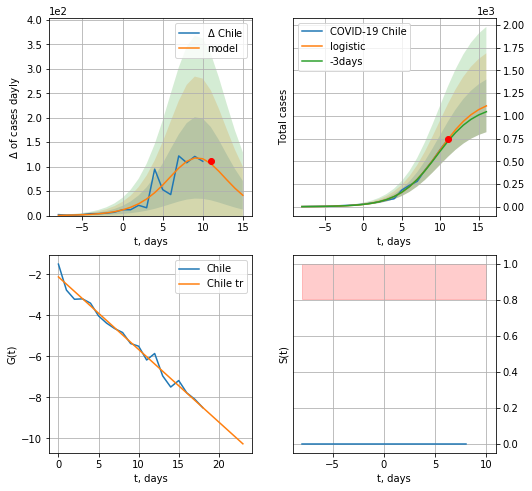

Chile data at: 2020-07-27
+3 day model MAPE: 0.03908993891192624
model: logistic
coeffs:  [1.20759839e+03 3.93191843e-01 9.80781865e+00]
rational stdev:  0.2610672451056305
forecast at the end of period: +5 days
	 deltaDaycases:  41
	 total cases:  1110 ± 289
	 total death:  29 ± 22
trend coefficient of determination: 0.982168
 intercept: -2.127319
 slope: -0.354074


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


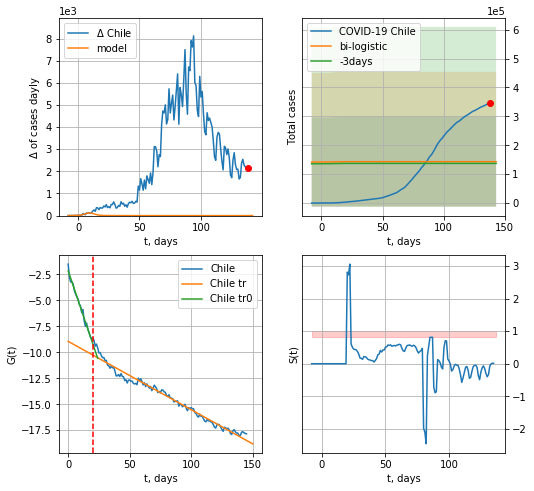

Chile data at: 2020-07-27
+3 day model MAPE: 0.04384895543532058
model: bi-logistic
coeffs:  [ 1.13585767e+05 -2.42340405e+01  5.87343665e+02] [1.20759839e+03 3.93191843e-01 9.80781865e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.0858009471501122
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  143189 ± 155475
	 total death:  3780 ± 12312
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.984051
 intercept: -2.144368
 slope: -0.351232
trend coefficient of determination: 0.972215
 intercept: -8.943304
 slope: -0.065789


In [1743]:
vL=20
dfCL = read_df(pd.DataFrame(),"CL")
x = forecast('Chile',dfCL[:vL],d1,7*18-dT)
xx = forecast2('Chile',dfCL[:],d1,18*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


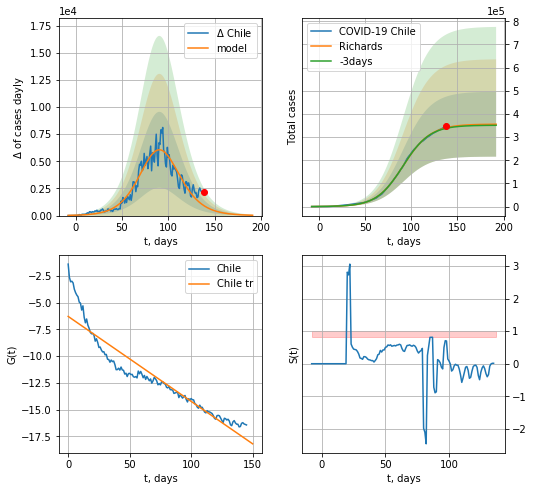

Chile data at: 2020-07-27
+3 day model MAPE: 0.007931
model: Richards
coeffs: [3.56084572e+05 7.39941717e-02 8.90722120e+01 8.89207465e-01]
rational stdev: 0.393719
forecast at the end of period: +54 days
	 deltaDaycases: 31
	 total cases: 355626 ± 140016
	 total death: 9390 ± 11091
trend coefficient of determination: 0.887401
 intercept: -6.280019
 slope: -0.079519


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


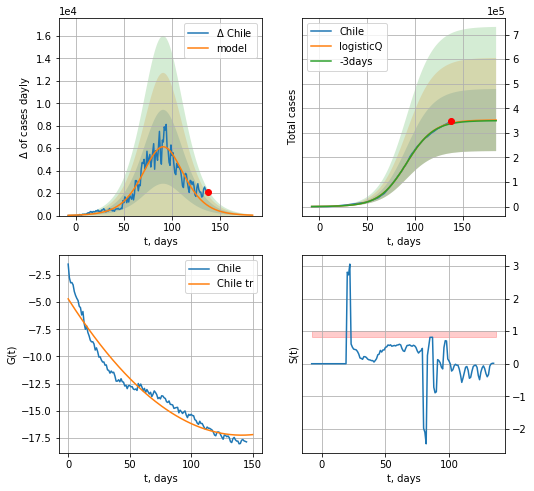

Chile data at: 2020-07-27
+3 day model MAPE: 0.006103
model: logisticQ
coeffs: [ 3.52712967e+05  2.36786781e-06  9.12995460e+01 -2.92660205e+04]
rational stdev: 0.358651
forecast at the end of period: +47 days
	 deltaDaycases: 37
	 total cases: 352201 ± 126317
	 total death: 9299 ± 10005
trend coefficient of determination: 0.950447
 intercept_: -4.700114085867325
 coeffs_: [ 0.         -0.17765183  0.00062947]


In [1744]:
vL = 20+20
x = forecastRR('Chile',dfCL[:],d1,25*7-dT,addpred=False,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Chile',dfCL[10:],d1,40*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL-10)
x = forecastRRR('Chile',dfCL[:],d1,24*7-dT,addpred=False,xcoef=koreaCoeffs)

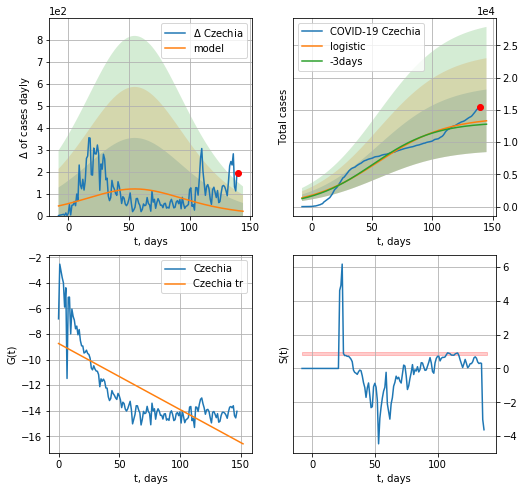

Czechia data at: 2020-07-27
+3 day model MAPE: 0.03910032965963389
model: logistic
coeffs:  [1.38839637e+04 3.49170743e-02 5.52000120e+01]
rational stdev:  0.3646893118050305
forecast at the end of period: +5 days
	 deltaDaycases:  19
	 total cases:  13305 ± 4852
	 total death:  319 ± 349
trend coefficient of determination: 0.586998
 intercept: -8.739804
 slope: -0.051599


In [1745]:
x = forecast('Czechia',dfCH[:],d1,18*7-dT,shift=1.,addpred=False,xcoef=[0.25,1.,2.4])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


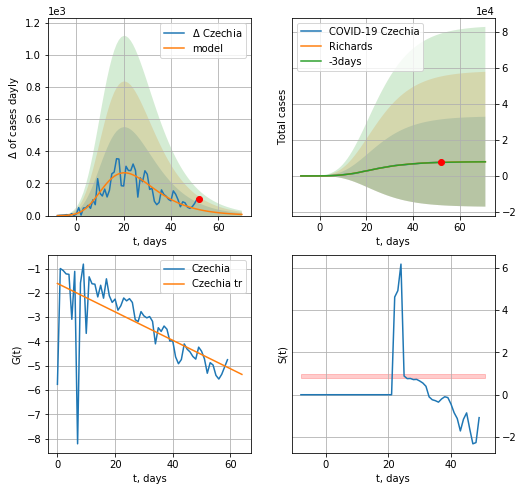

Czechia data at: 2020-07-27
+3 day model MAPE: 0.007833
model: Richards
coeffs: [ 7.98936803e+03  1.90705450e+00 -1.17115779e+01  4.87276061e-02]
rational stdev: 3.153640
forecast at the end of period: +19 days
	 deltaDaycases: 7
	 total cases: 7914 ± 24959
	 total death: 190 ± 1797
trend coefficient of determination: 0.449013
 intercept: -1.614151
 slope: -0.058413


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


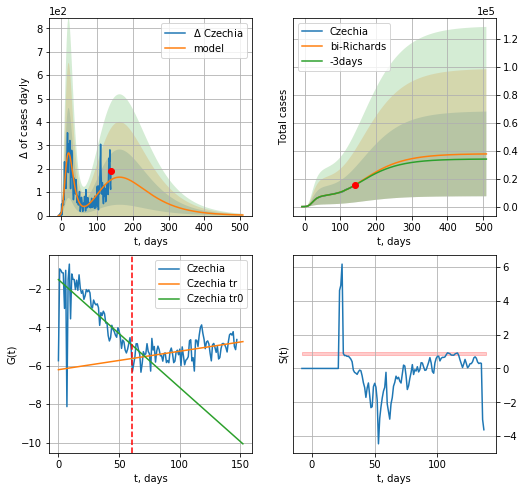

Czechia data at: 2020-07-27
+3 day model MAPE: 0.006628
model: bi-Richards
coeffs: [ 2.98997130e+04  5.99300049e-01 -7.99069308e+01  2.52354773e-02]
rational stdev: 0.803982
forecast at the end of period: +369 days
	 deltaDaycases: 2
	 total cases: 37728 ± 30333
	 total death: 906 ± 2185
bi-Richards approximation splitting point: 61
trend coefficient of determination: 0.437796
 intercept: -1.518593
 slope: -0.056191
trend coefficient of determination: 0.214520
 intercept: -6.203578
 slope: 0.009603


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


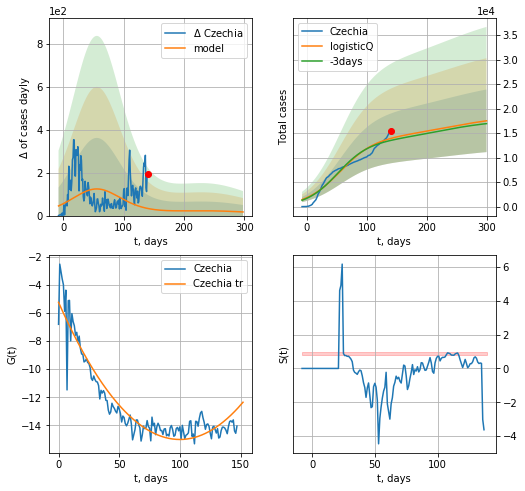

Czechia data at: 2020-07-27
+3 day model MAPE: 0.030435
model: logisticQ
coeffs: [ 1.38834587e+04  5.26807689e-08  5.52005068e+01 -6.62545108e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.364696
forecast at the end of period: +159 days
	 deltaDaycases: 16
	 total cases: 17499 ± 6382
	 total death: 420 ± 459
trend coefficient of determination: 0.893899
 intercept_: -5.247382275148168
 coeffs_: [ 0.         -0.19512471  0.00097637]


In [1747]:
vL= 61
x = forecastRR('Czechia',dfCH[:vL],d1,20*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Czechia',dfCH[:],d1,70*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRRR('Czechia',dfCH[:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

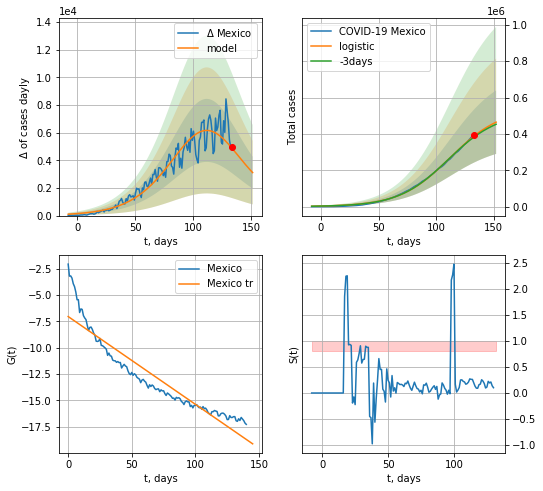

Mexico data at: 2020-07-27
+3 day model MAPE: 0.014664432519428382
model: logistic
coeffs:  [5.31211340e+05 4.61206672e-02 1.11645377e+02]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.37590824862987515
forecast at the end of period: +19 days
	 deltaDaycases:  3109
	 total cases:  464507 ± 174612
	 total death:  51704 ± 58307
trend coefficient of determination: 0.876856
 intercept: -7.047481
 slope: -0.083164


In [1748]:
x = forecast('Mexico',dfMX[:],d1,20*7-dT,addpred=True,xcoef=[.25,1.,2.])#

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


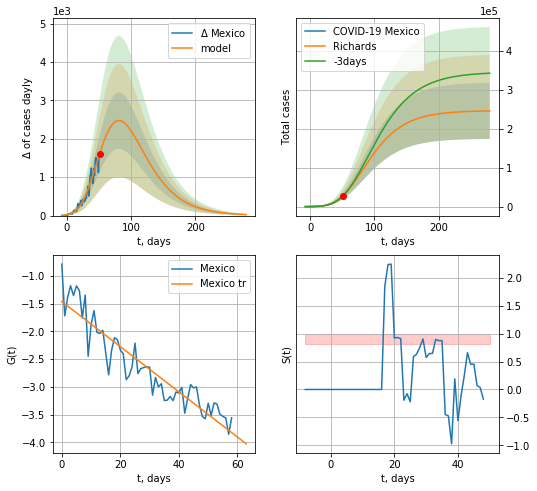

Mexico data at: 2020-07-27
+3 day model MAPE: 0.013781
model: Richards
coeffs: [ 2.46197399e+05  4.05650878e-01 -1.28761086e+01  6.97244909e-02]
rational stdev: 0.292607
forecast at the end of period: +229 days
	 deltaDaycases: 25
	 total cases: 245307 ± 71778
	 total death: 27305 ± 23968
trend coefficient of determination: 0.864363
 intercept: -1.463809
 slope: -0.040682


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


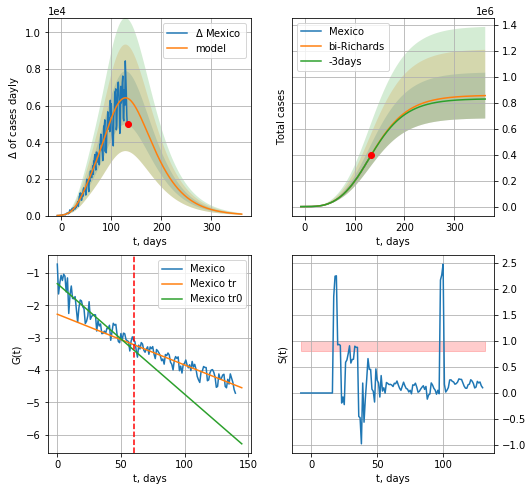

Mexico data at: 2020-07-27
+3 day model MAPE: 0.002717
model: bi-Richards
coeffs: [ 6.11079552e+05  8.89369027e-01 -1.75370760e+01  2.62539630e-02]
rational stdev: 0.206327
forecast at the end of period: +229 days
	 deltaDaycases: 79
	 total cases: 853900 ± 176183
	 total death: 95047 ± 58832
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.834830
 intercept: -1.332552
 slope: -0.034107
trend coefficient of determination: 0.847558
 intercept: -2.276607
 slope: -0.015657


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


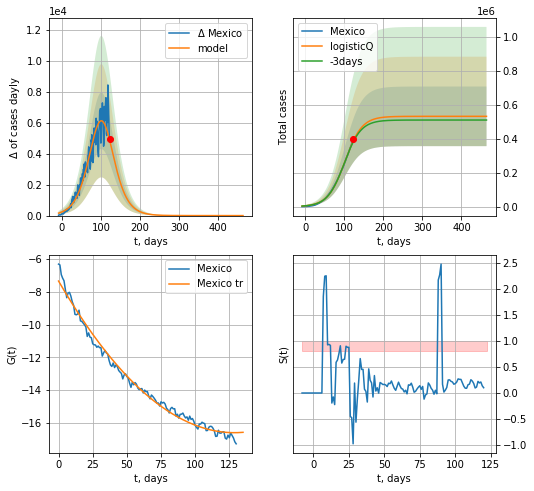

Mexico data at: 2020-07-27
+3 day model MAPE: 0.014922
model: logisticQ
coeffs: [ 5.31855655e+05  5.85076744e-07  1.01707582e+02 -7.86318299e+04]
rational stdev: 0.330085
forecast at the end of period: +341 days
	 deltaDaycases: 0
	 total cases: 531855 ± 175557
	 total death: 59201 ± 58624
trend coefficient of determination: 0.988188
 intercept_: -7.354200566518248
 coeffs_: [ 0.         -0.14348348  0.00055747]


In [1749]:
vL = 60
x = forecastRR('Mexico',dfMX[:vL],d1,50*7-dT,addpred=False,xcoef=RkoreaCoeffs)#
xx = forecast2RR('Mexico',dfMX[:],d1,50*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRRR('Mexico',dfMX[10:],d1,66*7-dT,addpred=False,xcoef=koreaCoeffs)#

LT
           date   cases  active  death     tests
136 2020-07-23  1986.0     290   80.0  497245.0
137 2020-07-24  2001.0     291   80.0  499960.0
138 2020-07-25  2008.0     299   80.0  502690.0
139 2020-07-26  2019.0     306   80.0  504056.0
140 2020-07-27  2027.0     324   80.0       NaN


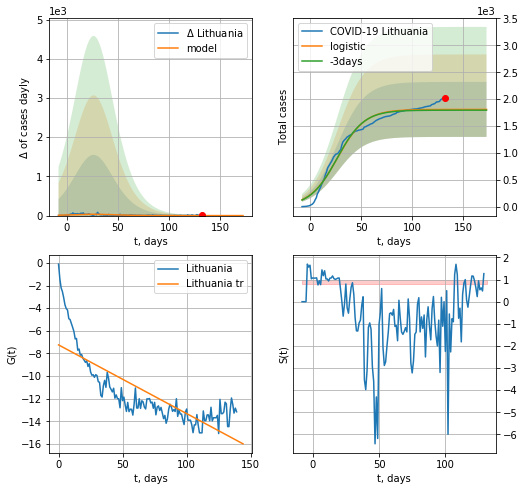

Lithuania data at: 2020-07-27
+3 day model MAPE: 0.0077910240153444615
model: logistic
coeffs:  [1.80845569e+03 7.41828256e-02 2.67071395e+01]
rational stdev:  0.2829342675149863
forecast at the end of period: +41 days
	 deltaDaycases:  0
	 total cases:  1808 ± 511
	 total death:  71 ± 60
trend coefficient of determination: 0.639551
 intercept: -7.239909
 slope: -0.060678


In [1750]:
vL = 1
dfLT = read_df(pd.DataFrame(),"LT")
try:
    x = forecast('Lithuania',dfLT[:],d1,6*7-1)
except:
    print("Exception occurs")
#xx = forecast2('Lithuania',dfLT[:],d1,8*7-1,x,shift=1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

In [1115]:
#dfLT = read_df(pd.DataFrame(),"LT")
#plt.plot(range(len(dfLT[3:])),dfLT[3:].cases/dfLT[3:].tests)

#plt.grid()#

In [1116]:
#np.diff(dfLT["cases"])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


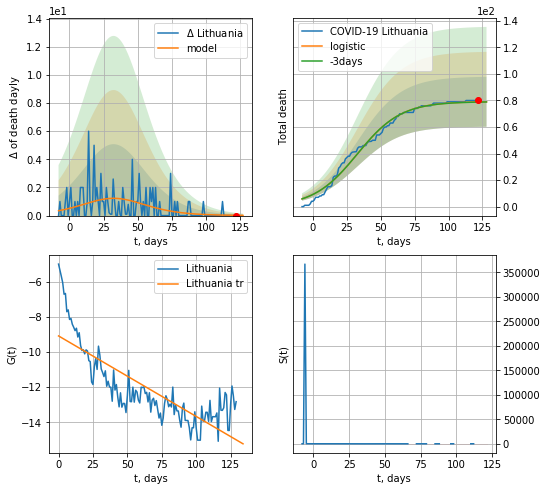

Lithuania data at: 2020-07-26
+3 day model MAPE: 0.0013472781089340269
model: logistic
coeffs:  [7.92112394e+01 6.20887601e-02 3.27223175e+01]
rational stdev:  0.23829129293149107
forecast at the end of period: +6 days
	 total death:  78 ± 18
trend coefficient of determination: 0.647372
 intercept: -9.085017
 slope: -0.045760


In [1369]:
x = forecast('Lithuania',dfLT[9:],d1,7*18-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


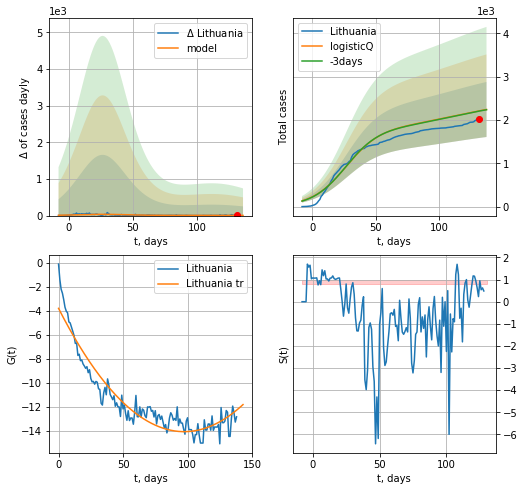

Lithuania data at: 2020-07-26
+3 day model MAPE: 0.002764
model: logisticQ
coeffs: [ 1.80369327e+03  9.59169918e-08  2.65830643e+01 -7.79750432e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.283324
forecast at the end of period: +6 days
	 deltaDaycases: 5
	 total cases: 2243 ± 635
	 total death: 89 ± 75
trend coefficient of determination: 0.901241
 intercept_: -3.7905442765848862
 coeffs_: [ 0.         -0.21094582  0.00108318]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


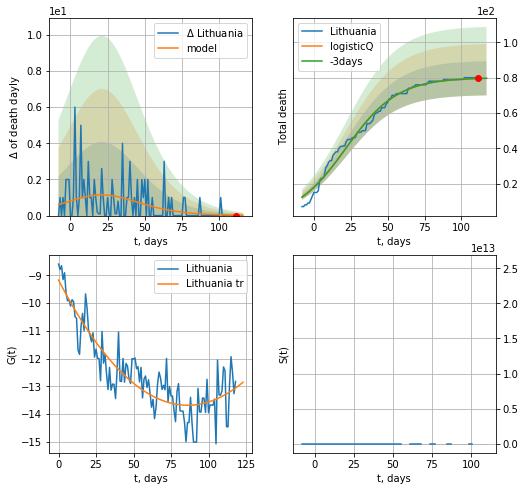

Lithuania data at: 2020-07-26
+3 day model MAPE: 0.000642
model: logisticQ
coeffs: [ 8.00235291e+01  3.33330295e-07  2.16993546e+01 -1.71555528e+05]
rational stdev: 0.121591
forecast at the end of period: +6 days
	 total death: 79 ± 9
trend coefficient of determination: 0.792194
 intercept_: -9.165922697256974
 coeffs_: [ 0.         -0.10488826  0.00060912]


In [1370]:
#x = forecast('Lithuania',dfLT[10-4:],d1,6*7-1,cases='active')
x = forecastRRR('Lithuania',dfLT[:],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Lithuania',dfLT[20:],d1,18*7-dT,addpred=False,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


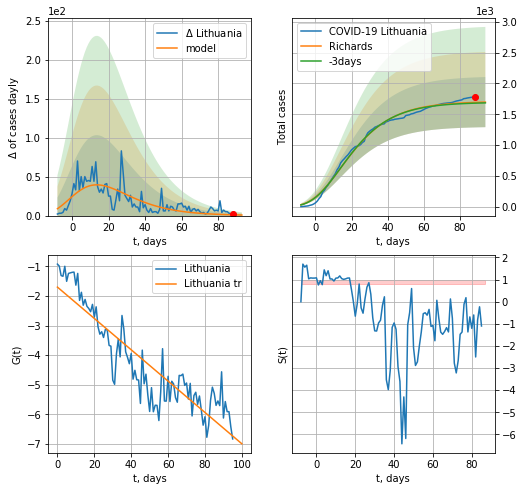

Lithuania data at: 2020-07-26
+3 day model MAPE: 0.007252
model: Richards
coeffs: [ 1.70755770e+03  1.22304282e+01 -6.97018177e+01  5.14662736e-03]
rational stdev: 0.239484
forecast at the end of period: +6 days
	 deltaDaycases: 0
	 total cases: 1696 ± 406
	 total death: 67 ± 48
trend coefficient of determination: 0.808202
 intercept: -1.701381
 slope: -0.052934


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


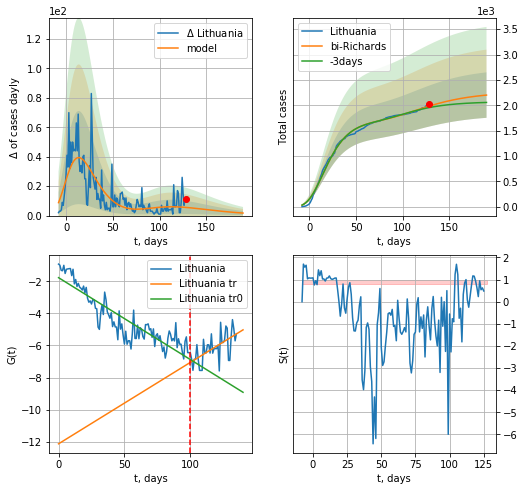

Lithuania data at: 2020-07-26
+3 day model MAPE: 0.015623
model: bi-Richards
coeffs: [ 5.56574979e+02  4.05505959e+00 -5.82840807e+01  7.02347977e-03]
rational stdev: 0.203486
forecast at the end of period: +62 days
	 deltaDaycases: 1
	 total cases: 2200 ± 447
	 total death: 87 ± 53
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.806211
 intercept: -1.773103
 slope: -0.051053
trend coefficient of determination: 0.366342
 intercept: -12.133504
 slope: 0.050760


In [1371]:
iL = 3
vL =100+iL
x = forecastRR('Lithuania',dfLT[iL:vL-iL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)#
xx = forecast2RR('Lithuania',dfLT[iL:],d1,26*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)#
#xx = forecast2R('Lithuania',dfLT[:],d1,2*7-1,x,shift=1.0,addpred=True,xcoef=[0.25,1.,1.5])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


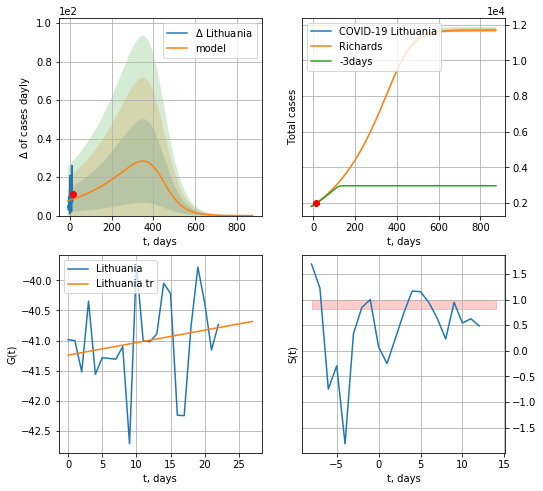

Lithuania data at: 2020-07-26
+3 day model MAPE: 0.006457
model: Richards
coeffs: [1.16881839e+04 4.27318614e-03 4.27820025e+02 4.66762017e+00]
rational stdev: 0.005464
forecast at the end of period: +860 days
	 deltaDaycases: 0
	 total cases: 11687 ± 63
	 total death: 465 ± 7
trend coefficient of determination: 0.034903
 intercept: -41.242131
 slope: 0.020734


In [1373]:
x = forecastRR('Lithuania',dfLT[116:],d1,140*7-dT,addpred=False)#

In [ ]:
#x = forecastQR('Lithuania',dfLT[:],d1,16*7-dT,addpred=False,xcoef=[0.35,.52,4.,1.,1.])

LX
           date   cases  active  death
137 2020-07-22  5854.0    1213  111.0
138 2020-07-23  5952.0    1249  112.0
139 2020-07-24  6056.0    1297  112.0
140 2020-07-25  6189.0    1430  112.0
141 2020-07-26  6272.0    1513  112.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


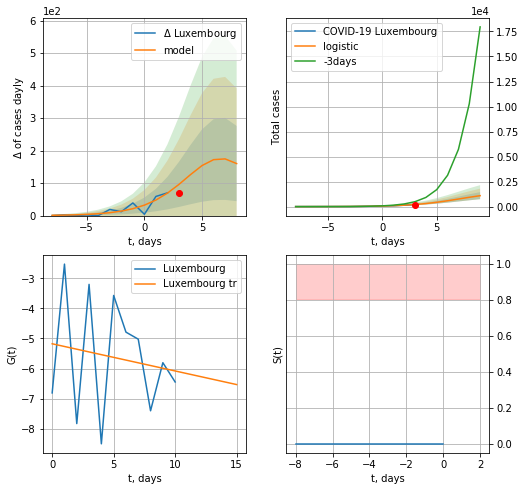

Luxembourg data at: 2020-07-26
model: logistic
coeffs:  [1.56298312e+03 4.51684200e-01 7.13428385e+00]
rational stdev:  0.3215238047871676
forecast at the end of period: +6 days
	 deltaDaycases:  160
	 total cases:  1092 ± 351
	 total death:  19 ± 18
trend coefficient of determination: 0.022967
 intercept: -5.176630
 slope: -0.090347


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


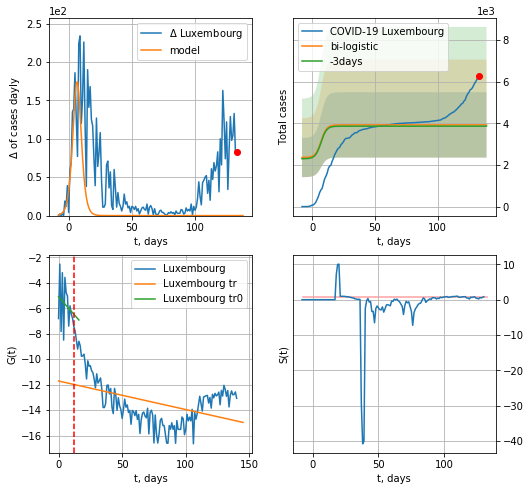

Luxembourg data at: 2020-07-26
+3 day model MAPE: 0.015817775827447915
model: bi-logistic
coeffs:  [2095.2851363    -8.3135812   284.81017147] [1.56298312e+03 4.51684200e-01 7.13428385e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.3995771451457523
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  3920 ± 1566
	 total death:  70 ± 83
bi-logistic approximation splitting point: 12
trend0 coefficient of determination: 0.045986
 intercept: -5.098250
 slope: -0.113861
trend coefficient of determination: 0.193618
 intercept: -11.713465
 slope: -0.022425


In [1374]:
dfLX = read_df(pd.DataFrame(),"LX")
x = forecast("Luxembourg",dfLX[:12],d1,18*7-dT,pMAPE=False)
xx = forecast2("Luxembourg",dfLX[:],d1,18*7-dT,x,vL=12,addpred=True,xcoef=[0.25/2,1.,2.])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


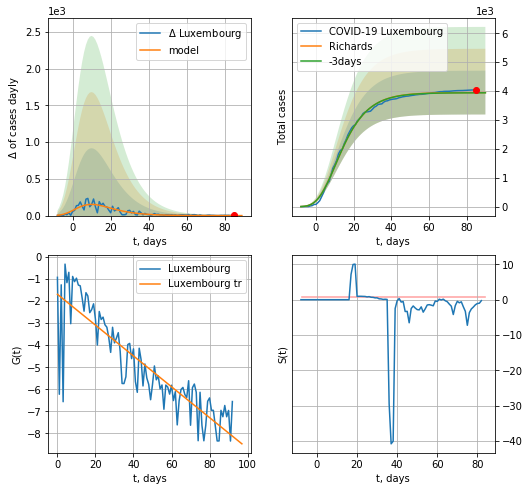

Luxembourg data at: 2020-07-27
+3 day model MAPE: 0.002043
model: Richards
coeffs: [ 3.94969099e+03  2.24968811e+01 -4.06525331e+01  4.67252012e-03]
rational stdev: 0.191849
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 3948 ± 757
	 total death: 69 ± 39
trend coefficient of determination: 0.761221
 intercept: -1.696203
 slope: -0.069808


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


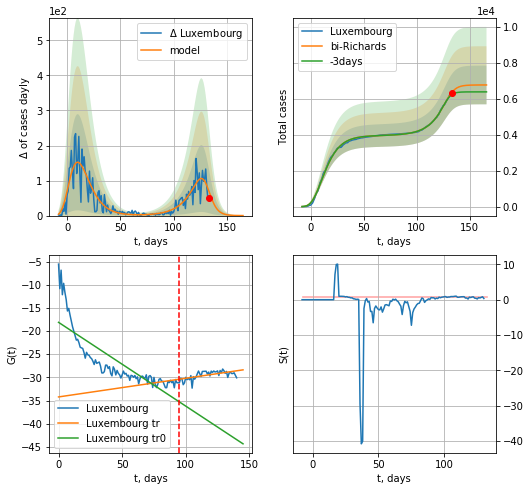

Luxembourg data at: 2020-07-27
+3 day model MAPE: 0.023194
model: bi-Richards
coeffs: [2.81399053e+03 8.12250640e-02 1.30970701e+02 2.88413224e+00]
rational stdev: 0.159001
forecast at the end of period: +33 days
	 deltaDaycases: 0
	 total cases: 6763 ± 1075
	 total death: 119 ± 56
bi-Richards approximation splitting point: 95
trend coefficient of determination: 0.677677
 intercept: -18.130844
 slope: -0.180807
trend coefficient of determination: 0.355818
 intercept: -34.228777
 slope: 0.040289


In [1751]:
iL=1
vL = 105+iL-10
x = forecastRR("Luxembourg",dfLX[iL:vL-iL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Luxembourg",dfLX[iL:],d1,22*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


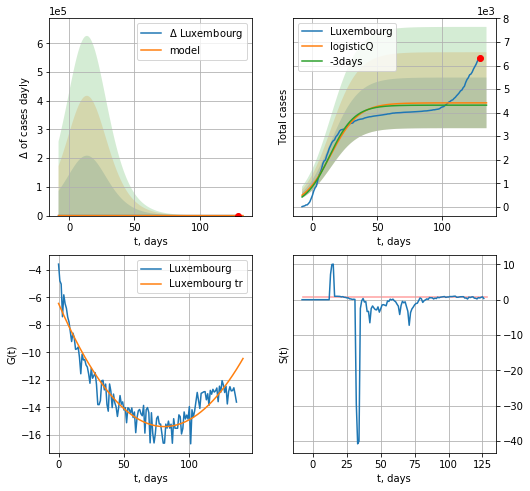

Luxembourg data at: 2020-07-27
+3 day model MAPE: 0.022621
model: logisticQ
coeffs: [ 4.41559840e+03  6.11548736e-08  1.41203293e+01 -1.53195363e+06]
rational stdev: 0.243613
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 4415 ± 1075
	 total death: 78 ± 57
trend coefficient of determination: 0.882644
 intercept_: -6.434039184581083
 coeffs_: [ 0.         -0.2215996   0.00137016]


In [1752]:
x = forecastRRR("Luxembourg",dfLX[5:],d1,18*7-dT,addpred=False,xcoef=koreaCoeffs)

ED
           date    cases   active   death
145 2020-07-23  78148.0  39254.0  5439.0
146 2020-07-24  79049.0  39037.0  5468.0
147 2020-07-25  80036.0  39985.0  5507.0
148 2020-07-26  80694.0  40283.0  5515.0
149 2020-07-27  81161.0  40733.0  5532.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


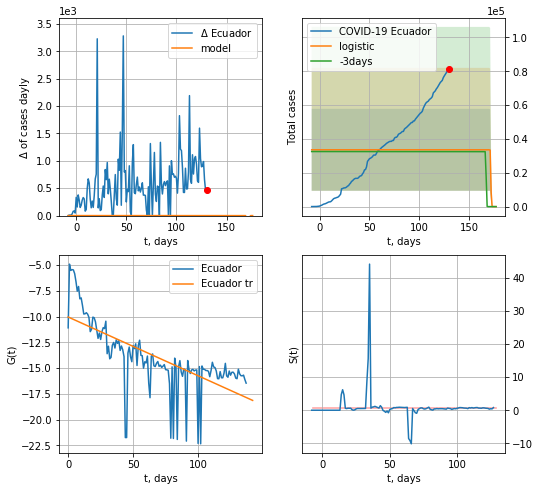

Ecuador data at: 2020-07-27
+3 day model MAPE: 0.03188468799448455
model: logistic
coeffs:  [ 3.35851156e+04 -6.25277015e+00  1.71830251e+02]
rational stdev:  0.7211326221924368
forecast at the end of period: +47 days
	 deltaDaycases:  0
	 total cases:  0 ± 0
	 total death:  0 ± 0
trend coefficient of determination: 0.476341
 intercept: -10.037809
 slope: -0.057062


In [1753]:
dfED = read_df(pd.DataFrame(),"ED")
x = forecast("Ecuador",dfED[11:],d1,24*7-dT)
#xx = forecast2(c,adf[:],d1,4*7-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


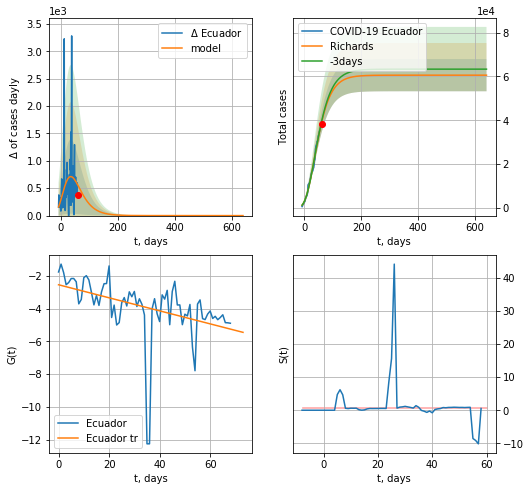

Ecuador data at: 2020-07-27
+3 day model MAPE: 0.010673
model: Richards
coeffs: [ 6.05715178e+04  1.40195301e+00 -8.12227391e+01  2.30638250e-02]
rational stdev: 0.121131
forecast at the end of period: +579 days
	 deltaDaycases: 0
	 total cases: 60571 ± 7337
	 total death: 4128 ± 1500
trend coefficient of determination: 0.186200
 intercept: -2.545204
 slope: -0.039774


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


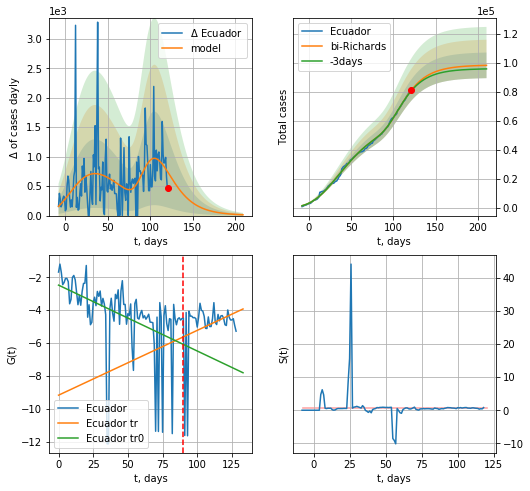

Ecuador data at: 2020-07-27
+3 day model MAPE: 0.006316
model: bi-Richards
coeffs: [3.80748142e+04 5.22645969e+00 2.77607477e+01 1.08891170e-02]
rational stdev: 0.090154
forecast at the end of period: +89 days
	 deltaDaycases: 13
	 total cases: 98323 ± 8864
	 total death: 6701 ± 1812
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.212676
 intercept: -2.477881
 slope: -0.040077
trend coefficient of determination: 0.075183
 intercept: -9.173567
 slope: 0.039435


In [1754]:
vL = 90+20
x = forecastRR("Ecuador",dfED[20:vL-20],d1,100*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Ecuador",dfED[20:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


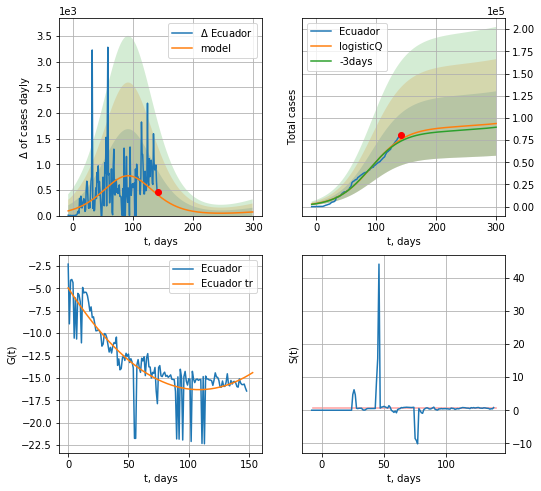

Ecuador data at: 2020-07-27
+3 day model MAPE: 0.026542
model: logisticQ
coeffs: [ 8.91478984e+04  1.23221839e-07  9.20506332e+01 -2.81883715e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.387552
forecast at the end of period: +159 days
	 deltaDaycases: 70
	 total cases: 93683 ± 36307
	 total death: 6385 ± 7423
trend coefficient of determination: 0.736258
 intercept_: -4.959368140627406
 coeffs_: [ 0.         -0.20908125  0.00096267]


In [1755]:
x = forecastRRR("Ecuador",dfED[:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

FI
           date   cases  active  death
149 2020-07-23  7372.0     124  328.0
150 2020-07-24  7380.0     131  329.0
151 2020-07-25  7388.0     139  329.0
152 2020-07-26  7393.0     144  329.0
153 2020-07-27  7398.0     149  329.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


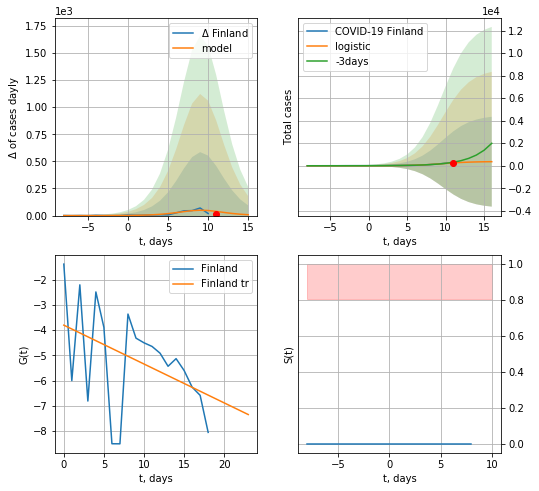

Finland data at: 2020-07-27
+3 day model MAPE: 0.3536795630191518
model: logistic
coeffs:  [373.20900186   0.53490302   9.59276199]
rational stdev:  11.028448708024662
forecast at the end of period: +5 days
	 deltaDaycases:  7
	 total cases:  361 ± 3986
	 total death:  16 ± 529
trend coefficient of determination: 0.182614
 intercept: -3.802910
 slope: -0.153962


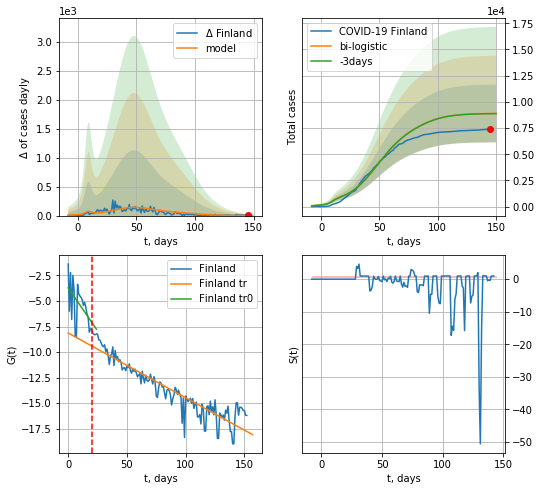

Finland data at: 2020-07-27
+3 day model MAPE: 0.001682184480218987
model: bi-logistic
coeffs:  [6.82531566e+03 7.98527211e-02 4.74478164e+01] [373.20900186   0.53490302   9.59276199]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.30969273633173533
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  8893 ± 2754
	 total death:  395 ± 366
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.234981
 intercept: -3.717136
 slope: -0.168257
trend coefficient of determination: 0.851134
 intercept: -8.136613
 slope: -0.063464


In [1756]:
dfFI = read_df(pd.DataFrame(),"FI")
vL=20
x = forecast("Finland",dfFI[:vL],d1,7*18-dT)
xx = forecast2("Finland",dfFI[:],d1,18*7-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


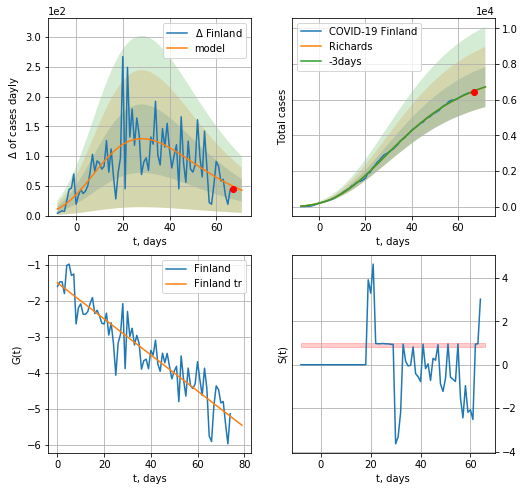

Finland data at: 2020-07-27
+3 day model MAPE: 0.001746
model: Richards
coeffs: [ 7.67975824e+03  2.65375623e+00 -5.92211245e+01  1.73858065e-02]
rational stdev: 0.167365
forecast at the end of period: +5 days
	 deltaDaycases: 42
	 total cases: 6710 ± 1123
	 total death: 298 ± 149
trend coefficient of determination: 0.854396
 intercept: -1.508206
 slope: -0.049971


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


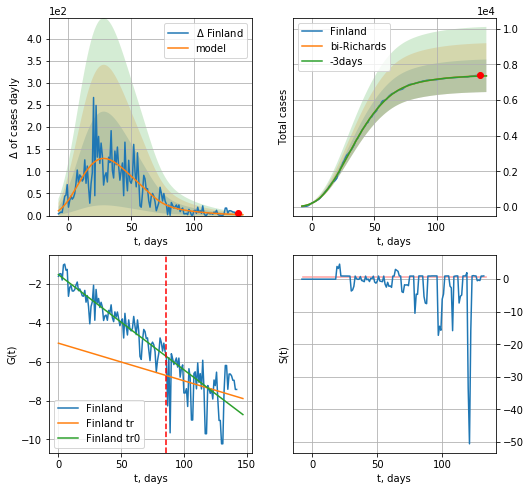

Finland data at: 2020-07-27
+3 day model MAPE: 0.000959
model: bi-Richards
coeffs: [-2.73997283e+02  5.68629577e+00  2.61573833e+01  1.43995456e-02]
rational stdev: 0.124234
forecast at the end of period: +5 days
	 deltaDaycases: 1
	 total cases: 7362 ± 914
	 total death: 327 ± 121
bi-Richards approximation splitting point: 86
trend coefficient of determination: 0.876489
 intercept: -1.515117
 slope: -0.049021
trend coefficient of determination: 0.071703
 intercept: -5.046084
 slope: -0.019377


In [1757]:
vL = 86 + 10
x = forecastRR("Finland",dfFI[10:vL-10],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Finland",dfFI[10:],d1,18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-10)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


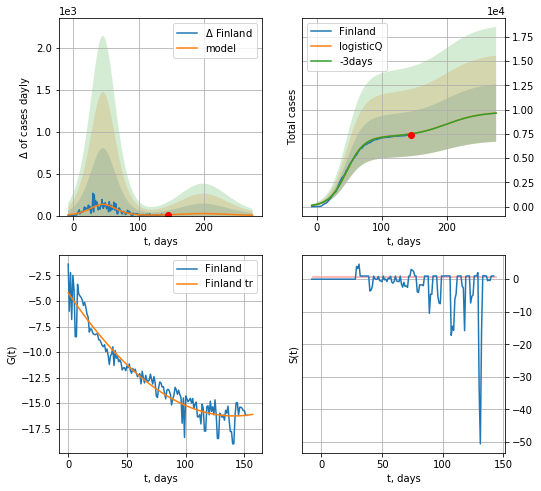

Finland data at: 2020-07-27
+3 day model MAPE: 0.001440
model: logisticQ
coeffs: [ 7.21746324e+03  2.91046469e-07  4.57820866e+01 -2.56991657e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.306934
forecast at the end of period: +131 days
	 deltaDaycases: 4
	 total cases: 9637 ± 2958
	 total death: 428 ± 394
trend coefficient of determination: 0.923840
 intercept_: -4.191305359206137
 coeffs_: [ 0.         -0.17115666  0.00060659]


In [1758]:
x = forecastRRR("Finland",dfFI[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

BL
           date  cases  active  death
135 2020-07-23   9853  4493.0  329.0
136 2020-07-24  10123  4534.0  337.0
137 2020-07-25  10312  4668.0  338.0
138 2020-07-26  10427  4732.0  340.0
139 2020-07-27  10621  4689.0  347.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


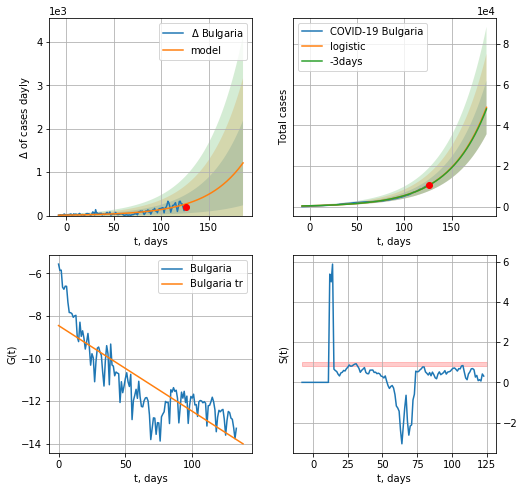

Bulgaria data at: 2020-07-27
+3 day model MAPE: 0.006371535397515422
model: logistic
coeffs:  [1.62197818e+07 2.51950359e-02 4.17253813e+02]
scenario coeffs:  [0.25, 1.0, 3.5]
rational stdev:  0.2700945032153947
forecast at the end of period: +61 days
	 deltaDaycases:  1212
	 total cases:  48896 ± 13206
	 total death:  1597 ± 1294
trend coefficient of determination: 0.697800
 intercept: -8.447691
 slope: -0.040244


In [1759]:
dfBL = read_df(pd.DataFrame(),"BL").fillna(0)
try:
    x = forecast('Bulgaria',dfBL[5:],d1,26*7-dT,shift=1.0,addpred=True,xcoef=[0.25,1.,3.5])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


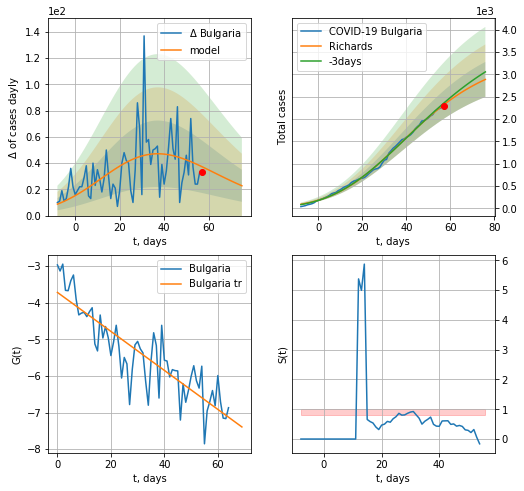

Bulgaria data at: 2020-07-27
+3 day model MAPE: 0.017233
model: Richards
coeffs: [3.47700846e+03 1.26494247e-01 1.24704401e+01 3.39632264e-01]
rational stdev: 0.135837
forecast at the end of period: +19 days
	 deltaDaycases: 22
	 total cases: 2886 ± 392
	 total death: 94 ± 38
trend coefficient of determination: 0.758376
 intercept: -3.716233
 slope: -0.053312


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


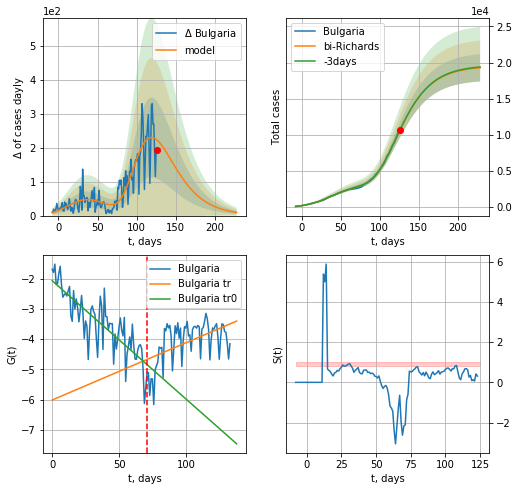

Bulgaria data at: 2020-07-27
+3 day model MAPE: 0.000151
model: bi-Richards
coeffs: [1.60388880e+04 2.34825777e+00 1.37901753e+01 1.64523818e-02]
rational stdev: 0.097925
forecast at the end of period: +103 days
	 deltaDaycases: 9
	 total cases: 19277 ± 1887
	 total death: 629 ± 184
bi-Richards approximation splitting point: 71
trend coefficient of determination: 0.676420
 intercept: -2.070769
 slope: -0.039088
trend coefficient of determination: 0.264745
 intercept: -6.016933
 slope: 0.018918


In [1760]:
vL = 71+5
x = forecastRR('Bulgaria',dfBL[5:vL-5],d1,20*7-dT,shift=1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Bulgaria',dfBL[5:],d1,32*7-dT,x,shift=1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


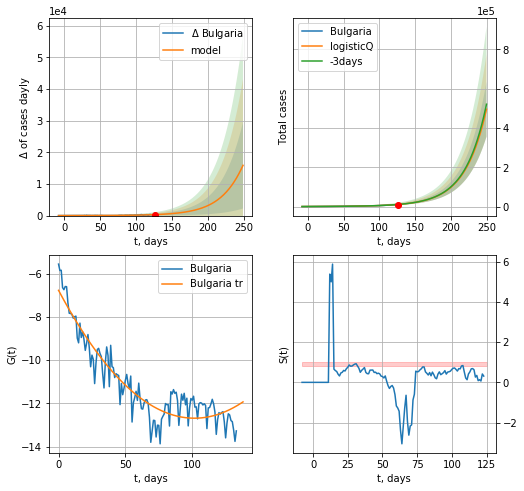

Bulgaria data at: 2020-07-27
+3 day model MAPE: 0.003038
model: logisticQ
coeffs: [ 5.86880492e+06  3.18021079e-05  3.13489487e+02 -9.30228190e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.281727
forecast at the end of period: +124 days
	 deltaDaycases: 15870
	 total cases: 495787 ± 139676
	 total death: 16197 ± 13689
trend coefficient of determination: 0.866638
 intercept_: -6.773600046284857
 coeffs_: [ 0.         -0.11634063  0.00057216]


In [1761]:
x = forecastRRR('Bulgaria',dfBL[5:],d1,35*7-dT,shift=1.0,addpred=True,xcoef=koreaCoeffs)

TH
           date   cases  active  death
147 2020-07-23  3279.0   114.0   58.0
148 2020-07-24  3282.0   115.0   58.0
149 2020-07-25  3291.0   124.0   58.0
150 2020-07-26  3295.0   126.0   58.0
151 2020-07-27  3297.0   128.0   58.0


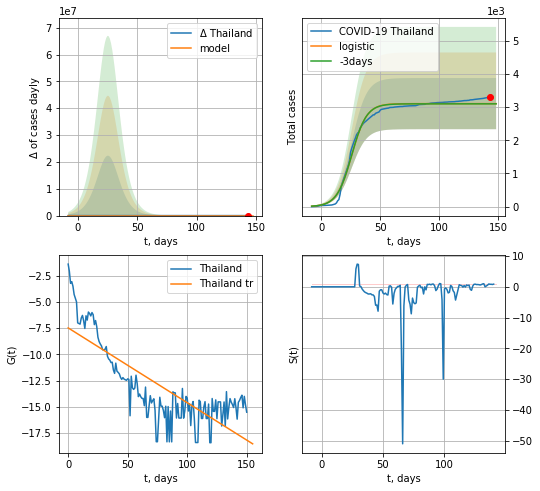

Thailand data at: 2020-07-27
+3 day model MAPE: 0.0021137732079400348
model: logistic
coeffs:  [3.10403731e+03 1.58406939e-01 2.58907470e+01]
rational stdev:  0.24822417150051998
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  3104 ± 770
	 total death:  54 ± 40
trend coefficient of determination: 0.642241
 intercept: -7.470253
 slope: -0.071326


In [1762]:
dfTH = read_df(pd.DataFrame(),"TH")
dfTH = dfTH.fillna(0)
try:
    x = forecast("Thailand",dfTH[:],d1,18*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])
except:
    print("Exception occurs")
#xx = forecast2("Thailand",dfTH[:],d1,8*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

In [1763]:
#x = forecastRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


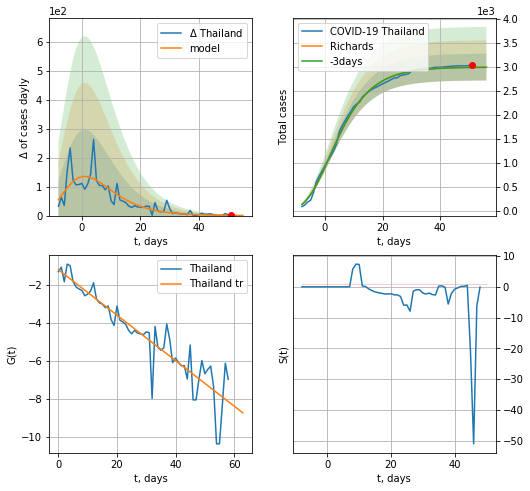

Thailand data at: 2020-07-27
+3 day model MAPE: 0.001958
model: Richards
coeffs: [ 2.99625224e+03  1.57427901e+01 -3.79340304e+01  7.81992540e-03]
rational stdev: 0.093292
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 2992 ± 279
	 total death: 52 ± 14
trend coefficient of determination: 0.845848
 intercept: -1.208254
 slope: -0.119672


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


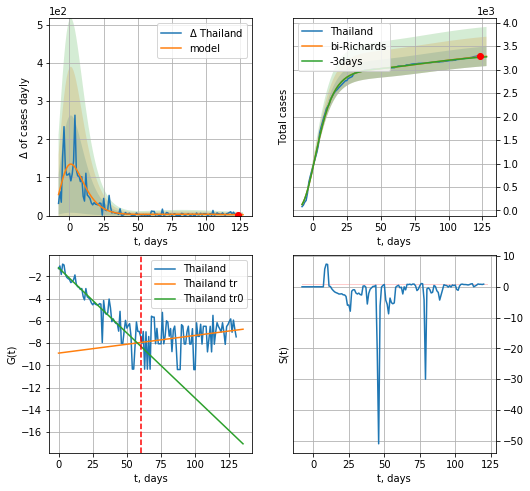

Thailand data at: 2020-07-27
+3 day model MAPE: 0.003188
model: bi-Richards
coeffs: [ 3.88609545e+02  7.91832600e+00 -1.26015038e+02  3.42652983e-03]
rational stdev: 0.063530
forecast at the end of period: +5 days
	 deltaDaycases: 2
	 total cases: 3285 ± 208
	 total death: 57 ± 10
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.843038
 intercept: -1.219866
 slope: -0.117422
trend coefficient of determination: 0.058245
 intercept: -8.902323
 slope: 0.015943


In [1764]:
vL = 80
x = forecastRR("Thailand",dfTH[20:vL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Thailand",dfTH[20:],d1,18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


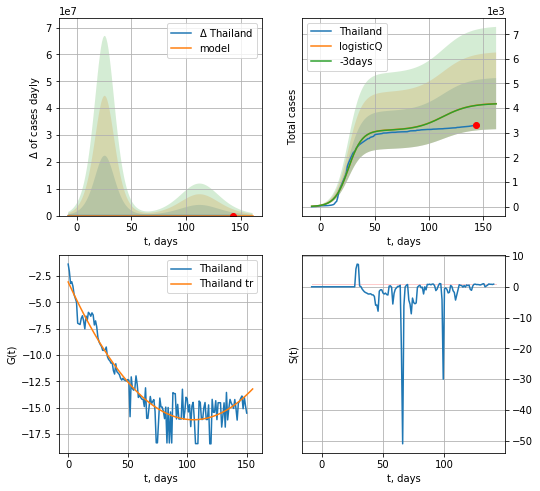

Thailand data at: 2020-07-27
+3 day model MAPE: 0.001493
model: logisticQ
coeffs: [ 3.10404264e+03  4.53857816e-07  2.58913718e+01 -3.48873847e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.248370
forecast at the end of period: +19 days
	 deltaDaycases: 1
	 total cases: 4181 ± 1038
	 total death: 73 ± 54
trend coefficient of determination: 0.908958
 intercept_: -3.0786558426172537
 coeffs_: [ 0.         -0.24817106  0.00117897]


In [1765]:
x = forecastRRR("Thailand",dfTH[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

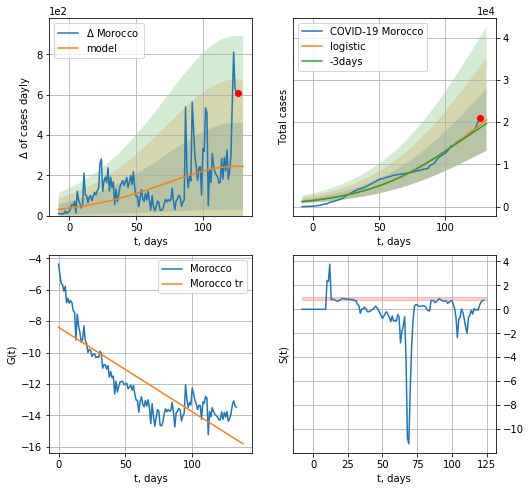

Morocco data at: 2020-07-27
+3 day model MAPE: 0.03807153778336858
model: logistic
coeffs:  [3.85082982e+04 2.54266206e-02 1.25772001e+02]
rational stdev:  0.3567675669668349
forecast at the end of period: +5 days
	 deltaDaycases:  243
	 total cases:  20531 ± 7325
	 total death:  310 ± 331
trend coefficient of determination: 0.707226
 intercept: -8.391027
 slope: -0.053793


In [1766]:
x = forecast("Morocco",dfMR[5:],d1,18*7-dT)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


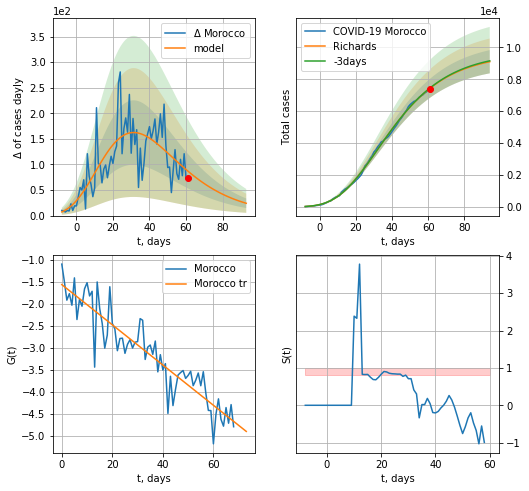

Morocco data at: 2020-07-27
+3 day model MAPE: 0.002855
model: Richards
coeffs: [ 9.62195156e+03  2.25629624e+00 -5.19455517e+01  2.05552972e-02]
rational stdev: 0.079912
forecast at the end of period: +33 days
	 deltaDaycases: 24
	 total cases: 9099 ± 727
	 total death: 137 ± 32
trend coefficient of determination: 0.846110
 intercept: -1.563215
 slope: -0.045646


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


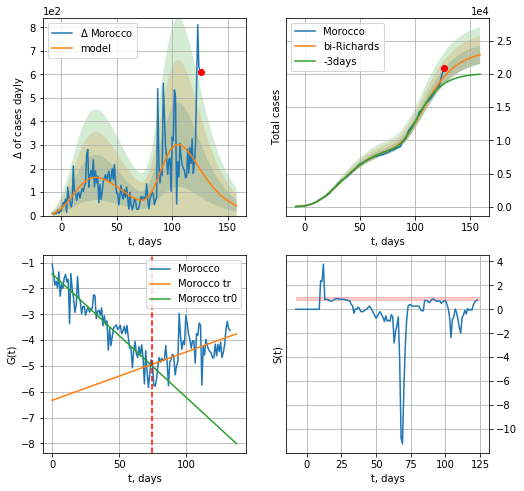

Morocco data at: 2020-07-27
+3 day model MAPE: 0.060046
model: bi-Richards
coeffs: [1.40254234e+04 6.35623564e+00 2.22521185e+01 8.82912531e-03]
rational stdev: 0.061108
forecast at the end of period: +33 days
	 deltaDaycases: 41
	 total cases: 22902 ± 1399
	 total death: 346 ± 63
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.860020
 intercept: -1.439928
 slope: -0.047643
trend coefficient of determination: 0.231998
 intercept: -6.329108
 slope: 0.018654


In [1767]:
vL = 75 + 5
x = forecastRR("Morocco",dfMR[5:vL-5],d1,22*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Morocco",dfMR[5:],d1,22*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


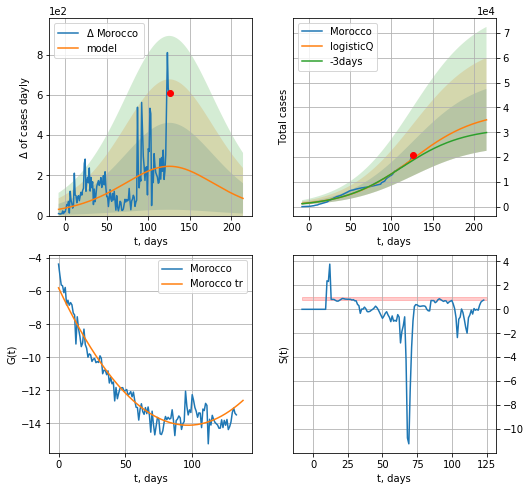

Morocco data at: 2020-07-27
+3 day model MAPE: 0.037008
model: logisticQ
coeffs: [ 3.83835860e+04  3.29581114e-07  1.25522471e+02 -7.72029244e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.356785
forecast at the end of period: +89 days
	 deltaDaycases: 85
	 total cases: 35022 ± 12495
	 total death: 529 ± 566
trend coefficient of determination: 0.937108
 intercept_: -5.797395680868023
 coeffs_: [ 0.         -0.17168723  0.00088643]


In [1768]:
x = forecastRRR("Morocco",dfMR[5:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

RM
           date    cases   active   death
148 2020-07-23  41275.0  14287.0  2126.0
149 2020-07-24  42394.0  14895.0  2150.0
150 2020-07-25  43678.0  16140.0  2165.0
151 2020-07-26  44798.0  16968.0  2187.0
152 2020-07-27  45902.0  17902.0  2206.0


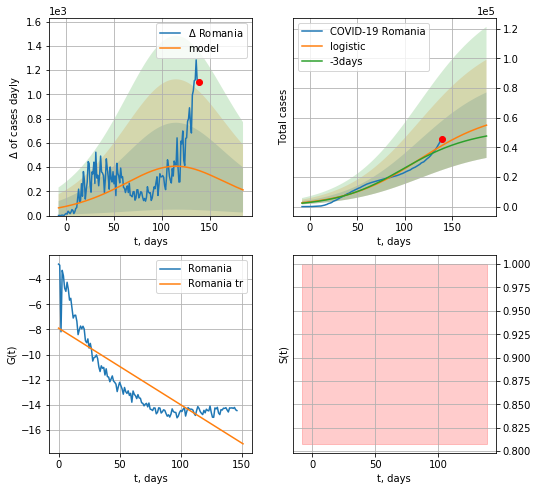

Romania data at: 2020-07-27
+3 day model MAPE: 0.06268242142487798
model: logistic
coeffs:  [6.05110171e+04 2.60756385e-02 1.14142619e+02]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.40222435903841114
forecast at the end of period: +47 days
	 deltaDaycases:  211
	 total cases:  54894 ± 22079
	 total death:  2638 ± 3183
trend coefficient of determination: 0.700849
 intercept: -7.899134
 slope: -0.060988


In [1769]:
dfRM = read_df(pd.DataFrame(),"RM")
x = forecast("Romania",dfRM[5:],d1,24*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


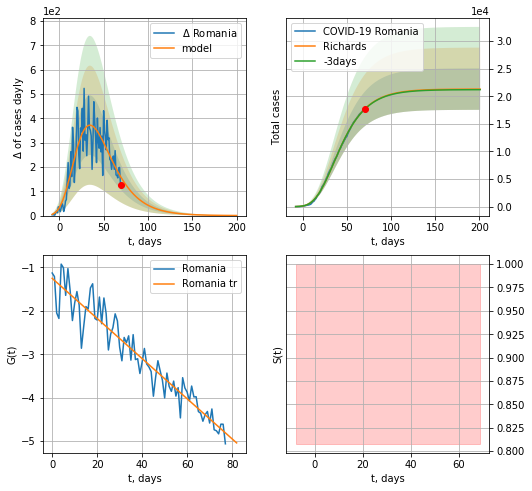

Romania data at: 2020-07-27
+3 day model MAPE: 0.002252
model: Richards
coeffs: [ 2.13019559e+04  3.77233819e+00 -5.65502366e+01  1.26521698e-02]
rational stdev: 0.176385
forecast at the end of period: +131 days
	 deltaDaycases: 0
	 total cases: 21294 ± 3755
	 total death: 1023 ± 541
trend coefficient of determination: 0.908550
 intercept: -1.252366
 slope: -0.046196


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


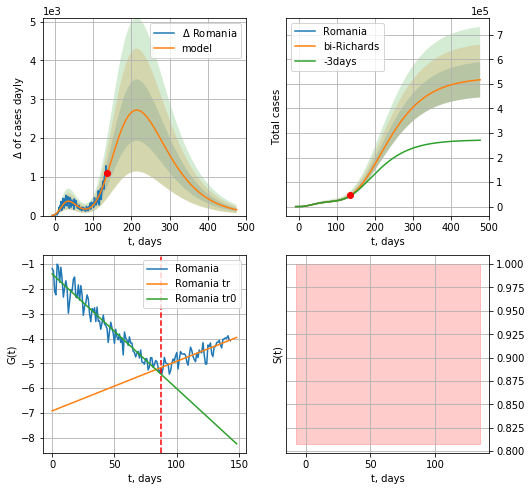

Romania data at: 2020-07-27
+3 day model MAPE: 0.022110
model: bi-Richards
coeffs: [ 5.05335589e+05  4.41259111e-01 -1.34698885e+01  3.37293400e-02]
rational stdev: 0.138906
forecast at the end of period: +341 days
	 deltaDaycases: 148
	 total cases: 516619 ± 71761
	 total death: 24828 ± 10346
bi-Richards approximation splitting point: 87
trend coefficient of determination: 0.928676
 intercept: -1.394759
 slope: -0.046338
trend coefficient of determination: 0.683201
 intercept: -6.922651
 slope: 0.020039


In [1770]:
vL = 87+8
x = forecastRR("Romania",dfRM[8:vL-8],d1,36*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Romania",dfRM[8:],d1,66*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL = vL-8)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


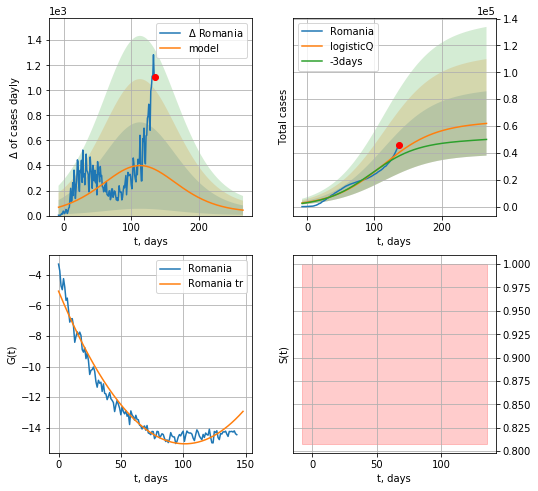

Romania data at: 2020-07-27
+3 day model MAPE: 0.069116
model: logisticQ
coeffs: [ 6.19824119e+04  1.25761351e-07  1.13087495e+02 -2.03775706e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.386865
forecast at the end of period: +131 days
	 deltaDaycases: 43
	 total cases: 61941 ± 23963
	 total death: 2976 ± 3453
trend coefficient of determination: 0.966983
 intercept_: -5.069753860757647
 coeffs_: [ 0.         -0.19721433  0.00097343]


In [1771]:
xx = forecastRRR("Romania",dfRM[8:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

In [1772]:
#x = forecastRRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.35/4,.5,2.2,1])

EU
           date    cases  active     death
166 2020-07-23  1396845  180873  135495.0
167 2020-07-24  1405041  182197  135602.0
168 2020-07-25  1409261  184568  135649.0
169 2020-07-26  1412868  184900  135693.0
170 2020-07-27  1425951  188395  135765.0


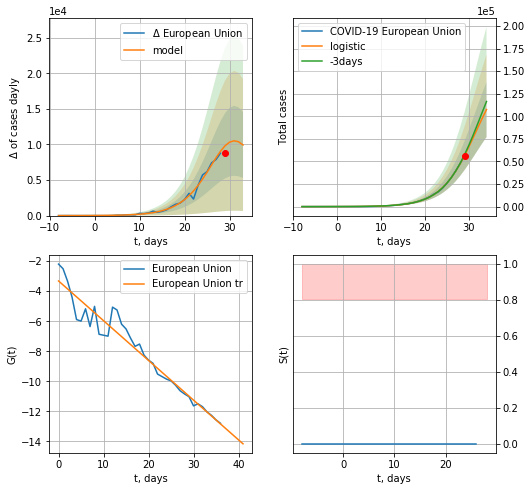

European Union data at: 2020-07-27
+3 day model MAPE: 0.026537311351207946
model: logistic
coeffs:  [1.65818575e+05 2.54045102e-01 3.15946527e+01]
rational stdev:  0.28380142451786633
forecast at the end of period: +5 days
	 deltaDaycases:  9926
	 total cases:  107480 ± 30503
	 total death:  10233 ± 8712
trend coefficient of determination: 0.942451
 intercept: -3.318380
 slope: -0.264437


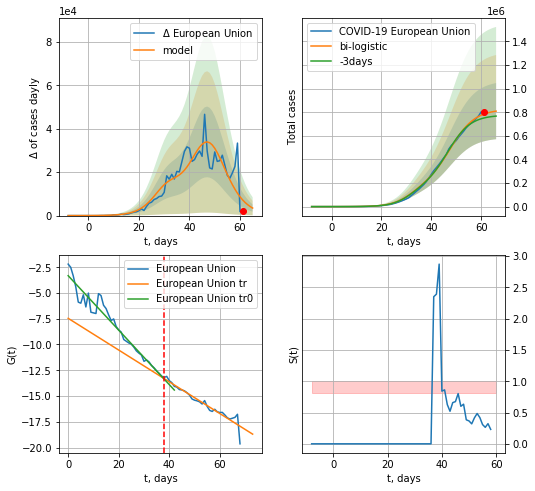

European Union data at: 2020-07-27
+3 day model MAPE: 0.04651886048168725
model: bi-logistic
coeffs:  [6.59401209e+05 2.01830792e-01 4.76685424e+01] [1.65818575e+05 2.54045102e-01 3.15946527e+01]
rational stdev:  0.2940888574557057
forecast at the end of period: +5 days
	 deltaDaycases:  3461
	 total cases:  809281 ± 238000
	 total death:  77051 ± 67979
bi-logistic approximation splitting point: 38
trend0 coefficient of determination: 0.946588
 intercept: -3.319965
 slope: -0.264305
trend coefficient of determination: 0.919570
 intercept: -7.459861
 slope: -0.154008


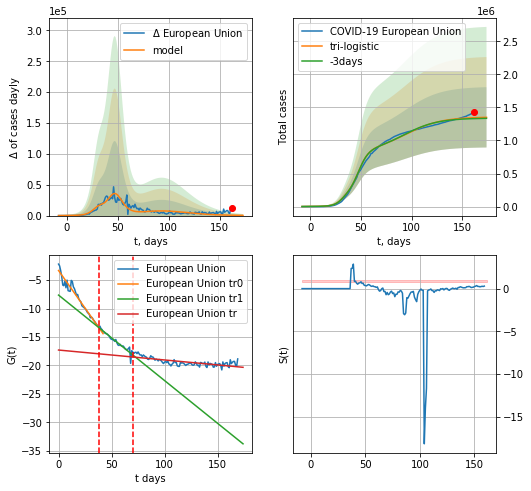

European Union data at: 2020-07-27
+3 day model MAPE: 0.010382091075909051
model: tri-logistic
coeffs:  [5.30581330e+05 5.69071865e-02 9.38096476e+01] [1.65818575e+05 2.54045102e-01 3.15946527e+01 6.59401209e+05
 2.01830792e-01 4.76685424e+01]
forecast rational stdev:  0.33763314186543825
forecast at the end of period: +12 days
	 deltaDaycases:  317
	 total cases:  1350326 ± 455914
	 total death:  128564 ± 130222
tri-logistic approximation splitting points: 38,70
trend0 coefficient of determination: 0.946588
 intercept: -3.319965
 slope: -0.264305
trend1 coefficient of determination: 0.917507
 intercept: -7.641441
 slope: -0.150225
trend coefficient of determination: 0.517461
 intercept: -17.298859
 slope: -0.017438


In [1773]:
vL=38
vL1=70
dfEU = read_df(pd.DataFrame(),"EU")
x = forecast("European Union",dfEU[:vL],d1,18*7-dT)
xx = forecast2("European Union",dfEU[:vL1],d1,18*7-dT,x,vL=38,addpred=False,xcoef=[0.25,1.,1.5])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("European Union",dfEU,d1,19*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


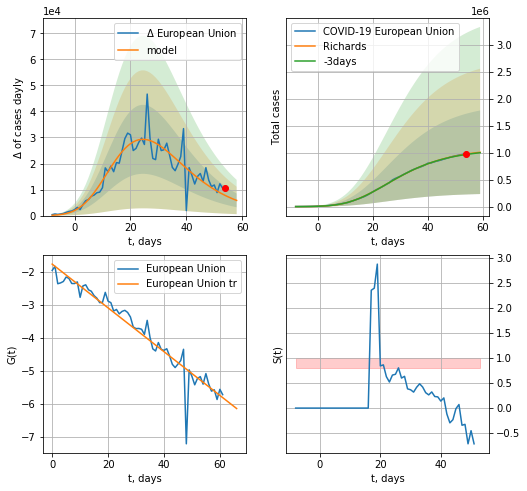

European Union data at: 2020-07-27
+3 day model MAPE: 0.007558
model: Richards
coeffs: [ 1.08235964e+06  8.91287836e-01 -6.99318002e+00  8.61027305e-02]
rational stdev: 0.768622
forecast at the end of period: +5 days
	 deltaDaycases: 5832
	 total cases: 1006023 ± 773251
	 total death: 95783 ± 220862
trend coefficient of determination: 0.920525
 intercept: -1.769238
 slope: -0.066303


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


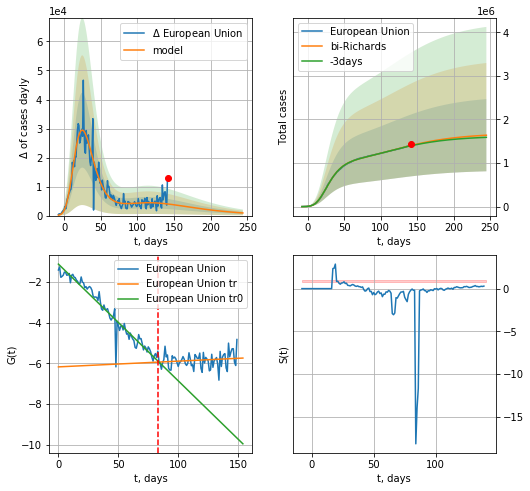

European Union data at: 2020-07-27
+3 day model MAPE: 0.005631
model: bi-Richards
coeffs: [ 6.03241735e+05  2.09884058e+00 -1.16752889e+02  9.44293438e-03]
rational stdev: 0.505489
forecast at the end of period: +103 days
	 deltaDaycases: 905
	 total cases: 1638405 ± 828196
	 total death: 155992 ± 236556
bi-Richards approximation splitting point: 83
trend coefficient of determination: 0.943463
 intercept: -1.114936
 slope: -0.057424
trend coefficient of determination: 0.022304
 intercept: -6.172088
 slope: 0.002814


In [1774]:
vL = 83+20
x = forecastRR("European Union",dfEU[20:vL-20],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("European Union",dfEU[20:],d1,32*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


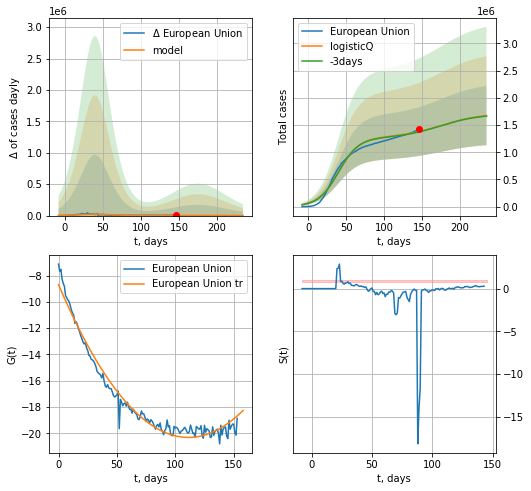

European Union data at: 2020-07-27
+3 day model MAPE: 0.005245
model: logisticQ
coeffs: [ 1.26781850e+06  1.04168673e-07  4.01977394e+01 -7.13028092e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.324990
forecast at the end of period: +89 days
	 deltaDaycases: 1487
	 total cases: 1673424 ± 543845
	 total death: 159326 ± 155337
trend coefficient of determination: 0.972603
 intercept_: -8.688429285324059
 coeffs_: [ 0.         -0.20885882  0.00093837]


In [1775]:
x = forecastRRR("European Union",dfEU[16:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

In [ ]:
#x = forecastQR("European Union",dfEU[20:],d1,16*7-dT,addpred=True,xcoef=QRkoreaCoeffs)

In [ ]:
#x = forecastRR("Romania",dfRM[5:],d1,14*7-dT)

In [ ]:
#x = forecastRRR("European Union",dfEU[:],d1,8*7-dT)

In [ ]:
#x = forecastRRR("Romania",dfRM[5:],d1,18*7-dT,addpred=True,xcoef=[0.35,.5,3.,1.])

In [ ]:
#dfIC[:]

IC
           date   cases  active  death
144 2020-07-23  1941.0       8   10.0
145 2020-07-24  1943.0      10   10.0
146 2020-07-25  1943.5      10   10.0
147 2020-07-26  1947.0      14   10.0
148 2020-07-27  1954.0      21   10.0


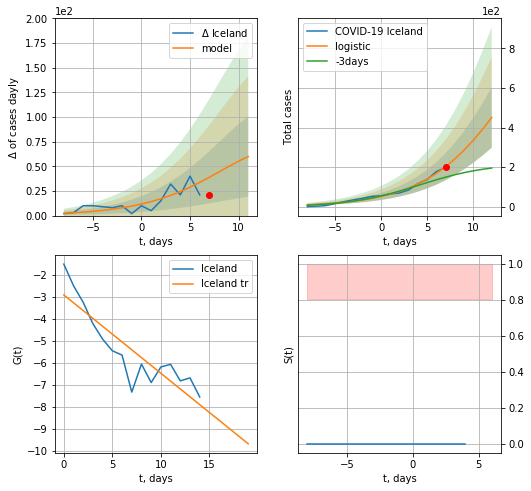

Iceland data at: 2020-07-27
+3 day model MAPE: 0.4922951461414269
model: logistic
coeffs:  [1.27194861e+03 2.12945173e-01 1.48141483e+01]
rational stdev:  0.3377978270267634
forecast at the end of period: +5 days
	 deltaDaycases:  59
	 total cases:  450 ± 152
	 total death:  2 ± 2
trend coefficient of determination: 0.778766
 intercept: -2.904405
 slope: -0.356109


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp


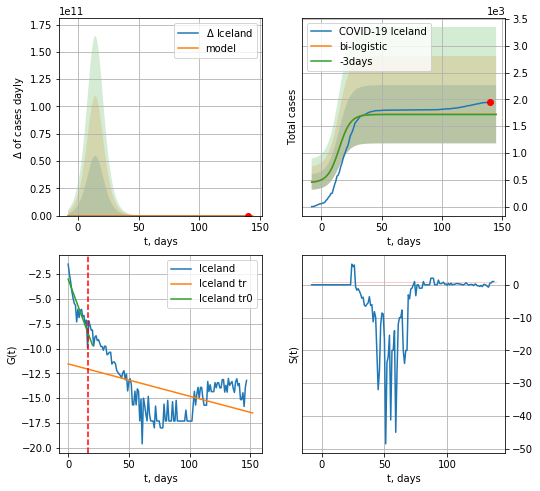

Iceland data at: 2020-07-27
+3 day model MAPE: 0.003193013076182989
model: bi-logistic
coeffs:  [424.95898723  -2.31017725 167.09253875] [1.27194861e+03 2.12945173e-01 1.48141483e+01]
scenario coeffs:  [0.0625, 1.0, 2]
rational stdev:  0.31488433698004864
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  1723 ± 542
	 total death:  9 ± 8
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.772657
 intercept: -3.017482
 slope: -0.331878
trend coefficient of determination: 0.212881
 intercept: -11.547958
 slope: -0.032502


In [1781]:
dfIC = read_df(pd.DataFrame(),"IC")
vL=16
try:
    x = forecast("Iceland",dfIC[:vL],d1,18*7-dT,addpred=False,xcoef=[0.25/2,1.,2])
    xx = forecast2("Iceland",dfIC[:],d1,18*7-dT,x,addpred=True,xcoef=[0.25/4,1.,2],vL=vL)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


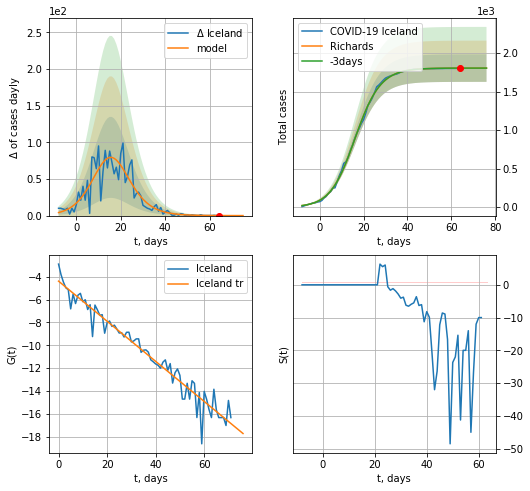

Iceland data at: 2020-07-27
+3 day model MAPE: 0.000202
model: Richards
coeffs: [1.80491931e+03 1.94078850e-01 1.51687371e+01 8.72782733e-01]
rational stdev: 0.098882
forecast at the end of period: +12 days
	 deltaDaycases: 0
	 total cases: 1804 ± 178
	 total death: 9 ± 2
trend coefficient of determination: 0.947111
 intercept: -4.382361
 slope: -0.175730


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


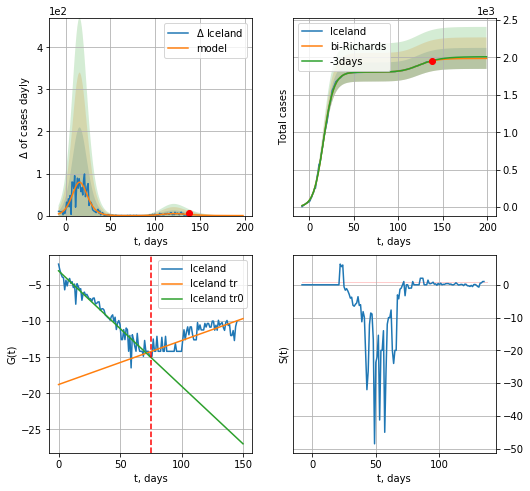

Iceland data at: 2020-07-27
+3 day model MAPE: 0.002290
model: bi-Richards
coeffs: [1.81978179e+02 1.54222816e-01 1.15214690e+02 5.83695096e-01]
rational stdev: 0.070618
forecast at the end of period: +61 days
	 deltaDaycases: 0
	 total cases: 1986 ± 140
	 total death: 10 ± 2
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.940887
 intercept: -3.014099
 slope: -0.159893
trend coefficient of determination: 0.615525
 intercept: -18.779957
 slope: 0.060903


In [1782]:
vL = 75+2
x = forecastRR("Iceland",dfIC[2:vL-2],d1,19*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Iceland",dfIC[2:],d1,26*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-2)
#x = forecastRRR("Iceland",dfIC[:20],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


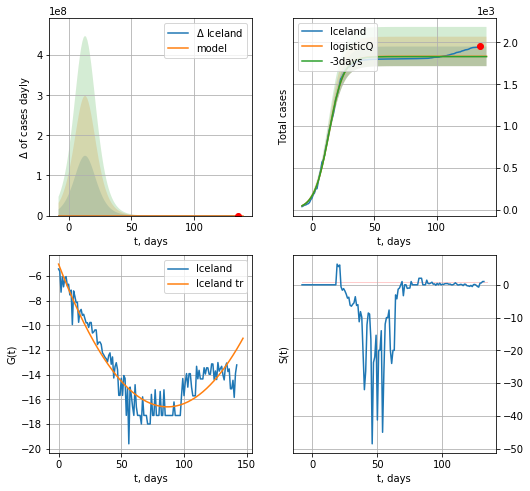

Iceland data at: 2020-07-27
+3 day model MAPE: 0.001934
model: logisticQ
coeffs: [ 1.83393659e+03  2.02523025e-06  1.36249121e+01 -8.39397670e+04]
rational stdev: 0.064034
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 1833 ± 117
	 total death: 9 ± 1
trend coefficient of determination: 0.870956
 intercept_: -5.0488386519964426
 coeffs_: [ 0.         -0.26614769  0.00153281]


In [1783]:
x = forecastRRR("Iceland",dfIC[5:],d1,18*7-dT,addpred=False,xcoef=[0.35/6,.5,4.,1.])

PM
           date  cases   active   death
135 2020-07-23  56817  23780.0  1209.0
136 2020-07-24  57993  24039.0  1250.0
137 2020-07-25  58864  24161.0  1275.0
138 2020-07-26  60296  24871.0  1294.0
139 2020-07-27  61442  25034.0  1322.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


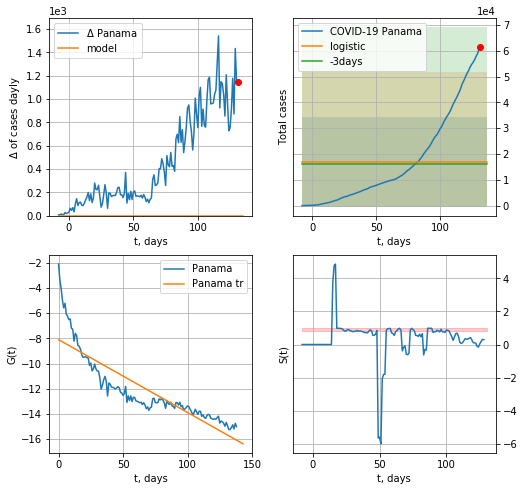

Panama data at: 2020-07-27
+3 day model MAPE: 0.05883004628573631
model: logistic
coeffs:  [ 1.70188071e+04 -1.44170467e+01  3.69265306e+02]
rational stdev:  1.0231741059230266
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  17018 ± 17413
	 total death:  366 ± 1123
trend coefficient of determination: 0.759484
 intercept: -8.099942
 slope: -0.057876


In [1784]:
dfPM = read_df(pd.DataFrame(),"PM").fillna(0)
x = forecast("Panama",dfPM[:],d1,18*7-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


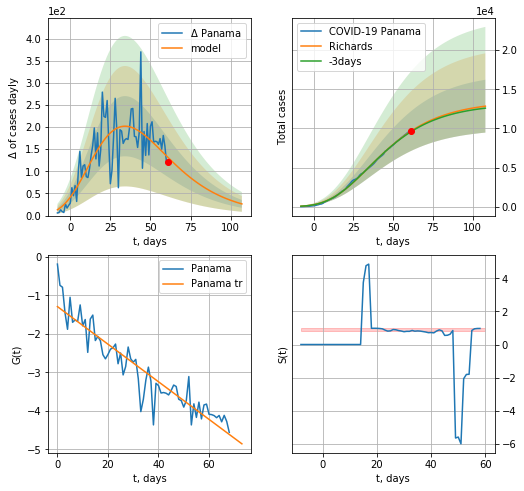

Panama data at: 2020-07-27
+3 day model MAPE: 0.008202
model: Richards
coeffs: [ 1.34884806e+04  2.34095265e+00 -6.38236986e+01  1.75426471e-02]
rational stdev: 0.263123
forecast at the end of period: +47 days
	 deltaDaycases: 26
	 total cases: 12841 ± 3379
	 total death: 276 ± 217
trend coefficient of determination: 0.871686
 intercept: -1.291509
 slope: -0.048815


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


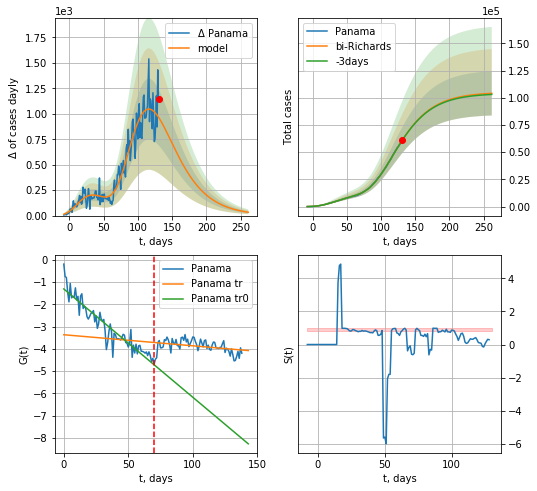

Panama data at: 2020-07-27
+3 day model MAPE: 0.001742
model: bi-Richards
coeffs: [ 9.17273911e+04  1.57464306e+00 -1.05703398e+01  1.95488033e-02]
rational stdev: 0.195370
forecast at the end of period: +131 days
	 deltaDaycases: 32
	 total cases: 104155 ± 20348
	 total death: 2241 ± 1313
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.874631
 intercept: -1.307971
 slope: -0.048672
trend coefficient of determination: 0.113442
 intercept: -3.366237
 slope: -0.004969


In [1785]:
vL = 70
x = forecastRR("Panama",dfPM[:vL],d1,24*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Panama",dfPM[:],d1,36*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


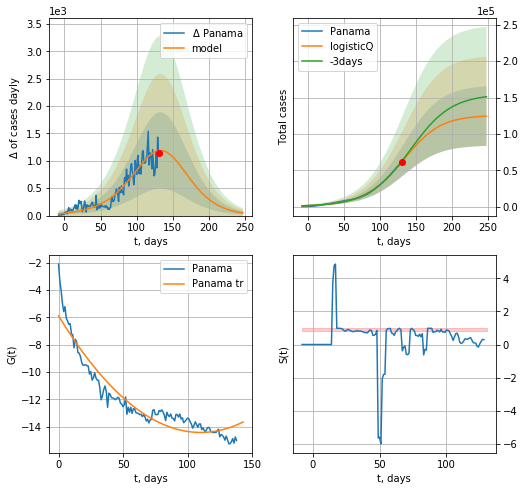

Panama data at: 2020-07-27
+3 day model MAPE: 0.016139
model: logisticQ
coeffs: [ 1.25277584e+05  2.90626377e-05  1.31366721e+02 -1.17154670e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.328784
forecast at the end of period: +117 days
	 deltaDaycases: 48
	 total cases: 124426 ± 40909
	 total death: 2677 ± 2640
trend coefficient of determination: 0.904010
 intercept_: -5.883372368667361
 coeffs_: [ 0.         -0.15495342  0.00070346]


In [1786]:
x = forecastRRR("Panama",dfPM[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

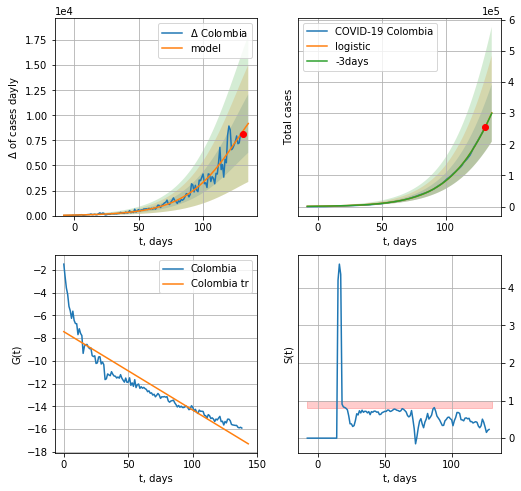

Colombia data at: 2020-07-27
+3 day model MAPE: 0.0025500626108873985
model: logistic
coeffs:  [1.06637238e+06 4.29232706e-02 1.57753302e+02]
rational stdev:  0.3059911210439073
forecast at the end of period: +5 days
	 deltaDaycases:  9183
	 total cases:  300898 ± 92072
	 total death:  10272 ± 9429
trend coefficient of determination: 0.853593
 intercept: -7.441051
 slope: -0.068914


In [1787]:
dfCB = dfCB.fillna(0)
x = forecast("Colombia",dfCB[:],d1,18*7-dT)

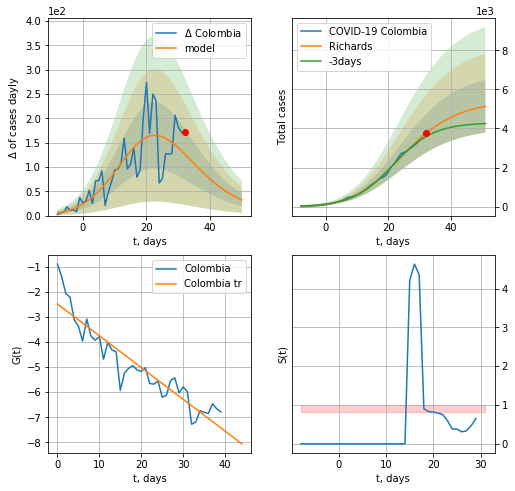

Colombia data at: 2020-07-27
+3 day model MAPE: 0.053959
model: Richards
coeffs: [5.45324012e+03 2.23852503e-01 1.50938863e+01 4.47627095e-01]
rational stdev: 0.263661
forecast at the end of period: +19 days
	 deltaDaycases: 32
	 total cases: 5133 ± 1353
	 total death: 175 ± 138
trend coefficient of determination: 0.864435
 intercept: -2.485430
 slope: -0.126591


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


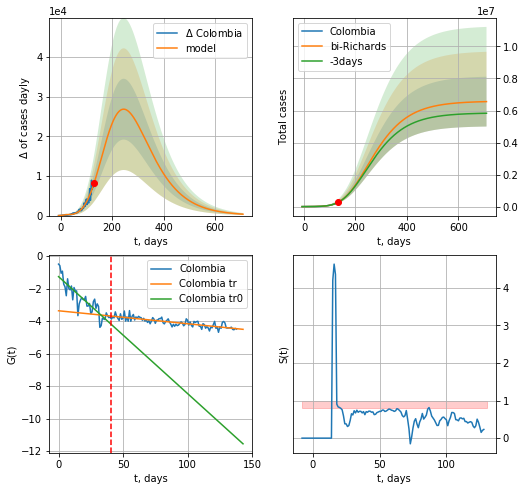

Colombia data at: 2020-07-27
+3 day model MAPE: 0.005769
model: bi-Richards
coeffs: [6.58059839e+06 1.38464549e-01 3.07208494e+01 8.34740028e-02]
rational stdev: 0.237160
forecast at the end of period: +579 days
	 deltaDaycases: 354
	 total cases: 6555441 ± 1554689
	 total death: 223791 ± 159222
bi-Richards approximation splitting point: 41
trend coefficient of determination: 0.786103
 intercept: -1.266352
 slope: -0.071935
trend coefficient of determination: 0.655901
 intercept: -3.368001
 slope: -0.007978


In [1788]:
vL = 41
x = forecastRR("Colombia",dfCB[:vL],d1,20*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Colombia",dfCB[:],d1,100*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


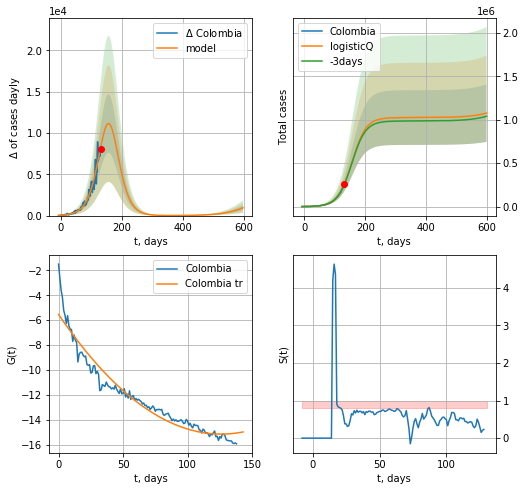

Colombia data at: 2020-07-27
+3 day model MAPE: 0.002994
model: logisticQ
coeffs: [ 1.02475700e+06  3.73637882e-06  1.56230837e+02 -1.14936840e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.307093
forecast at the end of period: +467 days
	 deltaDaycases: 951
	 total cases: 1076371 ± 330545
	 total death: 36745 ± 33852
trend coefficient of determination: 0.938104
 intercept_: -5.537345779226031
 coeffs_: [ 0.         -0.15228963  0.00060417]


In [1789]:
x = forecastRRR("Colombia",dfCB[:],d1,84*7-dT,addpred=True,xcoef=koreaCoeffs)

AR
           date    cases  active   death
141 2020-07-23  25484.0  6991.0  1124.0
142 2020-07-24  26159.0  7654.0  1136.0
143 2020-07-25  26764.0  7542.0  1146.0
144 2020-07-26  27357.0  8114.0  1155.0
145 2020-07-27  27973.0  7973.0  1163.0


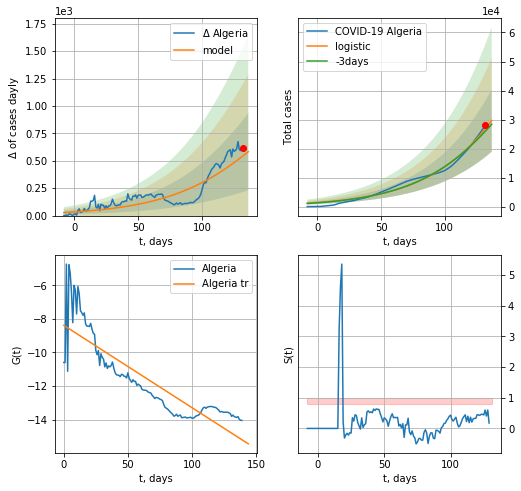

Algeria data at: 2020-07-27
+3 day model MAPE: 0.035550690047147
model: logistic
coeffs:  [1.89224370e+05 2.34832185e-02 2.08601595e+02]
rational stdev:  0.36184999445545496
forecast at the end of period: +5 days
	 deltaDaycases:  583
	 total cases:  29690 ± 10743
	 total death:  1234 ± 1339
trend coefficient of determination: 0.751118
 intercept: -8.381696
 slope: -0.049090


In [1790]:
dfAR = read_df(pd.DataFrame(),"AR")
dfAR = dfAR.fillna(0)
x = forecast("Algeria",dfAR[5:],d1,18*7-dT)
#dfAG

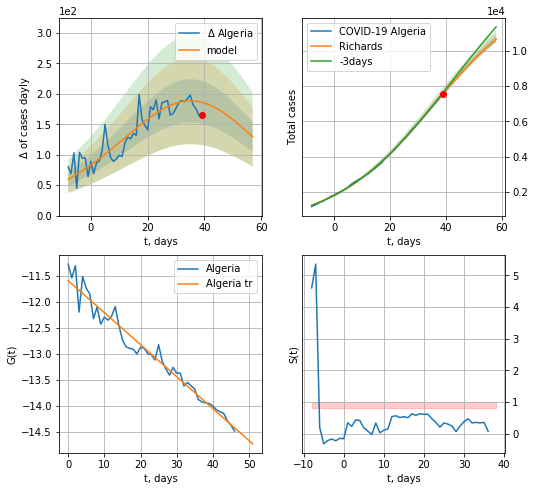

Algeria data at: 2020-07-27
+3 day model MAPE: 0.009853
model: Richards
coeffs: [1.34014715e+04 4.98947140e-02 3.86388173e+01 1.19488229e+00]
rational stdev: 0.015787
forecast at the end of period: +19 days
	 deltaDaycases: 129
	 total cases: 10654 ± 168
	 total death: 442 ± 20
trend coefficient of determination: 0.959635
 intercept: -11.589811
 slope: -0.061720


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


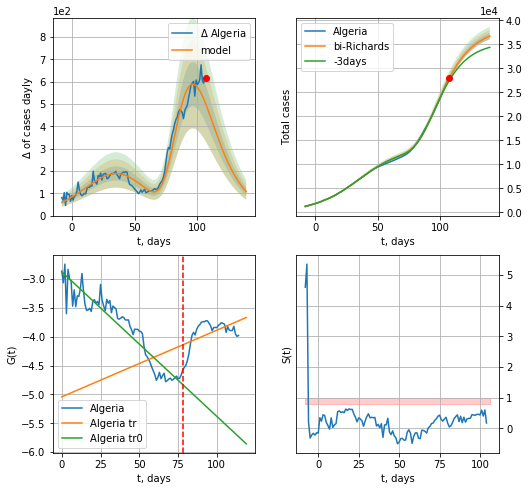

Algeria data at: 2020-07-27
+3 day model MAPE: 0.018708
model: bi-Richards
coeffs: [2.50349640e+04 3.94106355e+00 3.08612594e+01 1.58072400e-02]
rational stdev: 0.017535
forecast at the end of period: +33 days
	 deltaDaycases: 107
	 total cases: 36705 ± 643
	 total death: 1526 ± 80
bi-Richards approximation splitting point: 78
trend coefficient of determination: 0.889371
 intercept: -2.874448
 slope: -0.025050
trend coefficient of determination: 0.287481
 intercept: -5.040890
 slope: 0.011549


In [1791]:
iL = 30
vL = 78+iL
x = forecastRR("Algeria",dfAR[iL:vL-iL],d1,20*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Algeria",dfAR[iL:],d1,22*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


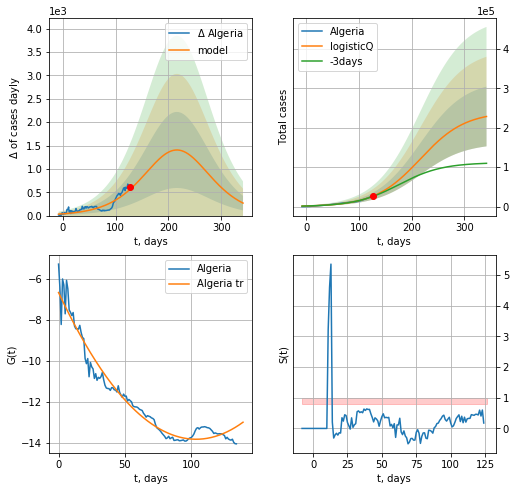

Algeria data at: 2020-07-27
+3 day model MAPE: 0.033331
model: logisticQ
coeffs: [ 2.40152071e+05  1.41389113e-06  2.15864116e+02 -1.63318628e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.331342
forecast at the end of period: +215 days
	 deltaDaycases: 267
	 total cases: 228553 ± 75729
	 total death: 9502 ± 9445
trend coefficient of determination: 0.957518
 intercept_: -6.659388922646631
 coeffs_: [ 0.         -0.13835295  0.00066722]


In [1792]:
x = forecastRRR("Algeria",dfAR[10:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

IE
           date   cases   active   death
136 2020-07-23   93657  36917.0  4576.0
137 2020-07-24   95418  36808.0  4665.0
138 2020-07-25   97286  37218.0  4714.0
139 2020-07-26   98778  37342.0  4781.0
140 2020-07-27  102051  36611.0  4901.0


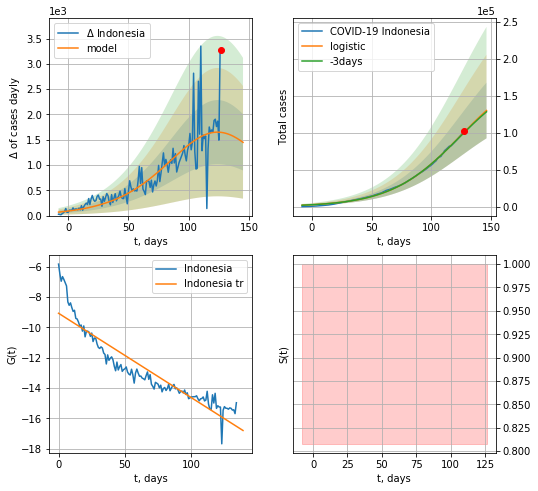

Indonesia data at: 2020-07-27
+3 day model MAPE: 0.0067069936703992375
model: logistic
coeffs:  [1.91462894e+05 3.44809550e-02 1.24316801e+02]
rational stdev:  0.28962699929258706
forecast at the end of period: +19 days
	 deltaDaycases:  1448
	 total cases:  129939 ± 37634
	 total death:  6240 ± 5421
trend coefficient of determination: 0.857123
 intercept: -9.073716
 slope: -0.055614


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


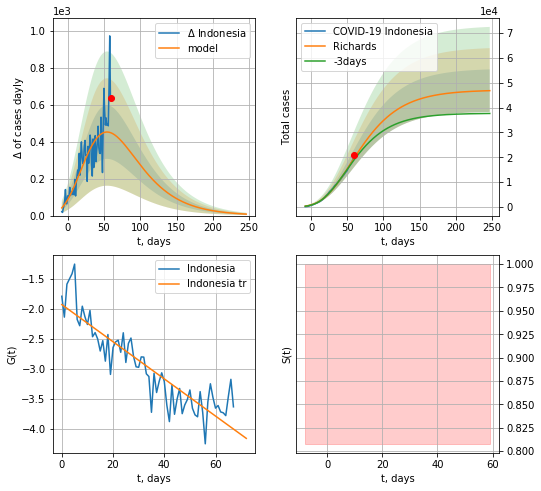

Indonesia data at: 2020-07-27
+3 day model MAPE: 0.038052
model: Richards
coeffs: [ 4.71241400e+04  1.80052285e+00 -1.05975004e+02  1.46057737e-02]
rational stdev: 0.182929
forecast at the end of period: +187 days
	 deltaDaycases: 7
	 total cases: 46824 ± 8565
	 total death: 2248 ± 1233
trend coefficient of determination: 0.798542
 intercept: -1.926266
 slope: -0.031064


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


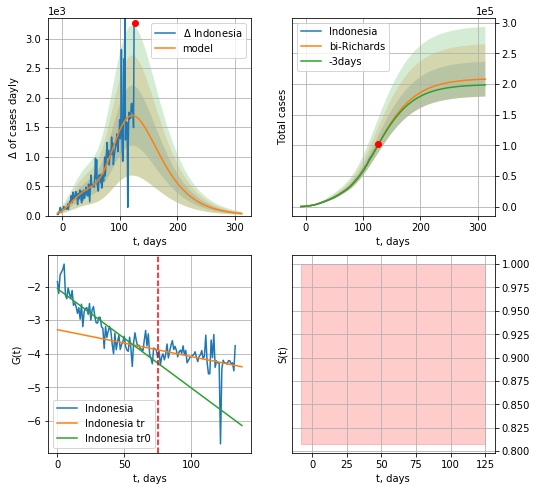

Indonesia data at: 2020-07-27
+3 day model MAPE: 0.004668
model: bi-Richards
coeffs: [ 1.61978094e+05  9.41726771e-01 -1.20428740e+01  2.76005767e-02]
rational stdev: 0.136504
forecast at the end of period: +187 days
	 deltaDaycases: 34
	 total cases: 207797 ± 28365
	 total death: 9979 ± 4086
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.802980
 intercept: -2.061202
 slope: -0.029533
trend coefficient of determination: 0.106153
 intercept: -3.282614
 slope: -0.008007


In [1793]:
dfIE = read_df(pd.DataFrame(),"IE")
try:
    x = forecast("Indonesia",dfIE[5:],d1,20*7-dT)
    vL = 75+6
    x = forecastRR("Indonesia",dfIE[6:vL-6],d1,44*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("Indonesia",dfIE[6:],d1,44*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-6)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


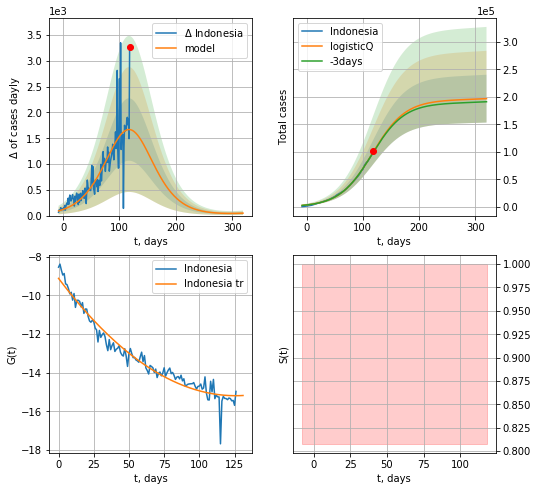

Indonesia data at: 2020-07-27
+3 day model MAPE: 0.005832
model: logisticQ
coeffs: [ 1.94592654e+05  1.56266267e-06  1.17200589e+02 -2.18290623e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.220814
forecast at the end of period: +201 days
	 deltaDaycases: 47
	 total cases: 196923 ± 43483
	 total death: 9457 ± 6264
trend coefficient of determination: 0.954718
 intercept_: -9.126365663491509
 coeffs_: [ 0.         -0.09660015  0.00038444]


In [1794]:
x = forecastRRR("Indonesia",dfIE[13:],d1,46*7-dT,addpred=True,xcoef=koreaCoeffs)

PH
           date  cases   active   death
138 2020-07-23  74390  48136.0  1871.0
139 2020-07-24  76444  50063.0  1879.0
140 2020-07-25  78412  50763.0  1897.0
141 2020-07-26  80448  52406.0  1932.0
142 2020-07-27  82040  53649.0  1945.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


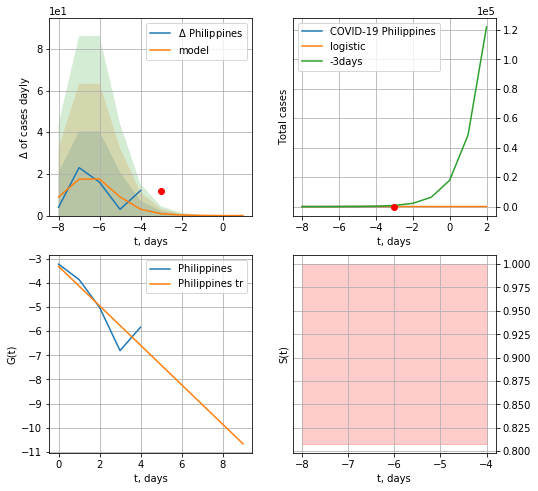

Philippines data at: 2020-07-27
+3 day model MAPE: 0.9724006926427327
model: logistic
coeffs:  [61.5169203   1.2919553  -5.99802409]
rational stdev:  0.193485507182797
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  61 ± 11
	 total death:  1 ± 0
trend coefficient of determination: 0.794507
 intercept: -3.309972
 slope: -0.817432


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


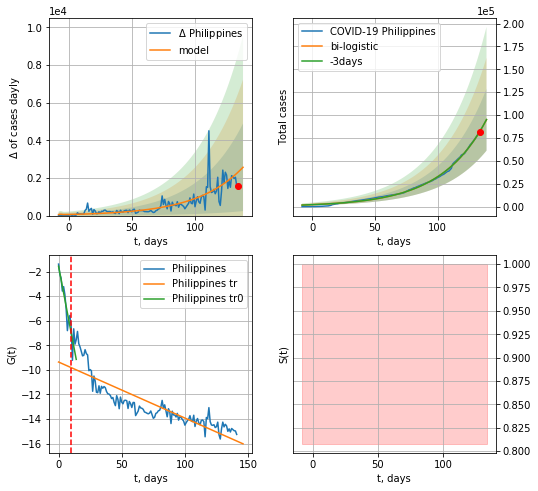

Philippines data at: 2020-07-27
+3 day model MAPE: 0.0016250075668644978
model: bi-logistic
coeffs:  [1.78789452e+07 2.75608432e-02 3.28883239e+02] [61.5169203   1.2919553  -5.99802409]
rational stdev:  0.3557807200819614
forecast at the end of period: +5 days
	 deltaDaycases:  2566
	 total cases:  94951 ± 33781
	 total death:  2251 ± 2402
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend coefficient of determination: 0.754555
 intercept: -9.360168
 slope: -0.045629


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


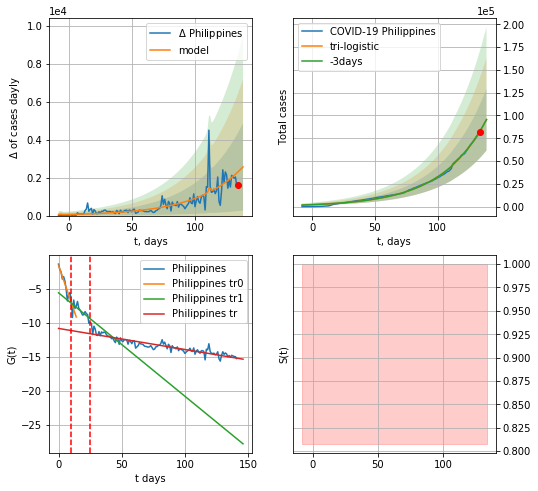

Philippines data at: 2020-07-27
+3 day model MAPE: 0.0013872210404079993
model: tri-logistic
coeffs:  [464.68616908   2.10839651 111.92653766] [ 6.15169203e+01  1.29195530e+00 -5.99802409e+00  1.78789452e+07
  2.75608432e-02  3.28883239e+02]
forecast rational stdev:  0.35531624484577506
forecast at the end of period: +5 days
	 deltaDaycases:  2566
	 total cases:  95415 ± 33902
	 total death:  2262 ± 2411
tri-logistic approximation splitting points: 10,25
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend1 coefficient of determination: 0.474240
 intercept: -5.600607
 slope: -0.151865
trend coefficient of determination: 0.830687
 intercept: -10.831932
 slope: -0.030915


In [1795]:
vL=10
vL1=25
dfPH = read_df(pd.DataFrame(),"PH")
x = forecast("Philippines",dfPH[4:vL],d1,18*7-dT,addpred=False,xcoef=[0.25,1.,2.3])
xx = forecast2("Philippines",dfPH[:],d1,18*7-dT,x,vL=vL,addpred=False,xcoef=[0.25,1.,1.8])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Philippines",dfPH,d1,18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


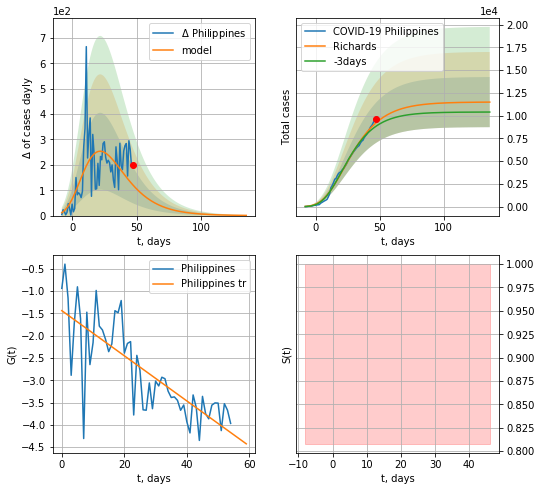

Philippines data at: 2020-07-27
+3 day model MAPE: 0.044211
model: Richards
coeffs: [ 1.15018224e+04  6.61447978e+00 -5.57254377e+01  9.11076230e-03]
rational stdev: 0.239777
forecast at the end of period: +89 days
	 deltaDaycases: 0
	 total cases: 11489 ± 2754
	 total death: 272 ± 195
trend coefficient of determination: 0.622666
 intercept: -1.437831
 slope: -0.050660


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


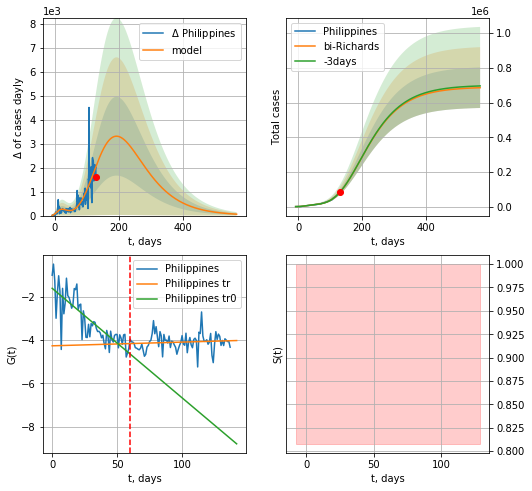

Philippines data at: 2020-07-27
+3 day model MAPE: 0.000012
model: bi-Richards
coeffs: [ 6.78400490e+05  3.98677529e-01 -5.80138588e+01  3.38019654e-02]
rational stdev: 0.170435
forecast at the end of period: +439 days
	 deltaDaycases: 57
	 total cases: 685622 ± 116854
	 total death: 16254 ± 8310
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.669424
 intercept: -1.599318
 slope: -0.050694
trend coefficient of determination: 0.010095
 intercept: -4.260872
 slope: 0.001714


In [1796]:
vL = 60 + 4
x = forecastRR("Philippines",dfPH[4:vL-4],d1,30*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Philippines",dfPH[4:],d1,80*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-4)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


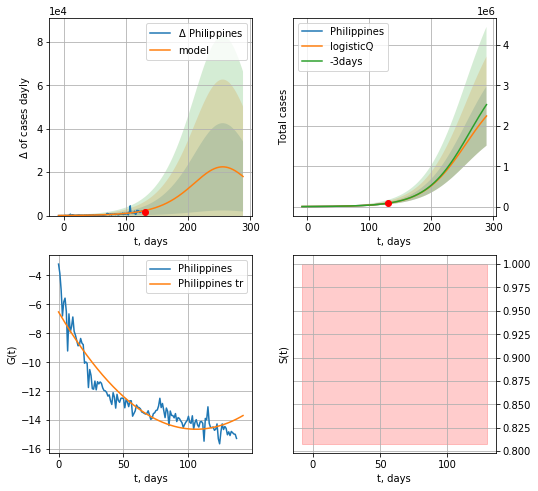

Philippines data at: 2020-07-27
+3 day model MAPE: 0.001857
model: logisticQ
coeffs: [ 3.07346187e+06  4.71439376e-06  2.55169053e+02 -5.94903160e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.327693
forecast at the end of period: +159 days
	 deltaDaycases: 18027
	 total cases: 2243816 ± 735281
	 total death: 53196 ± 52295
trend coefficient of determination: 0.888062
 intercept_: -6.523475580157051
 coeffs_: [ 0.         -0.15306157  0.00072306]


In [1797]:
x = forecastRRR("Philippines",dfPH[4:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

GC
           date   cases  active  death
145 2020-07-23  4110.0    2535  201.0
146 2020-07-24  4135.0    2560  201.0
147 2020-07-25  4166.0    2591  201.0
148 2020-07-26  4193.0    2617  202.0
149 2020-07-27  4227.0    2651  202.0


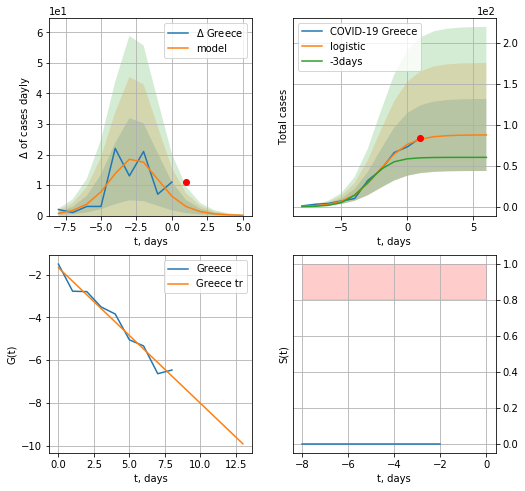

Greece data at: 2020-07-27
+3 day model MAPE: 0.4212876769828872
model: logistic
coeffs:  [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.5018417290456435
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  87 ± 43
	 total death:  4 ± 6
trend coefficient of determination: 0.966991
 intercept: -1.674249
 slope: -0.634181


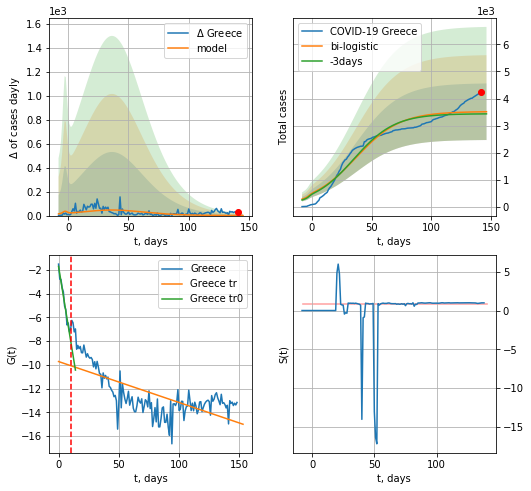

Greece data at: 2020-07-27
+3 day model MAPE: 0.022600607586685847
model: bi-logistic
coeffs:  [3.43233975e+03 5.42642447e-02 3.68002157e+01] [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.2980186741446601
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  3510 ± 1046
	 total death:  167 ± 149
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.974467
 intercept: -1.699561
 slope: -0.624689
trend coefficient of determination: 0.472704
 intercept: -9.722951
 slope: -0.034569


In [1798]:
dfGC = read_df(pd.DataFrame(),"GC")
x = forecast("Greece",dfGC[:10],d1,18*7-dT)
xx = forecast2("Greece",dfGC[:],d1,18*7-dT,x,addpred=False,xcoef=[.25/2,1.,2.3],vL=10)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


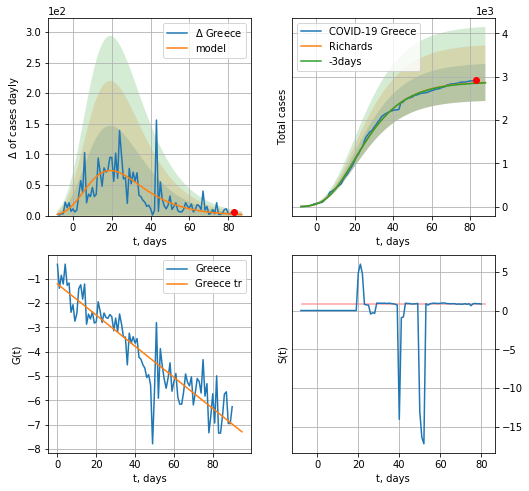

Greece data at: 2020-07-27
+3 day model MAPE: 0.003285
model: Richards
coeffs: [ 2.89327845e+03  7.32645531e+00 -4.72791098e+01  9.49096927e-03]
rational stdev: 0.149150
forecast at the end of period: +5 days
	 deltaDaycases: 1
	 total cases: 2868 ± 427
	 total death: 137 ± 61
trend coefficient of determination: 0.838381
 intercept: -1.223025
 slope: -0.063896


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


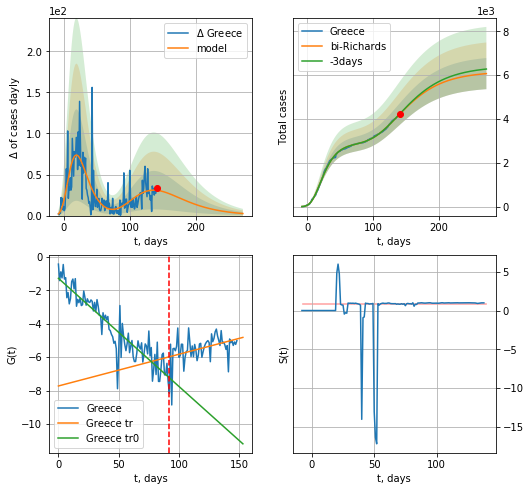

Greece data at: 2020-07-27
+3 day model MAPE: 0.002911
model: bi-Richards
coeffs: [ 3.27366954e+03  1.13577055e+00 -8.62321743e+00  2.28616826e-02]
rational stdev: 0.117042
forecast at the end of period: +131 days
	 deltaDaycases: 2
	 total cases: 6070 ± 710
	 total death: 290 ± 101
bi-Richards approximation splitting point: 92
trend coefficient of determination: 0.845199
 intercept: -1.280274
 slope: -0.064752
trend coefficient of determination: 0.152227
 intercept: -7.725364
 slope: 0.019003


In [1799]:
vL = 92
x = forecastRR("Greece",dfGC[:vL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Greece",dfGC[:],d1,36*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


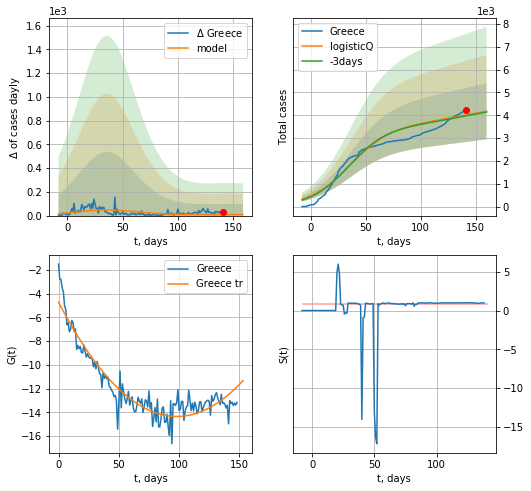

Greece data at: 2020-07-27
+3 day model MAPE: 0.010192
model: logisticQ
coeffs: [ 3.52054802e+03  4.73325044e-08  3.57465736e+01 -1.13029098e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.294810
forecast at the end of period: +19 days
	 deltaDaycases: 8
	 total cases: 4174 ± 1230
	 total death: 199 ± 176
trend coefficient of determination: 0.885526
 intercept_: -4.717805644088862
 coeffs_: [ 0.         -0.19645632  0.0010012 ]


In [1800]:
x = forecastRRR("Greece",dfGC[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

HG
           date   cases  active  death
139 2020-07-23  4398.0     490  596.0
140 2020-07-24  4424.0     504  596.0
141 2020-07-25  4435.0     510  596.0
142 2020-07-26  4448.0     523  596.0
143 2020-07-27  4456.0     529  596.0


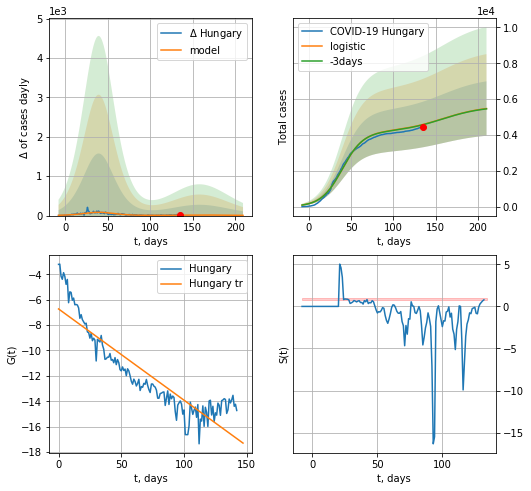

Hungary data at: 2020-07-27
+3 day model MAPE: 0.003125755620641747
model: logistic
coeffs:  [4.17470111e+03 8.01203708e-02 3.95647156e+01]
scenario coeffs:  [0.35, 0.5, 4, 1]
rational stdev:  0.2773239576992639
forecast at the end of period: +75 days
	 deltaDaycases:  5
	 total cases:  5472 ± 1517
	 total death:  731 ± 608
trend coefficient of determination: 0.812457
 intercept: -6.728048
 slope: -0.071865


In [1801]:
dfHG = read_df(pd.DataFrame(),"HG")
try:
    x = forecast("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=[.35,.5,4,1])
except:
    print("Exception occurs")
#xx = forecast2("Hungary",dfHG[:],d1,4*7-dT,x,vL=10)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


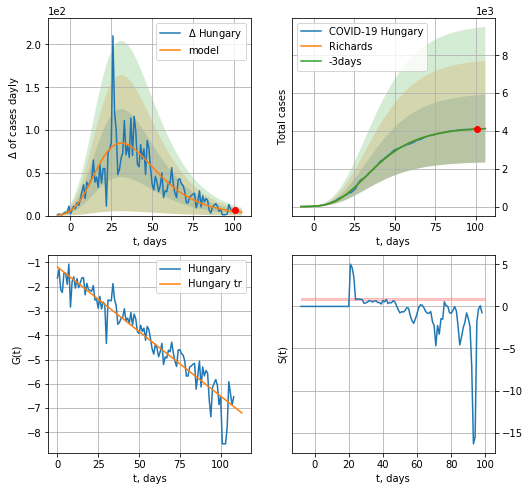

Hungary data at: 2020-07-27
+3 day model MAPE: 0.000504
model: Richards
coeffs: [ 4.19103254e+03  2.98285870e+00 -4.02163545e+01  1.86009647e-02]
rational stdev: 0.434483
forecast at the end of period: +5 days
	 deltaDaycases: 3
	 total cases: 4124 ± 1791
	 total death: 551 ± 718
trend coefficient of determination: 0.907645
 intercept: -1.183102
 slope: -0.053207


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


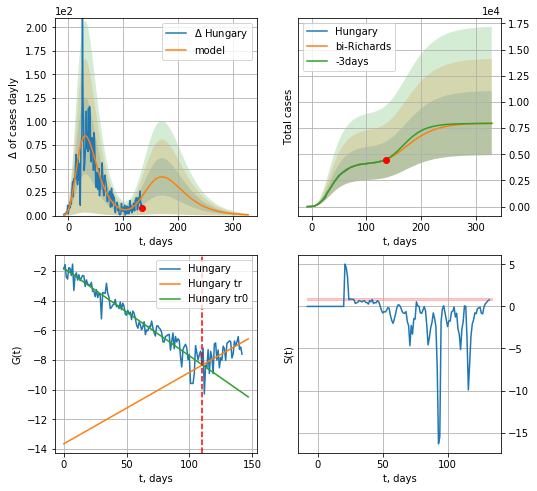

Hungary data at: 2020-07-27
+3 day model MAPE: 0.004645
model: bi-Richards
coeffs: [3.81141657e+03 2.06732605e-01 1.11590939e+02 1.52355958e-01]
rational stdev: 0.383778
forecast at the end of period: +194 days
	 deltaDaycases: 0
	 total cases: 7975 ± 3061
	 total death: 1066 ± 1227
bi-Richards approximation splitting point: 110
trend coefficient of determination: 0.929391
 intercept: -1.794717
 slope: -0.059133
trend coefficient of determination: 0.316073
 intercept: -13.654519
 slope: 0.048214


In [1802]:
vL = 110
x = forecastRR("Hungary",dfHG[:vL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Hungary",dfHG[:],d1,45*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


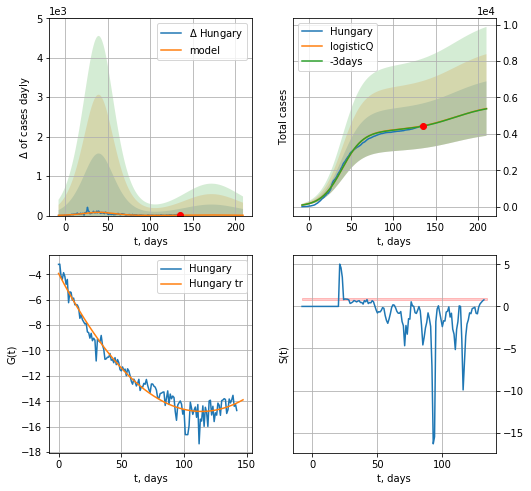

Hungary data at: 2020-07-27
+3 day model MAPE: 0.003601
model: logisticQ
coeffs: [ 4.17468092e+03  2.11655199e-07  3.95654995e+01 -3.78474222e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.277356
forecast at the end of period: +75 days
	 deltaDaycases: 8
	 total cases: 5386 ± 1493
	 total death: 720 ± 599
trend coefficient of determination: 0.962743
 intercept_: -3.934646739423168
 coeffs_: [ 0.         -0.19073457  0.00083712]


In [1803]:
x = forecastRRR("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='cases')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


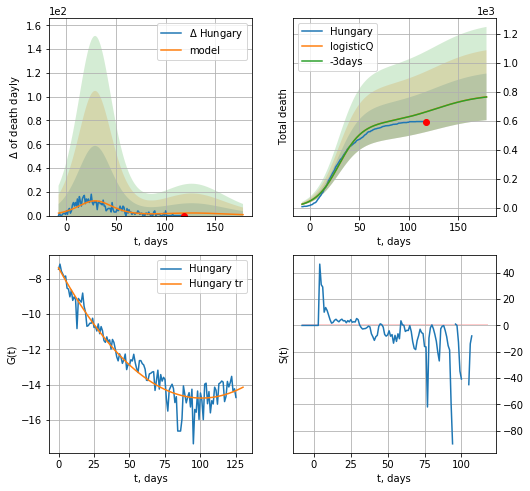

Hungary data at: 2020-07-27
+3 day model MAPE: 0.000991
model: logisticQ
coeffs: [ 5.81463239e+02  2.57541352e-07  2.92000257e+01 -3.27754773e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.210220
forecast at the end of period: +61 days
	 total death: 766 ± 161
trend coefficient of determination: 0.923503
 intercept_: -7.391309158534693
 coeffs_: [ 0.         -0.14613181  0.00072448]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: divide by zero encountered in true_divide


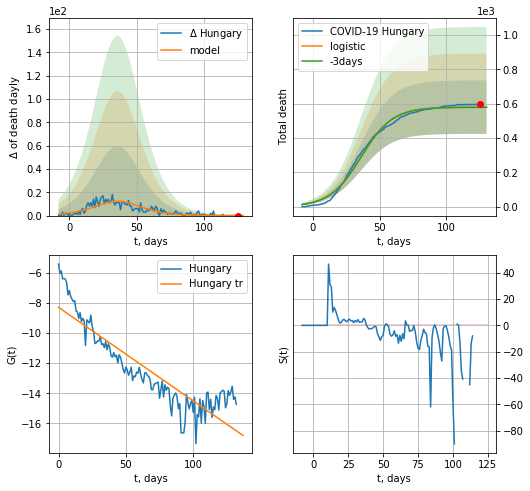

Hungary data at: 2020-07-27
+3 day model MAPE: 0.0019240236078435808
model: logistic
coeffs:  [5.80984195e+02 8.52229147e-02 3.61889747e+01]
rational stdev:  0.26820599532777967
forecast at the end of period: +5 days
	 total death:  580 ± 155
trend coefficient of determination: 0.798946
 intercept: -8.295443
 slope: -0.062047


In [1804]:
x = forecastRRR("Hungary",dfHG[17:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')
x = forecast("Hungary",dfHG[10:],d1,18*7-dT,cases='death')

MT
           date  cases  active  death
137 2020-07-23  680.0       6    9.0
138 2020-07-24  686.0      12    9.0
139 2020-07-25  686.5      12    9.0
140 2020-07-26  700.0      26    9.0
141 2020-07-27  701.0      27    9.0


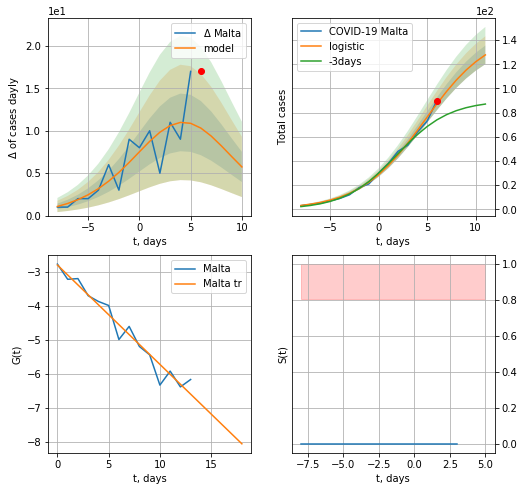

Malta data at: 2020-07-27
model: logistic
coeffs:  [147.79636851   0.29837111   4.7799051 ]
rational stdev:  0.06036954967749919
forecast at the end of period: +5 days
	 deltaDaycases:  5
	 total cases:  127 ± 7
	 total death:  1 ± 0
trend coefficient of determination: 0.952854
 intercept: -2.800130
 slope: -0.292111


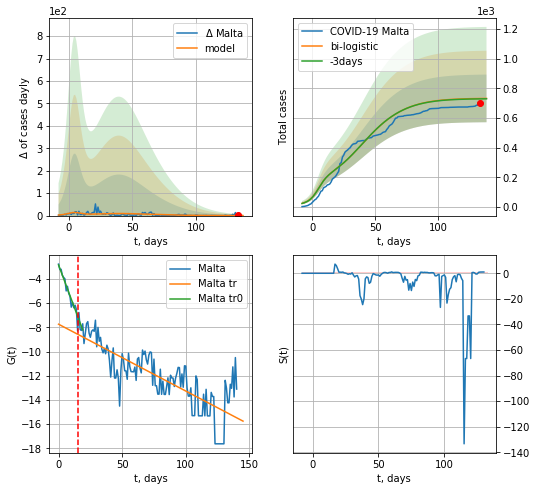

Malta data at: 2020-07-27
+3 day model MAPE: 0.0034924088433578976
model: bi-logistic
coeffs:  [5.20515634e+02 6.77790645e-02 3.86097021e+01] [147.79636851   0.29837111   4.7799051 ]
scenario coeffs:  [0.125, 1.0, 1.8]
rational stdev:  0.21936133743828795
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  732 ± 160
	 total death:  9 ± 5
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.954424
 intercept: -2.840997
 slope: -0.282680
trend coefficient of determination: 0.642698
 intercept: -7.741931
 slope: -0.055267


In [1805]:
try:
    dfMT = read_df(pd.DataFrame(),"MT")
    x = forecast("Malta",dfMT[:15],d1,7*18-dT,pMAPE=False)
    xx = forecast2("Malta",dfMT[:],d1,7*18-dT,x,vL=15,addpred=True,xcoef=[0.25/2,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


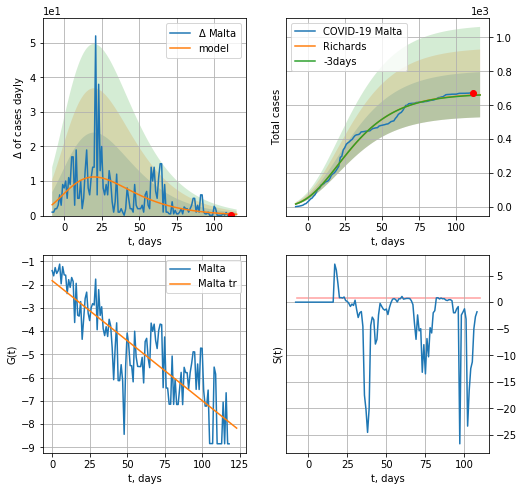

Malta data at: 2020-07-27
+3 day model MAPE: 0.002558
model: Richards
coeffs: [ 6.70428122e+02  8.74606166e+00 -9.52940365e+01  5.19870795e-03]
rational stdev: 0.201239
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 661 ± 133
	 total death: 8 ± 4
trend coefficient of determination: 0.726388
 intercept: -1.827534
 slope: -0.051578


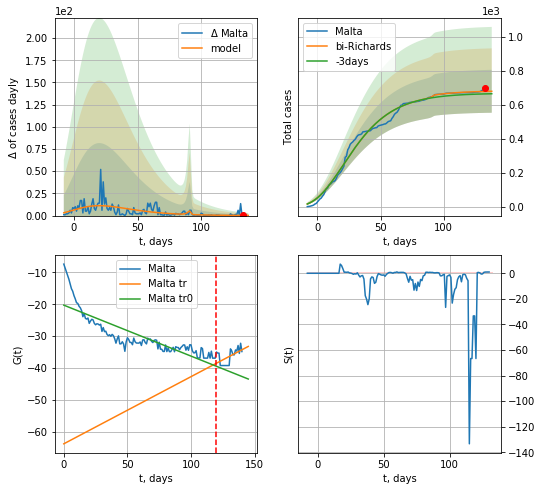

Malta data at: 2020-07-27
+3 day model MAPE: 0.021676
model: bi-Richards
coeffs: [14.44949697  0.5279258  92.17757574  4.31679677]
rational stdev: 0.185251
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 681 ± 126
	 total death: 8 ± 4
bi-Richards approximation splitting point: 120
trend coefficient of determination: 0.723265
 intercept: -20.262719
 slope: -0.160021
trend coefficient of determination: 0.290042
 intercept: -63.820620
 slope: 0.210966


In [1806]:
vL = 120
x = forecastRR("Malta",dfMT[:vL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Malta",dfMT[:],d1,18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


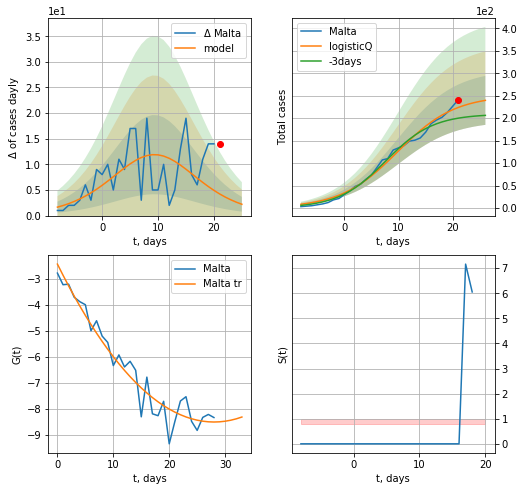

Malta data at: 2020-07-27
+3 day model MAPE: 0.130140
model: logisticQ
coeffs: [ 2.50920106e+02  3.54280992e-06  9.84691106e+00 -5.35760827e+04]
rational stdev: 0.227623
forecast at the end of period: +5 days
	 deltaDaycases: 2
	 total cases: 239 ± 54
	 total death: 3 ± 2
trend coefficient of determination: 0.935484
 intercept_: -2.4264251666881744
 coeffs_: [ 0.         -0.43368994  0.00773877]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


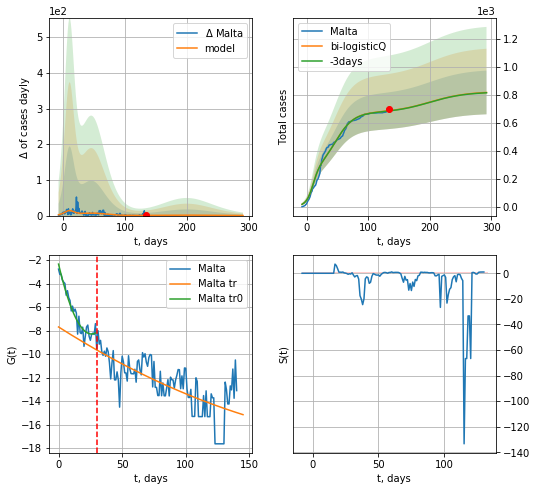

Malta data at: 2020-07-27
+3 day model MAPE: 0.002711
model: bi-logisticQ
coeffs: [ 4.24484404e+02  1.48375449e-07  4.59446476e+01 -4.47767992e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.190742
forecast at the end of period: +159 days
	 deltaDaycases: 0
	 total cases: 819 ± 156
	 total death: 10 ± 5
bi-logisticQ approximation splitting point: 30
trend coefficient of determination: 0.928360
 intercept_: -2.3445378489560733
 coeffs_: [ 0.         -0.45826686  0.00882824]
trend coefficient of determination: 0.509601
 intercept_: -7.6906880293826845
 coeffs_: [ 0.        -0.0688358  0.0001199]


In [1807]:
x = forecastRRR("Malta",dfMT[:30],d1,18*7-dT,addpred=False,xcoef=[0.35/4,.5,3,1.])
xx = forecast2RRR("Malta",dfMT[:],d1,40*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=30)

SL
           date   cases  active  death
135 2020-07-23  2103.0   505.0   28.0
136 2020-07-24  2118.0   513.0   28.0
137 2020-07-25  2141.0   536.0   28.0
138 2020-07-26  2179.0   574.0   28.0
139 2020-07-27  2204.0   532.0   28.0


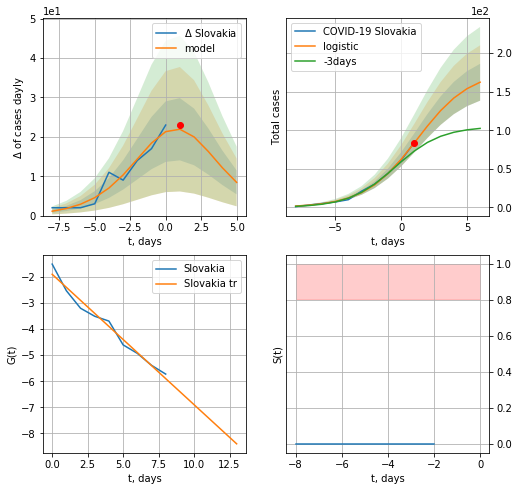

Slovakia data at: 2020-07-27
model: logistic
coeffs:  [177.28786061   0.49967231   1.23158076]
rational stdev:  0.14723855931524674
forecast at the end of period: +5 days
	 deltaDaycases:  8
	 total cases:  162 ± 23
	 total death:  2 ± 0
trend coefficient of determination: 0.974721
 intercept: -1.894823
 slope: -0.500610


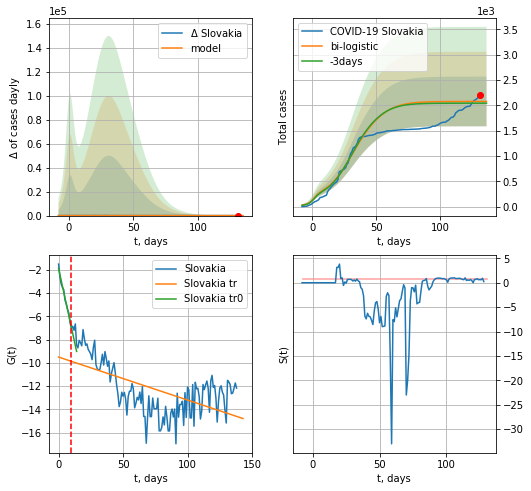

Slovakia data at: 2020-07-27
+3 day model MAPE: 0.016751043236407557
model: bi-logistic
coeffs:  [1.51846817e+03 1.04442477e-01 2.97954382e+01] [177.28786061   0.49967231   1.23158076]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.2361895196824516
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  2075 ± 490
	 total death:  26 ± 18
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.981202
 intercept: -1.868036
 slope: -0.510655
trend coefficient of determination: 0.352888
 intercept: -9.504439
 slope: -0.037001


In [1808]:
dfSL = read_df(pd.DataFrame(),"SL")
dfSL = dfSL.fillna(0)
try:
    x = forecast("Slovakia",dfSL[:10],d1,18*7-dT,pMAPE=False)
    xx = forecast2("Slovakia",dfSL[:],d1,18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=10)
except:
    print("Exception ocurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


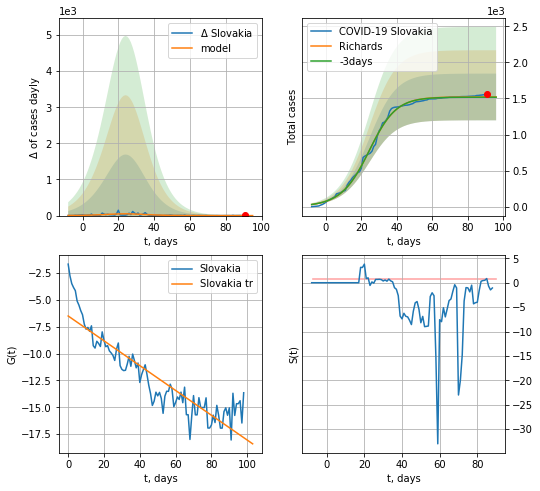

Slovakia data at: 2020-07-27
+3 day model MAPE: 0.002372
model: Richards
coeffs: [1.52109568e+03 1.16938732e-01 2.55808264e+01 1.14750291e+00]
rational stdev: 0.212800
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 1520 ± 323
	 total death: 19 ± 12
trend coefficient of determination: 0.817560
 intercept: -6.499033
 slope: -0.115624


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


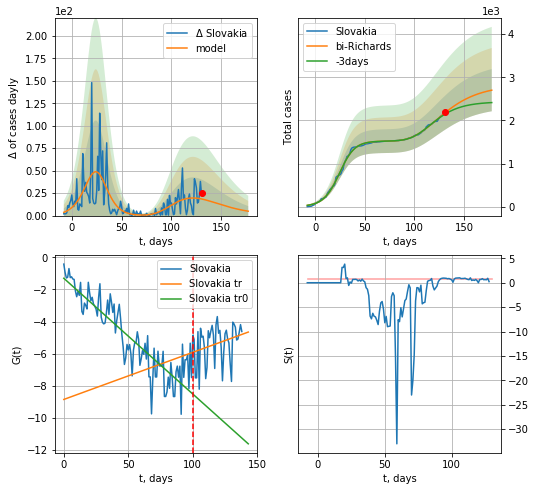

Slovakia data at: 2020-07-27
+3 day model MAPE: 0.016798
model: bi-Richards
coeffs: [1.30198836e+03 2.23965693e+00 2.51417847e+01 1.84308667e-02]
rational stdev: 0.181081
forecast at the end of period: +47 days
	 deltaDaycases: 4
	 total cases: 2700 ± 489
	 total death: 34 ± 18
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.797686
 intercept: -1.306703
 slope: -0.072064
trend coefficient of determination: 0.073391
 intercept: -8.850137
 slope: 0.029328


In [1809]:
vL = 100
x = forecastRR("Slovakia",dfSL[:vL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Slovakia",dfSL[:],d1,24*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


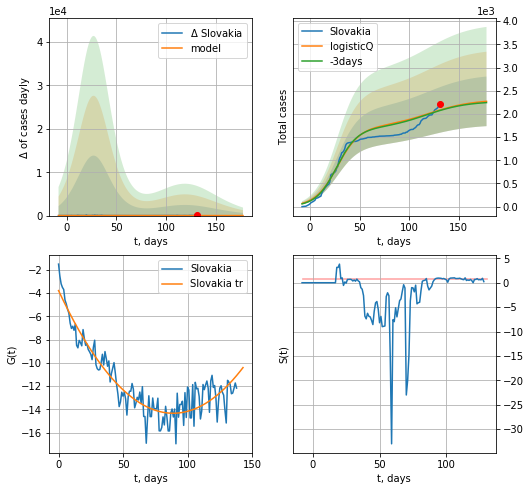

Slovakia data at: 2020-07-27
+3 day model MAPE: 0.005458
model: logisticQ
coeffs: [ 1.70726883e+03  8.60279195e-08  2.74582016e+01 -1.04519062e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.235603
forecast at the end of period: +47 days
	 deltaDaycases: 1
	 total cases: 2271 ± 535
	 total death: 28 ± 19
trend coefficient of determination: 0.867604
 intercept_: -3.782699956091676
 coeffs_: [ 0.         -0.237813    0.00133893]


In [1810]:
x = forecastRRR("Slovakia",dfSL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

SV
           date   cases  active  death
140 2020-07-23  2033.0   257.0  115.0
141 2020-07-24  2052.0   259.0  115.0
142 2020-07-25  2066.0   272.0  116.0
143 2020-07-26  2082.0   288.0  116.0
144 2020-07-27  2101.0   251.0  117.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


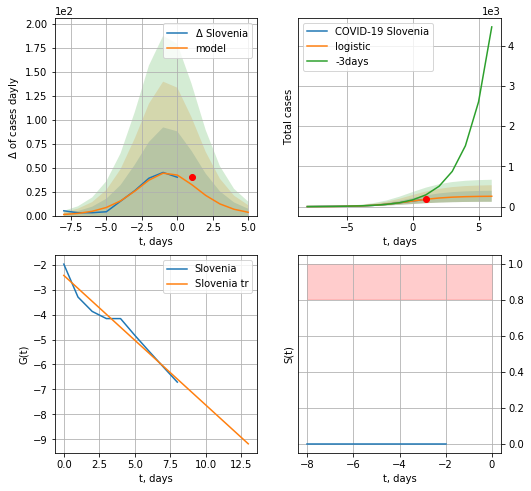

Slovenia data at: 2020-07-27
model: logistic
coeffs:  [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
rational stdev:  0.5312441686508605
forecast at the end of period: +5 days
	 deltaDaycases:  3
	 total cases:  257 ± 136
	 total death:  14 ± 22
trend coefficient of determination: 0.958485
 intercept: -2.427236
 slope: -0.519636


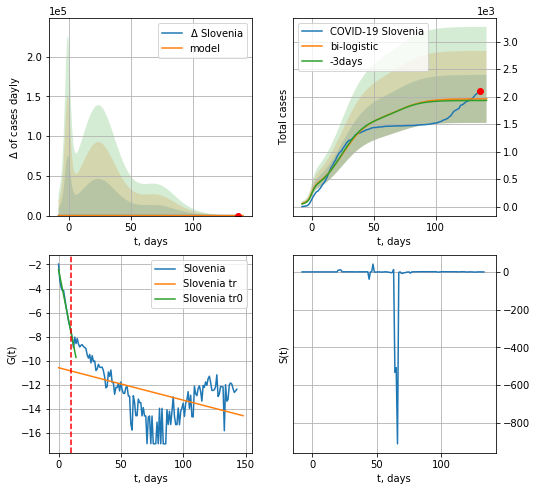

Slovenia data at: 2020-07-27
+3 day model MAPE: 0.014999212741546617
model: bi-logistic
coeffs:  [1.35893394e+03 9.73626785e-02 2.42481967e+01] [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.22262508091196728
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  1959 ± 436
	 total death:  109 ± 72
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.969651
 intercept: -2.421914
 slope: -0.521632
trend coefficient of determination: 0.221958
 intercept: -10.575963
 slope: -0.026897


In [1811]:
dfSV = read_df(pd.DataFrame(),"SV").fillna(0)
try:
    x = forecast("Slovenia",dfSV[:10],d1,7*18-dT,pMAPE=False)
    xx = forecast2("Slovenia",dfSV[:],d1,18*7-dT,x,addpred=True,xcoef=[0.25,1.,3.],vL=10)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


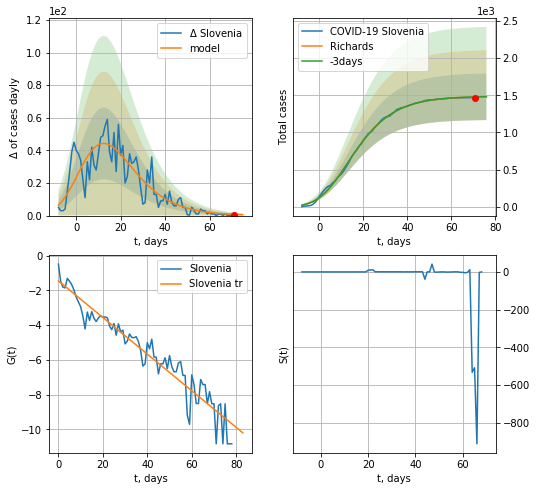

Slovenia data at: 2020-07-27
+3 day model MAPE: 0.001063
model: Richards
coeffs: [ 1.48543612e+03  5.20176508e-01 -7.42026148e+00  1.68829761e-01]
rational stdev: 0.211962
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 1479 ± 313
	 total death: 82 ± 52
trend coefficient of determination: 0.919511
 intercept: -1.449330
 slope: -0.105393


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


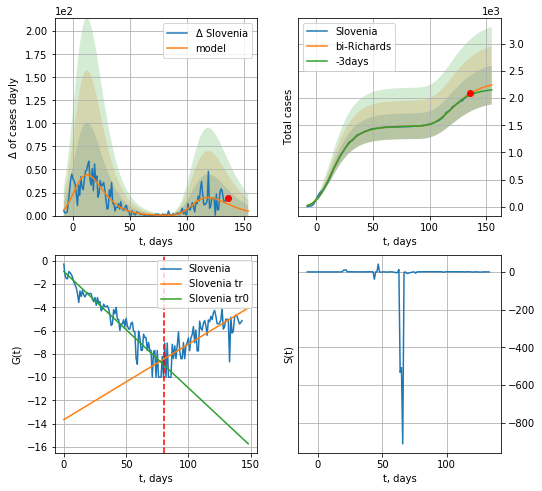

Slovenia data at: 2020-07-27
+3 day model MAPE: 0.014132
model: bi-Richards
coeffs: [8.31933832e+02 1.17071789e+00 7.57242503e+01 5.64543514e-02]
rational stdev: 0.159274
forecast at the end of period: +19 days
	 deltaDaycases: 4
	 total cases: 2242 ± 357
	 total death: 124 ± 59
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.913172
 intercept: -0.916072
 slope: -0.100070
trend coefficient of determination: 0.572913
 intercept: -13.648646
 slope: 0.064865


In [1812]:
vL = 80
x = forecastRR("Slovenia",dfSV[:vL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Slovenia",dfSV[:],d1,20*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

[0.35416971, 0.02606324, 4.35859408, 19.30413219]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


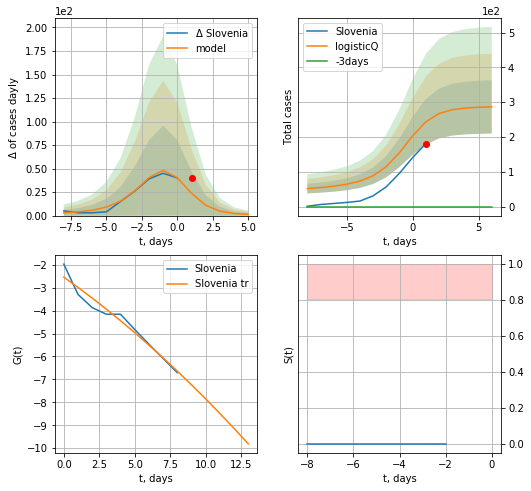

Slovenia data at: 2020-07-27
+3 day model MAPE: inf
model: logisticQ
coeffs: [ 2.17965797e+02  4.01733259e-02 -2.21208421e+01 -7.00287218e-01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.266979
forecast at the end of period: +5 days
	 deltaDaycases: 1
	 total cases: 286 ± 76
	 total death: 15 ± 12
trend coefficient of determination: 0.956027
 intercept_: -2.543480478113449
 coeffs_: [ 0.         -0.43771568 -0.00932819]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:234: RuntimeWarning: divide by zero encountered in double_scalars
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


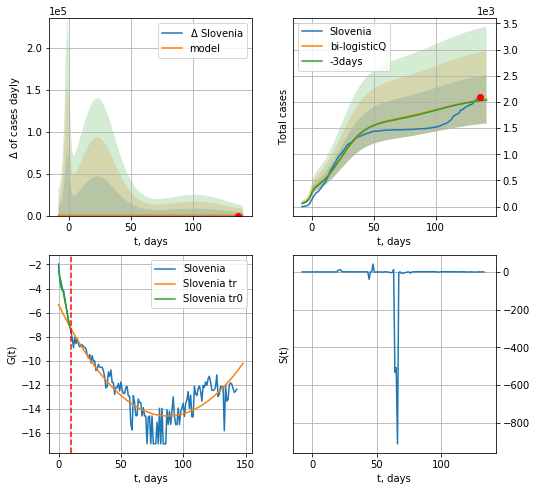

Slovenia data at: 2020-07-27
+3 day model MAPE: 0.007062
model: bi-logisticQ
coeffs: [ 1.40145170e+03  7.84274022e-08  2.35277031e+01 -1.23303480e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.224961
forecast at the end of period: +5 days
	 deltaDaycases: 2
	 total cases: 2049 ± 461
	 total death: 114 ± 76
bi-logisticQ approximation splitting point: 10
trend coefficient of determination: 0.968209
 intercept_: -2.53431844604435
 coeffs_: [ 0.         -0.45029183 -0.00732028]
trend coefficient of determination: 0.752304
 intercept_: -5.341538461239132
 coeffs_: [ 0.         -0.21075249  0.00120168]


In [1813]:
print(koreaCoeffs)
x = forecastRRR("Slovenia",dfSV[:10],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
xx = forecast2RRR("Slovenia",dfSV[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=10)

SB
           date  cases  active  death
135 2020-07-23  22443  7888.0  508.0
136 2020-07-24  22852  8287.0  518.0
137 2020-07-25  23263  8690.0  526.0
138 2020-07-26  23730  9149.0  534.0
139 2020-07-27  24141  9551.0  543.0


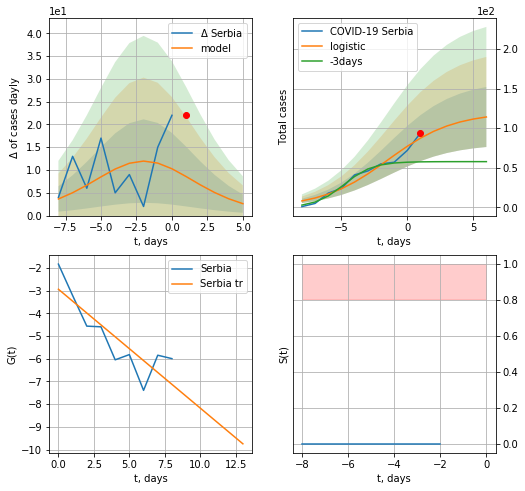

Serbia data at: 2020-07-27
model: logistic
coeffs:  [119.86808879   0.40041875  -1.48148474]
rational stdev:  0.33210329199703215
forecast at the end of period: +5 days
	 deltaDaycases:  2
	 total cases:  114 ± 37
	 total death:  2 ± 1
trend coefficient of determination: 0.723021
 intercept: -2.939233
 slope: -0.523684


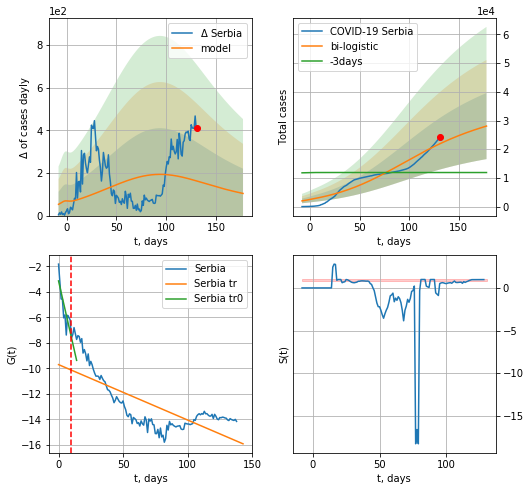

Serbia data at: 2020-07-27
+3 day model MAPE: 0.8567666345796291
model: bi-logistic
coeffs:  [2.79347656e+04 2.62588594e-02 9.04048558e+01] [119.86808879   0.40041875  -1.48148474]
scenario coeffs:  [0.25, 1.0, 2.2]
rational stdev:  0.4103474937089828
forecast at the end of period: +47 days
	 deltaDaycases:  103
	 total cases:  28066 ± 11517
	 total death:  631 ± 776
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.680312
 intercept: -3.149496
 slope: -0.444835
trend coefficient of determination: 0.556651
 intercept: -9.712429
 slope: -0.043423


In [1814]:
dfSB = read_df(pd.DataFrame(),"SB")
dfSB = dfSB.fillna(0)
x = forecast("Serbia",dfSB[:10],d1,18*7-dT,pMAPE=False)
xx = forecast2("Serbia",dfSB[:],d1,24*7-dT,x,addpred=True,xcoef=[0.25,1.,2.2],vL=10)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


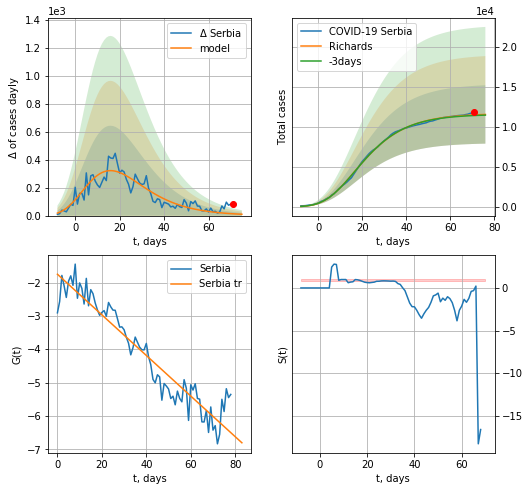

Serbia data at: 2020-07-27
+3 day model MAPE: 0.006988
model: Richards
coeffs: [ 1.16624341e+04  1.86550219e+00 -2.54632436e+01  4.09637438e-02]
rational stdev: 0.315870
forecast at the end of period: +5 days
	 deltaDaycases: 9
	 total cases: 11540 ± 3645
	 total death: 259 ± 245
trend coefficient of determination: 0.902509
 intercept: -1.751737
 slope: -0.060887


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


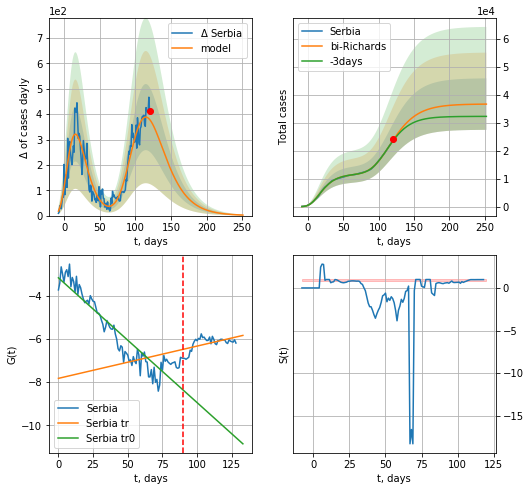

Serbia data at: 2020-07-27
+3 day model MAPE: 0.011184
model: bi-Richards
coeffs: [2.51175339e+04 2.20449596e-01 8.15676661e+01 2.10266857e-01]
rational stdev: 0.250868
forecast at the end of period: +131 days
	 deltaDaycases: 2
	 total cases: 36735 ± 9215
	 total death: 826 ± 621
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.860400
 intercept: -3.180626
 slope: -0.057674
trend coefficient of determination: 0.301677
 intercept: -7.826634
 slope: 0.014923


In [1816]:
iL=10
vL=90+iL
x = forecastRR("Serbia",dfSB[iL:vL-iL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Serbia",dfSB[iL:],d1,36*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


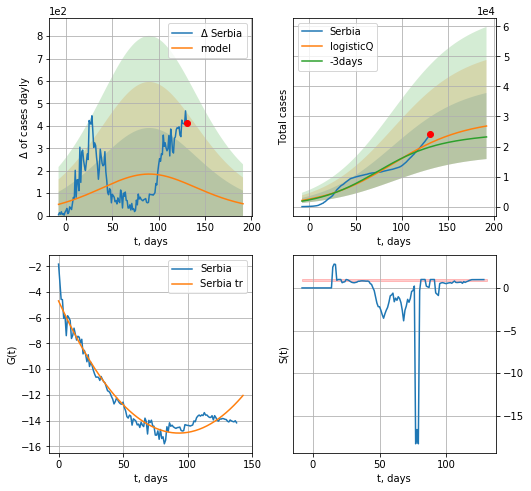

Serbia data at: 2020-07-27
+3 day model MAPE: 0.067893
model: logisticQ
coeffs: [ 2.79618007e+04  6.68084217e-08  8.97309546e+01 -3.91338406e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.409889
forecast at the end of period: +61 days
	 deltaDaycases: 52
	 total cases: 26832 ± 10998
	 total death: 603 ± 741
trend coefficient of determination: 0.954331
 intercept_: -4.6920047439509425
 coeffs_: [ 0.         -0.22029266  0.00118126]


In [1817]:
x = forecastRRR("Serbia",dfSB[:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

CT
           date   cases  active  death
145 2020-07-23  4634.0  1112.0  128.0
146 2020-07-24  4715.0  1032.0  128.0
147 2020-07-25  4792.0   881.0  133.0
148 2020-07-26  4857.0   855.0  136.0
149 2020-07-27  4881.0   806.0  139.0


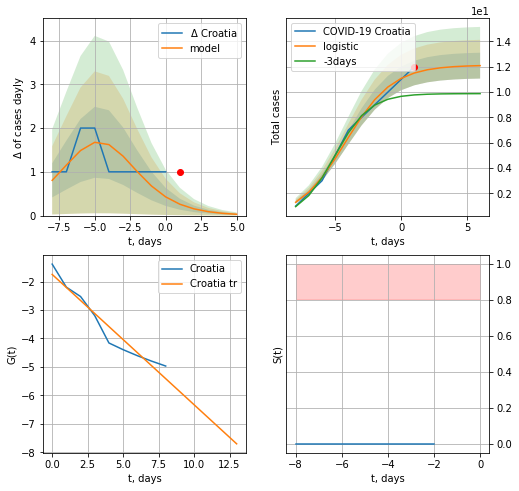

Croatia data at: 2020-07-27
model: logistic
coeffs:  [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.08430442468045289
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  12 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.936719
 intercept: -1.749041
 slope: -0.458074


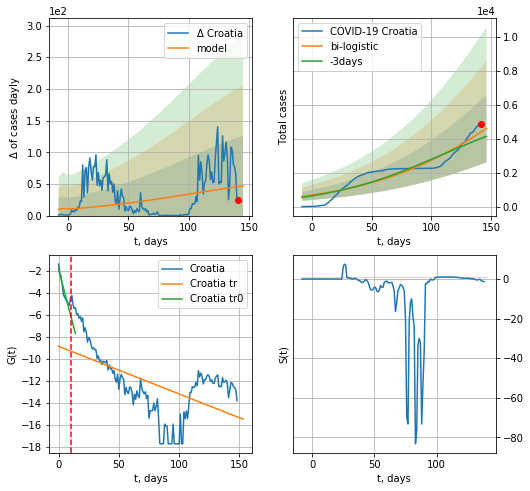

Croatia data at: 2020-07-27
+3 day model MAPE: 0.09472210779929117
model: bi-logistic
coeffs:  [1.29977759e+04 1.57547658e-02 1.84414549e+02] [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.4335768477874676
forecast at the end of period: +5 days
	 deltaDaycases:  46
	 total cases:  4602 ± 1995
	 total death:  131 ± 170
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.922384
 intercept: -1.856940
 slope: -0.417612
trend coefficient of determination: 0.310696
 intercept: -8.866304
 slope: -0.043338


In [1818]:
try:
    dfCT = read_df(pd.DataFrame(),"CT")
    dfCT = dfCT.fillna(0)
    x = forecast("Croatia",dfCT[:10],d1,18*7-dT,pMAPE=False)
    xx = forecast2("Croatia",dfCT[:],d1,18*7-dT,x,addpred=False,xcoef=[0.25/2,1.,2.],vL=10)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


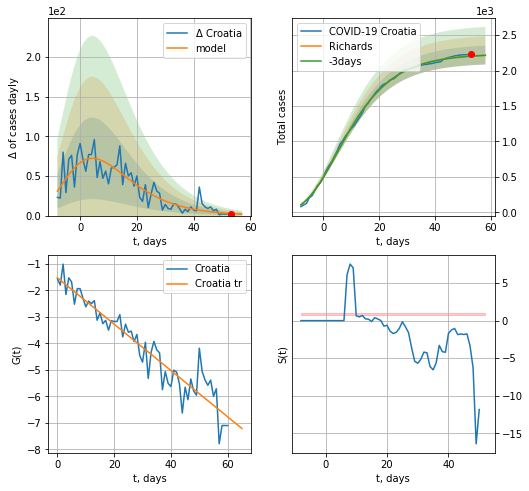

Croatia data at: 2020-07-27
+3 day model MAPE: 0.002310
model: Richards
coeffs: [ 2.23963098e+03  7.95198453e+00 -4.62549964e+01  1.10913889e-02]
rational stdev: 0.059687
forecast at the end of period: +5 days
	 deltaDaycases: 1
	 total cases: 2219 ± 132
	 total death: 63 ± 11
trend coefficient of determination: 0.897394
 intercept: -1.522030
 slope: -0.087533


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


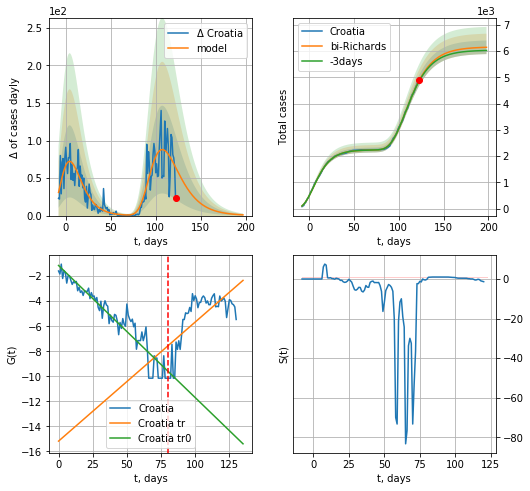

Croatia data at: 2020-07-27
+3 day model MAPE: 0.005285
model: bi-Richards
coeffs: [3.91669057e+03 3.60312830e+00 4.16071329e+01 1.70786674e-02]
rational stdev: 0.042121
forecast at the end of period: +75 days
	 deltaDaycases: 0
	 total cases: 6141 ± 258
	 total death: 174 ± 21
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.903082
 intercept: -1.146388
 slope: -0.105539
trend coefficient of determination: 0.495065
 intercept: -15.179422
 slope: 0.095132


In [1819]:
iL = 18
vL = 80+iL
x = forecastRR("Croatia",dfCT[iL:vL-iL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Croatia",dfCT[iL:],d1,28*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


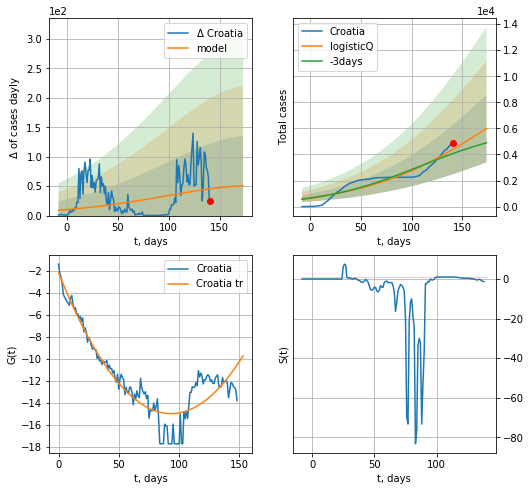

Croatia data at: 2020-07-27
+3 day model MAPE: 0.081553
model: logisticQ
coeffs: [ 1.27989408e+04  1.89618868e-07  1.82717095e+02 -8.30083594e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.433402
forecast at the end of period: +33 days
	 deltaDaycases: 50
	 total cases: 5992 ± 2597
	 total death: 170 ± 221
trend coefficient of determination: 0.867857
 intercept_: -2.1567111066286575
 coeffs_: [ 0.         -0.27526048  0.00147558]


In [1820]:
x = forecastRRR("Croatia",dfCT[:],d1,22*7-dT,addpred=True,xcoef=koreaCoeffs)

EG
           date  cases  active   death
139 2020-07-23  90413   54867  4480.0
140 2020-07-24  91072   54584  4518.0
141 2020-07-25  91583   54122  4558.0
142 2020-07-26  92062   53625  4606.0
143 2020-07-27  92482   52992  4652.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


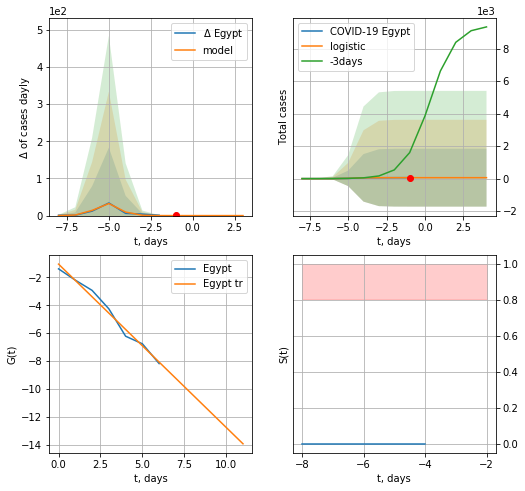

Egypt data at: 2020-07-27
+3 day model MAPE: 0.9848539099062313
model: logistic
coeffs:  [58.57021122  2.53530653 -4.60228222]
rational stdev:  30.428321363178444
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  58 ± 1782
	 total death:  2 ± 182
trend coefficient of determination: 0.982412
 intercept: -1.045837
 slope: -1.172929


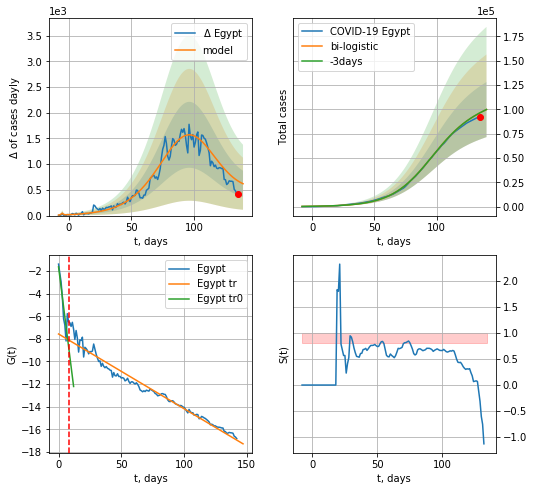

Egypt data at: 2020-07-27
+3 day model MAPE: 0.0006450198953287164
model: bi-logistic
coeffs:  [1.01338441e+05 6.09915722e-02 9.61736605e+01] [58.57021122  2.53530653 -4.60228222]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.2838070813734818
forecast at the end of period: +5 days
	 deltaDaycases:  619
	 total cases:  99732 ± 28304
	 total death:  5016 ± 4270
bi-logistic approximation splitting point: 8
trend0 coefficient of determination: 0.807637
 intercept: -1.627174
 slope: -0.882261
trend coefficient of determination: 0.967737
 intercept: -7.568813
 slope: -0.066104


In [1821]:
dfEG = read_df(pd.DataFrame(),"EG")
x = forecast("Egypt",dfEG[:8],d1,7*18-dT)
xx = forecast2("Egypt",dfEG[:],d1,18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=8)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


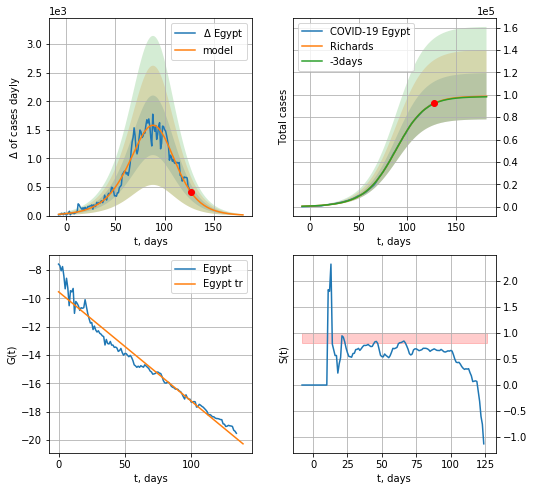

Egypt data at: 2020-07-27
+3 day model MAPE: 0.002351
model: Richards
coeffs: [9.87762264e+04 5.54728834e-02 9.18363664e+01 1.23627812e+00]
rational stdev: 0.209422
forecast at the end of period: +54 days
	 deltaDaycases: 12
	 total cases: 98600 ± 20649
	 total death: 4959 ± 3115
trend coefficient of determination: 0.966982
 intercept: -9.528236
 slope: -0.077327


In [1822]:
x = forecastRR("Egypt",dfEG[8:],d1,25*7-dT,addpred=False,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


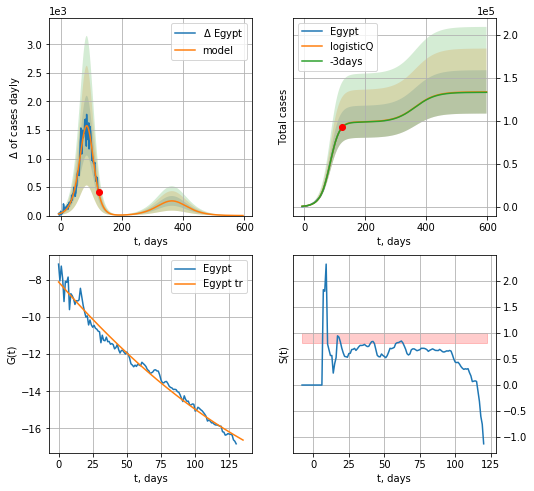

Egypt data at: 2020-07-27
+3 day model MAPE: 0.001887
model: logisticQ
coeffs: [ 9.86327636e+04  8.07212788e-05  8.33270548e+01 -7.07524164e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.188671
forecast at the end of period: +474 days
	 deltaDaycases: 0
	 total cases: 133534 ± 25194
	 total death: 6716 ± 3801
trend coefficient of determination: 0.983001
 intercept_: -8.115963079549148
 coeffs_: [ 0.         -0.0843627   0.00015787]


In [1823]:
x = forecastRRR("Egypt",dfEG[12:],d1,85*7-dT,addpred=True,xcoef=koreaCoeffs)

IQ
           date   cases   active   death
142 2020-07-23  102226  28699.0  4122.0
143 2020-07-24  104711  29231.0  4212.0
144 2020-07-25  107573  29972.0  4284.0
145 2020-07-26  110032  30453.0  4362.0
146 2020-07-27  112585  30983.0  4458.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


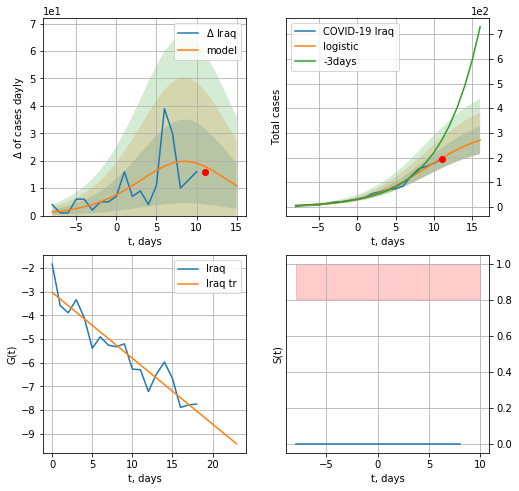

Iraq data at: 2020-07-27
+3 day model MAPE: 0.34474037669474106
model: logistic
coeffs:  [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.20777406895257303
forecast at the end of period: +5 days
	 deltaDaycases:  10
	 total cases:  270 ± 56
	 total death:  10 ± 6
trend coefficient of determination: 0.889033
 intercept: -3.031672
 slope: -0.278416


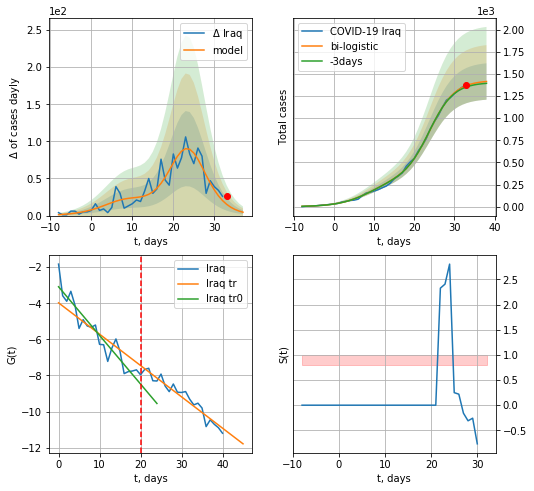

Iraq data at: 2020-07-27
+3 day model MAPE: 0.012548655608678476
model: bi-logistic
coeffs:  [1.10877596e+03 3.20225975e-01 2.39035989e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.14537179336300032
forecast at the end of period: +5 days
	 deltaDaycases:  4
	 total cases:  1413 ± 205
	 total death:  55 ± 23
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend coefficient of determination: 0.928562
 intercept: -3.976586
 slope: -0.173518


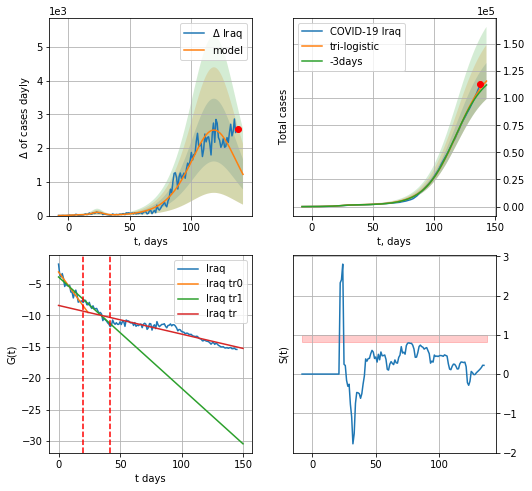

Iraq data at: 2020-07-27
+3 day model MAPE: 0.026085521712532977
model: tri-logistic
coeffs:  [1.32237700e+05 7.66533090e-02 1.18825712e+02] [3.17081296e+02 2.50431387e-01 8.98163530e+00 1.10877596e+03
 3.20225975e-01 2.39035989e+01]
forecast rational stdev:  0.14381601151182566
forecast at the end of period: +5 days
	 deltaDaycases:  1221
	 total cases:  115743 ± 16645
	 total death:  4583 ± 1977
tri-logistic approximation splitting points: 20,42
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend1 coefficient of determination: 0.937217
 intercept: -3.879636
 slope: -0.177153
trend coefficient of determination: 0.864373
 intercept: -8.415062
 slope: -0.045622


In [1824]:
vL=20
vL1=42
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIQ = dfIQ.fillna(0)
x = forecast("Iraq",dfIQ[:vL],d1,18*7-dT)
xx = forecast2("Iraq",dfIQ[:vL1],d1,18*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Iraq",dfIQ[:],d1,18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

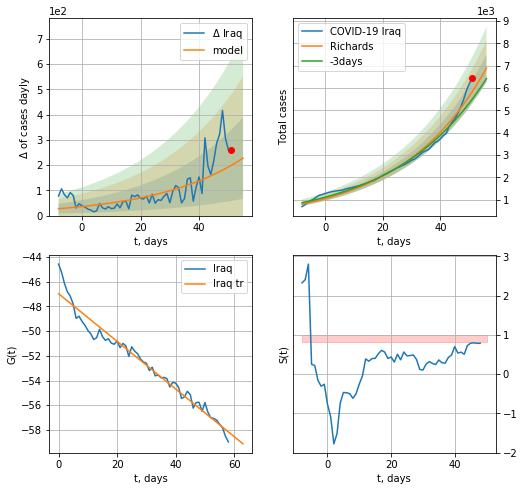

Iraq data at: 2020-07-27
+3 day model MAPE: 0.063543
model: Richards
coeffs: [6.49455358e+04 3.35844300e-02 1.22793781e+02 6.35852822e+00]
rational stdev: 0.089058
forecast at the end of period: +5 days
	 deltaDaycases: 227
	 total cases: 6891 ± 613
	 total death: 272 ± 72
trend coefficient of determination: 0.961424
 intercept: -46.967059
 slope: -0.193056


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


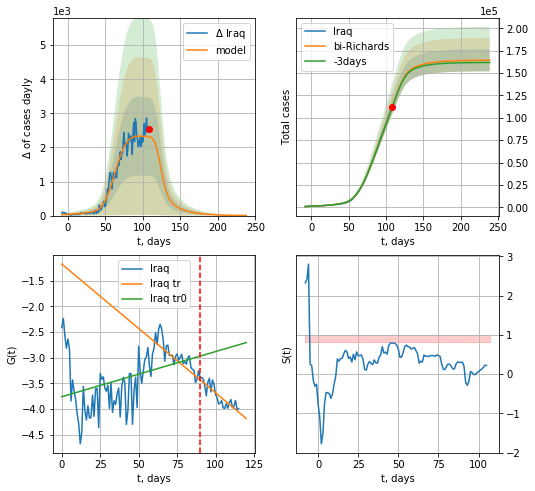

Iraq data at: 2020-07-27
+3 day model MAPE: 0.005177
model: bi-Richards
coeffs: [ 9.95344756e+04  2.61655224e+00 -4.77121378e+00  1.75751103e-02]
rational stdev: 0.075579
forecast at the end of period: +131 days
	 deltaDaycases: 3
	 total cases: 164403 ± 12425
	 total death: 6509 ± 1475
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.173674
 intercept: -3.757074
 slope: 0.008782
trend coefficient of determination: 0.736489
 intercept: -1.176058
 slope: -0.025040


In [1826]:
vL=80+40#25+10
x = forecastRR("Iraq",dfIQ[30:vL-30],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Iraq",dfIQ[30:],d1,36*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-30)

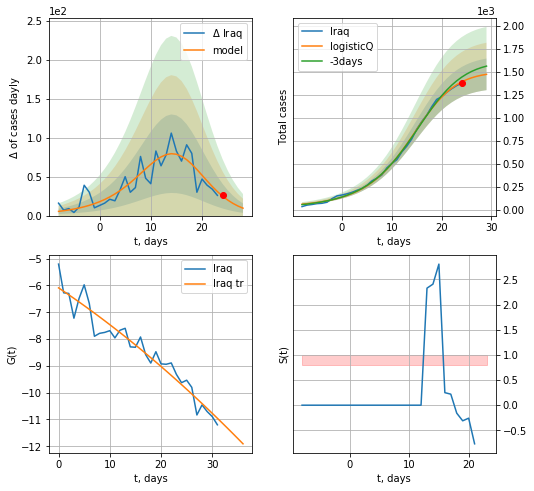

Iraq data at: 2020-07-27
+3 day model MAPE: 0.041008
model: logisticQ
coeffs: [ 1.50291917e+03  2.94853842e-03  1.34415511e+01 -5.72228370e+01]
rational stdev: 0.116469
forecast at the end of period: +5 days
	 deltaDaycases: 9
	 total cases: 1474 ± 171
	 total death: 58 ± 20
trend coefficient of determination: 0.930646
 intercept_: -6.090644942877015
 coeffs_: [ 0.         -0.12791486 -0.00093535]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


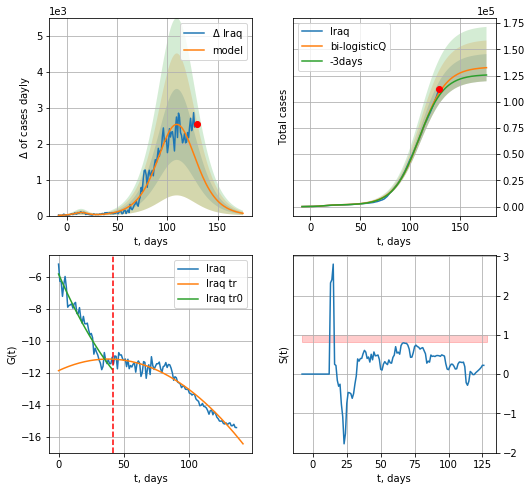

Iraq data at: 2020-07-27
+3 day model MAPE: 0.026416
model: bi-logisticQ
coeffs: [ 1.31792526e+05  1.38686156e-06  1.09760948e+02 -5.53888559e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.097772
forecast at the end of period: +47 days
	 deltaDaycases: 63
	 total cases: 132500 ± 12954
	 total death: 5246 ± 1538
bi-logisticQ approximation splitting point: 42
trend coefficient of determination: 0.941003
 intercept_: -5.824005146615983
 coeffs_: [ 0.         -0.18682641  0.00101526]
trend coefficient of determination: 0.949213
 intercept_: -11.860897129016914
 coeffs_: [ 0.          0.03801608 -0.0004996 ]


In [1827]:
x = forecastRRR("Iraq",dfIQ[9:42],d1,18*7-dT,addpred=False,xcoef=[0.35,.5,4.,1])
xx = forecast2RRR("Iraq",dfIQ[9:],d1,24*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=42)

In [1450]:
#len(dfAR)

AR
           date    cases  active   death
141 2020-07-23  25484.0  6991.0  1124.0
142 2020-07-24  26159.0  7654.0  1136.0
143 2020-07-25  26764.0  7542.0  1146.0
144 2020-07-26  27357.0  8114.0  1155.0
145 2020-07-27  27973.0  7973.0  1163.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


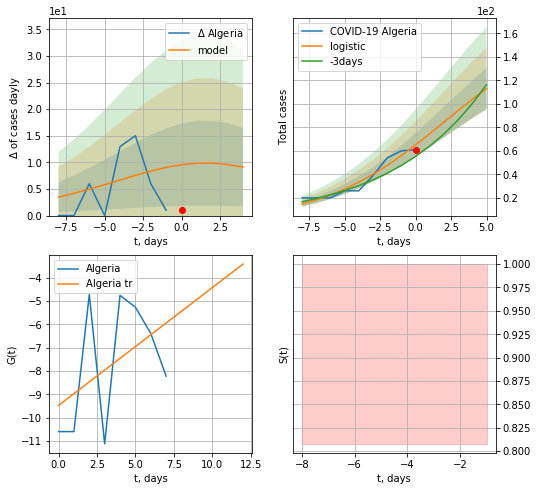

Algeria data at: 2020-07-27
+3 day model MAPE: 0.16392519582549905
model: logistic
coeffs:  [169.67149558   0.23328995   2.04236169]
rational stdev:  0.1546785167835457
forecast at the end of period: +5 days
	 deltaDaycases:  9
	 total cases:  112 ± 17
	 total death:  4 ± 1
trend coefficient of determination: 0.198482
 intercept: -9.477734
 slope: 0.504434


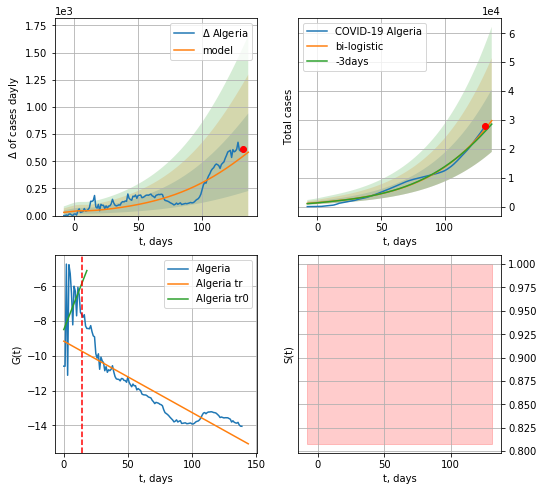

Algeria data at: 2020-07-27
+3 day model MAPE: 0.032960450051152494
model: bi-logistic
coeffs:  [1.69232919e+05 2.40471106e-02 2.01638074e+02] [169.67149558   0.23328995   2.04236169]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.36319677715693
forecast at the end of period: +5 days
	 deltaDaycases:  583
	 total cases:  29763 ± 10810
	 total death:  1237 ± 1347
bi-logistic approximation splitting point: 14
trend0 coefficient of determination: 0.134003
 intercept: -8.492024
 slope: 0.188486
trend coefficient of determination: 0.789676
 intercept: -9.161140
 slope: -0.040984


In [1828]:
dfAR = read_df(pd.DataFrame(),"AR")
x = forecast("Algeria",dfAR[5:14],d1,7*18-dT)
xx = forecast2("Algeria",dfAR[5:],d1,7*18-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=14)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


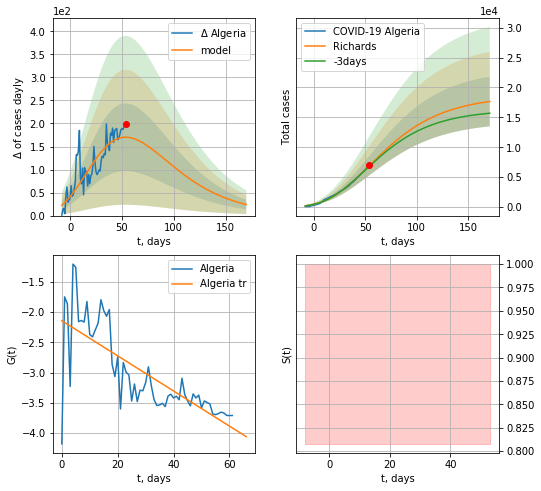

Algeria data at: 2020-07-27
+3 day model MAPE: 0.017361
model: Richards
coeffs: [ 1.86312269e+04  1.59750196e+00 -1.12063742e+02  1.56623086e-02]
rational stdev: 0.235608
forecast at the end of period: +117 days
	 deltaDaycases: 23
	 total cases: 17659 ± 4160
	 total death: 734 ± 518
trend coefficient of determination: 0.563244
 intercept: -2.140644
 slope: -0.029042


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


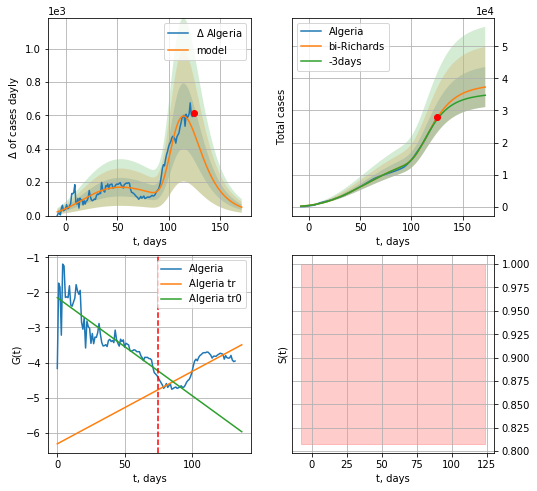

Algeria data at: 2020-07-27
+3 day model MAPE: 0.019792
model: bi-Richards
coeffs: [1.99753473e+04 5.17076529e+00 5.48266975e+01 1.36612818e-02]
rational stdev: 0.167444
forecast at the end of period: +47 days
	 deltaDaycases: 50
	 total cases: 37289 ± 6243
	 total death: 1550 ± 778
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.673566
 intercept: -2.151376
 slope: -0.027871
trend coefficient of determination: 0.714637
 intercept: -6.313679
 slope: 0.020588


In [1829]:
vL = 75+12
x = forecastRR("Algeria",dfAR[12:vL-12],d1,34*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Algeria",dfAR[12:],d1,24*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


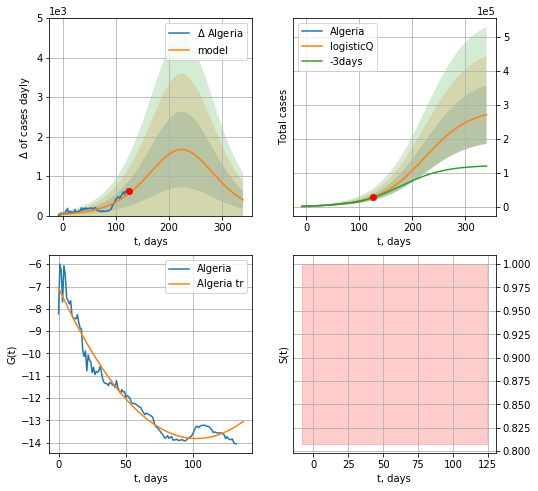

Algeria data at: 2020-07-27
+3 day model MAPE: 0.032561
model: logisticQ
coeffs: [ 2.88164968e+05  1.57744956e-06  2.23439201e+02 -1.44897369e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.317720
forecast at the end of period: +215 days
	 deltaDaycases: 396
	 total cases: 270536 ± 85954
	 total death: 11247 ± 10720
trend coefficient of determination: 0.955892
 intercept_: -7.057314717063698
 coeffs_: [ 0.         -0.13187758  0.00064307]


In [1830]:
x = forecastRRR("Algeria",dfAR[12:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

CP
           date   cases  active  death
133 2020-07-23  1045.0   179.0   19.0
134 2020-07-24  1047.0   181.0   19.0
135 2020-07-25  1053.0   182.0   19.0
136 2020-07-26  1057.0   186.0   19.0
137 2020-07-27  1060.0   189.0   19.0


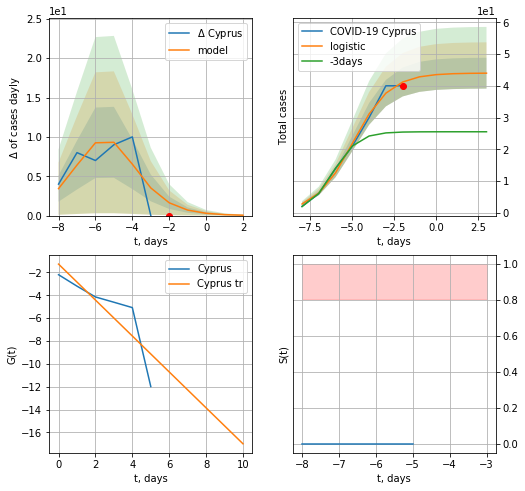

Cyprus data at: 2020-07-27
+3 day model MAPE: 0.6804910040725392
model: logistic
coeffs:  [44.00930085  0.89972657 -4.98223467]
rational stdev:  0.11057143028380123
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  43 ± 4
	 total death:  0 ± 0
trend coefficient of determination: 0.714597
 intercept: -1.270285
 slope: -1.572073


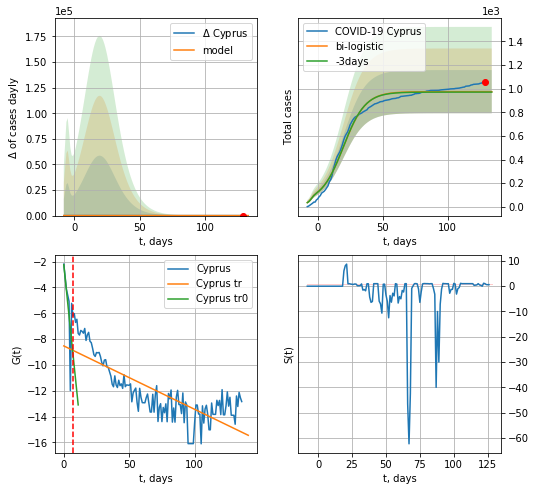

Cyprus data at: 2020-07-27
+3 day model MAPE: 0.003678029564873757
model: bi-logistic
coeffs:  [9.30863264e+02 1.17831781e-01 1.98628678e+01] [44.00930085  0.89972657 -4.98223467]
rational stdev:  0.18743868590808285
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  974 ± 182
	 total death:  17 ± 9
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.449603
 intercept: -2.247366
 slope: -0.985825
trend coefficient of determination: 0.634775
 intercept: -8.527620
 slope: -0.049046


In [1831]:
try:
    dfCP = read_df(pd.DataFrame(),"CP")
    dfCP = dfCP.fillna(0)
    x = forecast("Cyprus",dfCP[:7],d1,7*18-dT)
    xx = forecast2("Cyprus",dfCP[:],d1,18*7-dT,x,addpred=False,xcoef=[0.25,1.,2.3],vL=7)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


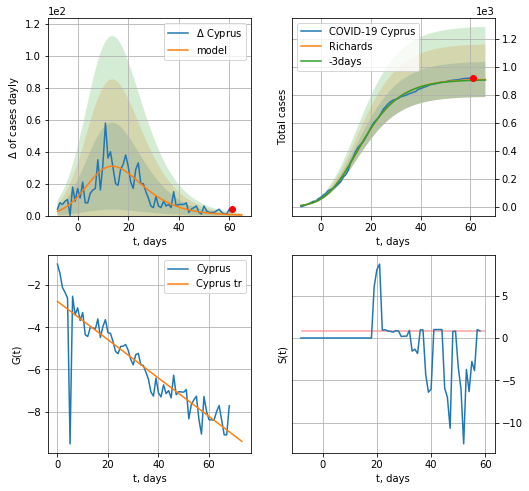

Cyprus data at: 2020-07-27
+3 day model MAPE: 0.004368
model: Richards
coeffs: [9.11933821e+02 3.20830805e-01 3.99756469e+00 3.34642836e-01]
rational stdev: 0.137523
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 908 ± 124
	 total death: 16 ± 6
trend coefficient of determination: 0.787996
 intercept: -2.772129
 slope: -0.090979


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


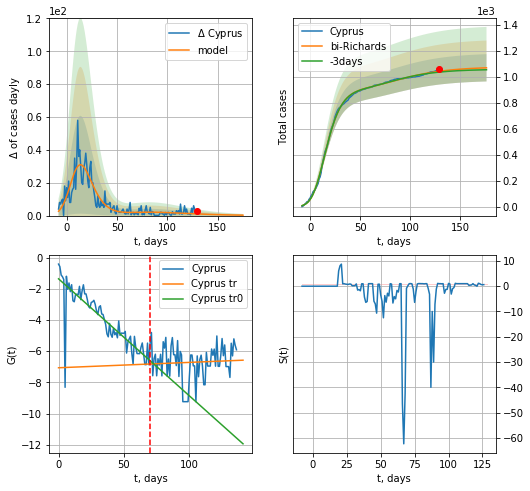

Cyprus data at: 2020-07-27
+3 day model MAPE: 0.006425
model: bi-Richards
coeffs: [ 1.65104870e+02  5.80583791e+00 -6.82677975e+01  5.77474771e-03]
rational stdev: 0.098052
forecast at the end of period: +47 days
	 deltaDaycases: 0
	 total cases: 1069 ± 104
	 total death: 19 ± 5
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.727982
 intercept: -1.359088
 slope: -0.075021
trend coefficient of determination: 0.003543
 intercept: -7.060910
 slope: 0.003440


In [1833]:
vL=70
x = forecastRR("Cyprus",dfCP[:vL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
x = forecast2RR("Cyprus",dfCP[:],d1,24*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


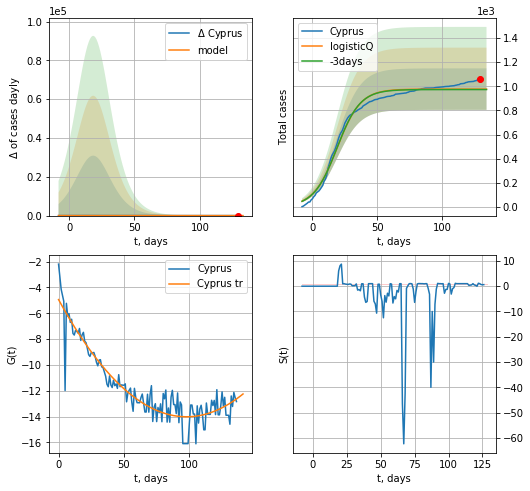

Cyprus data at: 2020-07-27
+3 day model MAPE: 0.003618
model: logisticQ
coeffs: [ 9.76622187e+02  1.93892664e-07  1.89363924e+01 -5.71434377e+05]
rational stdev: 0.176176
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 976 ± 172
	 total death: 17 ± 8
trend coefficient of determination: 0.869681
 intercept_: -4.942538339235208
 coeffs_: [ 0.         -0.18535708  0.00094721]


In [1834]:
vL=33
x = forecastRRR("Cyprus",dfCP[:],d1,18*7-dT,addpred=False,xcoef=koreaCoeffs)
#xx = forecast2RRR("Cyprus",dfCP[:],d1,20*7-dT,x,addpred=True,xcoef=[0.35,.5,4,1],vL=vL)

PU
           date   cases   active    death
138 2020-07-23  371096  97497.0  17654.0
139 2020-07-24  375961  98695.0  17843.0
140 2020-07-25  379884  98724.0  18030.0
141 2020-07-26  384797  98718.0  18229.0
142 2020-07-27  389717  98752.0  18418.0


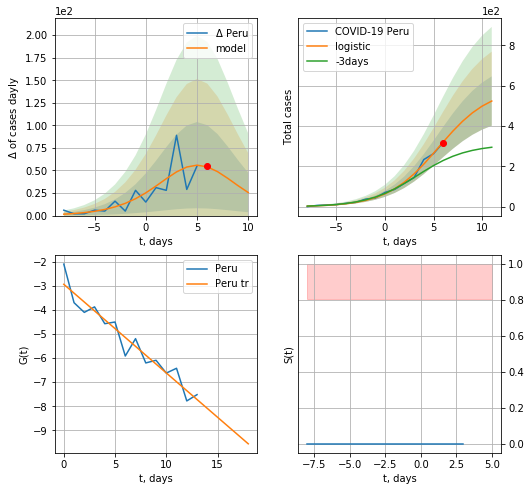

Peru data at: 2020-07-27
+3 day model MAPE: 0.4976759510371563
model: logistic
coeffs:  [5.88914141e+02 3.80777382e-01 5.52424877e+00]
rational stdev:  0.23355774891059702
forecast at the end of period: +5 days
	 deltaDaycases:  25
	 total cases:  523 ± 122
	 total death:  24 ± 16
trend coefficient of determination: 0.924015
 intercept: -2.937528
 slope: -0.367722


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


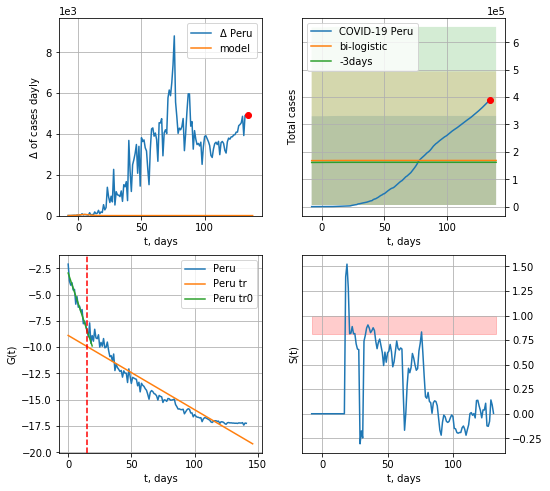

Peru data at: 2020-07-27
+3 day model MAPE: 0.041369526334770555
model: bi-logistic
coeffs:  [ 1.34321173e+05 -1.66795936e+01  4.07937697e+02] [5.88914141e+02 3.80777382e-01 5.52424877e+00]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.9650028280087624
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  168490 ± 162593
	 total death:  7962 ± 23050
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.936345
 intercept: -2.948740
 slope: -0.365135
trend coefficient of determination: 0.907158
 intercept: -8.886072
 slope: -0.070629


In [1835]:
dfPU = read_df(pd.DataFrame(),"PU")
dfPU = dfPU.fillna(0)
x = forecast("Peru",dfPU[:15],d1,7*18-dT)
xx = forecast2("Peru",dfPU[:],d1,18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=15)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


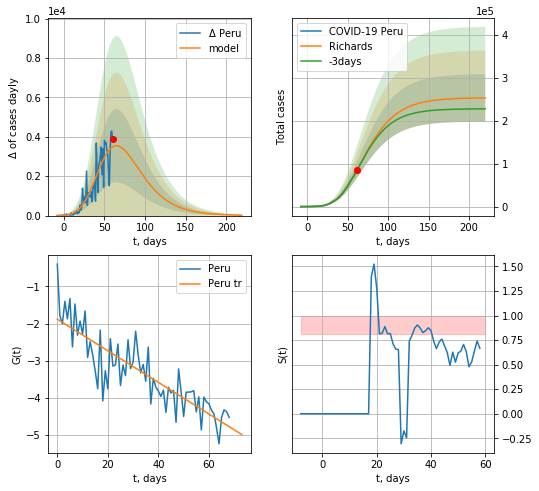

Peru data at: 2020-07-27
+3 day model MAPE: 0.004154
model: Richards
coeffs: [2.53863506e+05 3.16853284e-01 1.42828252e+01 1.27510046e-01]
rational stdev: 0.217550
forecast at the end of period: +159 days
	 deltaDaycases: 20
	 total cases: 253374 ± 55121
	 total death: 11974 ± 7814
trend coefficient of determination: 0.729631
 intercept: -1.882711
 slope: -0.042524


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


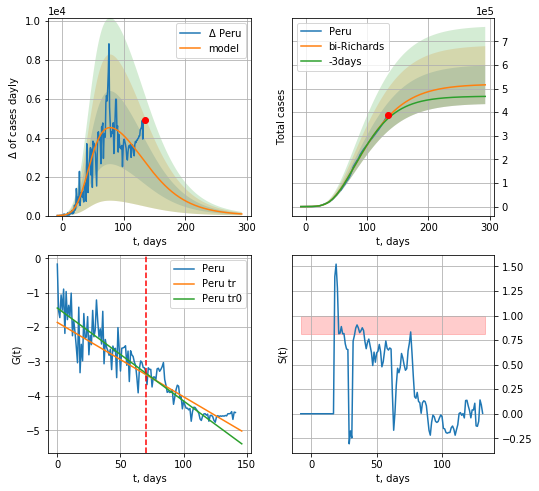

Peru data at: 2020-07-27
+3 day model MAPE: 0.017714
model: bi-Richards
coeffs: [ 2.65588037e+05  2.87862705e+00 -7.66883927e+01  8.57939480e-03]
rational stdev: 0.158535
forecast at the end of period: +159 days
	 deltaDaycases: 83
	 total cases: 516093 ± 81818
	 total death: 24390 ± 11599
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.546931
 intercept: -1.446695
 slope: -0.027027
trend coefficient of determination: 0.765813
 intercept: -1.864397
 slope: -0.021626


In [1836]:
vL = 70
x = forecastRR("Peru",dfPU[:vL],d1,40*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Peru",dfPU[:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR("Peru",dfPU[:],d1,36*7-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


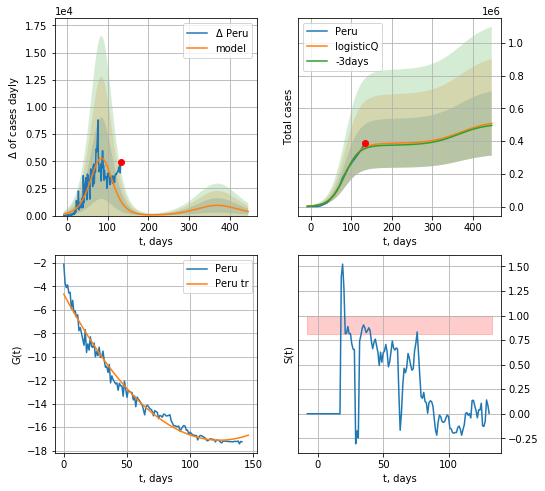

Peru data at: 2020-07-27
+3 day model MAPE: 0.020808
model: logisticQ
coeffs: [ 3.86548497e+05  3.13448249e-07  8.49764818e+01 -1.74388974e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.386882
forecast at the end of period: +313 days
	 deltaDaycases: 367
	 total cases: 508616 ± 196774
	 total death: 24037 ± 27898
trend coefficient of determination: 0.980484
 intercept_: -4.661653990088492
 coeffs_: [ 0.         -0.20215526  0.00082063]


In [1837]:
x = forecastRRR("Peru",dfPU[:].fillna(0),d1,62*7-dT,addpred=True,xcoef=koreaCoeffs)

ID
           date    cases    active    death
145 2020-07-23  1290284  441889.0  30657.0
146 2020-07-24  1339067  457347.0  31425.0
147 2020-07-25  1389097  469675.0  32127.0
148 2020-07-26  1437976  486244.0  32826.0
149 2020-07-27  1484136  496671.0  33461.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


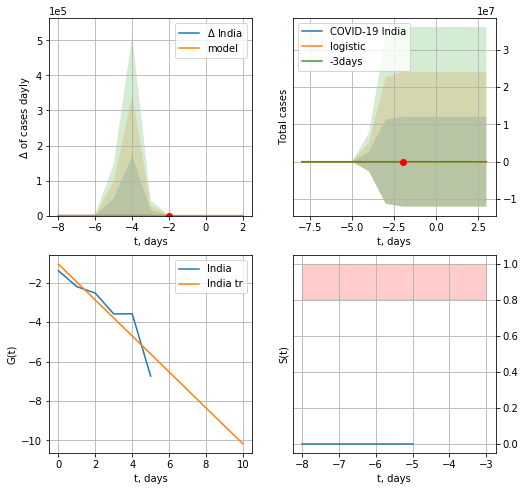

India data at: 2020-07-27
+3 day model MAPE: 0.19486002826260063
model: logistic
coeffs:  [29.4003363   4.01436821 -3.67575825]
rational stdev:  409417.6299021335
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  29 ± 12037016
	 total death:  0 ± 0
trend coefficient of determination: 0.835838
 intercept: -1.052904
 slope: -0.912220


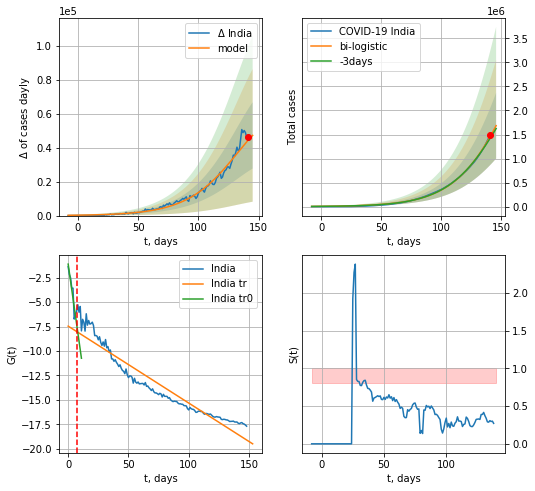

India data at: 2020-07-27
+3 day model MAPE: 0.027184632452504572
model: bi-logistic
coeffs:  [5.21719710e+06 4.16029555e-02 1.63858455e+02] [29.4003363   4.01436821 -3.67575825]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.40657595560704296
forecast at the end of period: +5 days
	 deltaDaycases:  47166
	 total cases:  1684476 ± 684867
	 total death:  37977 ± 46321
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.879788
 intercept: -1.115653
 slope: -0.874570
trend coefficient of determination: 0.911866
 intercept: -7.454758
 slope: -0.078622


In [1838]:
dfID = read_df(pd.DataFrame(),"ID")
dfID = dfID.fillna(0)
x = forecast("India",dfID[:7],d1,7*18-dT)
xx = forecast2("India",dfID[:],d1,18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=7)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


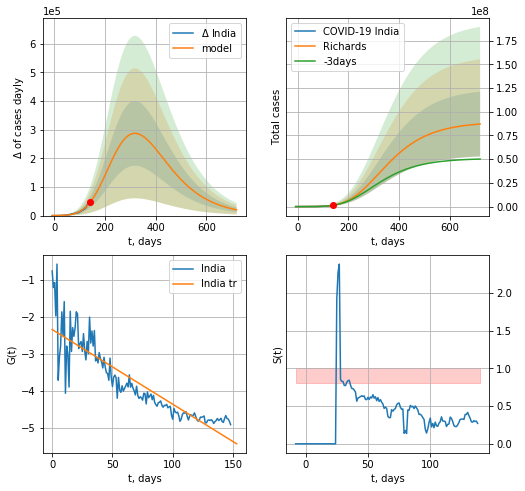

India data at: 2020-07-27
+3 day model MAPE: 0.019658
model: Richards
coeffs: [8.92829041e+07 9.08592631e-02 6.89724386e+01 1.01055463e-01]
rational stdev: 0.392084
forecast at the end of period: +579 days
	 deltaDaycases: 20093
	 total cases: 87073972 ± 34140279
	 total death: 1963150 ± 2309156
trend coefficient of determination: 0.790128
 intercept: -2.340699
 slope: -0.020137


In [1839]:
x = forecastRR("India",dfID[:],d1,100*7-dT,addpred=False,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


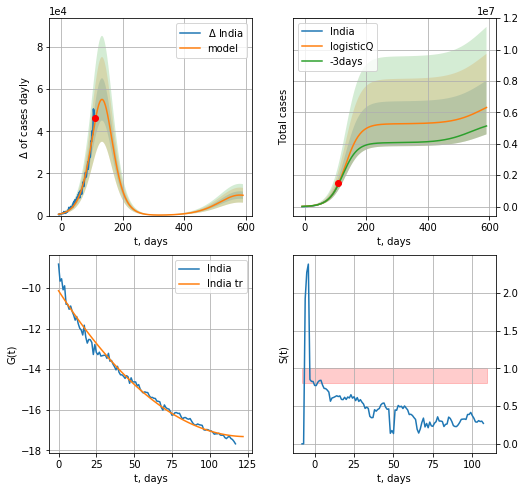

India data at: 2020-07-27
+3 day model MAPE: 0.026939
model: logisticQ
coeffs: [ 5.27234750e+06  3.18772608e-06  1.33111305e+02 -1.29779922e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.270976
forecast at the end of period: +481 days
	 deltaDaycases: 9627
	 total cases: 6310956 ± 1710120
	 total death: 142285 ± 115667
trend coefficient of determination: 0.986772
 intercept_: -10.135564772843907
 coeffs_: [ 0.         -0.11540494  0.00046303]


In [1840]:
x = forecastRRR("India",dfID[31:].fillna(0),d1,86*7-dT,addpred=True,xcoef=koreaCoeffs)

AG
           date     cases   active   death
141 2020-07-23  148027.0  82510.0  2702.0
142 2020-07-24  153520.0  85266.0  2807.0
143 2020-07-25  158334.0  87419.0  2893.0
144 2020-07-26  162526.0  89069.0  2939.0
145 2020-07-27  167416.0  91782.0  3059.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


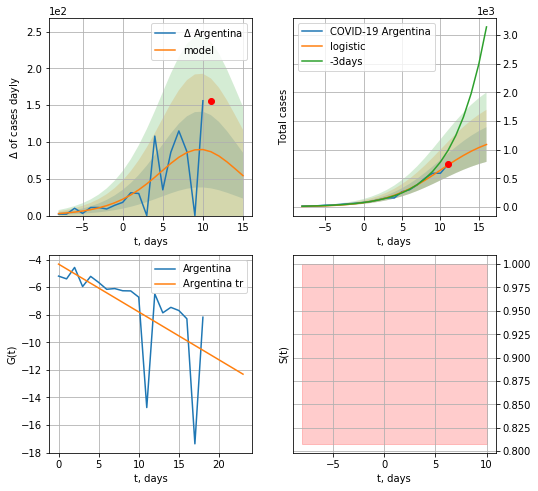

Argentina data at: 2020-07-27
+3 day model MAPE: 0.34277903234874524
model: logistic
coeffs:  [1.30607345e+03 2.75914265e-01 1.01155997e+01]
rational stdev:  0.27772613105407934
forecast at the end of period: +5 days
	 deltaDaycases:  54
	 total cases:  1090 ± 302
	 total death:  19 ± 15
trend coefficient of determination: 0.364190
 intercept: -4.325611
 slope: -0.347113


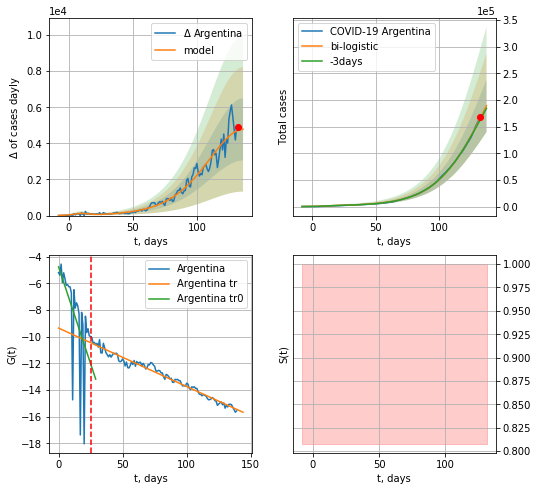

Argentina data at: 2020-07-27
+3 day model MAPE: 0.01928139421217831
model: bi-logistic
coeffs:  [3.76300829e+05 5.07756019e-02 1.37060132e+02] [1.30607345e+03 2.75914265e-01 1.01155997e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.26057470362467566
forecast at the end of period: +5 days
	 deltaDaycases:  4779
	 total cases:  189258 ± 49315
	 total death:  3458 ± 2703
bi-logistic approximation splitting point: 25
trend0 coefficient of determination: 0.360462
 intercept: -4.766843
 slope: -0.290012
trend coefficient of determination: 0.972667
 intercept: -9.355073
 slope: -0.043779


In [1841]:
vL = 25
#vL1 = 40
dfAG = read_df(pd.DataFrame(),"AG")
x = forecast('Argentina',dfAG[5:vL],d1,7*18-dT,1.0)
xx = forecast2('Argentina',dfAG[5:],d1,18*7-dT,x,1.0,vL=vL,addpred=True,xcoef=[.25,1.,2.0])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Argentina",dfAG[5:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

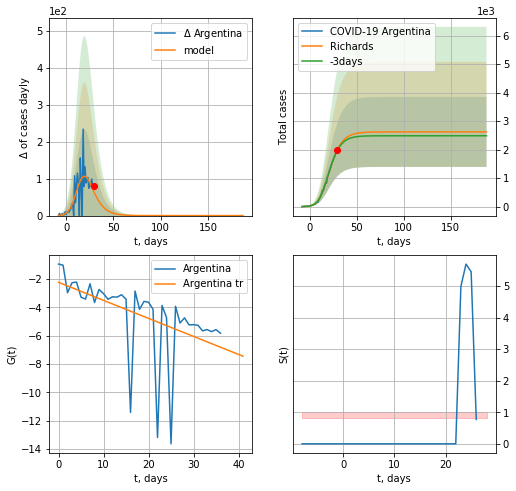

Argentina data at: 2020-07-27
+3 day model MAPE: 0.013138
model: Richards
coeffs: [2.62031767e+03 3.73237042e-01 1.15845098e+01 3.46306086e-01]
rational stdev: 0.468281
forecast at the end of period: +159 days
	 deltaDaycases: 0
	 total cases: 2620 ± 1227
	 total death: 47 ± 66
trend coefficient of determination: 0.244505
 intercept: -2.222432
 slope: -0.127357


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


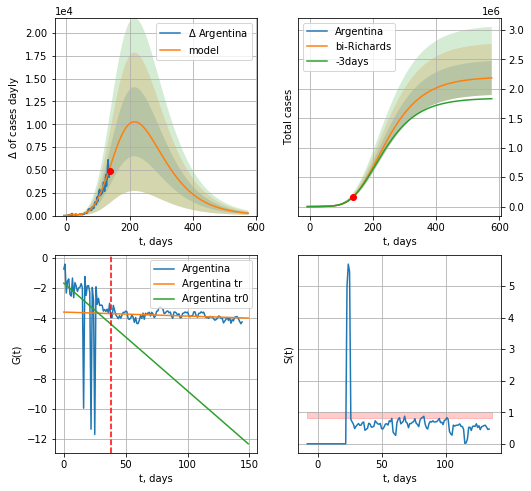

Argentina data at: 2020-07-27
+3 day model MAPE: 0.008197
model: bi-Richards
coeffs: [ 2.20044172e+06  2.21048609e-01 -3.33072216e-01  5.91502778e-02]
rational stdev: 0.132330
forecast at the end of period: +439 days
	 deltaDaycases: 258
	 total cases: 2183301 ± 288916
	 total death: 39892 ± 15836
bi-Richards approximation splitting point: 38
trend coefficient of determination: 0.100009
 intercept: -1.671654
 slope: -0.071534
trend coefficient of determination: 0.108802
 intercept: -3.592194
 slope: -0.002664


In [1842]:
vL = 38
x = forecastRR('Argentina',dfAG[:vL].fillna(0),d1,40*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Argentina',dfAG[:].fillna(0),d1,80*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


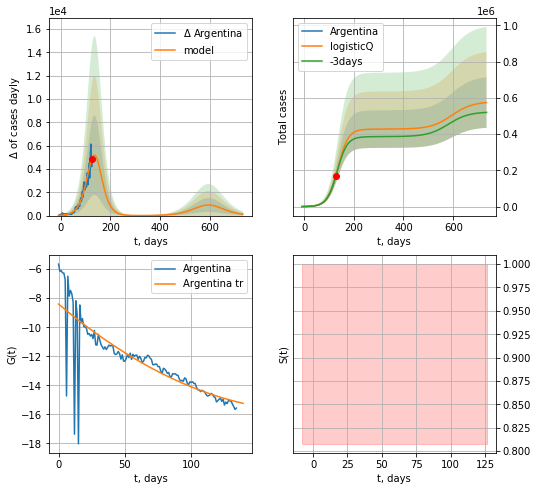

Argentina data at: 2020-07-27
+3 day model MAPE: 0.014082
model: logisticQ
coeffs: [ 4.27356934e+05  6.35981006e-06  1.36348462e+02 -7.48054723e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.242513
forecast at the end of period: +607 days
	 deltaDaycases: 119
	 total cases: 573638 ± 139115
	 total death: 10481 ± 7625
trend coefficient of determination: 0.689408
 intercept_: -8.404758799813301
 coeffs_: [ 0.         -0.07695613  0.00019998]


In [1843]:
x = forecastRRR('Argentina',dfAG[10:],d1,104*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


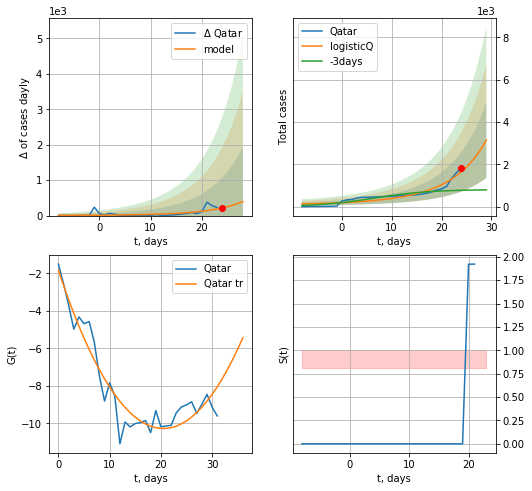

Qatar data at: 2020-07-27
+3 day model MAPE: 1.403665
model: logisticQ
coeffs: [ 4.67644951e+06  1.32940327e-03  6.79780107e+01 -1.11960184e+02]
rational stdev: 0.567221
forecast at the end of period: +5 days
	 deltaDaycases: 394
	 total cases: 3143 ± 1783
	 total death: 4 ± 6
trend coefficient of determination: 0.904406
 intercept_: -1.8341916285683908
 coeffs_: [ 0.         -0.82373816  0.02011068]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


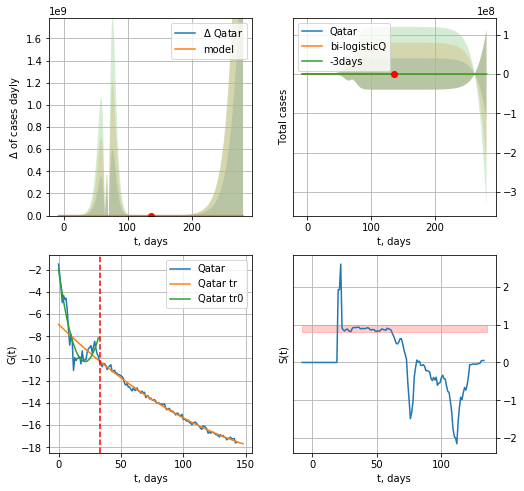

Qatar data at: 2020-07-27
+3 day model MAPE: 0.010126
model: bi-logisticQ
coeffs: [-4.58254878e+06  1.49191633e-03  6.79388053e+01 -9.66128341e+01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 425.273251
forecast at the end of period: +145 days
	 deltaDaycases: -22584
	 total cases: -264316 ± -112406654
	 total death: -397 ± -506500
bi-logisticQ approximation splitting point: 33
trend coefficient of determination: 0.887233
 intercept_: -1.9921673153050232
 coeffs_: [ 0.         -0.78114612  0.01840466]
trend coefficient of determination: 0.994477
 intercept_: -6.930305876363103
 coeffs_: [ 0.         -0.10812776  0.00023953]


In [1844]:
vL=33
x = forecastRRR('Qatar',dfQR[:vL].fillna(0),d1,7*18-dT,1.0,addpred=False,xcoef=[.35,.5,4.0,1])
xx = forecast2RRR('Qatar',dfQR[:].fillna(0),d1,38*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


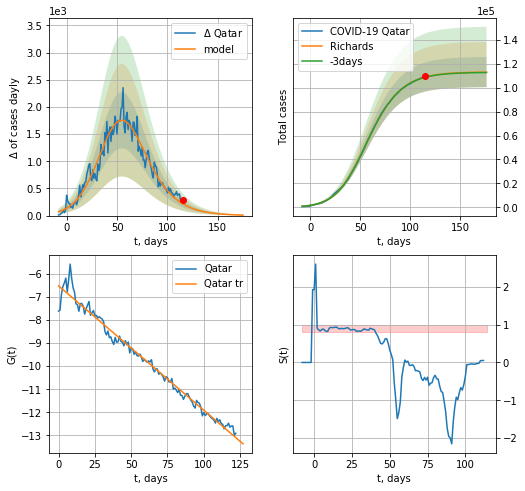

Qatar data at: 2020-07-27
+3 day model MAPE: 0.001874
model: Richards
coeffs: [1.13182151e+05 9.03591415e-02 4.58798807e+01 6.01389323e-01]
rational stdev: 0.111483
forecast at the end of period: +61 days
	 deltaDaycases: 8
	 total cases: 113022 ± 12600
	 total death: 170 ± 56
trend coefficient of determination: 0.979531
 intercept: -6.521942
 slope: -0.053860


In [1845]:
iL = 21
vL = 99 + iL
x = forecastRR('Qatar',dfQR[iL:].fillna(0),d1,26*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Qatar',dfQR[iL:].fillna(0),d1,60*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-iL)

In [1846]:
#x = forecast('Qatar',dfQR[:],d1,18*7-dT,1.0,addpred=True,xcoef=[.35,.5,4.0,1])

UAE
           date    cases  active  death
159 2020-07-23  57988.0    6798  342.0
160 2020-07-24  58249.0    6671  343.0
161 2020-07-25  58562.0    6591  343.0
162 2020-07-26  58913.0    6387  344.0
163 2020-07-27  59177.0    6322  345.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


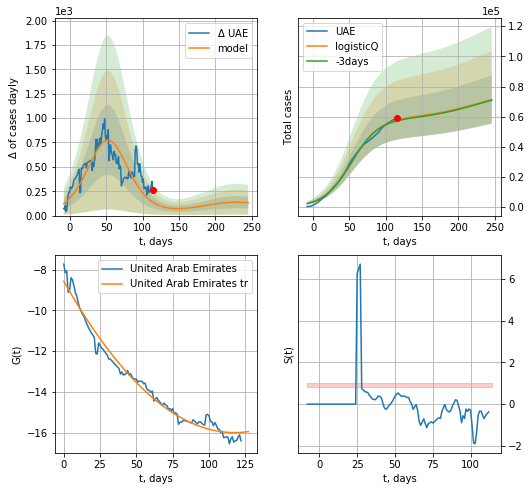

UAE data at: 2020-07-27
+3 day model MAPE: 0.008666
model: logisticQ
coeffs: [ 5.88589492e+04  2.45515723e-07  5.28621576e+01 -2.13119918e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.224779
forecast at the end of period: +131 days
	 deltaDaycases: 132
	 total cases: 71389 ± 16046
	 total death: 416 ± 280
trend coefficient of determination: 0.979237
 intercept_: -8.57614819927968
 coeffs_: [ 0.         -0.12620408  0.00053654]


In [1847]:
dfUAE = read_df(pd.DataFrame(),"UAE")
x = forecastRRR('UAE',dfUAE[40:],d1,36*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


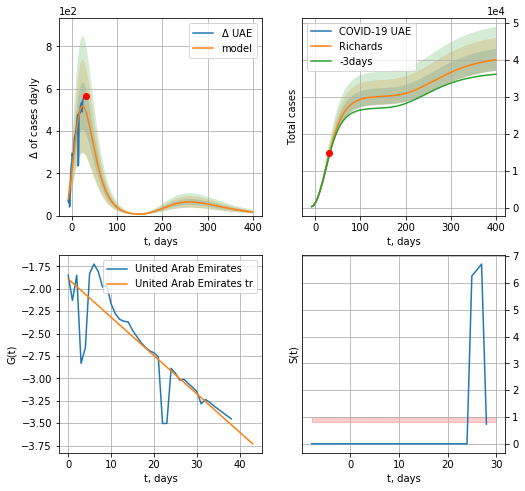

UAE data at: 2020-07-27
+3 day model MAPE: 0.022807
model: Richards
coeffs: [ 3.02157107e+04  2.32377536e+00 -5.83980795e+01  2.02399126e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.073933
forecast at the end of period: +369 days
	 deltaDaycases: 16
	 total cases: 40062 ± 2961
	 total death: 233 ± 51
trend coefficient of determination: 0.778768
 intercept: -1.889612
 slope: -0.042819


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


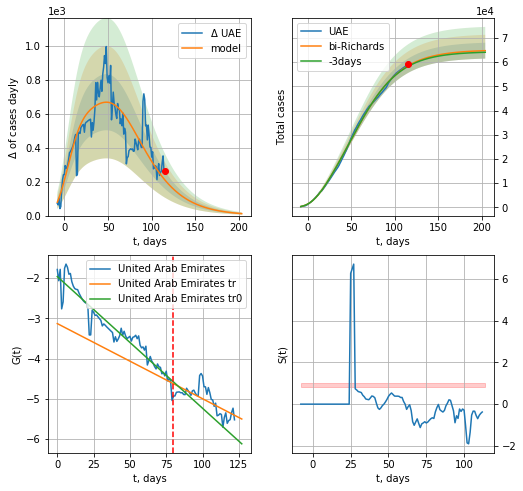

UAE data at: 2020-07-27
+3 day model MAPE: 0.004390
model: bi-Richards
coeffs: [ 3.48836676e+04  3.41148214e+00 -6.63783269e+01  1.00622290e-02]
rational stdev: 0.050527
forecast at the end of period: +89 days
	 deltaDaycases: 11
	 total cases: 64771 ± 3272
	 total death: 377 ± 57
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.914391
 intercept: -1.964225
 slope: -0.032715
trend coefficient of determination: 0.496900
 intercept: -3.131960
 slope: -0.018667


In [1848]:
iL = 40
vL = 80 + iL
x = forecastRR('UAE',dfUAE[iL:vL-iL],d1,70*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
xx = forecast2RR('UAE',dfUAE[iL:],d1,30*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#x = forecastQR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [1849]:
#plt.plot(range(len(dfUAE[45:])-1),np.log(np.log(np.log(np.diff(dfUAE[45:].cases)))))

SA
           date     cases  active   death
142 2020-07-23  260394.0   44269  2635.0
143 2020-07-24  262772.0   44369  2672.0
144 2020-07-25  264973.0   44488  2703.0
145 2020-07-26  266941.0   43885  2733.0
146 2020-07-27  268934.0   43238  2760.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


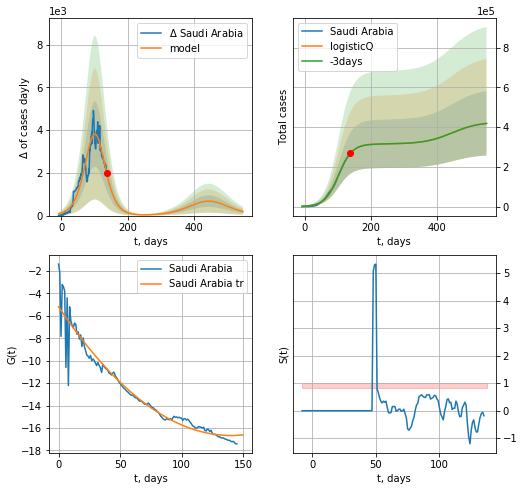

Saudi Arabia data at: 2020-07-27
+3 day model MAPE: 0.000825
model: logisticQ
coeffs: [ 3.15602352e+05  5.98566926e-07  1.02065913e+02 -8.06919526e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.385913
forecast at the end of period: +411 days
	 deltaDaycases: 187
	 total cases: 419143 ± 161752
	 total death: 4301 ± 4979
trend coefficient of determination: 0.933315
 intercept_: -5.190826292291162
 coeffs_: [ 0.         -0.16358504  0.00058293]


In [1850]:
dfSA = read_df(pd.DataFrame(),"SA")
x = forecastRRR('Saudi Arabia',dfSA[:],d1,76*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


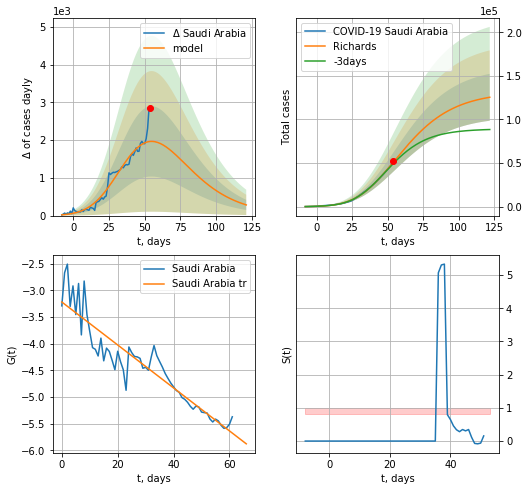

Saudi Arabia data at: 2020-07-27
+3 day model MAPE: 0.035873
model: Richards
coeffs: [1.31817079e+05 1.98592402e-01 2.23760353e+01 2.26893478e-01]
rational stdev: 0.214320
forecast at the end of period: +68 days
	 deltaDaycases: 282
	 total cases: 125485 ± 26893
	 total death: 1287 ± 827
trend coefficient of determination: 0.862733
 intercept: -3.219410
 slope: -0.040287


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


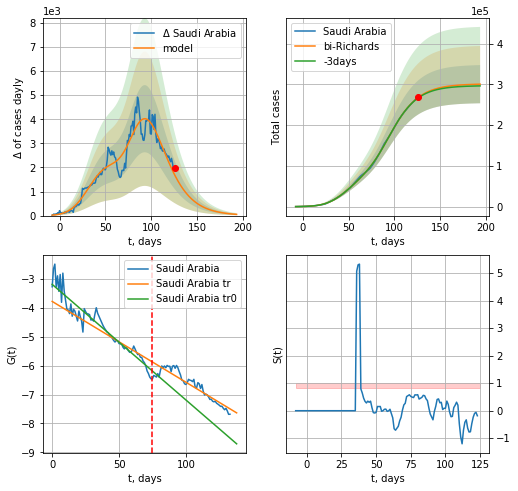

Saudi Arabia data at: 2020-07-27
+3 day model MAPE: 0.004381
model: bi-Richards
coeffs: [1.69574181e+05 2.57238871e-01 7.04406288e+01 2.22232359e-01]
rational stdev: 0.155875
forecast at the end of period: +68 days
	 deltaDaycases: 49
	 total cases: 300485 ± 46838
	 total death: 3083 ± 1441
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.910258
 intercept: -3.185245
 slope: -0.040020
trend coefficient of determination: 0.844168
 intercept: -3.776413
 slope: -0.027965


In [1851]:
x = forecastRR('Saudi Arabia',dfSA[12:75],d1,27*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Saudi Arabia',dfSA[12:],d1,27*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=75)
#x = forecastQR('Saudi Arabia',dfSA[12:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

Sri
           date   cases  active  death
135 2020-07-23  2753.0     665   11.0
136 2020-07-24  2764.0     659   11.0
137 2020-07-25  2770.0     656   11.0
138 2020-07-26  2782.0     665   11.0
139 2020-07-27  2805.0     673   11.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


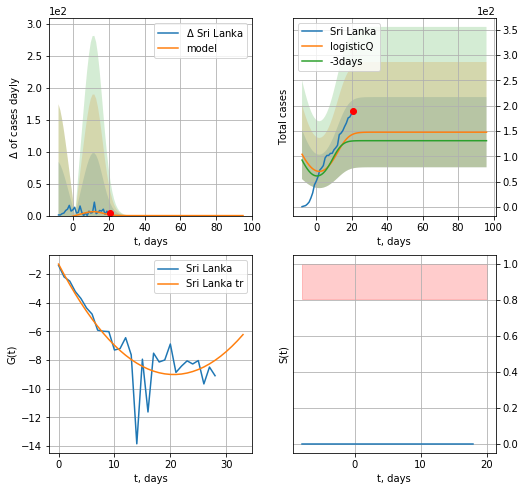

Sri Lanka data at: 2020-07-27
+3 day model MAPE: 0.111838
model: logisticQ
coeffs: [ 1.47873593e+02  1.02177717e-02  4.75700419e+00 -1.32326165e+00]
rational stdev: 0.468204
forecast at the end of period: +75 days
	 deltaDaycases: 0
	 total cases: 147 ± 69
	 total death: 0 ± 0
trend coefficient of determination: 0.737116
 intercept_: -1.300425972375204
 coeffs_: [ 0.         -0.74879164  0.01816974]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:294: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:333: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


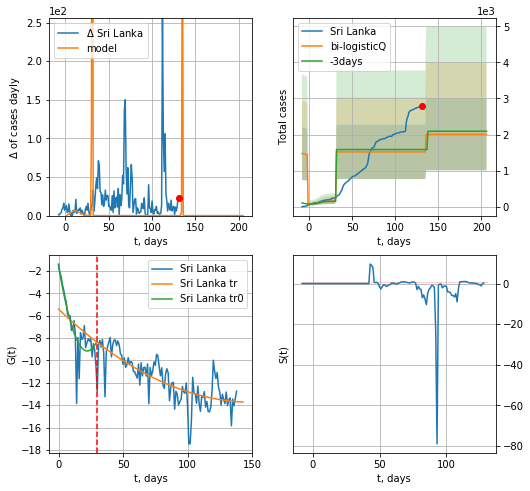

Sri Lanka data at: 2020-07-27
+3 day model MAPE: 0.041280
model: bi-logisticQ
coeffs: [1370.22811344    5.91221267   31.0128003    -1.73370508]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.496153
forecast at the end of period: +75 days
	 deltaDaycases: 0
	 total cases: 2003 ± 993
	 total death: 7 ± 10
bi-logisticQ approximation splitting point: 30
trend coefficient of determination: 0.725855
 intercept_: -1.5084890363019623
 coeffs_: [ 0.         -0.68634546  0.01540158]
trend coefficient of determination: 0.582655
 intercept_: -5.408997349398181
 coeffs_: [ 0.         -0.11036819  0.00036522]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [1852]:
dfSri = read_df(pd.DataFrame(),"Sri")
vL= 30
x = forecastRRR('Sri Lanka',dfSri[:vL],d1,28*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Sri Lanka',dfSri[:],d1,28*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

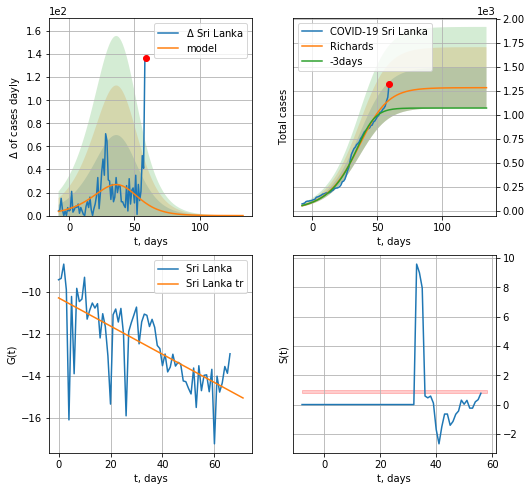

Sri Lanka data at: 2020-07-27
+3 day model MAPE: 0.103361
model: Richards
coeffs: [1.28171157e+03 6.47995832e-02 4.07030001e+01 1.48770145e+00]
rational stdev: 0.164364
forecast at the end of period: +75 days
	 deltaDaycases: 0
	 total cases: 1281 ± 210
	 total death: 5 ± 2
trend coefficient of determination: 0.481079
 intercept: -10.284657
 slope: -0.067327


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


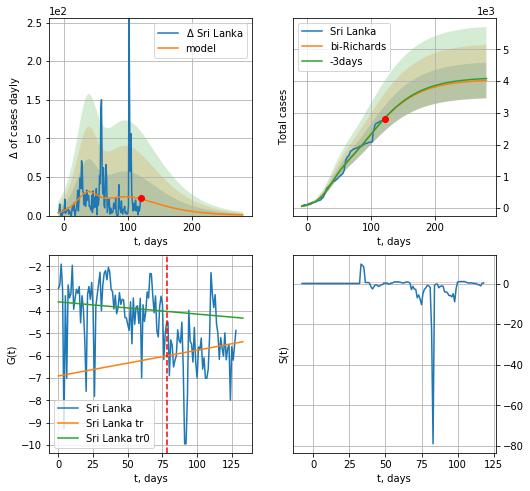

Sri Lanka data at: 2020-07-27
+3 day model MAPE: 0.002686
model: bi-Richards
coeffs: [ 2.77517411e+03  2.85919500e+00 -1.03484381e+02  8.28316571e-03]
rational stdev: 0.139862
forecast at the end of period: +159 days
	 deltaDaycases: 0
	 total cases: 4019 ± 562
	 total death: 15 ± 6
bi-Richards approximation splitting point: 78
trend coefficient of determination: 0.008437
 intercept: -3.592646
 slope: -0.005465
trend coefficient of determination: 0.014977
 intercept: -6.906111
 slope: 0.011515


In [1853]:
vL=88
x = forecastRR('Sri Lanka',dfSri[10:vL-10],d1,28*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Sri Lanka',dfSri[10:],d1,40*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-10)
#x = forecastQR('Sri Lanka',dfSri[10:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

PS
           date     cases  active   death
147 2020-07-23  270400.0   44854  5763.0
148 2020-07-24  271887.0   29504  5787.0
149 2020-07-25  273113.0   29857  5822.0
150 2020-07-26  274289.0   27421  5842.0
151 2020-07-27  275225.0   26924  5865.0


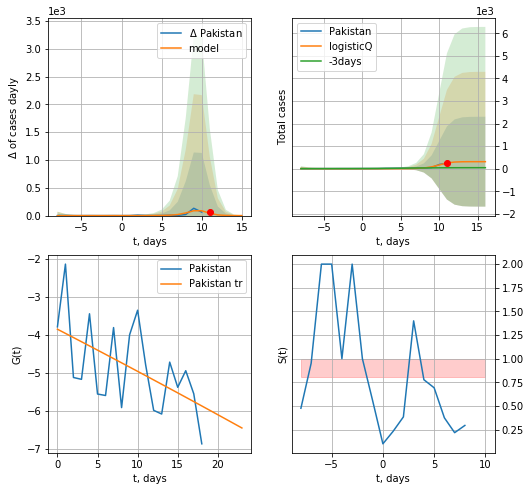

Pakistan data at: 2020-07-27
+3 day model MAPE: 5.954392
model: logisticQ
coeffs: [ 3.10300108e+02  5.80299149e-02  9.88962592e+00 -1.18245382e+01]
rational stdev: 6.420495
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 310 ± 1992
	 total death: 6 ± 115
trend coefficient of determination: 0.293073
 intercept_: -3.8498114630651457
 coeffs_: [ 0.         -0.10964083 -0.00016191]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


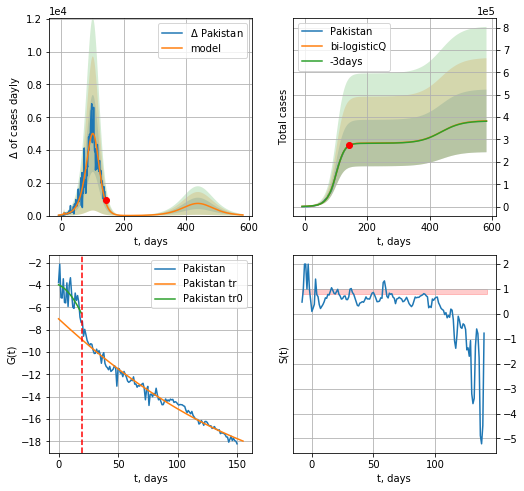

Pakistan data at: 2020-07-27
+3 day model MAPE: 0.002339
model: bi-logisticQ
coeffs: [ 2.83502552e+05  1.49567040e-04  1.00187217e+02 -3.70971411e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.365574
forecast at the end of period: +439 days
	 deltaDaycases: 38
	 total cases: 382986 ± 140010
	 total death: 8161 ± 8950
bi-logisticQ approximation splitting point: 20
trend coefficient of determination: 0.391568
 intercept_: -3.9808806978581046
 coeffs_: [ 0.         -0.04620278 -0.00453428]
trend coefficient of determination: 0.974548
 intercept_: -7.024480538625181
 coeffs_: [ 0.         -0.098581    0.00018064]


In [1854]:
dfPS = read_df(pd.DataFrame(),"PS")
vL= 20
x = forecastRRR('Pakistan',dfPS[:vL],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Pakistan',dfPS[:],d1,80*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


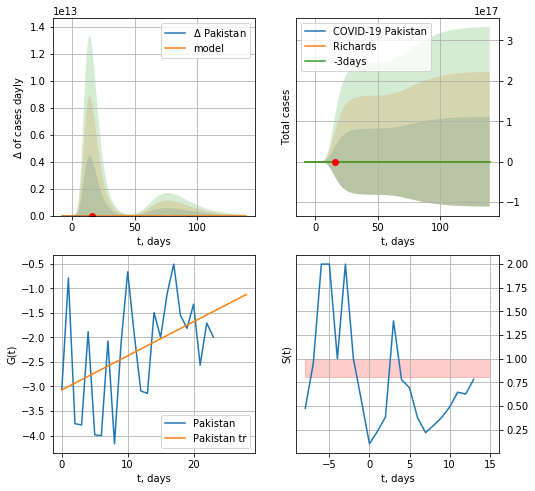

Pakistan data at: 2020-07-27
+3 day model MAPE: 0.118203
model: Richards
coeffs: [ 1.63838701e+03  6.06255652e+00 -3.11642699e+00  3.19416608e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 49944222119087.820312
forecast at the end of period: +124 days
	 deltaDaycases: 0
	 total cases: 2223 ± 111033194860308944
	 total death: 47 ± 7042135318791382
trend coefficient of determination: 0.194578
 intercept: -3.069491
 slope: 0.069432


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


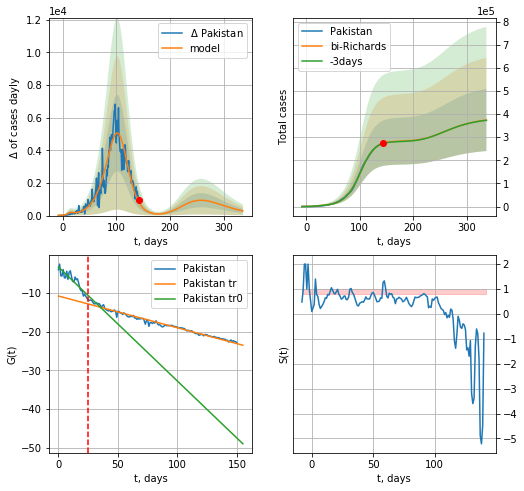

Pakistan data at: 2020-07-27
+3 day model MAPE: 0.003807
model: bi-Richards
coeffs: [2.81743101e+05 5.83161121e-02 1.06108190e+02 1.37155729e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.358465
forecast at the end of period: +194 days
	 deltaDaycases: 287
	 total cases: 374333 ± 134185
	 total death: 7976 ± 8577
bi-Richards approximation splitting point: 25
trend coefficient of determination: 0.797015
 intercept: -3.394592
 slope: -0.293698
trend coefficient of determination: 0.977812
 intercept: -10.861840
 slope: -0.081744


In [1855]:
vL = 25
x = forecastRR('Pakistan',dfPS[:vL],d1,35*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
xx = forecast2RR('Pakistan',dfPS[:],d1,45*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Pakistan',dfPS[:],d1,48*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

BN
           date     cases  active   death
137 2020-07-23  216110.0   94101  2801.0
138 2020-07-24  218658.0   94846  2836.0
139 2020-07-25  221178.0   96214  2874.0
140 2020-07-26  223453.0   96643  2928.0
141 2020-07-27  226225.0   97577  2965.0


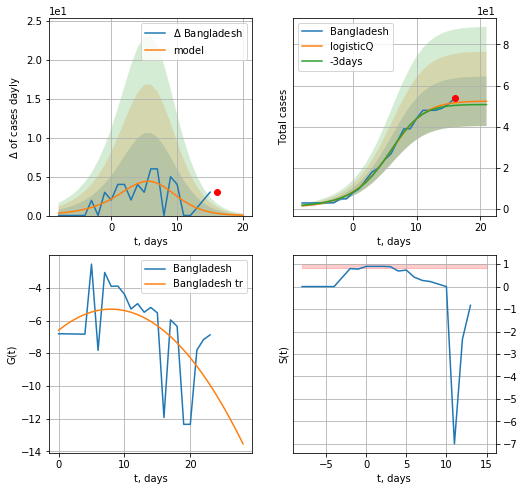

Bangladesh data at: 2020-07-27
+3 day model MAPE: 0.027574
model: logisticQ
coeffs: [ 5.24923910e+01  5.83606353e-03  5.49443194e+00 -5.18823422e+01]
rational stdev: 0.229682
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 52 ± 12
	 total death: 0 ± 0
trend coefficient of determination: 0.276192
 intercept_: -6.599187027141191
 coeffs_: [ 0.          0.32583568 -0.02049035]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


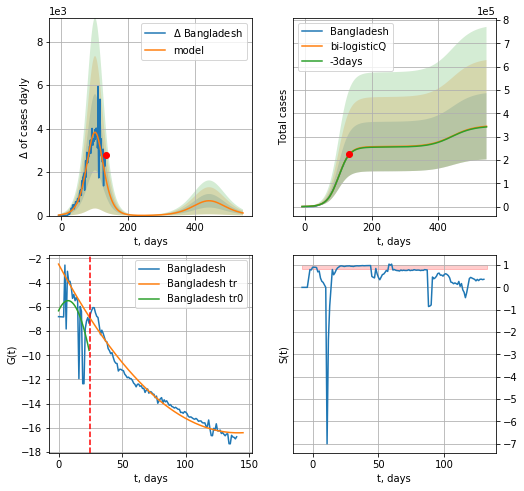

Bangladesh data at: 2020-07-27
+3 day model MAPE: 0.004607
model: bi-logisticQ
coeffs: [ 2.57492641e+05  1.15395782e-06  1.01394112e+02 -5.14767914e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.412462
forecast at the end of period: +411 days
	 deltaDaycases: 119
	 total cases: 344625 ± 142144
	 total death: 4516 ± 5588
bi-logisticQ approximation splitting point: 25
trend coefficient of determination: 0.232653
 intercept_: -6.325425729788838
 coeffs_: [ 0.          0.22449345 -0.0150245 ]
trend coefficient of determination: 0.972237
 intercept_: -2.4700992407571807
 coeffs_: [ 0.         -0.1973833   0.00069892]


In [1856]:
dfBN = read_df(pd.DataFrame(),"BN")
vL= 25
try:
    x = forecastRRR('Bangladesh',dfBN[:vL],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
    xx = forecast2RRR('Bangladesh',dfBN[:],d1,76*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)
except:
    print ("Exception occurs")

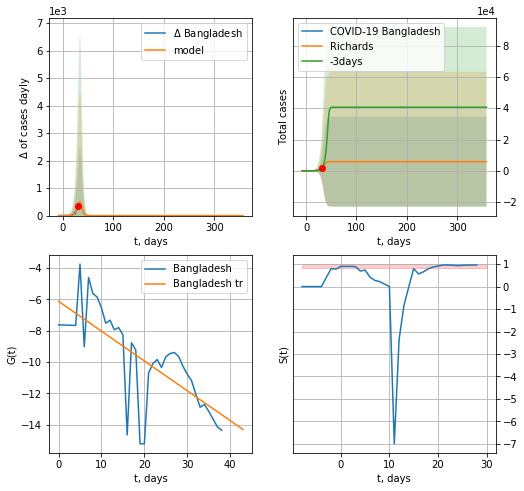

Bangladesh data at: 2020-07-27
+3 day model MAPE: 0.079004
model: Richards
coeffs: [5.83662075e+03 2.41285864e-01 3.62036516e+01 1.74331712e+00]
rational stdev: 4.915459
forecast at the end of period: +327 days
	 deltaDaycases: 0
	 total cases: 5836 ± 28689
	 total death: 76 ± 1120
trend coefficient of determination: 0.544590
 intercept: -6.123432
 slope: -0.190441


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


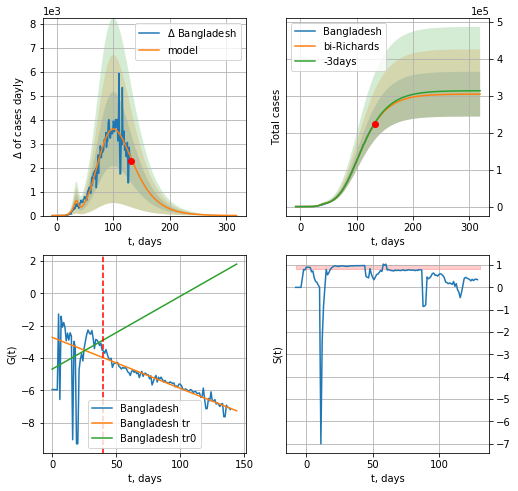

Bangladesh data at: 2020-07-27
+3 day model MAPE: 0.005359
model: bi-Richards
coeffs: [2.98996118e+05 1.72742935e-01 5.77448028e+01 2.10069188e-01]
rational stdev: 0.199270
forecast at the end of period: +187 days
	 deltaDaycases: 4
	 total cases: 304724 ± 60722
	 total death: 3993 ± 2387
bi-Richards approximation splitting point: 40
trend coefficient of determination: 0.065856
 intercept: -4.679708
 slope: 0.044977
trend coefficient of determination: 0.943152
 intercept: -2.722509
 slope: -0.031474


In [1857]:
vL=40
x = forecastRR('Bangladesh',dfBN[:vL],d1,64*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Bangladesh',dfBN[:-1],d1,44*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Bangladesh',dfBN[:],d1,16*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

KW
           date    cases  active  death
150 2020-07-23  61872.0    9204  421.0
151 2020-07-24  62625.0    9285  425.0
152 2020-07-25  63309.0    9273  429.0
153 2020-07-26  63773.0    8967  433.0
154 2020-07-27  64379.0    8884  438.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


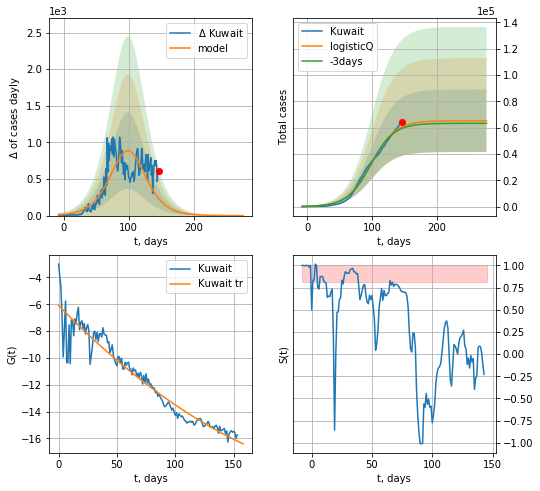

Kuwait data at: 2020-07-27
+3 day model MAPE: 0.020002
model: logisticQ
coeffs: [ 6.53028065e+04  2.33443324e-07  9.91602383e+01 -2.32596541e+05]
rational stdev: 0.364201
forecast at the end of period: +131 days
	 deltaDaycases: 0
	 total cases: 65298 ± 23781
	 total death: 444 ± 485
trend coefficient of determination: 0.923406
 intercept_: -6.08333524968683
 coeffs_: [ 0.         -0.08955636  0.00015347]


In [1858]:
dfKW = read_df(pd.DataFrame(),"KW")
x = forecastRRR('Kuwait',dfKW[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


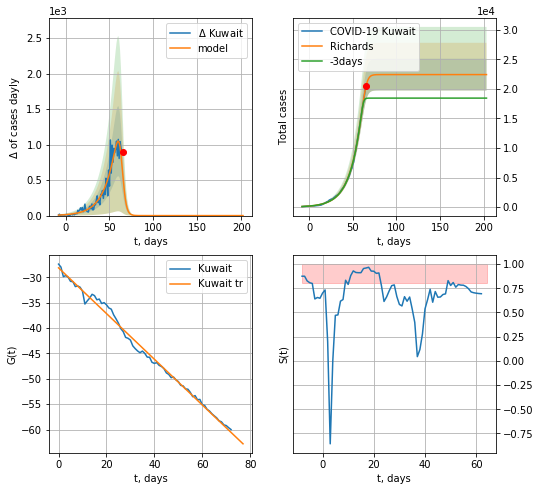

Kuwait data at: 2020-07-27
+3 day model MAPE: 0.136577
model: Richards
coeffs: [2.24365718e+04 7.66634183e-02 6.43548409e+01 5.72971780e+00]
rational stdev: 0.119998
forecast at the end of period: +138 days
	 deltaDaycases: 0
	 total cases: 22436 ± 2692
	 total death: 152 ± 54
trend coefficient of determination: 0.993036
 intercept: -28.143720
 slope: -0.450232


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


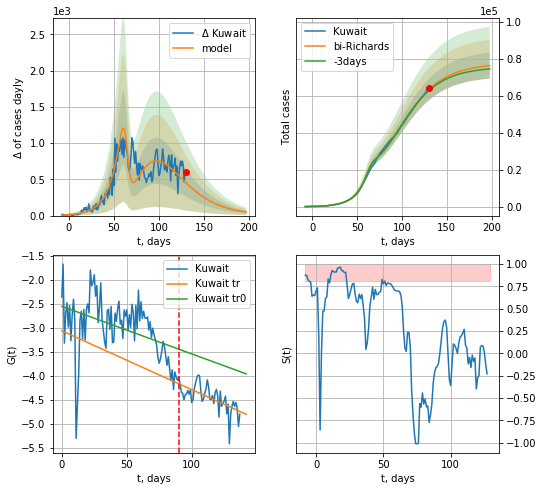

Kuwait data at: 2020-07-27
+3 day model MAPE: 0.008383
model: bi-Richards
coeffs: [ 5.52932146e+04  3.08295694e+00 -2.02587529e+01  1.21239796e-02]
rational stdev: 0.091577
forecast at the end of period: +68 days
	 deltaDaycases: 48
	 total cases: 76438 ± 7000
	 total death: 520 ± 142
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.173422
 intercept: -2.546318
 slope: -0.009941
trend coefficient of determination: 0.400750
 intercept: -3.058295
 slope: -0.012277


In [1859]:
iL= 16
vL = 90 + iL
x = forecastRR('Kuwait',dfKW[iL:vL-iL],d1,37*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Kuwait',dfKW[iL:],d1,27*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

DM
           date    cases  active   death
144 2020-07-23  57615.0   29704  1006.0
145 2020-07-24  59077.0   30416  1036.0
146 2020-07-25  60896.0   31861  1055.0
147 2020-07-26  62908.0   33242  1063.0
148 2020-07-27  64156.0   32869  1083.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


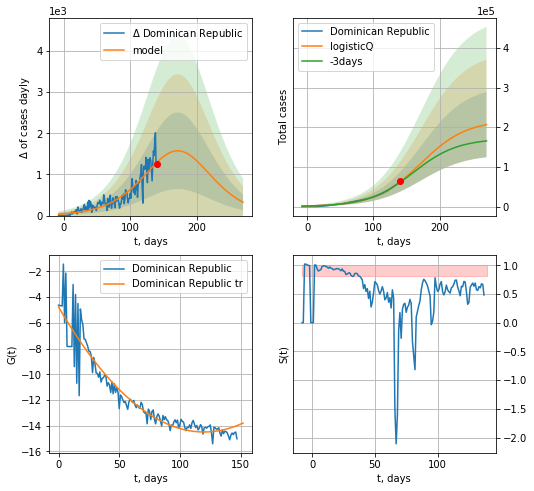

Dominican Republic data at: 2020-07-27
+3 day model MAPE: 0.024369
model: logisticQ
coeffs: [ 2.18129741e+05  1.05504047e-06  1.71821058e+02 -2.72015733e+04]
rational stdev: 0.397515
forecast at the end of period: +131 days
	 deltaDaycases: 325
	 total cases: 206477 ± 82077
	 total death: 3485 ± 4156
trend coefficient of determination: 0.889872
 intercept_: -4.770251886488003
 coeffs_: [ 0.         -0.16198006  0.00067527]


In [1860]:
dfDM = read_df(pd.DataFrame(),"DM")
x = forecastRRR('Dominican Republic',dfDM[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


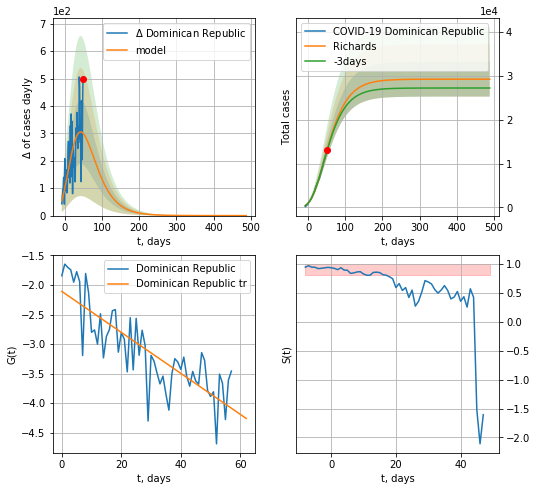

Dominican Republic data at: 2020-07-27
+3 day model MAPE: 0.011985
model: Richards
coeffs: [ 2.92636962e+04  1.52410692e+00 -9.56887865e+01  1.87798018e-02]
rational stdev: 0.135750
forecast at the end of period: +439 days
	 deltaDaycases: 0
	 total cases: 29263 ± 3972
	 total death: 493 ± 200
trend coefficient of determination: 0.671301
 intercept: -2.108314
 slope: -0.034707


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


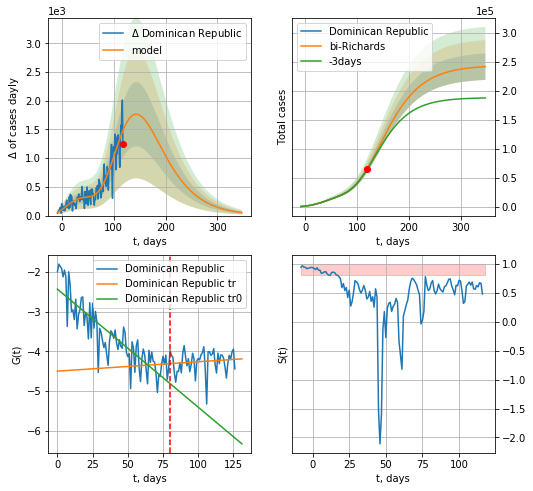

Dominican Republic data at: 2020-07-27
+3 day model MAPE: 0.010446
model: bi-Richards
coeffs: [2.14343987e+05 4.94801348e-01 6.85521610e+00 4.51512830e-02]
rational stdev: 0.094534
forecast at the end of period: +229 days
	 deltaDaycases: 52
	 total cases: 241290 ± 22810
	 total death: 4073 ± 1155
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.744049
 intercept: -2.429044
 slope: -0.029766
trend coefficient of determination: 0.013543
 intercept: -4.496316
 slope: 0.002365


In [1861]:
vL = 80+21
x = forecastRR('Dominican Republic',dfDM[21:vL-21],d1,80*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Dominican Republic',dfDM[21:],d1,50*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-21)

MD
           date    cases  active  death
138 2020-07-23  22105.0    6212  719.0
139 2020-07-24  22483.0    6350  726.0
140 2020-07-25  22828.0    6488  732.0
141 2020-07-26  23034.0    6390  735.0
142 2020-07-27  23154.0    5941  751.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


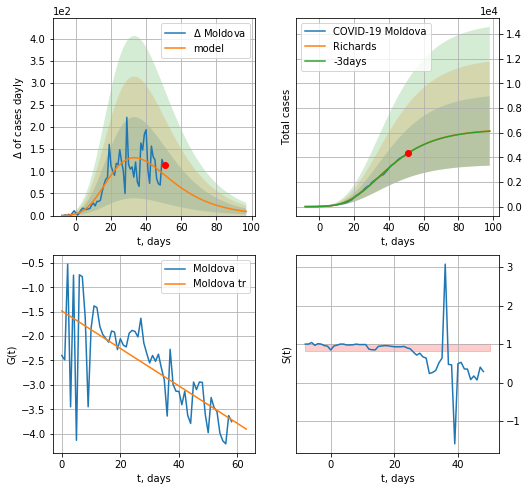

Moldova data at: 2020-07-27
+3 day model MAPE: 0.000798
model: Richards
coeffs: [ 6.30547519e+03  3.98861804e+00 -4.11482156e+01  1.42375767e-02]
rational stdev: 0.458356
forecast at the end of period: +47 days
	 deltaDaycases: 9
	 total cases: 6143 ± 2816
	 total death: 199 ± 273
trend coefficient of determination: 0.512178
 intercept: -1.485670
 slope: -0.038427


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


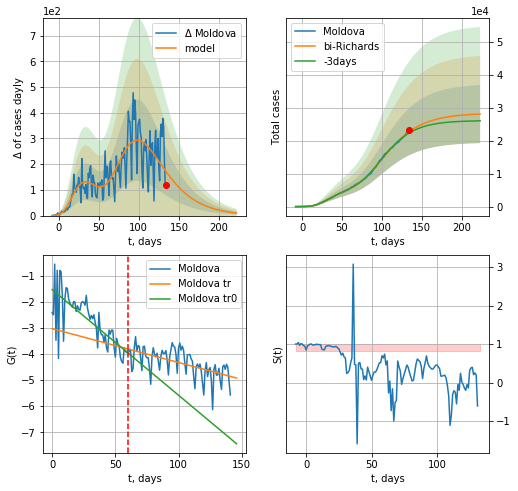

Moldova data at: 2020-07-27
+3 day model MAPE: 0.017920
model: bi-Richards
coeffs: [2.21058871e+04 1.15733068e+00 1.90078142e+00 3.07140739e-02]
rational stdev: 0.313861
forecast at the end of period: +89 days
	 deltaDaycases: 9
	 total cases: 28135 ± 8830
	 total death: 912 ± 858
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.555836
 intercept: -1.522652
 slope: -0.040562
trend coefficient of determination: 0.336142
 intercept: -3.024577
 slope: -0.012977


In [1862]:
dfMD = read_df(pd.DataFrame(),"MD")
dfMD = dfMD.fillna(0)
try:
    vL = 60
    x = forecastRR("Moldova",dfMD[:vL],d1,24*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("Moldova",dfMD[:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

In [1863]:
#np.diff(dfAF["cases"])

AF
           date     cases  active   death
140 2020-07-23  408052.0  165699  6093.0
141 2020-07-24  421996.0  169882  6343.0
142 2020-07-25  434200.0  164491  6655.0
143 2020-07-26  445433.0  173587  6769.0
144 2020-07-27  452529.0  170537  7067.0


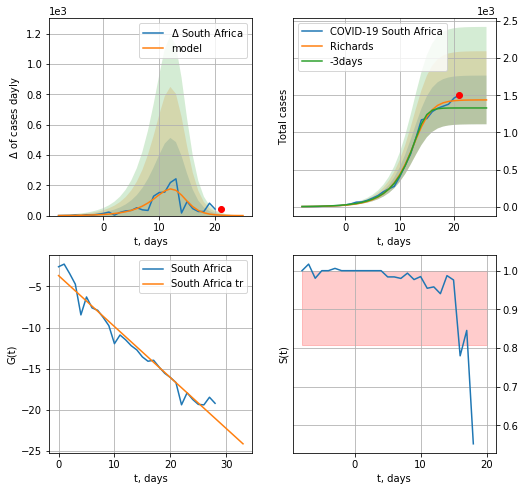

South Africa data at: 2020-07-27
+3 day model MAPE: 0.079443
model: Richards
coeffs: [1.43832006e+03 3.09188711e-01 1.37785511e+01 2.13840843e+00]
rational stdev: 0.227967
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 1438 ± 327
	 total death: 22 ± 15
trend coefficient of determination: 0.961533
 intercept: -3.675972
 slope: -0.619731


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


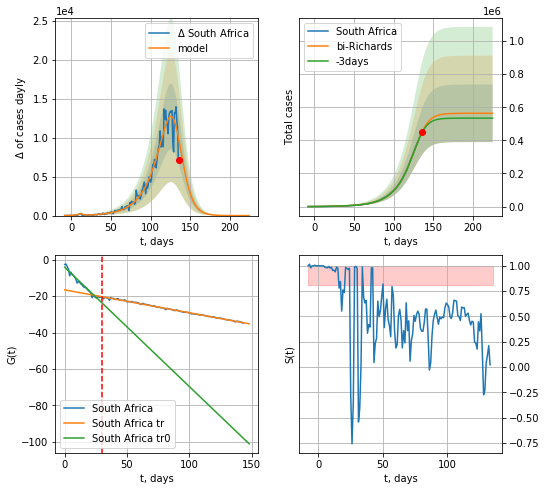

South Africa data at: 2020-07-27
+3 day model MAPE: 0.012245
model: bi-Richards
coeffs: [5.62185260e+05 5.38654223e-02 1.32883530e+02 2.35555100e+00]
rational stdev: 0.308534
forecast at the end of period: +89 days
	 deltaDaycases: 0
	 total cases: 563621 ± 173896
	 total death: 8801 ± 8146
bi-Richards approximation splitting point: 30
trend coefficient of determination: 0.955818
 intercept: -4.137344
 slope: -0.654830
trend coefficient of determination: 0.996110
 intercept: -16.571124
 slope: -0.125671


In [1864]:
dfAF = read_df(pd.DataFrame(),"AF").fillna(0)
#dfAF = dfAF.fillna(0)
try:
    vL = 30
    x = forecastRR("South Africa",dfAF[:vL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("South Africa",dfAF[:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

UB
           date  cases  active  death
130 2020-07-23  18986    8734  103.0
131 2020-07-24  19653    9074  107.0
132 2020-07-25  20226    9283  112.0
133 2020-07-26  20531    9310  116.0
134 2020-07-27  21506    9710  122.0


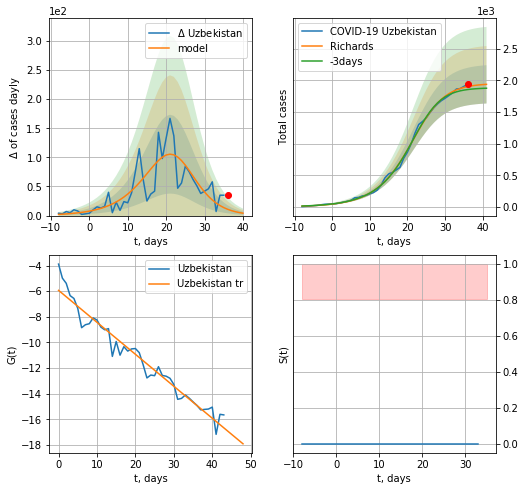

Uzbekistan data at: 2020-07-27
+3 day model MAPE: 0.027380
model: Richards
coeffs: [1.95086939e+03 1.63729535e-01 2.32758397e+01 1.53766466e+00]
rational stdev: 0.156222
forecast at the end of period: +5 days
	 deltaDaycases: 4
	 total cases: 1936 ± 302
	 total death: 10 ± 4
trend coefficient of determination: 0.953191
 intercept: -5.936816
 slope: -0.249439


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


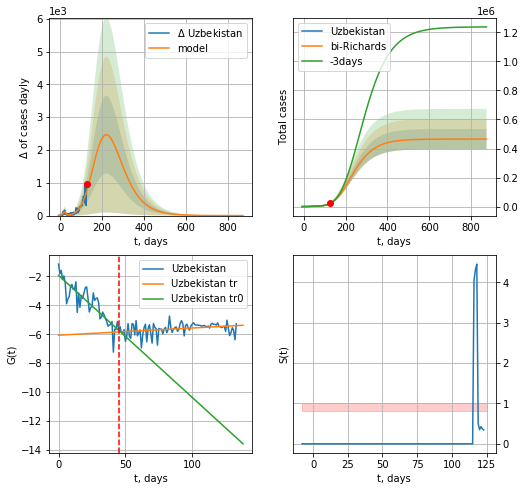

Uzbekistan data at: 2020-07-27
+3 day model MAPE: 0.016304
model: bi-Richards
coeffs: [4.63243414e+05 7.32122740e-02 1.25710992e+02 2.18981711e-01]
rational stdev: 0.148991
forecast at the end of period: +747 days
	 deltaDaycases: 0
	 total cases: 465181 ± 69307
	 total death: 2638 ± 1179
bi-Richards approximation splitting point: 45
trend coefficient of determination: 0.754559
 intercept: -1.925693
 slope: -0.084459
trend coefficient of determination: 0.106767
 intercept: -6.066923
 slope: 0.004986


In [1866]:
dfUB = read_df(pd.DataFrame(),"UB").fillna(0)
#dfAF = dfAF.fillna(0)
try:
    vL = 45
    x = forecastRR("Uzbekistan",dfUB[:vL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("Uzbekistan",dfUB[:],d1,124*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

In [ ]:
cD = {
    "Romania": ["RM",5,4*7],
    #"Finland":"FI",
    "India":["ID",5,6*7],
    "Ecuador":["ED",5,4*7],
    "Philippines":["PH",5,4*7],
    #"Pakistan":"PK",
#    "Luxembourg":"LX",
#    "Saudi Arabia":["SA",5,4*7],
    "Thailand":["TH",5,4*7],
    "Indonesia":["IE",5,16*7],
    "Mexico":["MX",5,8*7],
    "Panama":["PM",12,12*7],
    "Peru":["PU",5,4*7],
    "Serbia":["SB",5,4*7],
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":["UAE",5,8*7],
    "Argentina":["AG",5,8*7],
    "Iceland":["IC",5,4*7],
    "Colombia":["CB",10,16*7],
    "Qatar":["QR",5,6*7],
    "Algeria":["AR",5,16*7],
    "Croatia":["CT",0,12*7],
    "Egypt":["EG",5,4*7],
    "Slovenia":["SV",12,6*7],
    "Morocco":["MR",5,4*7],
    "Iraq":["IQ",2,8*7]
#    "Hong Kong":"HK"
}

dfArray = [dfRM,dfID,dfED,dfPH,dfTH,dfIE,dfMX,dfPM,dfPU,dfSB,dfAG,dfIC,dfCB,dfQR,dfAG,dfCT,dfEG,dfSV,dfMR,dfIQ]
for c,adf in zip(cD,dfArray):
    if c in ["Qatar","Peru","Argentina","Iraq","India","Philippines","Indonesia","Finland","Luxembourg","Ecuador","Thailand","Morocco","Romania","Iceland","Panama","Colombia","Mexico","Algeria", "Croatia","Slovenia","Egypt","Serbia"]:
        continue
    print (c)
    idS = cD[c][1]
    ipd = cD[c][2]
    x = forecast(c,adf[idS:],d1,ipd-dT)
    #xx = forecast2(c,adf[:],d1,ipd-dT,x)

In [1491]:
import requests
import lxml.html as lh
#url='https://www.worldometers.info/coronavirus/#countries'#Create a handle, page, to handle the contents of the website
url='https://www.worldometers.info/coronavirus/#nav-today'
page = requests.get(url)#Store the contents of the website under doc
doc = lh.fromstring(page.content)#Parse data that are stored between <tr>..</tr> of HTML
tr_elements = doc.xpath('//tr')
#Check the length of the first 12 rows
print ([len(T) for T in tr_elements[:12]])
tr_elements = doc.xpath('//tr')#Create empty list
col=[]
i=0#For each row, store each first element (header) and an empty list
for t in tr_elements[0]:
    i+=1
    name=t.text_content()
    print ('%d:"%s"'%(i,name))
    col.append((name,[]))
    
#Since out first row is the header, data is stored on the second row onwards
for j in range(1,len(tr_elements)):
    #T is our j'th row
    T=tr_elements[j]
    #print (len(T))
    #If row is not of size 10, the //tr data is not from our table 
    if len(T)!=19:
        break
    
    #i is the index of our column
    i=0
    
    #Iterate through each element of the row
    for t in T.iterchildren():
        data=t.text_content() 
        #Check if row is empty
        if i>0:
        #Convert any numerical value to integers
            try:
                data=int(data)
            except:
                pass
        #Append the data to the empty list of the i'th column
        col[i][1].append(data)
        #Increment i for the next column
        i+=1
    
print ([len(C) for (title,C) in col])
Dict={title:column for (title,column) in col}
df=pd.DataFrame(Dict)

[19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19]
1:"#"
2:"Country,Other"
3:"TotalCases"
4:"NewCases"
5:"TotalDeaths"
6:"NewDeaths"
7:"TotalRecovered"
8:"NewRecovered"
9:"ActiveCases"
10:"Serious,Critical"
11:"Tot Cases/1M pop"
12:"Deaths/1M pop"
13:"TotalTests"
14:"Tests/
1M pop
"
15:"Population"
16:"Continent"
17:"1 Caseevery X ppl"
18:"1 Deathevery X ppl"
19:"1 Testevery X ppl"
[695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695]


In [1492]:
df.head(10)
#df.columns[18]

,#,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",Tot Cases/1M pop,Deaths/1M pop,TotalTests,Tests/\n1M pop\n,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,"5,201,390","+5,474","209,681",393,"2,619,014","+5,404","2,372,695","26,296",,,,,,North America,\n,,
1,,\nSouth America\n,"3,792,033","+4,669","135,667",122,"2,541,259",309,"1,115,107","14,309",,,,,,South America,\n,,
2,,\nAsia\n,"3,979,309","+8,046","91,316",144,"2,886,791","+13,483","1,001,202","19,570",,,,,,Asia,\n,,
3,,\nEurope\n,"2,806,724","+6,774","201,832",168,"1,687,010","+10,069","917,882","5,255",,,,,,Europe,\n,,
4,,\nAfrica\n,"864,139",45,"18,222",4,"510,111",22,"335,806","1,094",,,,,,Africa,\n,,
5,,\nOceania\n,"17,032",368,189,6,"10,936",1,"5,907",50,,,,,,Australia/Oceania,\n,,
6,,\n\n,721,,15,,651,,55,4,,,,,,,\n,,
7,,World,"16,661,348","+25,376","656,922",837,"10,255,772","+29,288","5,748,654","66,578","2,137",84.3,,,,All,\n,,
8,1,USA,"4,433,410",,"150,444",,"2,136,603",,"2,146,363","19,100","13,388",454,"55,018,236","166,145","331,145,197",North America,75,"2,201",6
9,2,Brazil,"2,446,397","+2,917","87,737",58,"1,667,667",,"690,993","8,318","11,503",413,"12,601,096","59,252","212,669,472",South America,87,"2,424",17


In [1493]:
#df.rename(columns={"Country,Other":"Country",df.columns[9]:"TotDeathsper1Mpop"})
df=df.rename(columns={"Country,Other":"Country",'Deaths/1M pop':"Deathsper1Mpop","Serious,Critical":"Serious_Critical",'Tests/\n1M pop\n':"Testsper1Mpop",'Tot\xa0Cases/1M pop':"TotCasesper1Mpop"})
df.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,"5,201,390","+5,474","209,681",393,"2,619,014","+5,404","2,372,695","26,296",,,,,,North America,\n,,
1,,\nSouth America\n,"3,792,033","+4,669","135,667",122,"2,541,259",309,"1,115,107","14,309",,,,,,South America,\n,,
2,,\nAsia\n,"3,979,309","+8,046","91,316",144,"2,886,791","+13,483","1,001,202","19,570",,,,,,Asia,\n,,
3,,\nEurope\n,"2,806,724","+6,774","201,832",168,"1,687,010","+10,069","917,882","5,255",,,,,,Europe,\n,,
4,,\nAfrica\n,"864,139",45,"18,222",4,"510,111",22,"335,806","1,094",,,,,,Africa,\n,,


In [1494]:
df[df["Country"]=="Lithuania"]

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
130,123,Lithuania,"2,027",8,80,,"1,623",3,324,6,745,29,"507,420","186,610","2,719,151",Europe,"1,341","33,989",5
363,124,Lithuania,"2,019",11,80,,"1,620",4,319,6,743,29,"504,056","185,373","2,719,151",Europe,"1,347","33,989",5
595,124,Lithuania,"2,008",7,80,,"1,616",,312,6,738,29,"502,690","184,870","2,719,151",Europe,"1,354","33,989",5


In [1495]:
totIdx = np.where(df['ActiveCases']=='ActiveCases')[0][0]
print(totIdx)

231


In [1496]:
df.head(48)

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,"5,201,390","+5,474","209,681",393,"2,619,014","+5,404","2,372,695","26,296",,,,,,North America,\n,,
1,,\nSouth America\n,"3,792,033","+4,669","135,667",122,"2,541,259",309,"1,115,107","14,309",,,,,,South America,\n,,
2,,\nAsia\n,"3,979,309","+8,046","91,316",144,"2,886,791","+13,483","1,001,202","19,570",,,,,,Asia,\n,,
3,,\nEurope\n,"2,806,724","+6,774","201,832",168,"1,687,010","+10,069","917,882","5,255",,,,,,Europe,\n,,
4,,\nAfrica\n,"864,139",45,"18,222",4,"510,111",22,"335,806","1,094",,,,,,Africa,\n,,
5,,\nOceania\n,"17,032",368,189,6,"10,936",1,"5,907",50,,,,,,Australia/Oceania,\n,,
6,,\n\n,721,,15,,651,,55,4,,,,,,,\n,,
7,,World,"16,661,348","+25,376","656,922",837,"10,255,772","+29,288","5,748,654","66,578","2,137",84.3,,,,All,\n,,
8,1,USA,"4,433,410",,"150,444",,"2,136,603",,"2,146,363","19,100","13,388",454,"55,018,236","166,145","331,145,197",North America,75,"2,201",6
9,2,Brazil,"2,446,397","+2,917","87,737",58,"1,667,667",,"690,993","8,318","11,503",413,"12,601,096","59,252","212,669,472",South America,87,"2,424",17


In [1497]:
df.at[17, 'TotalRecovered'] = 0
df.at[16, 'TotalRecovered'] = 0
df.at[36, 'TotalRecovered'] = 0
df.at[47, 'TotalRecovered'] = 0
df.at[17,"ActiveCases"] = 0
df.at[16,"ActiveCases"] = 0
df.at[36,"ActiveCases"] = 0
df.at[47,"ActiveCases"] = 0
#df.at[12, 'TotalRecovered'] = 0
df = df.fillna(0)

In [1498]:
import lxml
def sanitize(data):
    #print (type(data))
    if type(data) == lxml.etree._ElementUnicodeResult:
        data=str(data).strip()
    if str(data).find(',') != -1:
        data = data.replace(',','')
    #print(str(data).find(',') != -1)
    return data
df=df[df.index<totIdx-1]
df["ActiveCases"] = pd.to_numeric(df["ActiveCases"].apply(sanitize))
df["Deathsper1Mpop"] = pd.to_numeric(df["Deathsper1Mpop"].apply(sanitize))
df["NewCases"] = pd.to_numeric(df["NewCases"].apply(sanitize))
df["NewDeaths"] = pd.to_numeric(df["NewDeaths"].apply(sanitize))
df["Serious_Critical"] = pd.to_numeric(df["Serious_Critical"].apply(sanitize))
df["TotalCases"] = pd.to_numeric(df["TotalCases"].apply(sanitize))
df["TotalDeaths"] = pd.to_numeric(df["TotalDeaths"].apply(sanitize))
df["TotalRecovered"] = pd.to_numeric(df["TotalRecovered"].apply(sanitize))
df["TotCasesper1Mpop"] = pd.to_numeric(df["TotCasesper1Mpop"].apply(sanitize))
df["TotalTests"] = pd.to_numeric(df["TotalTests"].apply(sanitize))
df["Testsper1Mpop"] = pd.to_numeric(df["Testsper1Mpop"].apply(sanitize))
df.head(15)

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,5201390,5474.0,209681.0,393.0,2619014.0,"+5,404",2372695,26296.0,NaN,NaN,NaN,NaN,,North America,\n,,
1,,\nSouth America\n,3792033,4669.0,135667.0,122.0,2541259.0,309,1115107,14309.0,NaN,NaN,NaN,NaN,,South America,\n,,
2,,\nAsia\n,3979309,8046.0,91316.0,144.0,2886791.0,"+13,483",1001202,19570.0,NaN,NaN,NaN,NaN,,Asia,\n,,
3,,\nEurope\n,2806724,6774.0,201832.0,168.0,1687010.0,"+10,069",917882,5255.0,NaN,NaN,NaN,NaN,,Europe,\n,,
4,,\nAfrica\n,864139,45.0,18222.0,4.0,510111.0,22,335806,1094.0,NaN,NaN,NaN,NaN,,Africa,\n,,
5,,\nOceania\n,17032,368.0,189.0,6.0,10936.0,1,5907,50.0,NaN,NaN,NaN,NaN,,Australia/Oceania,\n,,
6,,\n\n,721,NaN,15.0,NaN,651.0,,55,4.0,NaN,NaN,NaN,NaN,,,\n,,
7,,World,16661348,25376.0,656922.0,837.0,10255772.0,"+29,288",5748654,66578.0,2137.0,84.3,NaN,NaN,,All,\n,,
8,1,USA,4433410,NaN,150444.0,NaN,2136603.0,,2146363,19100.0,13388.0,454.0,55018236.0,166145.0,"331,145,197",North America,75,"2,201",6
9,2,Brazil,2446397,2917.0,87737.0,58.0,1667667.0,,690993,8318.0,11503.0,413.0,12601096.0,59252.0,"212,669,472",South America,87,"2,424",17


In [1499]:
cLst = countriesEU
ActiveCasesEU = sum([ w for w in df[df['Country'].isin(cLst)].ActiveCases if w>0])
CountryEU = "European Union" 
Deathsper1MpopEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])/445.250514
NewCasesEU = sum([w for w in df[df['Country'].isin(cLst)].NewCases if w>0 ])
NewDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].NewDeaths if w>0])
Serious_CriticalEU = sum([w for w in df[df['Country'].isin(cLst)].Serious_Critical if w>0])
Testsper1MpopEU = sum([ w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])/445.250514
TotalCasesEu = sum([w for w in df[df['Country'].isin(cLst)].TotalCases if w>0])
TotalDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])
TotalRecoveredEU = sum([w for w in df[df['Country'].isin(cLst)].TotalRecovered if w>0] )
TotalTestsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])
TotCasesper1MpopEU = TotalCasesEu/445.250514

rowEU = {"ActiveCases":ActiveCasesEU,"Continent":"Europe","Country": CountryEU,"Deathsper1Mpop": Deathsper1MpopEU,"NewCases": NewCasesEU,"NewDeaths": NewDeathsEU,"Serious_Critical": Serious_CriticalEU,"Testsper1Mpop": Testsper1MpopEU,"TotalCases": TotalCasesEu,"TotalDeaths": TotalDeathsEU,"TotalRecovered": TotalRecoveredEU,"TotalTests": TotalTestsEU,"TotCasesper1Mpop": TotCasesper1MpopEU }
df = df.append(rowEU, ignore_index=True)
df.tail()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
226,,Total:,2806724,6774.0,201832.0,168.0,1687010.0,"+10,069",917882,5255.0,NaN,NaN,NaN,NaN,,Europe,,,
227,,Total:,864139,45.0,18222.0,4.0,510111.0,22,335806,1094.0,NaN,NaN,NaN,NaN,,Africa,,,
228,,Total:,17032,368.0,189.0,6.0,10936.0,1,5907,50.0,NaN,NaN,NaN,NaN,,Australia/Oceania,,,
229,,Total:,721,NaN,15.0,NaN,651.0,,55,4.0,NaN,NaN,NaN,NaN,,,,,
230,NaN,European Union,1425951,460.0,135765.0,2.0,683658.0,NaN,188395,2025.0,3202.581367,304.918233,38308161.0,86037.320105,NaN,Europe,NaN,NaN,NaN


In [1500]:
#df['Reported1st case'] = df['Reported1st case'].map(lambda x: x.lstrip('\n'))
df["Country"] = df["Country"].str.strip('\n')
df.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,North America,5201390,5474.0,209681.0,393.0,2619014.0,"+5,404",2372695,26296.0,NaN,NaN,NaN,NaN,,North America,\n,,
1,,South America,3792033,4669.0,135667.0,122.0,2541259.0,309,1115107,14309.0,NaN,NaN,NaN,NaN,,South America,\n,,
2,,Asia,3979309,8046.0,91316.0,144.0,2886791.0,"+13,483",1001202,19570.0,NaN,NaN,NaN,NaN,,Asia,\n,,
3,,Europe,2806724,6774.0,201832.0,168.0,1687010.0,"+10,069",917882,5255.0,NaN,NaN,NaN,NaN,,Europe,\n,,
4,,Africa,864139,45.0,18222.0,4.0,510111.0,22,335806,1094.0,NaN,NaN,NaN,NaN,,Africa,\n,,


In [759]:
#totIdx0 = np.where(df['Country']=='Total:')[0][0]
#df.at[totIdx0,'Country'] = 'World'

In [760]:
#df

In [1501]:
#df[df['Country'].isnull()]
#df['Country']=df['Country'].dropna()
##for idx in df['Country'].isnull():
##    #print(idx)
##    if idx == True:
##        ind = df[df['Country'].isnull()].index[0]
##        df = df.drop(df.index[ind])
df = df.drop(df.index[6])
df.head(10)

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,North America,5201390,5474.0,209681.0,393.0,2619014.0,"+5,404",2372695,26296.0,NaN,NaN,NaN,NaN,,North America,\n,,
1,,South America,3792033,4669.0,135667.0,122.0,2541259.0,309,1115107,14309.0,NaN,NaN,NaN,NaN,,South America,\n,,
2,,Asia,3979309,8046.0,91316.0,144.0,2886791.0,"+13,483",1001202,19570.0,NaN,NaN,NaN,NaN,,Asia,\n,,
3,,Europe,2806724,6774.0,201832.0,168.0,1687010.0,"+10,069",917882,5255.0,NaN,NaN,NaN,NaN,,Europe,\n,,
4,,Africa,864139,45.0,18222.0,4.0,510111.0,22,335806,1094.0,NaN,NaN,NaN,NaN,,Africa,\n,,
5,,Oceania,17032,368.0,189.0,6.0,10936.0,1,5907,50.0,NaN,NaN,NaN,NaN,,Australia/Oceania,\n,,
7,,World,16661348,25376.0,656922.0,837.0,10255772.0,"+29,288",5748654,66578.0,2137.0,84.3,NaN,NaN,,All,\n,,
8,1,USA,4433410,NaN,150444.0,NaN,2136603.0,,2146363,19100.0,13388.0,454.0,55018236.0,166145.0,"331,145,197",North America,75,"2,201",6
9,2,Brazil,2446397,2917.0,87737.0,58.0,1667667.0,,690993,8318.0,11503.0,413.0,12601096.0,59252.0,"212,669,472",South America,87,"2,424",17
10,3,India,1484136,1633.0,33461.0,13.0,954004.0,815,496671,8944.0,1075.0,24.0,17334885.0,12553.0,"1,380,974,594",Asia,930,"41,271",80


In [1502]:
df.to_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)), index=False)

In [1503]:
countryDic = {
  "USA": "US",
"Italy":"IT",
"Spain":"SP",
"Germany":"GR",
"France":"FR",
"Iran":"IN",
"UK":"GB",
"Switzerland":"SZ",
"S. Korea":"KR",
"Norway":"NG",
"Sweden":"SW",
"Israel":"IS",
"Denmark":"DK",
"Poland":"PL",
"Estonia":"ES",
"Ukraine":"Ukr",
"Latvia":"LV",
    "Lithuania":"LT",
    "China":"CN",
    "USA":"US",
    "Russia":"RS",
    "Japan":"JP",
    "Netherlands":"NL",
    "Belgium":"BG",
    "Singapore":"SG",
    "Austria":"AT",
    "Turkey":"TR",
    "Canada":"CA",
    "Portugal":"PT",
    "World":"World",
    "Australia":"AS",
    "Brazil":"BZ",
    "Malaysia":"ML",
    "New Zealand":"ZL",
    "Belarus":"BR",
    "Ireland":"IR",
    "Chile":"CL",
    "Czechia":"CH",
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
#    "Pakistan":"PK",
    "Luxembourg":"LX",
    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
    "South Africa":"AF",
    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "European Union":"EU",
    "Bulgaria":"BL",
    "Hungary":"HG",
    "Malta":"MT",
    "Slovakia":"SL",
    "Cyprus":"CP",
    "Greece":"GC",
    "Dominican Republic":"DM",
    "Kuwait":"KW",
    "Bangladesh":"BN",
    "Sri Lanka":"Sri",
    "Pakistan":"PS",
    "Moldova":"MD",
    "Uzbekistan":"UB"
#    "Hong Kong":"HK"
}
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)

for c in countryDic:
    print (c,countryDic[c])

USA US
Italy IT
Spain SP
Germany GR
France FR
Iran IN
UK GB
Switzerland SZ
S. Korea KR
Norway NG
Sweden SW
Israel IS
Denmark DK
Poland PL
Estonia ES
Ukraine Ukr
Latvia LV
Lithuania LT
China CN
Russia RS
Japan JP
Netherlands NL
Belgium BG
Singapore SG
Austria AT
Turkey TR
Canada CA
Portugal PT
World World
Australia AS
Brazil BZ
Malaysia ML
New Zealand ZL
Belarus BR
Ireland IR
Chile CL
Czechia CH
Romania RM
Finland FI
India ID
Ecuador ED
Philippines PH
Luxembourg LX
Saudi Arabia SA
Thailand TH
Indonesia IE
Mexico MX
Panama PM
Peru PU
Serbia SB
South Africa AF
UAE UAE
Argentina AG
Iceland IC
Colombia CB
Qatar QR
Algeria AR
Croatia CT
Egypt EG
Slovenia SV
Morocco MR
Iraq IQ
European Union EU
Bulgaria BL
Hungary HG
Malta MT
Slovakia SL
Cyprus CP
Greece GC
Dominican Republic DM
Kuwait KW
Bangladesh BN
Sri Lanka Sri
Pakistan PS
Moldova MD
Uzbekistan UB


In [1504]:
len(countryDic)

76

In [1505]:
df = pd.read_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)),',')
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)
from datetime import date, timedelta
for c in df.Country: 
    print (c)
    #if c in ['North America','South America','Asia','Europe','Africa','Oceania','World']:
    #    continue
    f = open("data/tmp/corona%sOneRaw.csv"%(c),'w')
    #print ("corona%sOneRaw.csv"%(c),date.today()- timedelta(days=1),c,df[df.Country == c].TotalCases.values[0])
    print(c)
    if c!='World':
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    else:
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    f.close()

North America
North America
North America 2020-07-27,5201390,2372695,209681.0
South America
South America
South America 2020-07-27,3792033,1115107,135667.0
Asia
Asia
Asia 2020-07-27,3979309,1001202,91316.0
Europe
Europe
Europe 2020-07-27,2806724,917882,201832.0
Africa
Africa
Africa 2020-07-27,864139,335806,18222.0
Oceania
Oceania
Oceania 2020-07-27,17032,5907,189.0
World
World
World 2020-07-27,16661348,5748654,656922.0
USA
USA
USA 2020-07-27,4433410,2146363,150444.0
Brazil
Brazil
Brazil 2020-07-27,2446397,690993,87737.0
India
India
India 2020-07-27,1484136,496671,33461.0
Russia
Russia
Russia 2020-07-27,823515,197794,13504.0
South Africa
South Africa
South Africa 2020-07-27,452529,170537,7067.0
Mexico
Mexico
Mexico 2020-07-27,395489,94690,44022.0
Peru
Peru
Peru 2020-07-27,389717,98752,18418.0
Chile
Chile
Chile 2020-07-27,347923,18782,9187.0
Spain
Spain
Spain 2020-07-27,325862,0,28434.0
UK
UK
UK 2020-07-27,300111,0,45759.0
Iran
Iran
Iran 2020-07-27,293606,22550,15912.0
Pakistan
Pakistan


Gambia 2020-07-27,326,252,8.0
Mongolia
Mongolia
Mongolia 2020-07-27,289,67,nan
Martinique
Martinique
Martinique 2020-07-27,269,156,15.0
Eritrea
Eritrea
Eritrea 2020-07-27,265,74,nan
Cambodia
Cambodia
Cambodia 2020-07-27,226,79,nan
Faeroe Islands
Faeroe Islands
Faeroe Islands 2020-07-27,214,26,nan
Guadeloupe
Guadeloupe
Guadeloupe 2020-07-27,203,13,14.0
Cayman Islands
Cayman Islands
Cayman Islands 2020-07-27,203,0,1.0
Gibraltar
Gibraltar
Gibraltar 2020-07-27,185,5,nan
Bermuda
Bermuda
Bermuda 2020-07-27,154,4,9.0
Trinidad and Tobago
Trinidad and Tobago
Trinidad and Tobago 2020-07-27,148,12,8.0
Brunei 
Brunei 
Brunei  2020-07-27,141,0,3.0
Aruba
Aruba
Aruba 2020-07-27,119,14,3.0
Monaco
Monaco
Monaco 2020-07-27,116,8,4.0
Sint Maarten
Sint Maarten
Sint Maarten 2020-07-27,114,36,15.0
Seychelles
Seychelles
Seychelles 2020-07-27,114,75,nan
Barbados
Barbados
Barbados 2020-07-27,110,9,7.0
Turks and Caicos
Turks and Caicos
Turks and Caicos 2020-07-27,99,61,2.0
Bhutan
Bhutan
Bhutan 2020-07-27,99,13,

In [1506]:
#c='World'
#print(c,"%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0]))

In [1507]:
for c in countryDic: 
    #if c not in ['European Union']:
    #    continue
    ff = open("data/tmp/corona%sOneRaw.csv"%(c),'r')
    fff = open("data/corona%s.csv"%(countryDic[c]),'a')
    for l in ff:
        #print(c,l)
        print("append data/corona%s.csv"%(countryDic[c]),"%s"%(l))
        fff.write(l)
    ff.close()
    fff.close()

append data/coronaUS.csv 2020-07-27,4433410,2146363,150444.0

append data/coronaIT.csv 2020-07-27,246286,12581,35112.0

append data/coronaSP.csv 2020-07-27,325862,0,28434.0

append data/coronaGR.csv 2020-07-27,207379,6774,9205.0

append data/coronaFR.csv 2020-07-27,183079,71788,30209.0

append data/coronaIN.csv 2020-07-27,293606,22550,15912.0

append data/coronaGB.csv 2020-07-27,300111,0,45759.0

append data/coronaSZ.csv 2020-07-27,34477,1599,1978.0

append data/coronaKR.csv 2020-07-27,14203,896,300.0

append data/coronaNG.csv 2020-07-27,9132,125,255.0

append data/coronaSW.csv 2020-07-27,79395,0,5700.0

append data/coronaIS.csv 2020-07-27,64649,32052,480.0

append data/coronaDK.csv 2020-07-27,13547,517,613.0

append data/coronaPL.csv 2020-07-27,43402,8683,1676.0

append data/coronaES.csv 2020-07-27,2038,45,69.0

append data/coronaUkr.csv 2020-07-27,66575,28202,1629.0

append data/coronaLV.csv 2020-07-27,1220,137,31.0

append data/coronaLT.csv 2020-07-27,2027,324,80.0

append data/coro

In [1508]:
import pandas as pd
import io
import requests
url="https://opendata.ecdc.europa.eu/covid19/casedistribution/csv"
s=requests.get(url).content
#print (s)
dfc=pd.read_csv(io.StringIO(s.decode(encoding='windows-1252')))
dfc.to_csv("data/europa_corona.csv", index=False)

In [1509]:
countryDic1 = {
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
#    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "Bulgaria":"BL"
#    "Hong Kong":"HK"
}
countryDic2 = {
    "Austria":"AT",
    "Italy":"IT",
    "Belgium":"BG",
    "Latvia":"LV",
    "Bulgaria":"BL",
    "Lithuania":"LT",
    "Croatia":"CT",
    "Luxembourg":"LX",
    "Cyprus":"CP",
    "Malta":"MT",
    "Czechia":"CH",
    "Netherlands":"NL",
    "Denmark":"DK",
    "Poland":"PL",
    "Estonia":"ES",
    "Portugal":"PT",
    "Finland":"FI",
    "Romania":"RM",
    "France":"FR",
    "Slovakia":"SL",
    "Germany":"GR",
    "Slovenia":"SV",
    "Greece":"GC",
    "Spain":"SP",
    "Hungary":"HG",
    "Sweden":"SW",
    "Ireland":"IR"      
}
cD3 = {"Malta":"MT","Slovakia":"SL","Greece":"GC","Hungary":"HG","Cyprus":"CP","South Africa":"SAF"}
    
for  c in cD3:#countryDic1:
    if c != "South Africa":
        continue
    dfc = pd.read_csv("europa_corona.csv",",")
    dfc = dfc[dfc['countriesAndTerritories']==c].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
    print(c,sum(dfc["cases"].values))
    dfc=dfc.rename(columns={"dateRep":"date"})
    dfc = dfc[dfc["cases"]>0]
    dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
    #dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
    dfc["cases"]=np.cumsum(dfc["cases"].values)
    dfc[['date', 'cases']].to_csv('data/corona%s.csv'%(cD3[c]), index=False)#countryDic1

FileNotFoundError: [Errno 2] File b'europa_corona.csv' does not exist: b'europa_corona.csv'

In [ ]:
#dfRM = read_df(pd.DataFrame(),"RM")

In [ ]:
dfc.head()#[['date', 'cases']]

In [ ]:
date(2012, 3, 16)

In [ ]:
len(countriesEU)

In [ ]:
dfc = pd.read_csv("europa_corona.csv",",")
cLst = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania","Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands","Denmark","Poland","Estonia","Portugal","Finland","Romania","France","Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
dfc = dfc[dfc['countriesAndTerritories'].isin(cLst)].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
print(c,sum(dfc["cases"].values))
dfc=dfc.rename(columns={"dateRep":"date"})
dfc = dfc[dfc["cases"]>0]
dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
#dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
dfc["cases"]=np.cumsum(dfc["cases"].values)
dfc[['date', 'cases']].to_csv('/home/algiz/Desktop/corona%s.csv'%("EU"), index=False)

In [ ]:
#subsetDataFrame = dfObj[dfObj['Product'].isin(['Mangos', 'Grapes']) ]

#dfD = dfAll[dfAll['Country'].isin(cLst)].TotalTests


In [ ]:
#dfD

In [ ]:
#dfAll[dfAll['Country'].isin(cLst)]

In [ ]:
TT = sum(dfAll[dfAll.TotalTests>0].TotalTests) - dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]
print(TT,TT/7.7776e3)

In [ ]:
TT/7.7776e3

In [ ]:
dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]/(popEU/1e6)

In [ ]:
sum(dfp.Population)/1e6

In [ ]:
dfAll[dfAll.TotalTests>0]

In [ ]:
cDicEU = {
    "Austria":["AT",dfAT],
    "Italy":["IT",dfIT],
    "Belgium":["BG",dfBG],
    "Latvia":["LV",dfLV],
    "Bulgaria":["BL",dfBL],
    "Lithuania":["LT",dfLT],
    "Croatia":["CT",dfCT],
    "Luxembourg":["LX",dfLX],
    "Cyprus":["CP",dfCP],
    "Malta":["MT",dfMT],
    "Czechia":["CH",dfCH],
    "Netherlands":["NL",dfNL],
    "Denmark":["DK",dfDK],
    "Poland":["PL",dfPL],
    "Estonia":["ES",dfES],
    "Portugal":["PT",dfPT],
    "Finland":["FI",dfFI],
    "Romania":["RM",dfRM],
    "France":["FR",dfFR],
    "Slovakia":["SL",dfSL],
    "Germany":["GR",dfGR],
    "Slovenia":["SV",dfSV],
    "Greece":["GC",dfGC],
    "Spain":["SP",dfSP],
    "Hungary":["HG",dfHG],
    "Sweden":["SW",dfSW],
    "Ireland":["IR",dfIR],
}

In [ ]:
def addDataFrames(f_arg, *argv):
    dfTotal = f_arg
    for arg in argv:
        dfTotal = dfTotal.set_index('date').add(arg.set_index('date'), fill_value = 0)
        dfTotal['date'] = dfTotal.index
    return dfTotal
dfTot = cDicEU["Austria"][1]
for cD in cDicEU:
    if cD == "Austria":
        continue
    dfTot = addDataFrames(dfTot, cDicEU[cD][1])
    
dfTot.to_csv("~/Documents/coronaEU1.csv")

In [ ]:
#cDicEU["Ireland"][1]

In [ ]:
dfAll[df["Country"]=="European Union"].TotalTests.values[0]/445.250514

In [ ]:
dfAll[df["Country"]=="Total:"].TotalTests.values[0]/445

In [ ]:
#dfAll

In [ ]:
(sum(dfAll.TotalTests)-dfAll[df["Country"]=="European Union"].TotalTests.values[0])/(7.777e3-445.250514)

In [24]:
CList = ["USA",
"Spain", "Italy", "UK", "France", "Germany", "Turkey", "Russia", "Iran", "Brazil", "Canada", "Belgium",
"Peru", "Netherlands", "India", "Switzerland", "Ecuador", "Portugal", "Saudi Arabia", "Sweden", "Ireland",
"Mexico", "Pakistan", "Singapore", "Chile", "Israel", "Austria", "Belarus", "Japan", "Qatar", "Poland",
"UAE", "Romania", "Ukraine", "South_Korea", "Indonesia", "Denmark", "Serbia", "Philippines", "Norway", "Czechia",
"Colombia", "Australia", "Malaysia", "Egypt", "Finland", "Morocco", "Argentina", "Algeria", "Moldova", 
"Luxembourg", "Thailand", "Hungary", "Greece", "Iraq", "Croatia", "Iceland", "Estonia", "Bulgaria",
"New_Zealand", "Slovenia", "Slovakia", "Lithuania", "Latvia", "Cyprus", "Malta","Bangladesh","Kuwait",
"Dominican Republic","Moldova","South Africa","China","Uzbekistan"         
]

In [25]:
len(CList)

73

In [26]:
popModelled = sum(dfp[dfp["Country (or dependency)"].isin(CList) ].Population)
popModelled

NameError: name 'dfp' is not defined

In [ ]:
for CItem in CList:
    a = """
    %s
    <br />
    <img src="pictures/covidcases%s35_Q.png" alt="hi" class="inline"/><br /> 

      {%% include_relative _includes/covidcases%s35_Q.txt %%}
          <br /> 
    """%(CItem,CItem,CItem)
    print (a)

In [ ]:
R = (dfLT[:].cases.values/0.9240855762594893).astype(int)+1 -dfLT[:].active.values+dfLT[:].death.values
I = dfLT[:].active.values
S = 1700-R[:]-I
plt.plot(range(len(dfLT)),R,label="R")
plt.plot(range(len(dfLT)),I,label="I")
plt.plot(range(len(dfLT)),S,label="S")
plt.legend()
plt.grid()

In [ ]:
plt.plot(np.multiply(I,S)[1:]/1700,-np.diff(S[:]))
plt.grid()

In [ ]:
plt.plot(np.diff(R[:]),I[1:]/950)
plt.grid()

In [ ]:
plt.plot(np.diff(R[:])+np.diff(I)+np.diff(S))
plt.grid()

In [ ]:
def fS(x0,u):
    return x0*u
def fI(gamma,beta,x0,C1,u):
    return gamma*np.log(u)/beta-x0*u-C1/beta
def fR(gamma,beta,u):
    return -gamma*np.log(u)/beta
def fT(C1,gamma,x0,beta,u,u0):
    from scipy.integrate import quad
    def integrand(x, C1,gamma,x0,beta):
        return 1/(beta*x*(C1/beta-gamma*np.log(x)/beta+x0*x)) 
    return quad(integrand, u0, u, args=(C1,gamma,x0,beta),epsrel=1e-12)
vfS = np.vectorize(fS)
vfI = np.vectorize(fI)
vfR = np.vectorize(fR)
vfT = np.vectorize(fT)

In [ ]:
import scipy.optimize as optimize

T = np.linspace(.00001, 55., num=len(dfLT))
#U = np.linspace(1.0, 10*len(dfLT), num=len(dfLT))

def f(params):
    # print(params)  # <-- you'll see that params is a NumPy array
    gamma, norm = params # <-- for readability you may wish to assign names to the component variables
    C1 = -N*beta
    minT = np.min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
    sumT = np.sum((T[:]-(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm)**2)
    sumS = np.sum((S[:]-vfS(x0,U[:]))**2)
    sumI = np.sum((I[:]-vfI(gamma,beta,x0,C1,U[:]))**2)
    sumR = np.sum((R[:]-vfR(gamma,beta,U[:]))**2)
    return sumR+sumI+sumS+sumT
N = 1700
x0 = N*0.98
gamma = 4.18201705e+01
beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
norma = 55*2
initial_guess = [gamma, norma]
result = optimize.minimize(f, initial_guess)
if result.success:
    fitted_params = result.x
    print(fitted_params)
else:
    fitted_params = result.x
    print(fitted_params)
    raise ValueError(result.message)

In [ ]:
55*19

In [ ]:
N = 1700
#x0 = N*0.995
gamma =  fitted_params[0]
#beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02*0.13
norm = fitted_params[1]
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
minT = min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
plt.plot(U[:-1],(np.diff(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT))*norm)
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfS(x0,U[:]))
plt.plot(range(len(dfLT)),S,label="S")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfI(gamma,beta,x0,C1,U[:]))
plt.plot(range(len(dfLT)),I,label="I")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfR(gamma,beta,U[:]))
plt.plot(range(len(dfLT)),R,label="R")
plt.grid()

In [ ]:
#T = np.linspace(1.0, len(dfLT), num=len(dfLT))

In [ ]:
#u0 = [1,0.01]
#vfS(x0,u0),vfI(gamma,beta,x0,C1,u0),vfR(gamma,beta,u0)

In [ ]:
gamma/(beta*x0)*55*4

In [ ]:
np.logspace(0.1,0.9,num=9-2+1,dtype='float64')/10

In [ ]:
10**0.1

In [ ]:
np.multiply(I,S)[1:].shape

In [ ]:
np.diff(S).shape

In [ ]:
50./400